In [1]:
from cryptocmd import CmcScraper
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import KFold, RandomizedSearchCV
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_squared_error, r2_score
# from keras.models import Sequential
# from keras.layers import LSTM, Dense

In [2]:
scraper_btc = CmcScraper(coin_code="btc", coin_name="bitcoin")
df_btc = scraper_btc.get_dataframe()
df_btc['name'] = 'btc'

scraper_eth = CmcScraper(coin_code="eth", coin_name="ethereum")
df_eth = scraper_eth.get_dataframe()
df_eth['name'] = 'eth'

scraper_aave = CmcScraper(coin_code="aave", coin_name="aave")
df_aave = scraper_aave.get_dataframe()
df_aave['name'] = 'aave'

scraper_doge = CmcScraper(coin_code="doge", coin_name="dogecoin")
df_doge = scraper_doge.get_dataframe()
df_doge['name'] = 'doge'

scraper_xrp = CmcScraper(coin_code="xrp", coin_name="xrp")
df_xrp = scraper_xrp.get_dataframe()
df_xrp['name'] = 'xrp'

merged_df = pd.concat([df_btc, df_eth, df_aave, df_doge, df_xrp], ignore_index=True)

In [3]:
merged_df.shape

(16291, 12)

In [4]:
merged_df.columns

Index(['Date', 'Open', 'High', 'Low', 'Close', 'Volume', 'Market Cap',
       'Time Open', 'Time High', 'Time Low', 'Time Close', 'name'],
      dtype='object')

# check for null values

In [5]:
merged_df.isnull().sum()

Date          0
Open          0
High          0
Low           0
Close         0
Volume        0
Market Cap    0
Time Open     0
Time High     0
Time Low      0
Time Close    0
name          0
dtype: int64

In [6]:
merged_df.isna().sum()

Date          0
Open          0
High          0
Low           0
Close         0
Volume        0
Market Cap    0
Time Open     0
Time High     0
Time Low      0
Time Close    0
name          0
dtype: int64

# Check for duplicates

In [7]:
merged_df.duplicated().sum()

0

In [8]:
merged_df.duplicated()

0        False
1        False
2        False
3        False
4        False
         ...  
16286    False
16287    False
16288    False
16289    False
16290    False
Length: 16291, dtype: bool

In [9]:
merged_df.describe()

,Date,Open,High,Low,Close,Volume,Market Cap
count,16291,16291.000000,16291.000000,16291.000000,16291.000000,1.629100e+04,1.629100e+04
mean,2019-06-22 07:51:07.877969408,3724.360257,3812.567365,3629.660888,3728.002214,6.020875e+09,9.447296e+10
min,2013-04-28 00:00:00,0.000000,0.000089,0.000000,0.000087,0.000000e+00,0.000000e+00
25%,2016-11-26 00:00:00,0.060361,0.061648,0.058753,0.060443,1.877418e+07,6.612212e+08
50%,2019-09-10 00:00:00,11.333200,11.680000,11.007400,11.349500,4.724415e+08,1.083560e+10
75%,2022-02-18 00:00:00,769.215485,782.525513,743.235504,770.982513,5.673720e+09,5.079016e+10
max,2024-05-12 00:00:00,73079.373379,73750.073850,71334.092382,73083.501328,3.509679e+11,1.436272e+12
std,NaN,10621.261851,10871.293349,10347.117321,10629.624624,1.218163e+10,2.088856e+11


In [10]:
merged_df.head()

,Date,Open,High,Low,Close,Volume,Market Cap,Time Open,Time High,Time Low,Time Close,name
0,2024-05-12,60793.502025,61818.154883,60632.602445,61448.394672,1.380046e+10,1.210436e+12,2024-05-12T00:00:00.000Z,2024-05-12T16:22:00.000Z,2024-05-12T07:35:00.000Z,2024-05-12T23:59:59.999Z,btc
1,2024-05-11,60793.357007,61451.153731,60492.625374,60793.709599,1.384227e+10,1.197453e+12,2024-05-11T00:00:00.000Z,2024-05-11T15:19:00.000Z,2024-05-11T11:18:00.000Z,2024-05-11T23:59:59.999Z,btc
2,2024-05-10,63055.190995,63446.742515,60208.781547,60792.776791,2.780495e+10,1.197421e+12,2024-05-10T00:00:00.000Z,2024-05-10T12:05:00.000Z,2024-05-10T17:52:00.000Z,2024-05-10T23:59:59.999Z,btc
3,2024-05-09,61191.200531,63404.915301,60648.075424,63049.959257,2.545334e+10,1.241942e+12,2024-05-09T00:00:00.000Z,2024-05-09T22:53:00.000Z,2024-05-09T11:05:00.000Z,2024-05-09T23:59:59.999Z,btc
4,2024-05-08,62332.642508,62986.084242,60877.127524,61187.941401,2.608817e+10,1.205202e+12,2024-05-08T00:00:00.000Z,2024-05-08T04:22:00.000Z,2024-05-08T23:24:00.000Z,2024-05-08T23:59:59.999Z,btc


In [11]:
merged_df.tail()

,Date,Open,High,Low,Close,Volume,Market Cap,Time Open,Time High,Time Low,Time Close,name
16286,2013-08-08,0.004397,0.004424,0.004175,0.004254,0.0,3.325863e+07,2013-08-08T00:00:00.000Z,2013-08-08T00:06:03.000Z,2013-08-08T15:21:04.000Z,2013-08-08T23:59:59.999Z,xrp
16287,2013-08-07,0.004669,0.004682,0.004333,0.004417,0.0,3.453412e+07,2013-08-07T00:00:00.000Z,2013-08-07T04:01:18.000Z,2013-08-07T12:46:19.000Z,2013-08-07T23:59:59.999Z,xrp
16288,2013-08-06,0.005637,0.005661,0.004629,0.004680,0.0,3.659101e+07,2013-08-06T00:00:00.000Z,2013-08-06T01:26:06.000Z,2013-08-06T20:51:06.000Z,2013-08-06T23:59:59.999Z,xrp
16289,2013-08-05,0.005875,0.005980,0.005613,0.005613,0.0,4.387916e+07,2013-08-05T00:00:00.000Z,2013-08-05T03:21:05.000Z,2013-08-05T23:56:05.000Z,2013-08-05T23:59:59.999Z,xrp
16290,2013-08-04,0.005874,0.005927,0.005874,0.005882,0.0,4.598358e+07,2013-08-04T00:00:00.000Z,2013-08-04T23:41:04.000Z,2013-08-04T18:51:05.000Z,2013-08-04T23:59:59.999Z,xrp


array([[<Axes: title={'center': 'Date'}>,
        <Axes: title={'center': 'Open'}>,
        <Axes: title={'center': 'High'}>],
       [<Axes: title={'center': 'Low'}>,
        <Axes: title={'center': 'Close'}>,
        <Axes: title={'center': 'Volume'}>],
       [<Axes: title={'center': 'Market Cap'}>, <Axes: >, <Axes: >]],
      dtype=object)

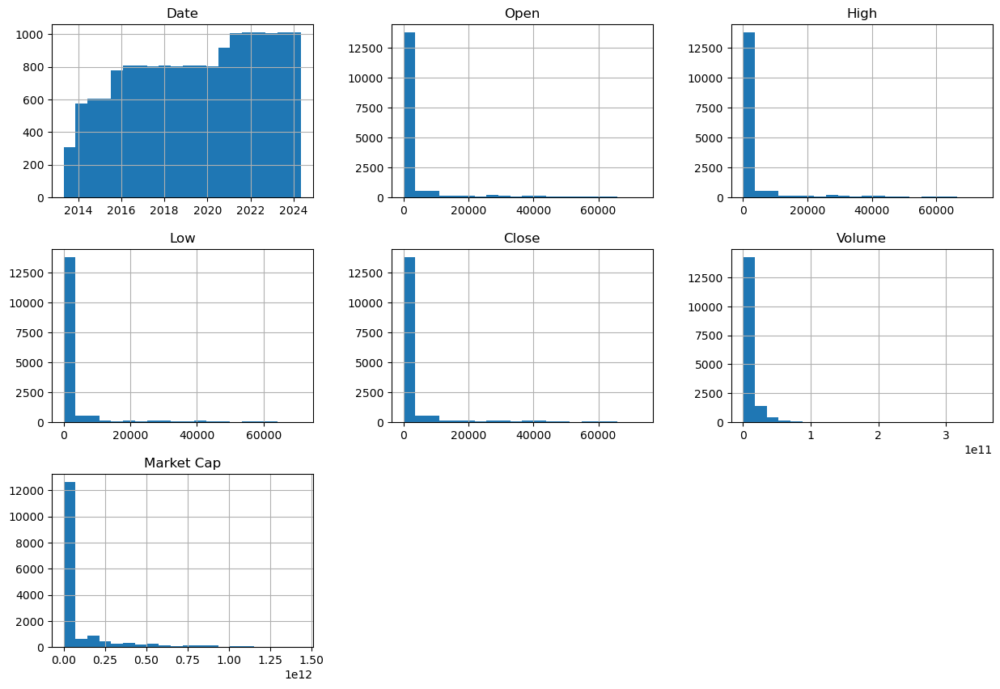

In [12]:
merged_df.hist(bins=20, figsize=(15, 10))

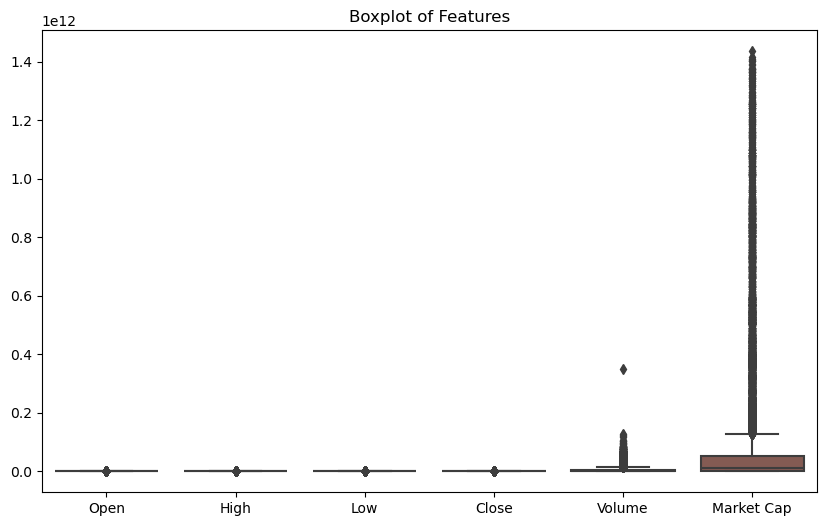

In [13]:
import seaborn as sns

# Boxplot to visualize outliers
plt.figure(figsize=(10, 6))
sns.boxplot(data=merged_df)
plt.title('Boxplot of Features')
plt.show()

In [14]:
merged_df.columns

Index(['Date', 'Open', 'High', 'Low', 'Close', 'Volume', 'Market Cap',
       'Time Open', 'Time High', 'Time Low', 'Time Close', 'name'],
      dtype='object')

In [15]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16291 entries, 0 to 16290
Data columns (total 12 columns):
 #   Column      Non-Null Count  Dtype         
---  ------      --------------  -----         
 0   Date        16291 non-null  datetime64[ns]
 1   Open        16291 non-null  float64       
 2   High        16291 non-null  float64       
 3   Low         16291 non-null  float64       
 4   Close       16291 non-null  float64       
 5   Volume      16291 non-null  float64       
 6   Market Cap  16291 non-null  float64       
 7   Time Open   16291 non-null  object        
 8   Time High   16291 non-null  object        
 9   Time Low    16291 non-null  object        
 10  Time Close  16291 non-null  object        
 11  name        16291 non-null  object        
dtypes: datetime64[ns](1), float64(6), object(5)
memory usage: 1.5+ MB


# change the Date format to unix 

In [16]:
# Assuming 'datetime64' is a column in your DataFrame
merged_df['Date'] = (merged_df['Date'].astype(np.int64) // 10**9).astype(np.int64)

In [17]:
merged_df

,Date,Open,High,Low,Close,Volume,Market Cap,Time Open,Time High,Time Low,Time Close,name
0,1715472000,60793.502025,61818.154883,60632.602445,61448.394672,1.380046e+10,1.210436e+12,2024-05-12T00:00:00.000Z,2024-05-12T16:22:00.000Z,2024-05-12T07:35:00.000Z,2024-05-12T23:59:59.999Z,btc
1,1715385600,60793.357007,61451.153731,60492.625374,60793.709599,1.384227e+10,1.197453e+12,2024-05-11T00:00:00.000Z,2024-05-11T15:19:00.000Z,2024-05-11T11:18:00.000Z,2024-05-11T23:59:59.999Z,btc
2,1715299200,63055.190995,63446.742515,60208.781547,60792.776791,2.780495e+10,1.197421e+12,2024-05-10T00:00:00.000Z,2024-05-10T12:05:00.000Z,2024-05-10T17:52:00.000Z,2024-05-10T23:59:59.999Z,btc
3,1715212800,61191.200531,63404.915301,60648.075424,63049.959257,2.545334e+10,1.241942e+12,2024-05-09T00:00:00.000Z,2024-05-09T22:53:00.000Z,2024-05-09T11:05:00.000Z,2024-05-09T23:59:59.999Z,btc
4,1715126400,62332.642508,62986.084242,60877.127524,61187.941401,2.608817e+10,1.205202e+12,2024-05-08T00:00:00.000Z,2024-05-08T04:22:00.000Z,2024-05-08T23:24:00.000Z,2024-05-08T23:59:59.999Z,btc
...,...,...,...,...,...,...,...,...,...,...,...,...
16286,1375920000,0.004397,0.004424,0.004175,0.004254,0.000000e+00,3.325863e+07,2013-08-08T00:00:00.000Z,2013-08-08T00:06:03.000Z,2013-08-08T15:21:04.000Z,2013-08-08T23:59:59.999Z,xrp
16287,1375833600,0.004669,0.004682,0.004333,0.004417,0.000000e+00,3.453412e+07,2013-08-07T00:00:00.000Z,2013-08-07T04:01:18.000Z,2013-08-07T12:46:19.000Z,2013-08-07T23:59:59.999Z,xrp
16288,1375747200,0.005637,0.005661,0.004629,0.004680,0.000000e+00,3.659101e+07,2013-08-06T00:00:00.000Z,2013-08-06T01:26:06.000Z,2013-08-06T20:51:06.000Z,2013-08-06T23:59:59.999Z,xrp
16289,1375660800,0.005875,0.005980,0.005613,0.005613,0.000000e+00,4.387916e+07,2013-08-05T00:00:00.000Z,2013-08-05T03:21:05.000Z,2013-08-05T23:56:05.000Z,2013-08-05T23:59:59.999Z,xrp


In [18]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16291 entries, 0 to 16290
Data columns (total 12 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Date        16291 non-null  int64  
 1   Open        16291 non-null  float64
 2   High        16291 non-null  float64
 3   Low         16291 non-null  float64
 4   Close       16291 non-null  float64
 5   Volume      16291 non-null  float64
 6   Market Cap  16291 non-null  float64
 7   Time Open   16291 non-null  object 
 8   Time High   16291 non-null  object 
 9   Time Low    16291 non-null  object 
 10  Time Close  16291 non-null  object 
 11  name        16291 non-null  object 
dtypes: float64(6), int64(1), object(5)
memory usage: 1.5+ MB


In [19]:
# Convert datetime to Unix timestamp
date_columns = ['Time Open', 'Time High', 'Time Low', 'Time Close']
for column in date_columns:
    merged_df[column] = pd.to_datetime(merged_df[column]).astype(int) // 10**9  # Convert nanoseconds to seconds

# Now all date and time columns are converted to numerical format
print(merged_df.dtypes)


Date            int64
Open          float64
High          float64
Low           float64
Close         float64
Volume        float64
Market Cap    float64
Time Open       int64
Time High       int64
Time Low        int64
Time Close      int64
name           object
dtype: object


In [20]:
from sklearn.preprocessing import LabelEncoder

# Initialize LabelEncoder
label_encoder = LabelEncoder()

# Fit and transform the "name" column
merged_df['name'] = label_encoder.fit_transform(merged_df['name'])

# Display the mapping between original labels and encoded labels
print("Mapping of original labels to encoded labels:")
for index, label in enumerate(label_encoder.classes_):
    print(f"{label}: {index}")

# Display the first few rows of the dataframe with the encoded column
print(merged_df.head())


Mapping of original labels to encoded labels:
aave: 0
btc: 1
doge: 2
eth: 3
xrp: 4
         Date          Open          High           Low         Close  \
0  1715472000  60793.502025  61818.154883  60632.602445  61448.394672   
1  1715385600  60793.357007  61451.153731  60492.625374  60793.709599   
2  1715299200  63055.190995  63446.742515  60208.781547  60792.776791   
3  1715212800  61191.200531  63404.915301  60648.075424  63049.959257   
4  1715126400  62332.642508  62986.084242  60877.127524  61187.941401   

         Volume    Market Cap   Time Open   Time High    Time Low  Time Close  \
0  1.380046e+10  1.210436e+12  1715472000  1715530920  1715499300  1715558399   
1  1.384227e+10  1.197453e+12  1715385600  1715440740  1715426280  1715471999   
2  2.780495e+10  1.197421e+12  1715299200  1715342700  1715363520  1715385599   
3  2.545334e+10  1.241942e+12  1715212800  1715295180  1715252700  1715299199   
4  2.608817e+10  1.205202e+12  1715126400  1715142120  1715210640  171521

In [21]:
merged_df.tail

<bound method NDFrame.tail of              Date          Open          High           Low         Close  \
0      1715472000  60793.502025  61818.154883  60632.602445  61448.394672   
1      1715385600  60793.357007  61451.153731  60492.625374  60793.709599   
2      1715299200  63055.190995  63446.742515  60208.781547  60792.776791   
3      1715212800  61191.200531  63404.915301  60648.075424  63049.959257   
4      1715126400  62332.642508  62986.084242  60877.127524  61187.941401   
...           ...           ...           ...           ...           ...   
16286  1375920000      0.004397      0.004424      0.004175      0.004254   
16287  1375833600      0.004669      0.004682      0.004333      0.004417   
16288  1375747200      0.005637      0.005661      0.004629      0.004680   
16289  1375660800      0.005875      0.005980      0.005613      0.005613   
16290  1375574400      0.005874      0.005927      0.005874      0.005882   

             Volume    Market Cap   Time Open

In [22]:
correlation_matrix = merged_df.corr()

In [23]:
correlation_matrix

,Date,Open,High,Low,Close,Volume,Market Cap,Time Open,Time High,Time Low,Time Close,name
Date,1.000000,0.284897,0.284230,0.285936,0.284938,0.332076,0.380815,1.000000,1.000000,1.000000,1.000000,-0.122980
Open,0.284897,1.000000,0.999703,0.999489,0.999308,0.701654,0.950270,0.284897,0.284905,0.284898,0.284897,-0.317484
High,0.284230,0.999703,1.000000,0.999406,0.999697,0.705001,0.950644,0.284230,0.284239,0.284230,0.284230,-0.317415
Low,0.285936,0.999489,0.999406,1.000000,0.999638,0.695636,0.950600,0.285936,0.285945,0.285936,0.285936,-0.317763
Close,0.284938,0.999308,0.999697,0.999638,1.000000,0.700827,0.950946,0.284938,0.284948,0.284937,0.284938,-0.317551
Volume,0.332076,0.701654,0.705001,0.695636,0.700827,1.000000,0.748294,0.332076,0.332085,0.332070,0.332076,-0.184744
Market Cap,0.380815,0.950270,0.950644,0.950600,0.950946,0.748294,1.000000,0.380815,0.380827,0.380813,0.380815,-0.228376
Time Open,1.000000,0.284897,0.284230,0.285936,0.284938,0.332076,0.380815,1.000000,1.000000,1.000000,1.000000,-0.122980
Time High,1.000000,0.284905,0.284239,0.285945,0.284948,0.332085,0.380827,1.000000,1.000000,1.000000,1.000000,-0.122989
Time Low,1.000000,0.284898,0.284230,0.285936,0.284937,0.332070,0.380813,1.000000,1.000000,1.000000,1.000000,-0.122972


In [24]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16291 entries, 0 to 16290
Data columns (total 12 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Date        16291 non-null  int64  
 1   Open        16291 non-null  float64
 2   High        16291 non-null  float64
 3   Low         16291 non-null  float64
 4   Close       16291 non-null  float64
 5   Volume      16291 non-null  float64
 6   Market Cap  16291 non-null  float64
 7   Time Open   16291 non-null  int64  
 8   Time High   16291 non-null  int64  
 9   Time Low    16291 non-null  int64  
 10  Time Close  16291 non-null  int64  
 11  name        16291 non-null  int64  
dtypes: float64(6), int64(6)
memory usage: 1.5 MB


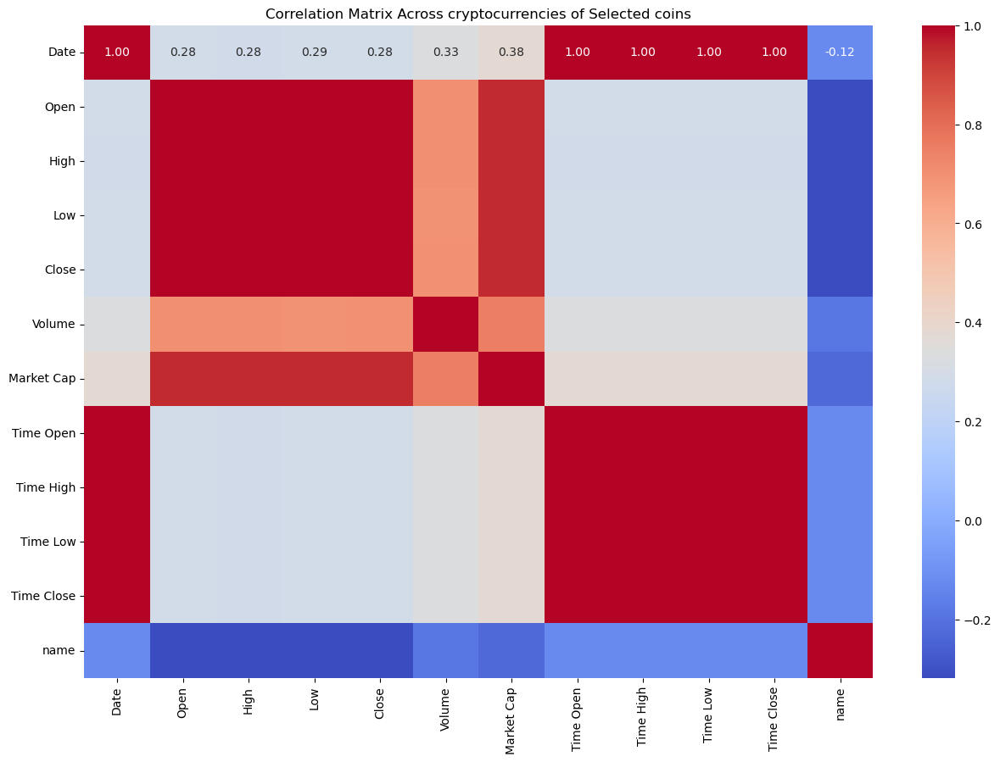

In [25]:
# fig, ax = plt.subplots(figsize=(10, 10))
# sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5, fmt='.1g')



plt.figure(figsize=(15, 10))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm')
plt.title('Correlation Matrix Across cryptocurrencies of Selected coins')
plt.show()

# Time open and Time close are dropped as it is repetitive in all rows

array([[<Axes: title={'center': 'Date'}>,
        <Axes: title={'center': 'Open'}>,
        <Axes: title={'center': 'High'}>],
       [<Axes: title={'center': 'Low'}>,
        <Axes: title={'center': 'Close'}>,
        <Axes: title={'center': 'Volume'}>],
       [<Axes: title={'center': 'Market Cap'}>,
        <Axes: title={'center': 'Time High'}>,
        <Axes: title={'center': 'Time Low'}>],
       [<Axes: title={'center': 'name'}>, <Axes: >, <Axes: >]],
      dtype=object)

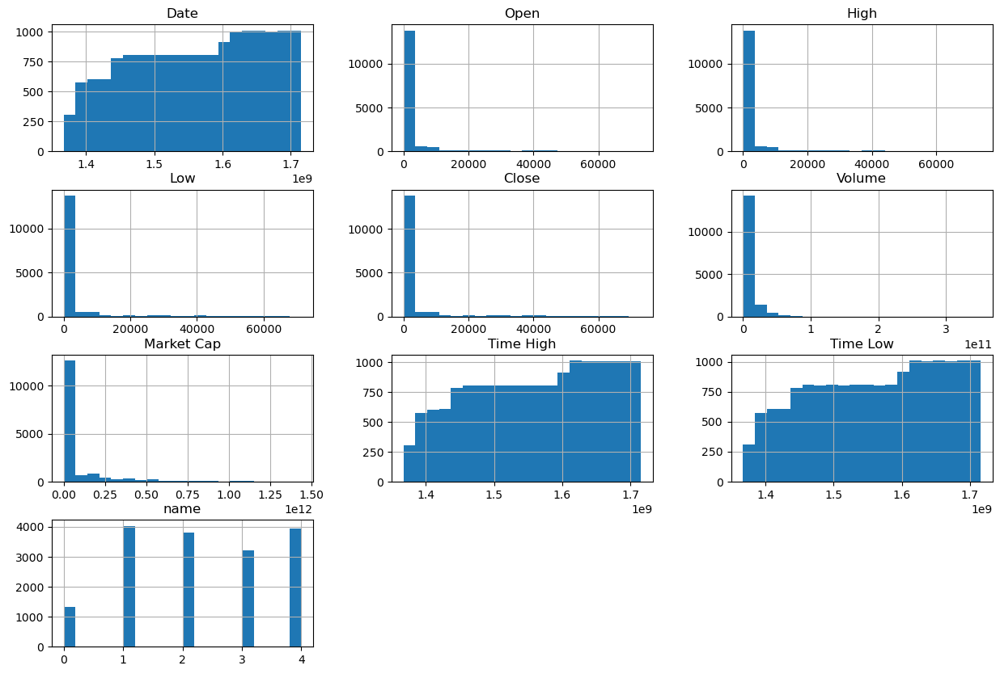

In [26]:
merged_df = merged_df.drop(['Time Open','Time Close'], axis=1)
merged_df.hist(bins=20, figsize=(15, 10))

In [27]:
# Log transformation - for normalization(skew)
# merged_log = np.log1p(merged_df['Date', 'Open', 'High' , 'Low' , 'Close', 'Volume', 'Market Cap', 'Time High', 'Time Low'])       

columns_to_transform = ['Date', 'Open', 'High', 'Low', 'Close', 'Volume', 'Market Cap', 'Time High', 'Time Low']
merged_log = merged_df.copy()  # Create a copy of the DataFrame to avoid modifying the original data

# Apply log transformation to each numerical column
for column in columns_to_transform:
    merged_log[column] = np.log1p(merged_df[column])

# Check the transformed DataFrame
print(merged_log.head())


        Date       Open       High        Low      Close     Volume  \
0  21.262954  11.015255  11.031969  11.012605  11.025969  23.347968   
1  21.262904  11.015252  11.026014  11.010293  11.015258  23.350993   
2  21.262853  11.051782  11.057972  11.005590  11.015243  24.048480   
3  21.262803  11.021775  11.057312  11.012860  11.051699  23.960113   
4  21.262753  11.040257  11.050685  11.016629  11.021722  23.984748   

   Market Cap  Time High   Time Low  name  
0   27.822002  21.262988  21.262970     1  
1   27.811218  21.262936  21.262927     1  
2   27.811191  21.262879  21.262891     1  
3   27.847698  21.262851  21.262826     1  
4   27.817668  21.262762  21.262802     1  


In [28]:
merged_df.describe()

,Date,Open,High,Low,Close,Volume,Market Cap,Time High,Time Low,name
count,1.629100e+04,16291.000000,16291.000000,16291.000000,16291.000000,1.629100e+04,1.629100e+04,1.629100e+04,1.629100e+04,16291.000000
mean,1.561190e+09,3724.360257,3812.567365,3629.660888,3728.002214,6.020875e+09,9.447296e+10,1.561230e+09,1.561230e+09,2.270149
std,9.627966e+07,10621.261851,10871.293349,10347.117321,10629.624624,1.218163e+10,2.088856e+11,9.628105e+07,9.628037e+07,1.288902
min,1.367107e+09,0.000000,0.000089,0.000000,0.000087,0.000000e+00,0.000000e+00,1.367110e+09,1.367154e+09,0.000000
25%,1.480118e+09,0.060361,0.061648,0.058753,0.060443,1.877418e+07,6.612212e+08,1.480127e+09,1.480175e+09,1.000000
50%,1.568074e+09,11.333200,11.680000,11.007400,11.349500,4.724415e+08,1.083560e+10,1.568079e+09,1.568145e+09,2.000000
75%,1.645142e+09,769.215485,782.525513,743.235504,770.982513,5.673720e+09,5.079016e+10,1.645169e+09,1.645204e+09,3.000000
max,1.715472e+09,73079.373379,73750.073850,71334.092382,73083.501328,3.509679e+11,1.436272e+12,1.715531e+09,1.715549e+09,4.000000


array([[<Axes: title={'center': 'Date'}>,
        <Axes: title={'center': 'Open'}>,
        <Axes: title={'center': 'High'}>],
       [<Axes: title={'center': 'Low'}>,
        <Axes: title={'center': 'Close'}>,
        <Axes: title={'center': 'Volume'}>],
       [<Axes: title={'center': 'Market Cap'}>,
        <Axes: title={'center': 'Time High'}>,
        <Axes: title={'center': 'Time Low'}>],
       [<Axes: title={'center': 'name'}>, <Axes: >, <Axes: >]],
      dtype=object)

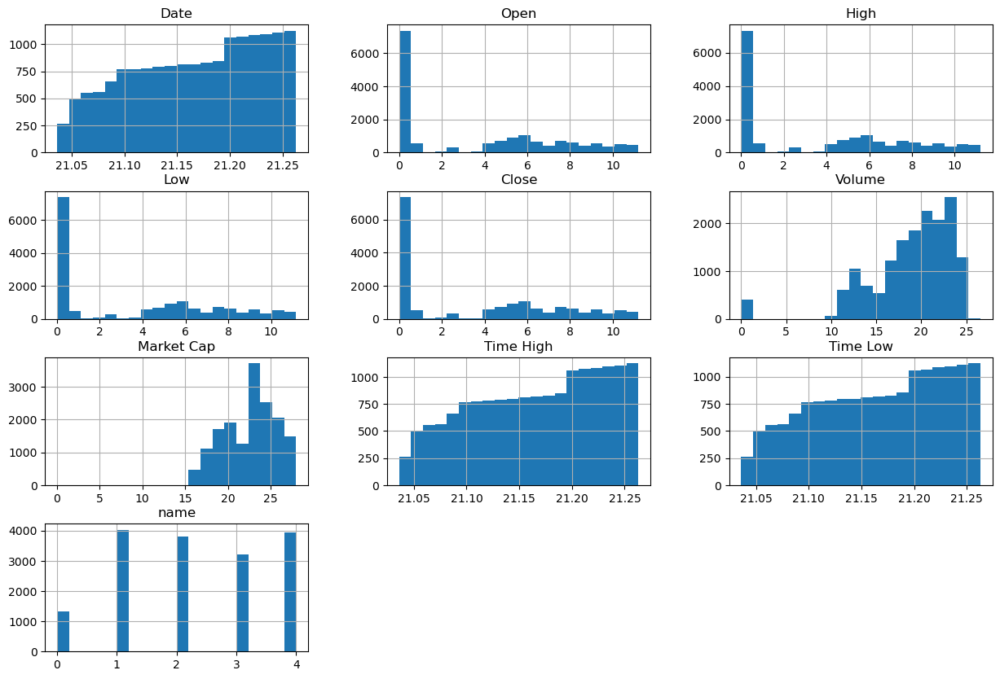

In [29]:
merged_log.hist(bins=20, figsize=(15, 10))

In [30]:
# normalisation is effective only in volume, market cap

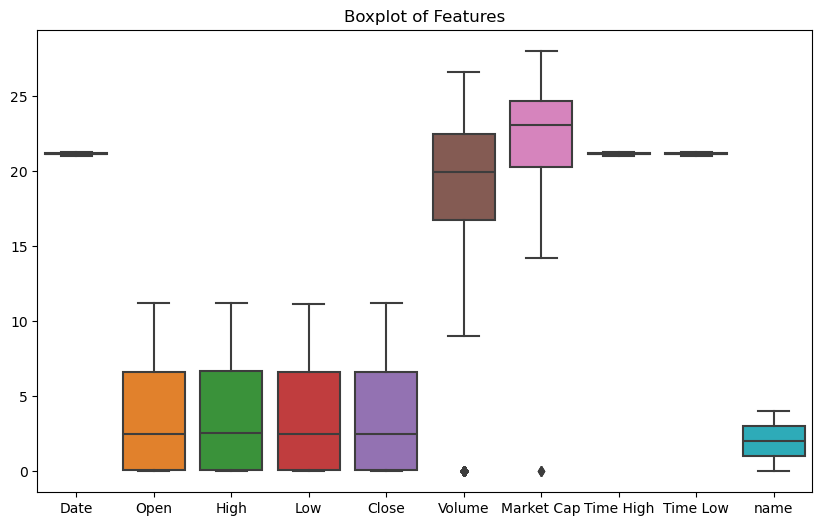

In [31]:
plt.figure(figsize=(10, 6))
sns.boxplot(data=merged_log)
plt.title('Boxplot of Features')
plt.show()

In [32]:
# dropping outliers and running the model
cols = ['Date', 'Open', 'High', 'Low', 'Close', 'Volume', 'Market Cap', 'Time High', 'Time Low','name']
Q1 = merged_log[cols].quantile(0.25)
Q3 = merged_log[cols].quantile(0.75)
IQR = Q3 - Q1

# Define the boundaries for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filter the DataFrame to remove outliers
condition = ((merged_log[cols] >= lower_bound) & (merged_log[cols] <= upper_bound)).all(axis=1)
merged_filtered = merged_log[cols][condition]

# merged_filtered = merged_log.loc[(merged_log[num_cols] >= lower_bound) & (merged_log[num_cols] <= upper_bound).all(axis=1)]

# Print the shape of the original and filtered DataFrame to see the effect of outlier removal
print("Original DataFrame shape:", merged_log[cols].shape)
print("Filtered DataFrame shape:", merged_filtered.shape)


Original DataFrame shape: (16291, 10)
Filtered DataFrame shape: (15888, 10)


/var/folders/f7/21z1m4md4f90_6ks13nlqklw0000gn/T/ipykernel_65050/1273034590.py:7: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared.
  merged_log[cols].hist(ax=axes[0], bins=20, color='blue', alpha=0.7)
/var/folders/f7/21z1m4md4f90_6ks13nlqklw0000gn/T/ipykernel_65050/1273034590.py:11: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared.
  merged_filtered.hist(ax=axes[1], bins=20, color='green', alpha=0.7)


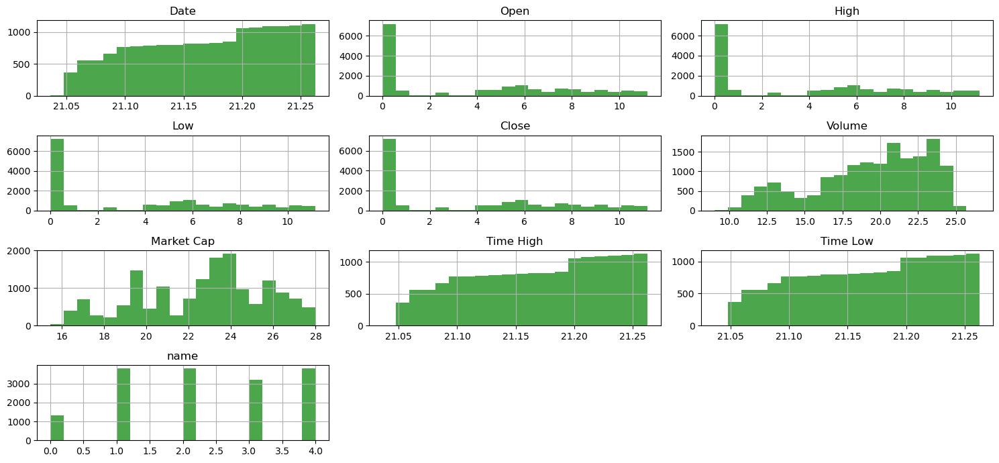

In [33]:
import matplotlib.pyplot as plt

# Set up subplots
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 7))

# Plot histograms for merged_log[cols]
merged_log[cols].hist(ax=axes[0], bins=20, color='blue', alpha=0.7)
axes[0].set_title('Histogram for merged_log[cols]')

# Plot histograms for merged_filtered
merged_filtered.hist(ax=axes[1], bins=20, color='green', alpha=0.7)
axes[1].set_title('Histogram for merged_filtered')

plt.tight_layout()
plt.show()


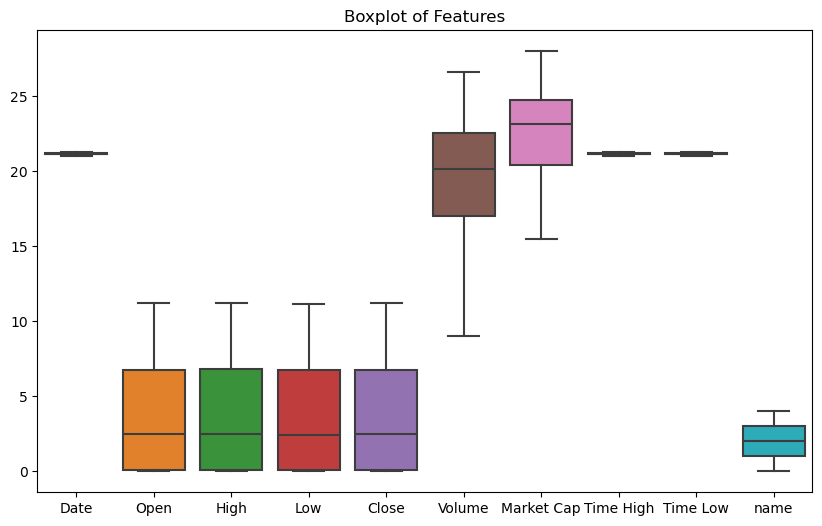

In [34]:
# print number of outliers -16276-15873 = 403 = 2.47% removed
plt.figure(figsize=(10, 6))
sns.boxplot(data=merged_filtered)
plt.title('Boxplot of Features')
plt.show()

In [35]:
cols = ['Date', 'Open', 'High', 'Low', 'Close', 'Volume', 'Market Cap', 'Time High', 'Time Low']
scaler = MinMaxScaler()
scaled_coins_df = pd.DataFrame(scaler.fit_transform(merged_filtered[cols]), columns=merged_filtered[cols].columns, index=merged_filtered[cols].index)

scaled_coins_df['name'] = merged_filtered['name']

In [36]:
# run the model including scaling
scaled_coins_df

,Date,Open,High,Low,Close,Volume,Market Cap,Time High,Time Low,name
0,1.000000,0.983565,0.984254,0.985455,0.984517,0.815696,0.986346,1.000000,0.999872,1
1,0.999778,0.983565,0.983723,0.985248,0.983560,0.815869,0.985486,0.999768,0.999684,1
2,0.999556,0.986826,0.986574,0.984828,0.983559,0.855594,0.985484,0.999517,0.999523,1
3,0.999334,0.984147,0.986516,0.985478,0.986814,0.850561,0.988397,0.999395,0.999238,1
4,0.999112,0.985797,0.985924,0.985815,0.984137,0.851964,0.986000,0.999001,0.999130,1
...,...,...,...,...,...,...,...,...,...,...
16141,0.068239,0.002430,0.002433,0.002378,0.002400,0.115884,0.296593,0.068404,0.068134,4
16142,0.067965,0.002376,0.002434,0.002375,0.002411,0.123431,0.296972,0.068183,0.067821,4
16143,0.067690,0.002398,0.002416,0.002344,0.002390,0.109397,0.296264,0.067820,0.067750,4
16144,0.067416,0.002419,0.002465,0.002344,0.002397,0.162172,0.296515,0.067536,0.067469,4


array([[<Axes: title={'center': 'Date'}>,
        <Axes: title={'center': 'Open'}>,
        <Axes: title={'center': 'High'}>],
       [<Axes: title={'center': 'Low'}>,
        <Axes: title={'center': 'Close'}>,
        <Axes: title={'center': 'Volume'}>],
       [<Axes: title={'center': 'Market Cap'}>,
        <Axes: title={'center': 'Time High'}>,
        <Axes: title={'center': 'Time Low'}>],
       [<Axes: title={'center': 'name'}>, <Axes: >, <Axes: >]],
      dtype=object)

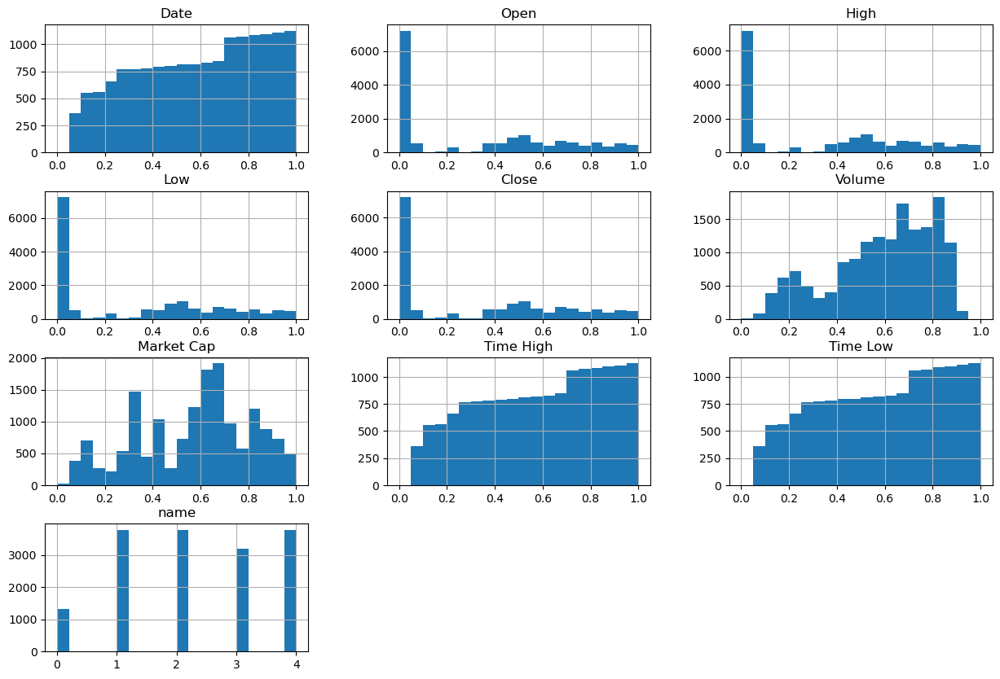

In [37]:
scaled_coins_df.hist(bins=20, figsize=(15, 10))

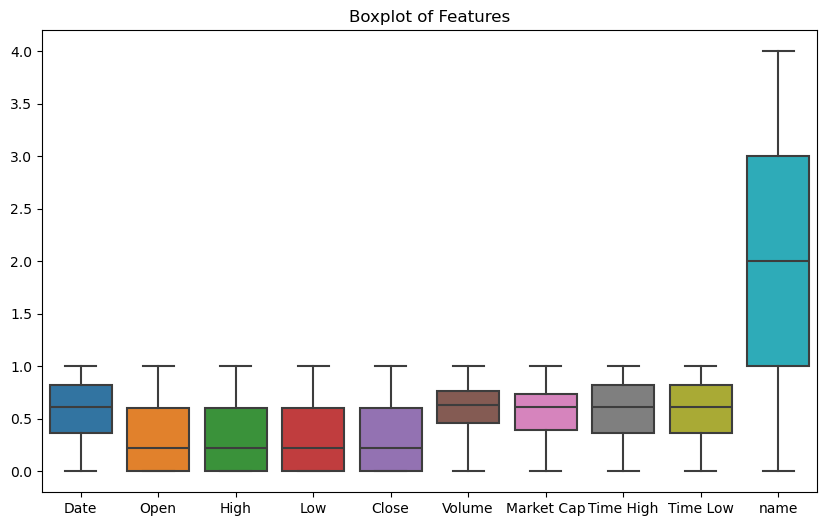

In [38]:
plt.figure(figsize=(10, 6))
sns.boxplot(data=scaled_coins_df)
plt.title('Boxplot of Features')
plt.show()

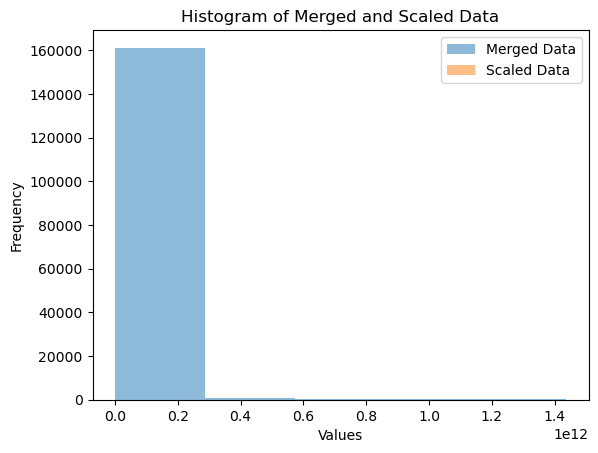

In [39]:
import matplotlib.pyplot as plt

# Plot histogram for merged_df
plt.hist(merged_df.values.flatten(), bins=5, alpha=0.5, label='Merged Data')

# Plot histogram for scaled_df
plt.hist(scaled_coins_df.values.flatten(), bins=5, alpha=0.5, label='Scaled Data')

# Add labels and title
plt.xlabel('Values')
plt.ylabel('Frequency')
plt.title('Histogram of Merged and Scaled Data')
plt.legend()

# Show plot
plt.show()


In [41]:
X = scaled_coins_df.drop('High', axis=1)
Y = scaled_coins_df['High']

In [42]:
X

,Date,Open,Low,Close,Volume,Market Cap,Time High,Time Low,name
0,1.000000,0.983565,0.985455,0.984517,0.815696,0.986346,1.000000,0.999872,1
1,0.999778,0.983565,0.985248,0.983560,0.815869,0.985486,0.999768,0.999684,1
2,0.999556,0.986826,0.984828,0.983559,0.855594,0.985484,0.999517,0.999523,1
3,0.999334,0.984147,0.985478,0.986814,0.850561,0.988397,0.999395,0.999238,1
4,0.999112,0.985797,0.985815,0.984137,0.851964,0.986000,0.999001,0.999130,1
...,...,...,...,...,...,...,...,...,...
16141,0.068239,0.002430,0.002378,0.002400,0.115884,0.296593,0.068404,0.068134,4
16142,0.067965,0.002376,0.002375,0.002411,0.123431,0.296972,0.068183,0.067821,4
16143,0.067690,0.002398,0.002344,0.002390,0.109397,0.296264,0.067820,0.067750,4
16144,0.067416,0.002419,0.002344,0.002397,0.162172,0.296515,0.067536,0.067469,4


In [43]:
Y

0        0.984254
1        0.983723
2        0.986574
3        0.986516
4        0.985924
           ...   
16141    0.002433
16142    0.002434
16143    0.002416
16144    0.002465
16145    0.002380
Name: High, Length: 15888, dtype: float64

In [44]:
X.shape

(15888, 9)

In [45]:
Y.shape

(15888,)

In [46]:
from sklearn.model_selection import train_test_split

X = X.values.reshape(X.shape[0], 1, X.shape[1])

X_train, X_temp, Y_train, Y_temp = train_test_split(X, Y, test_size=0.2, random_state=42)
X_val, X_test, Y_val, Y_test = train_test_split(X_temp, Y_temp, test_size=0.5, random_state=42)

# Reshape Y_train, Y_val, and Y_test to have the same sequence length as X_train, X_val, and X_test
Y_train_reshaped = np.reshape(Y_train, (Y_train.shape[0], 1, 1))
Y_val_reshaped = np.reshape(Y_val, (Y_val.shape[0], 1, 1))
Y_test_reshaped = np.reshape(Y_test, (Y_test.shape[0], 1, 1))


In [47]:
print("X train shape:", X_train.shape)
print("Y train reshaped shape:", Y_train_reshaped.shape)
print("Y validation reshaped shape:", Y_val_reshaped.shape)

X train shape: (12710, 1, 9)
Y train reshaped shape: (12710, 1, 1)
Y validation reshaped shape: (1589, 1, 1)


In [48]:
print(Y_val_reshaped)

[[[6.36075121e-06]]

 [[3.51112073e-02]]

 [[6.06023589e-02]]

 ...

 [[2.92139394e-04]]

 [[2.83854774e-02]]

 [[9.21022444e-01]]]


In [49]:
print(Y_train_reshaped)

[[[1.93047232e-02]]

 [[9.76753279e-01]]

 [[6.06127074e-02]]

 ...

 [[9.60768663e-01]]

 [[9.35410392e-04]]

 [[3.77532991e-01]]]


# without hyperparameter grid

In [65]:
from keras.models import Sequential
from keras.layers import LSTM, Dropout, Dense
from sklearn.metrics import mean_squared_error, r2_score
import numpy as np
import pandas as pd

# Function to create LSTM model with specified hyperparameters
def create_lstm_model(units=50, dropout_rate=0.2, optimizer='adam', num_layers=1, look_back=10):
    model = Sequential()
    model.add(LSTM(units=units, return_sequences=(num_layers > 1), input_shape=(look_back, X_train.shape[2])))
    model.add(Dropout(dropout_rate))
    if num_layers > 1:
        for i in range(1, num_layers):
            model.add(LSTM(units=units, return_sequences=(i < num_layers - 1)))
            model.add(Dropout(dropout_rate))
    model.add(Dense(units=1))
    model.compile(optimizer=optimizer, loss='mean_squared_error')
    return model

# Parameters are now fixed; no grid
units = 50
dropout_rate = 0.2
optimizer = 'adam'
num_layers = 1
look_back = 10

# Prepare and create the model
model = create_lstm_model(units, dropout_rate, optimizer, num_layers, look_back)

# Fit the model on the training data
model.fit(X_train, Y_train_reshaped, epochs=25, batch_size=32, verbose=0, validation_data=(X_val, Y_val_reshaped))

# Predictions for train and test
Y_train_pred = model.predict(X_train)
Y_test_pred = model.predict(X_test)

# Evaluation on training data
mse_train = mean_squared_error(Y_train, Y_train_pred)
r2_train = r2_score(Y_train, Y_train_pred)

# Evaluation on testing data
mse_test = mean_squared_error(Y_test, Y_test_pred)
r2_test = r2_score(Y_test, Y_test_pred)

# Label data from last feature assuming it is one-hot encoded or label encoded
train_labels = label_encoder.inverse_transform(X_train[:, 0, -1].astype(int))
test_labels = label_encoder.inverse_transform(X_test[:, 0, -1].astype(int))

# Unique labels
train_unique_labels = np.unique(train_labels)
test_unique_labels = np.unique(test_labels)

# Printing the evaluation metrics
print("Training Data Evaluation Metrics:")
for label in train_unique_labels:
    label_indices = train_labels == label
    print(f"{label} - MSE: {mean_squared_error(Y_train[label_indices], Y_train_pred[label_indices])}, R-squared: {r2_score(Y_train[label_indices], Y_train_pred[label_indices])}")

print("\nTesting Data Evaluation Metrics:")
for label in test_unique_labels:
    label_indices = test_labels == label
    print(f"{label} - MSE: {mean_squared_error(Y_test[label_indices], Y_test_pred[label_indices])}, R-squared: {r2_score(Y_test[label_indices], Y_test_pred[label_indices])}")

print("\nOverall Training MSE:", mse_train)
print("Overall Training R-squared:", r2_train)
print("Overall Testing MSE:", mse_test)
print("Overall Testing R-squared:", r2_test)


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


398/398 ━━━━━━━━━━━━━━━━━━━━ 0s 319us/step
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 226us/step
Training Data Evaluation Metrics:
aave - MSE: 5.635926039506119e-05, R-squared: 0.9848315180313939
btc - MSE: 4.104554809050524e-05, R-squared: 0.9984342712570934
doge - MSE: 5.1470987497793845e-06, R-squared: 0.8788054123200105
eth - MSE: 1.3675521128846699e-05, R-squared: 0.9996152392721037
xrp - MSE: 1.558244199055515e-05, R-squared: 0.9667786211141963

Testing Data Evaluation Metrics:
aave - MSE: 5.667538941977646e-05, R-squared: 0.982718626029958
btc - MSE: 4.02025553922127e-05, R-squared: 0.9984571608197897
doge - MSE: 5.338673370787412e-06, R-squared: 0.8427332284540333
eth - MSE: 1.669147505371982e-05, R-squared: 0.9995352952556935
xrp - MSE: 1.73959828265408e-05, R-squared: 0.9648795471937436

Overall Training MSE: 2.2201791579618097e-05
Overall Training R-squared: 0.9998039017814306
Overall Testing MSE: 2.3329965536391755e-05
Overall Testing R-squared: 0.9997915487707437


# HYPER PARAMETER 

In [66]:
from keras.models import Sequential
from keras.layers import LSTM, Dropout, Dense
from sklearn.model_selection import ParameterGrid
from sklearn.metrics import r2_score

evaluation_metrics = {}

def create_lstm_model(units=50, dropout_rate=0.2, optimizer='adam',num_layers=1,look_back=10):
    model = Sequential()
    model.add(LSTM(units=units, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(units=units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(units=units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(units=1))
    model.compile(optimizer=optimizer, loss='mean_squared_error')
    return model



param_grid = {
    'units': [50, 100],
    'dropout_rate': [0.2, 0.5],
    'num_layers': [1, 2],
    'look_back': [10, 20],
    'optimizer': ['adam', 'rmsprop', 'sgd', 'adagrad']
}

# Create parameter grid
param_grid_list = list(ParameterGrid(param_grid))

# Perform grid search
best_score_mse = float('inf')
best_score_r2 = float('-inf')
best_params = None
for params in param_grid_list:
    print("Testing parameters:", params)
    model = create_lstm_model(**params)
    model.fit(X_train, Y_train_reshaped, epochs=25, batch_size=32, verbose=0, validation_data=(X_val, Y_val_reshaped))
    Y_pred = model.predict(X_test)
    mse = mean_squared_error(Y_test, Y_pred)
    r2 = r2_score(Y_test, Y_pred)

    name = X_test[:, :, -1] 
    name = name.astype(int)
    # Inverse transform the integer 'name' column
    original_name = label_encoder.inverse_transform(name.reshape(-1))
    evaluation_metrics[str(params)] = {'MSE': mse, 'R-squared': r2, 'Name': original_name}
    
    
    if mse < best_score_mse:
        best_score_mse = mse
        best_score_r2 = r2
        best_params = params
        
    print("Evaluation metrics with corresponding name labels:")
    for params_str, metrics_dict in evaluation_metrics.items():
        print("Parameters:", params_str)
        print("MSE:", metrics_dict['MSE'])
        print("R-squared:", metrics_dict['R-squared'])
        print("Name:", metrics_dict['Name'])
        print()

print("Best parameters:", best_params)
print("Best MSE:", best_score_mse)
print("Best R-squared:", best_score_r2)


Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Testing parameters: {'dropout_rate': 0.2, 'look_back':

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 28ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'n

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'n

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
MSE: 7.874116396087568e-05
R-squared: 0.9992964544934662
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
MSE: 0.0001913542827120217
R-squared: 0.9982902659932112
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}
MSE: 0.0013393857419397729
R-squared: 0.9880327039523396
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}
MSE: 3.091625285320653e-05
R-squared: 0.9997237659480809
Name: ['xrp' 'btc' 'doge' ... 'doge' 'doge' 'doge']

Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'nu

In [68]:
from keras.models import Sequential
from keras.layers import LSTM, Dropout, Dense
from sklearn.model_selection import ParameterGrid
from sklearn.metrics import mean_squared_error, r2_score
from keras.utils import to_categorical
import numpy as np
import pandas as pd

evaluation_metrics = {}

def create_lstm_model(units, dropout_rate, optimizer, num_layers, look_back):
    model = Sequential()
    model.add(LSTM(units=units, return_sequences=(num_layers > 1), input_shape=(look_back, X_train.shape[2])))
    model.add(Dropout(dropout_rate))
    if num_layers > 1:
        for _ in range(1, num_layers):
            model.add(LSTM(units=units, return_sequences=(_ < num_layers-1)))
            model.add(Dropout(dropout_rate))
    model.add(Dense(units=1))
    model.compile(optimizer=optimizer, loss='mean_squared_error')
    return model

param_grid = {
    'units': [50, 100],
    'dropout_rate': [0.2, 0.5],
    'num_layers': [1, 2],
    'look_back': [10, 20],
    'optimizer': ['adam', 'rmsprop', 'sgd', 'adagrad']
}

param_grid_list = list(ParameterGrid(param_grid))

best_score_mse = float('inf')
best_score_r2 = float('-inf')
best_params = None

for params in param_grid_list:
    print("Testing parameters:", params)
    model = create_lstm_model(**params)
    model.fit(X_train, Y_train_reshaped, epochs=25, batch_size=32, verbose=0, validation_data=(X_val, Y_val_reshaped))
    Y_pred = model.predict(X_test)

    original_names = label_encoder.inverse_transform(X_test[:, 0, -1].astype(int))
    unique_names = np.unique(original_names)

    metrics = {}
    for name in unique_names:
        mask = original_names == name
        mse = mean_squared_error(Y_test[mask], Y_pred[mask])
        r2 = r2_score(Y_test[mask], Y_pred[mask])
        metrics[name] = {'MSE': mse, 'R-squared': r2}

    evaluation_metrics[str(params)] = metrics

    if mse < best_score_mse:
        best_score_mse = mse
        best_score_r2 = r2
        best_params = params

print("Evaluation metrics with corresponding name labels:")
for params_str, metrics_dict in evaluation_metrics.items():
    print("Parameters:", params_str)
    for name, metrics in metrics_dict.items():
        print(f"  {name} - MSE: {metrics['MSE']}, R-squared: {metrics['R-squared']}")

print("Best parameters:", best_params)
print("Best MSE:", best_score_mse)
print("Best R-squared:", best_score_r2)


results_df = pd.DataFrame([(params, name, metrics['MSE'], metrics['R-squared']) for params, metrics_dict in evaluation_metrics.items() for name, metrics in metrics_dict.items()],
                          columns=['Parameters', 'Coin', 'MSE', 'R-squared'])

label_cols = ['aave', 'btc', 'doge', 'eth', 'xrp']
for label in label_cols:
    avg_mse = results_df[results_df['Coin'] == label]['MSE'].mean()
    avg_r2 = results_df[results_df['Coin'] == label]['R-squared'].mean()
    print(f"Average metrics for {label} - MSE: {avg_mse}, R-squared: {avg_r2}")

print("Overall Best Parameters:", results_df.loc[results_df['MSE'].idxmin(), 'Parameters'])
print("Overall Best MSE:", results_df['MSE'].min())
print("Overall Best R-squared:", results_df['R-squared'].max())

for label in label_cols:
    best_idx = results_df[results_df['Coin'] == label]['MSE'].idxmin()
    print(f"Best {label} Parameters:", results_df.loc[best_idx, 'Parameters'])
    print(f"Best {label} MSE:", results_df.loc[best_idx, 'MSE'])
    print(f"Best {label} R-squared:", results_df.loc[best_idx, 'R-squared'])

Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'sgd', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'sgd', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adagrad', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adagrad', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 2, 'optimizer': 'adam', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 2, 'optimizer': 'adam', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 2, 'optimizer': 'rmsprop', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 2, 'optimizer': 'rmsprop', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 2, 'optimizer': 'sgd', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 2, 'optimizer': 'sgd', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 2, 'optimizer': 'adagrad', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 2, 'optimizer': 'adagrad', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 1, 'optimizer': 'sgd', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 1, 'optimizer': 'sgd', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 1, 'optimizer': 'adagrad', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 1, 'optimizer': 'adagrad', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 2, 'optimizer': 'adam', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 2, 'optimizer': 'adam', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 2, 'optimizer': 'rmsprop', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 2, 'optimizer': 'rmsprop', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 2, 'optimizer': 'sgd', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 2, 'optimizer': 'sgd', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 2, 'optimizer': 'adagrad', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 2, 'optimizer': 'adagrad', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 1, 'optimizer': 'sgd', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 1, 'optimizer': 'sgd', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adagrad', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adagrad', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 2, 'optimizer': 'adam', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 2, 'optimizer': 'adam', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 2, 'optimizer': 'rmsprop', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 2, 'optimizer': 'rmsprop', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 2, 'optimizer': 'sgd', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 2, 'optimizer': 'sgd', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 2, 'optimizer': 'adagrad', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 2, 'optimizer': 'adagrad', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 1, 'optimizer': 'sgd', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 1, 'optimizer': 'sgd', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 1, 'optimizer': 'adagrad', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 1, 'optimizer': 'adagrad', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 2, 'optimizer': 'adam', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 2, 'optimizer': 'adam', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 2, 'optimizer': 'rmsprop', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 2, 'optimizer': 'rmsprop', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 2, 'optimizer': 'sgd', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 2, 'optimizer': 'sgd', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 2, 'optimizer': 'adagrad', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 2, 'optimizer': 'adagrad', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
  aave - MSE: 1.078624623220016e-05, R-squared: 0.9967110741226497
  btc - MSE: 1.3075110125776739e-05, R-squared: 0.999498221145626
  doge - MSE: 2.5494449714393102e-05, R-squared: 0.2489838728732272
  eth - MSE: 1.4981948948696489e-05, R-squared: 0.9995828899043967
  xrp - MSE: 5.298441231298995e-05, R-squared: 0.8930306743424381
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
  aave - MSE: 1.2761905940110378e-05, R-squared: 0.9961086589544528
  btc - MSE: 2.2604235765151443e-05, R-squared: 0.999132525277636
  doge - MSE: 8.88757732082766e-06, R-squared: 0.7381895285521904
  eth - MSE: 2.1299796172439823e-05, R-squared: 0.9994069957087532
  xrp - MSE: 1.4379703527571397e-05, R-squared: 0.970969061987258
Parameters: {'dropout_rate': 0.2, 'loo

Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


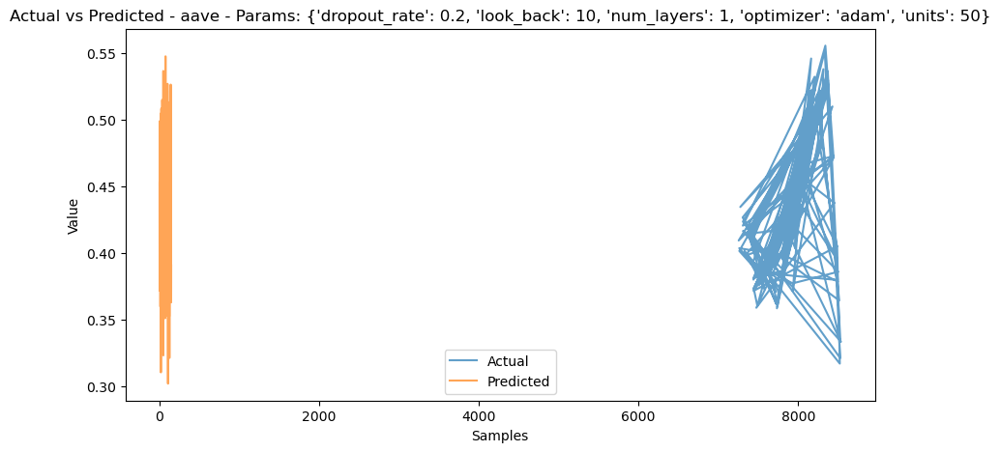

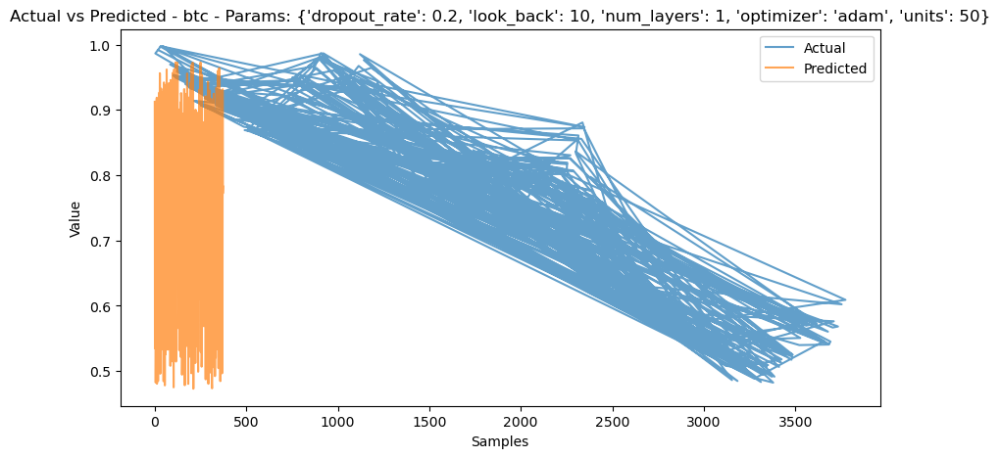

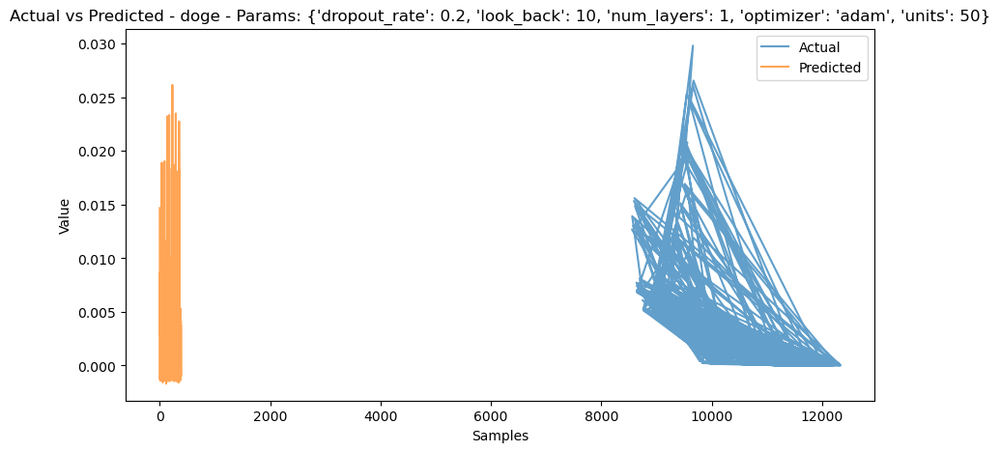

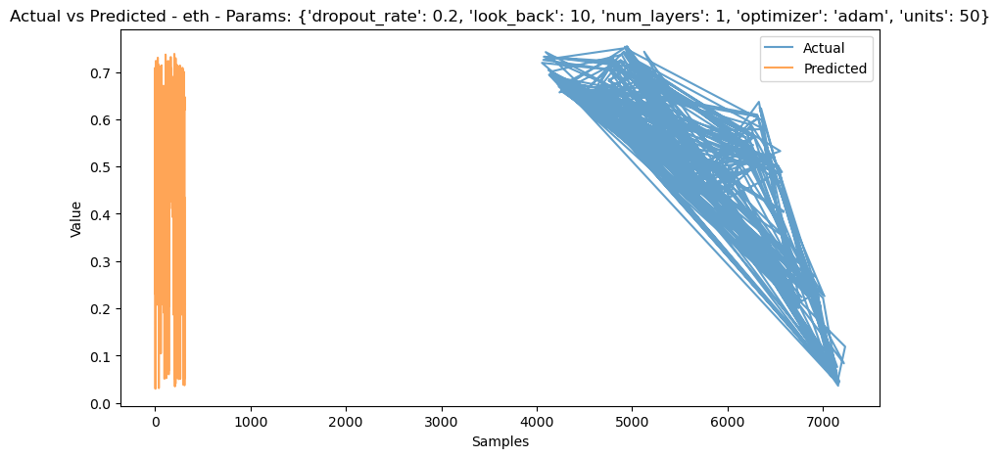

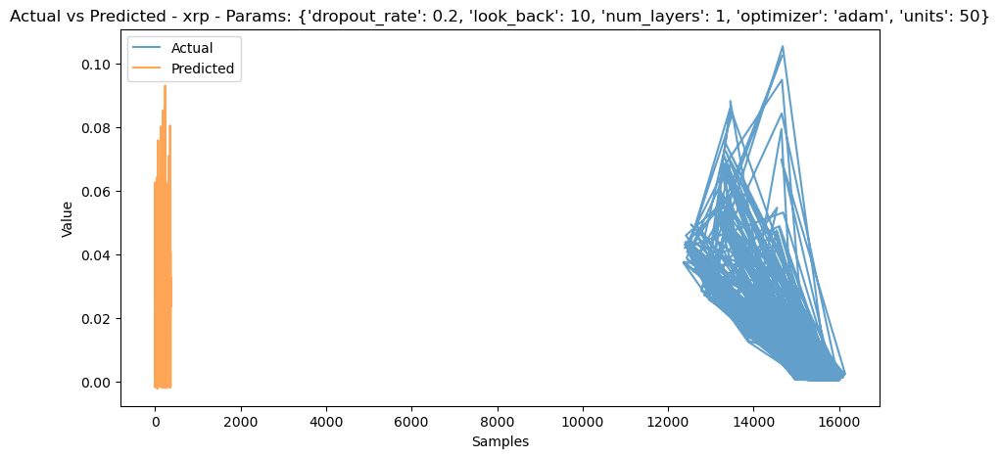

Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


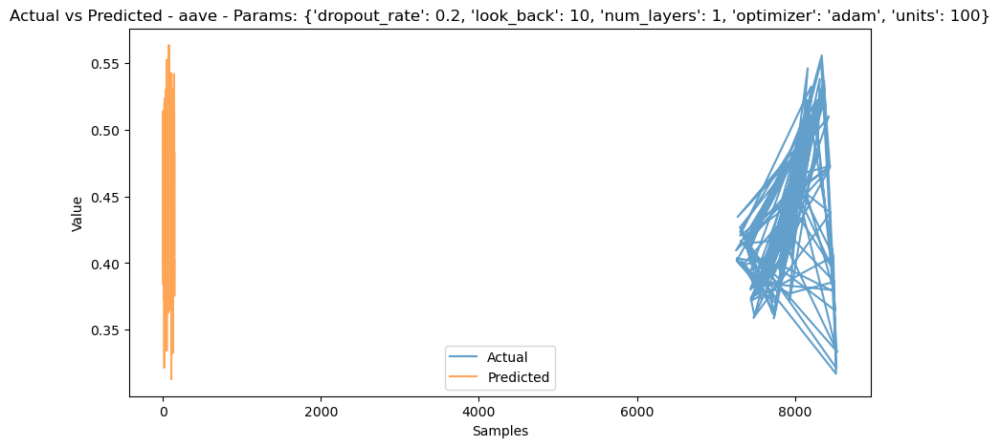

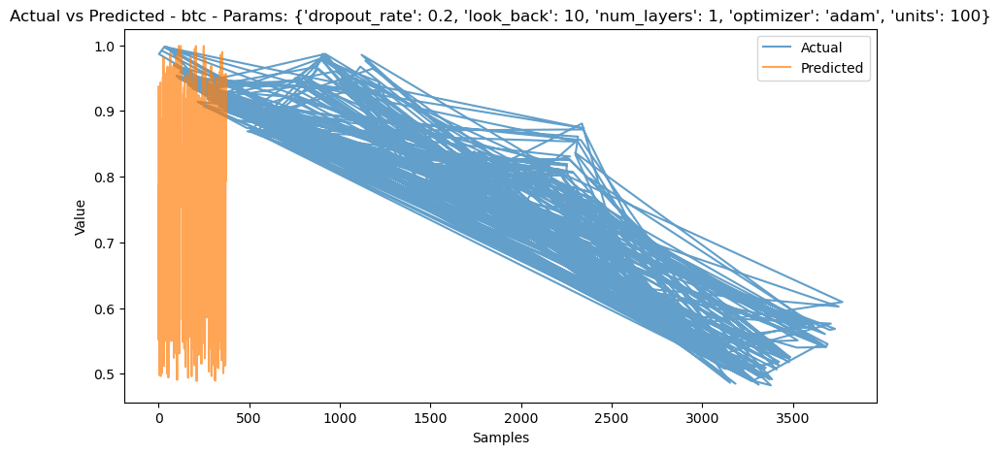

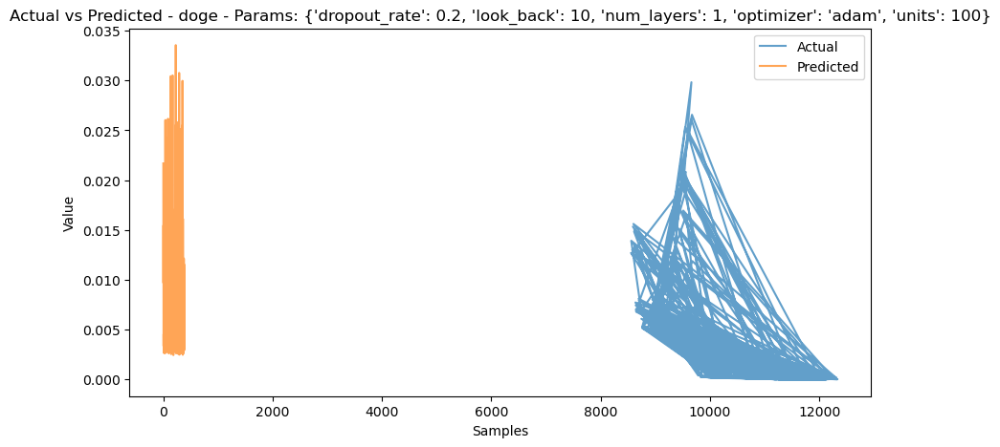

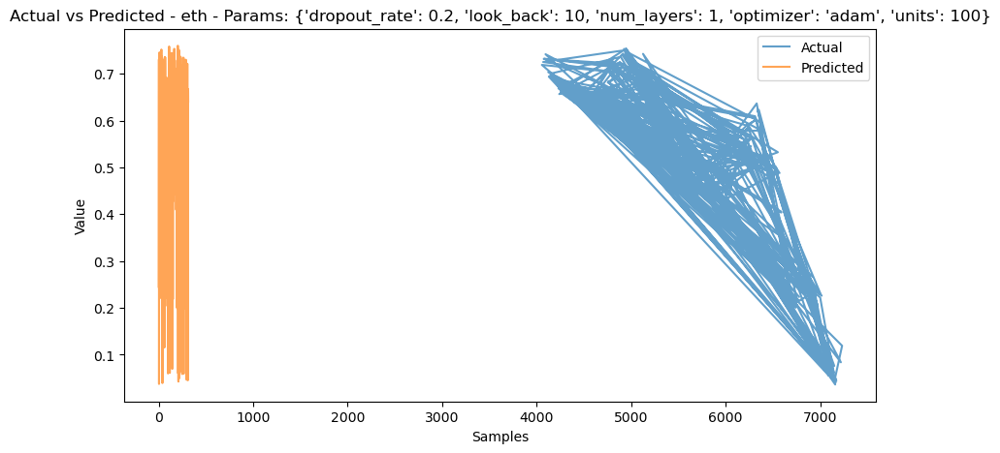

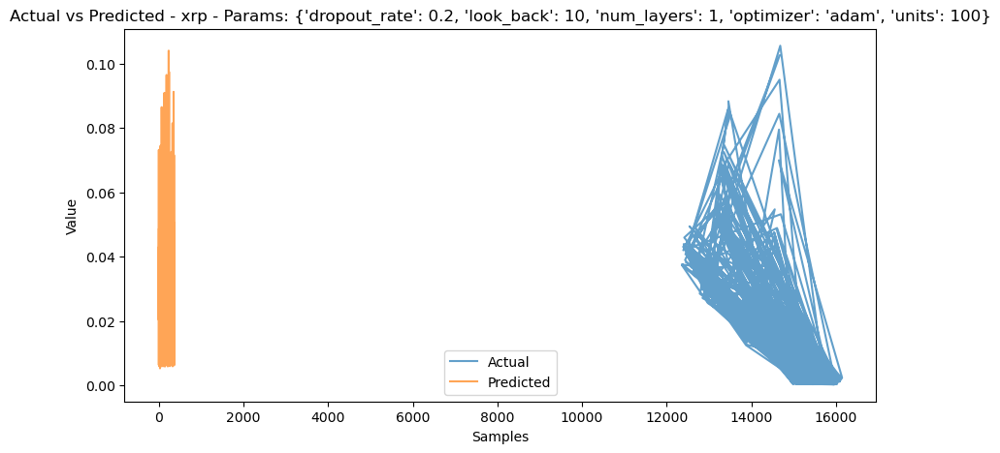

Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


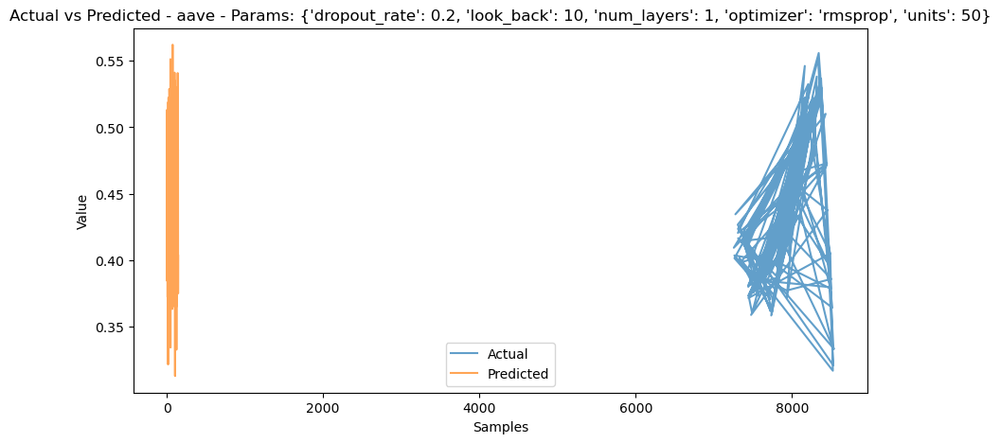

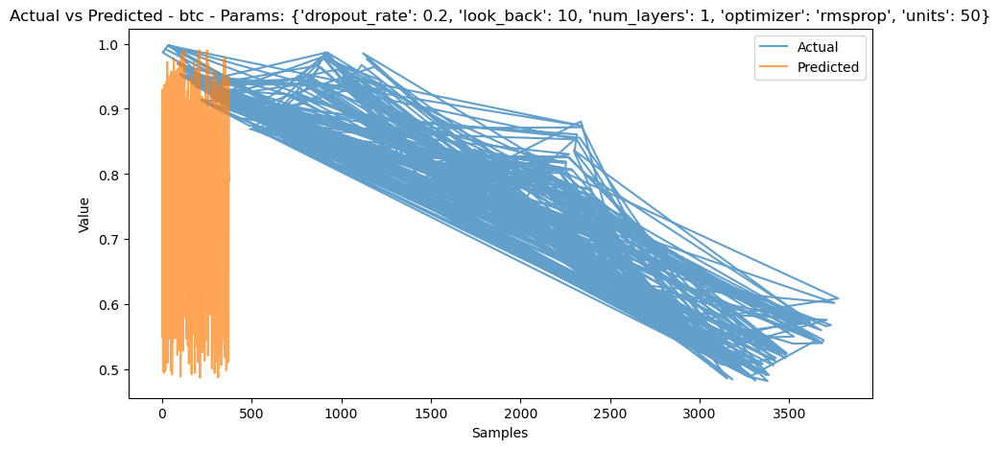

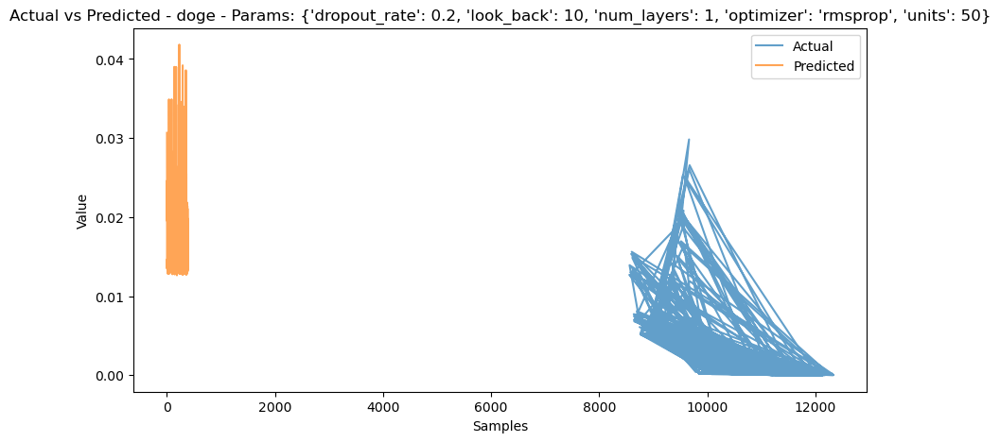

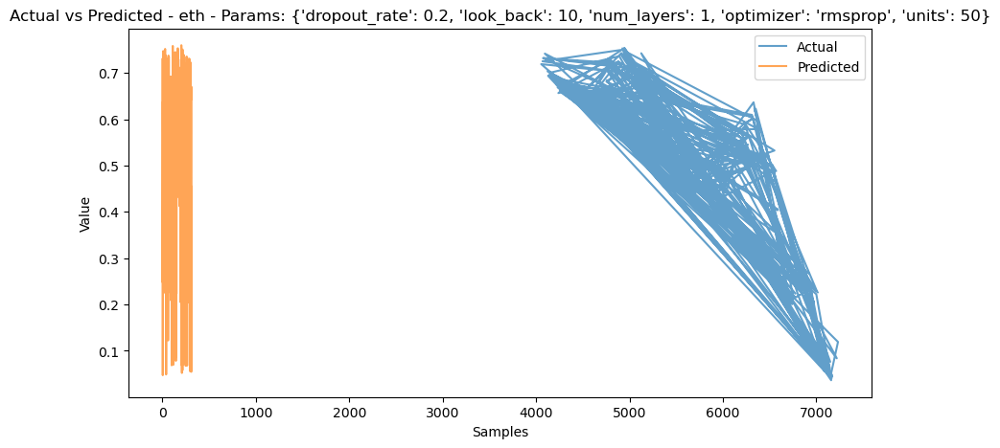

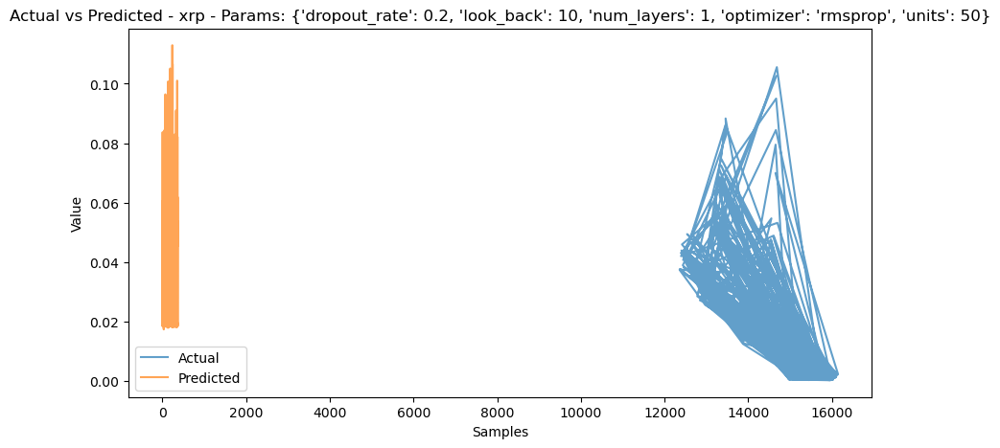

Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


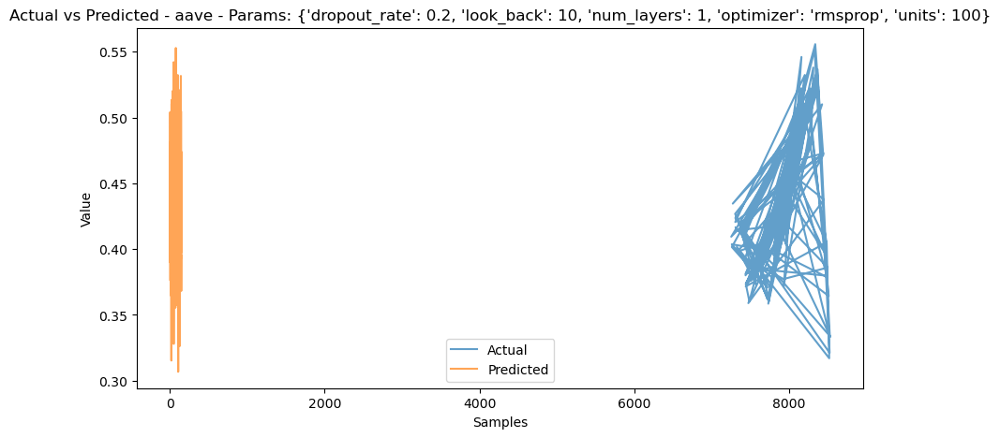

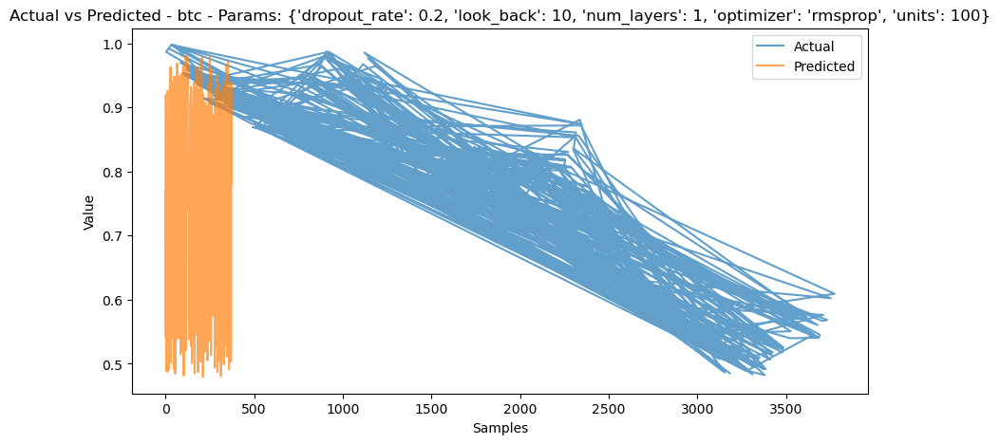

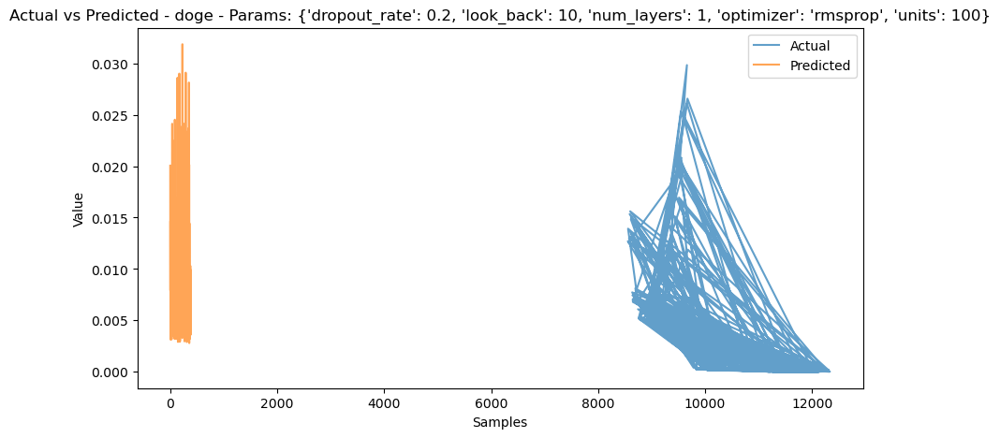

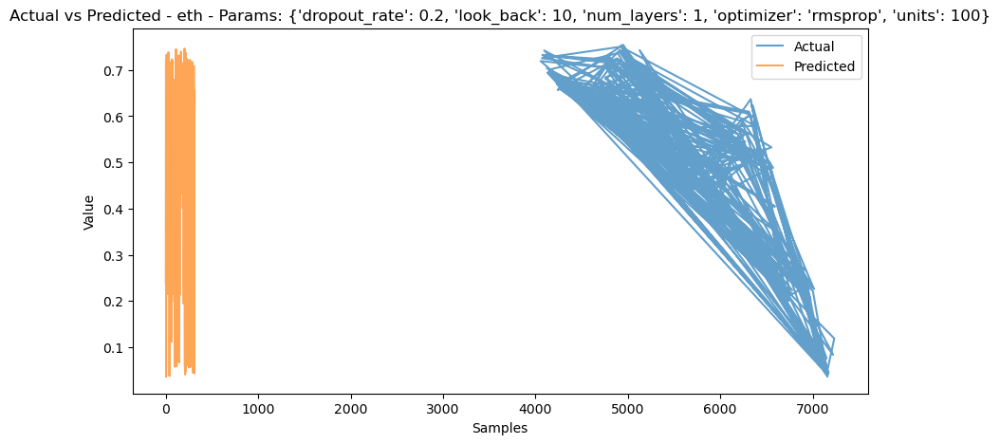

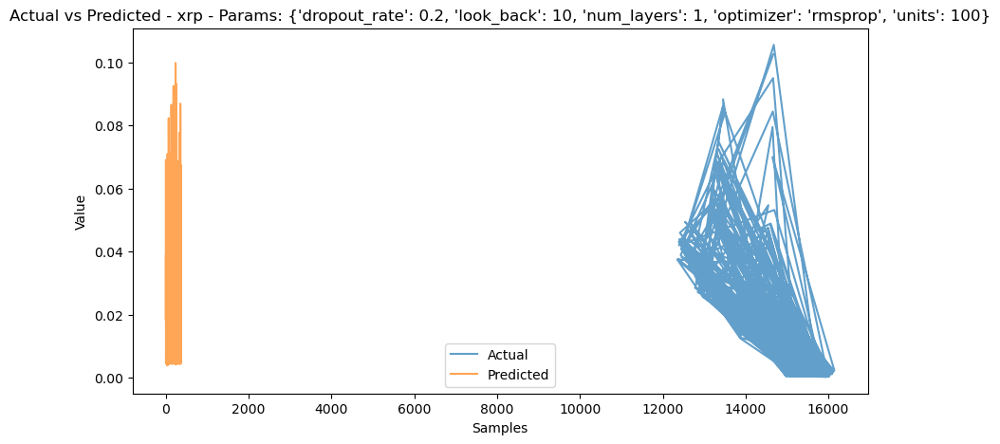

Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'sgd', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


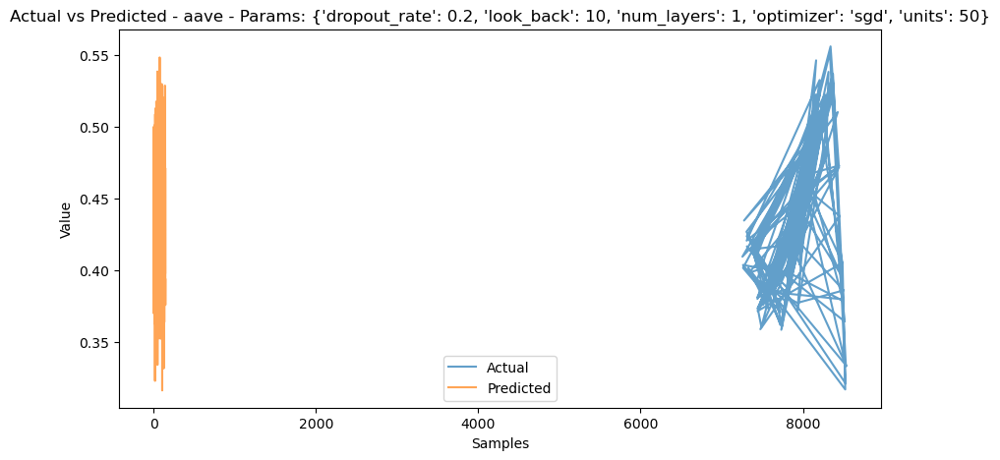

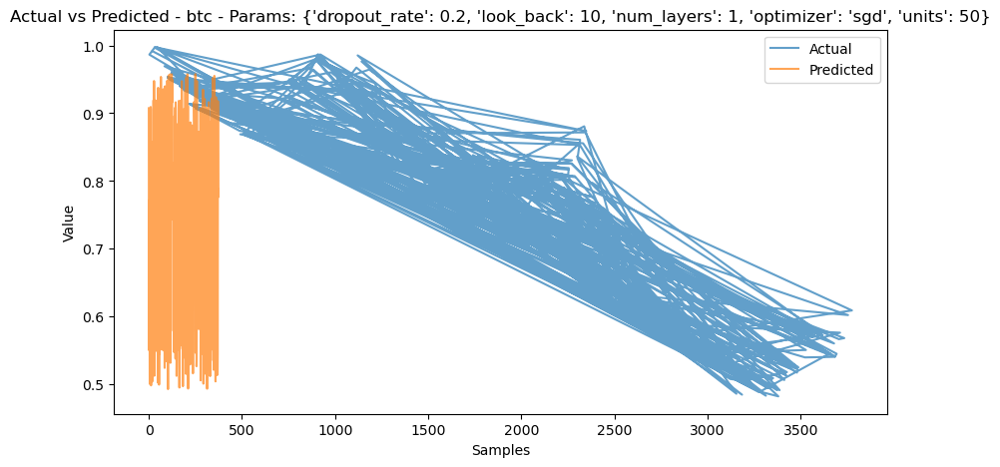

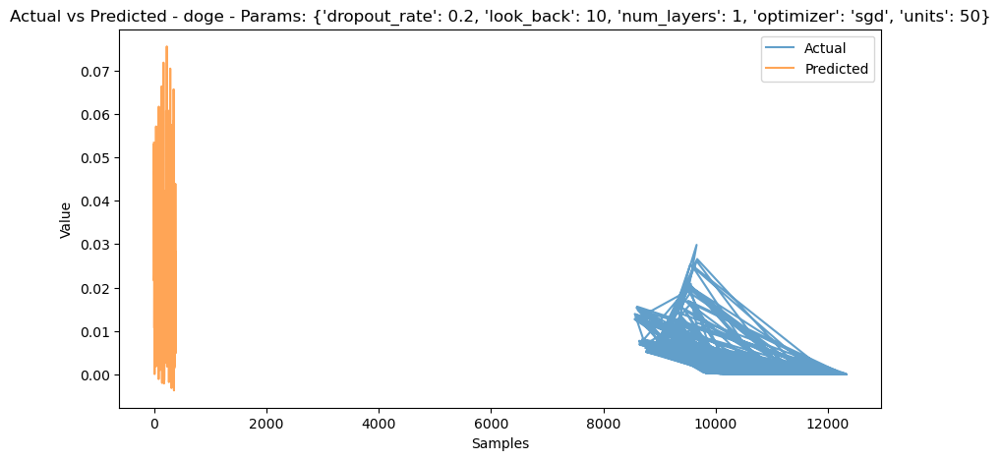

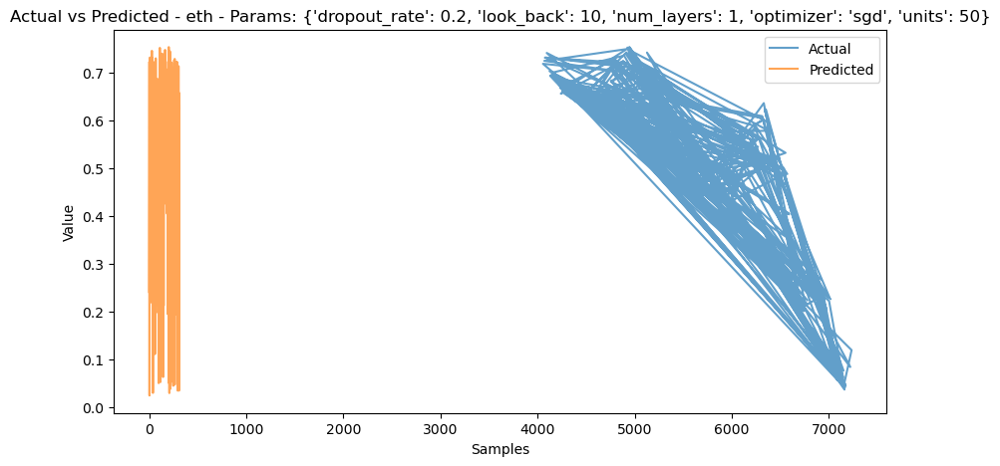

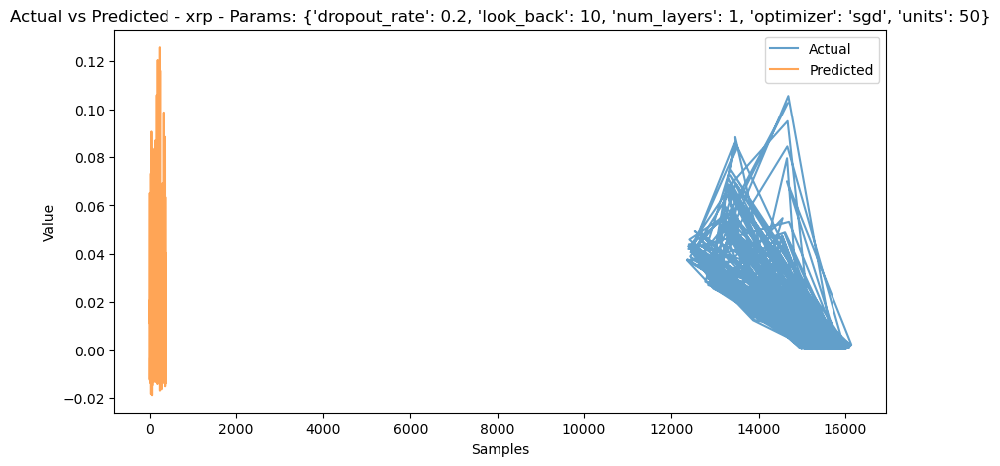

Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'sgd', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


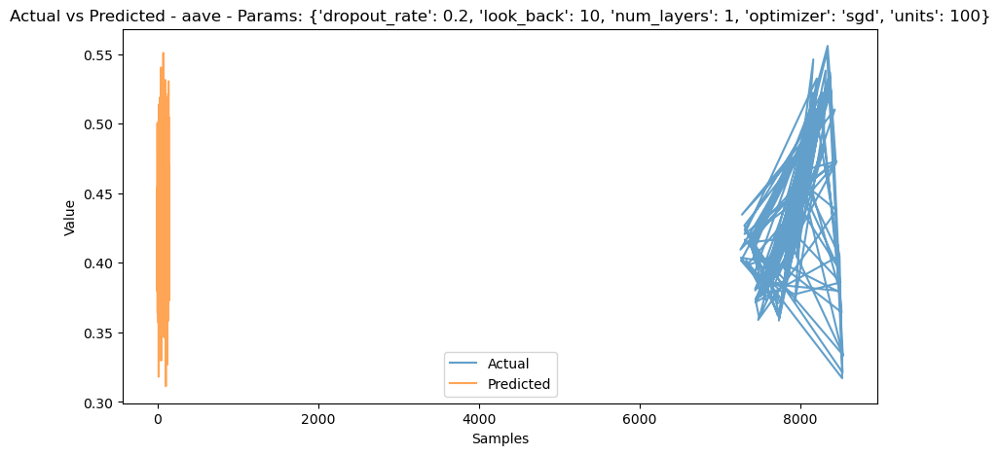

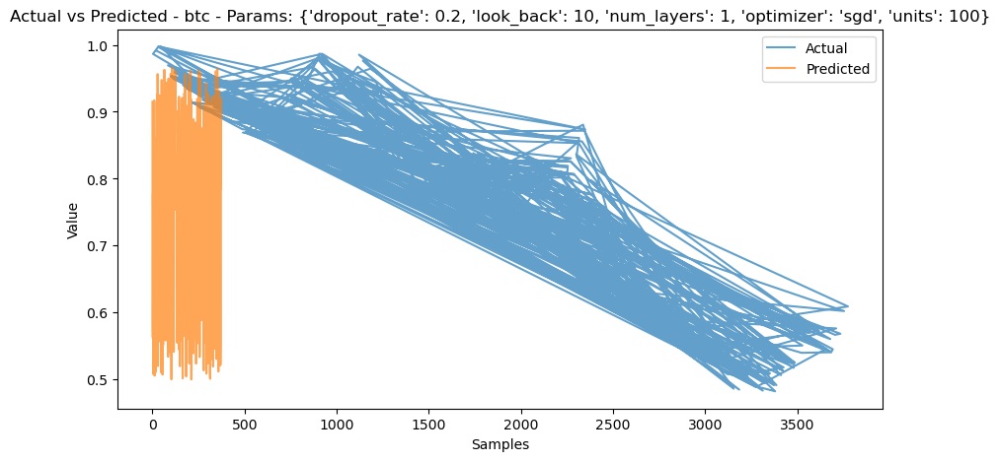

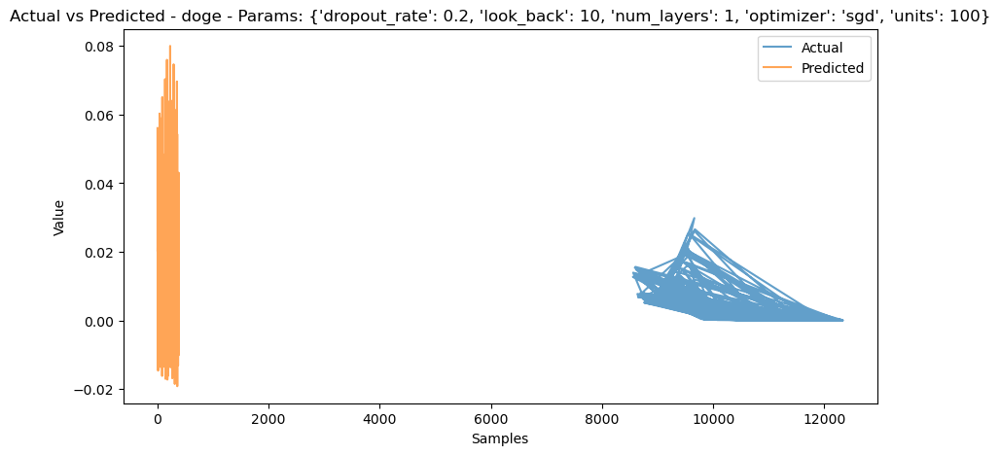

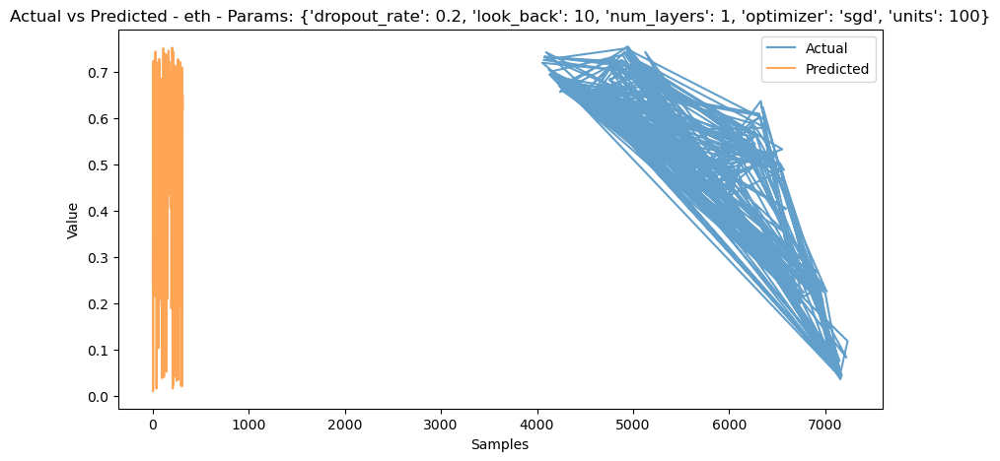

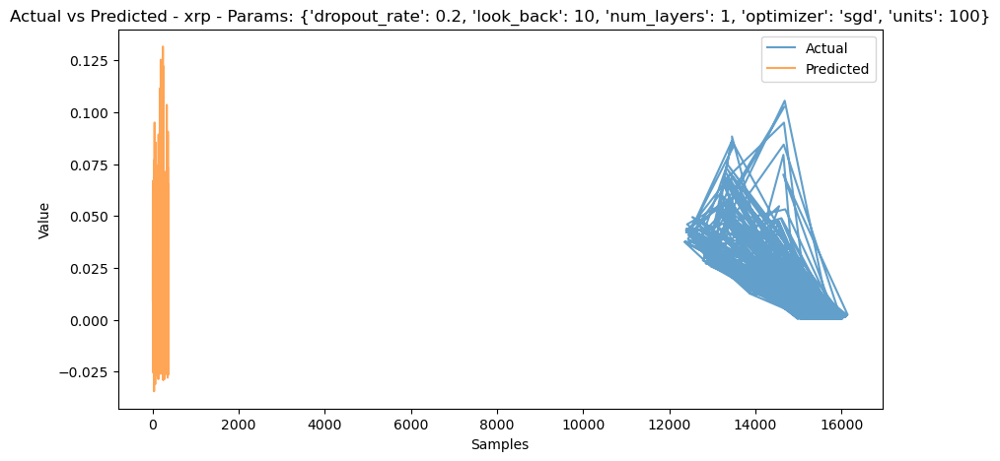

Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adagrad', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


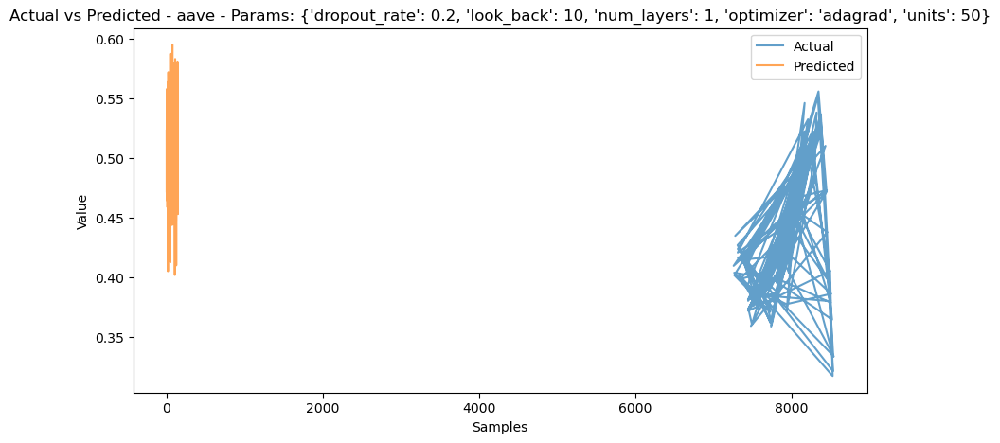

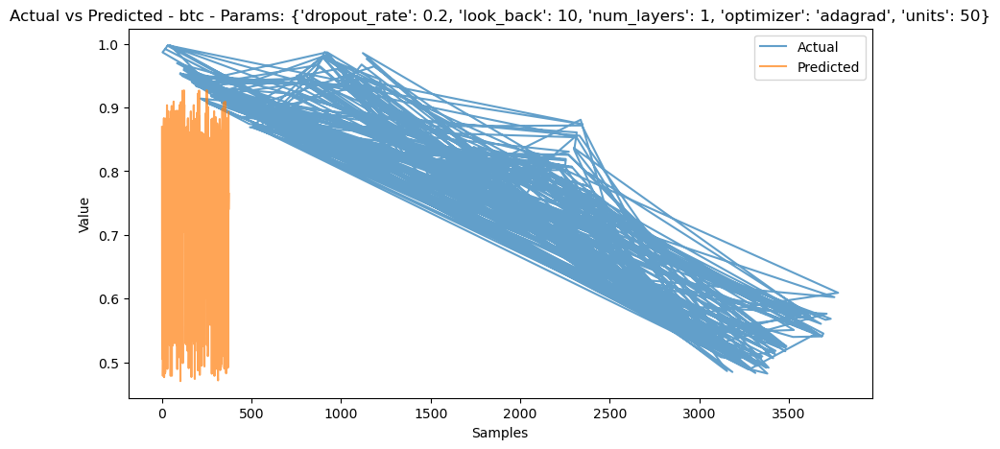

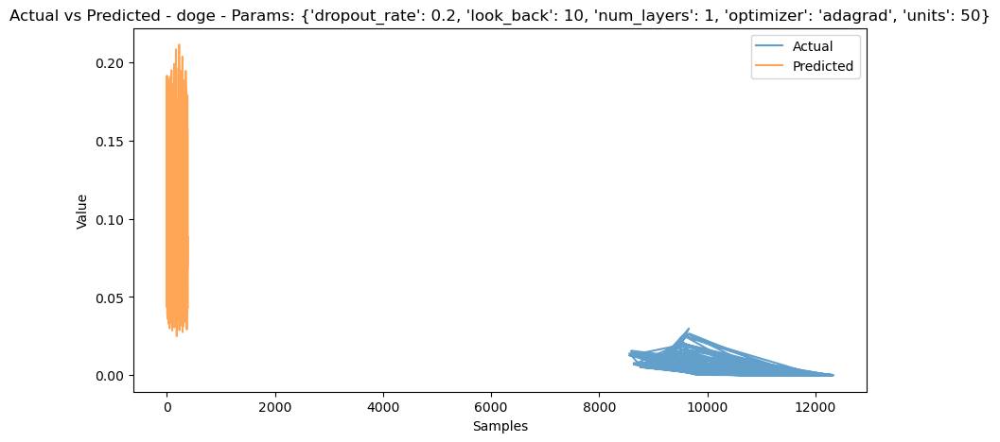

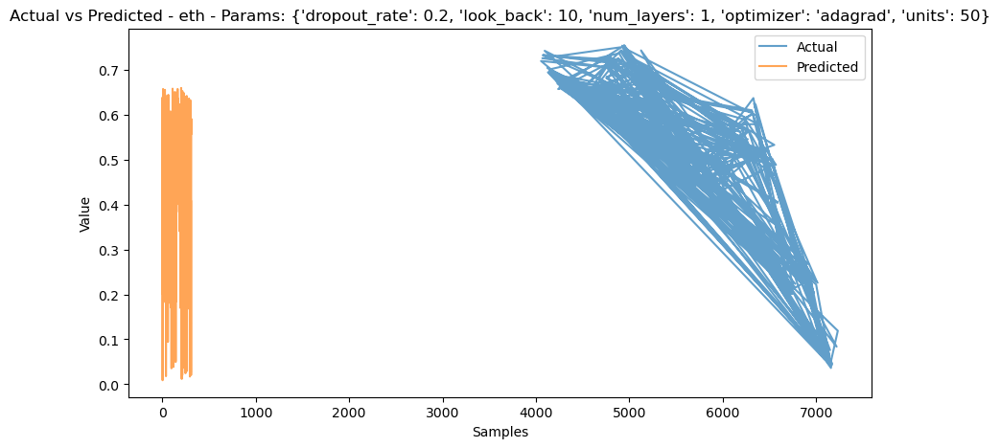

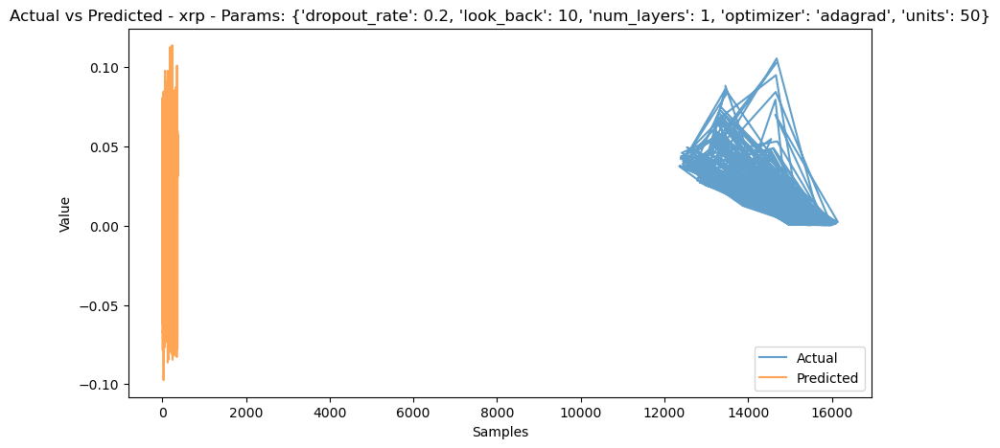

Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adagrad', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


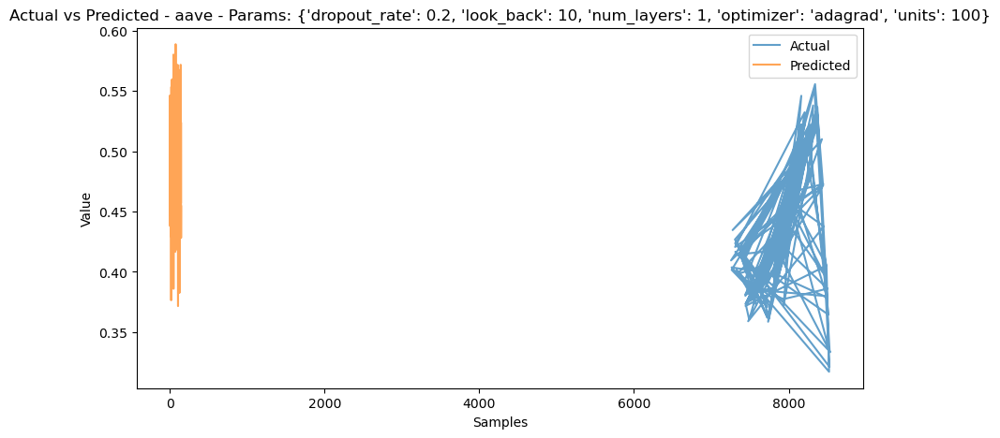

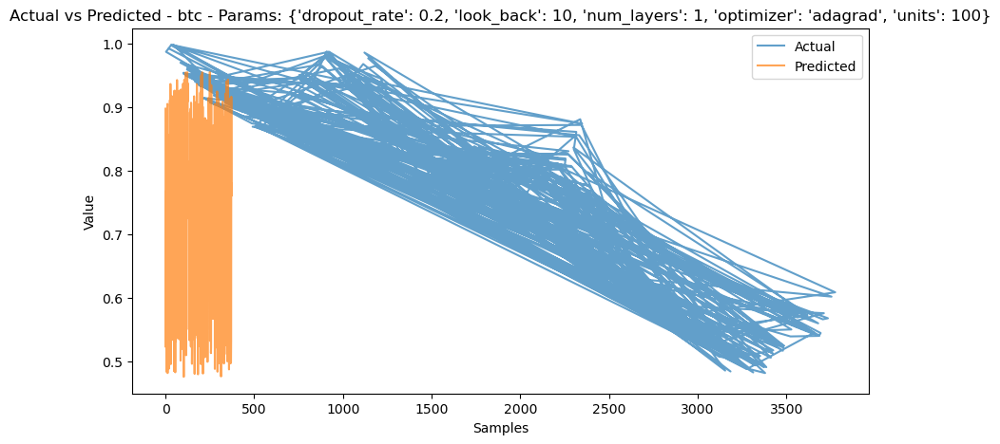

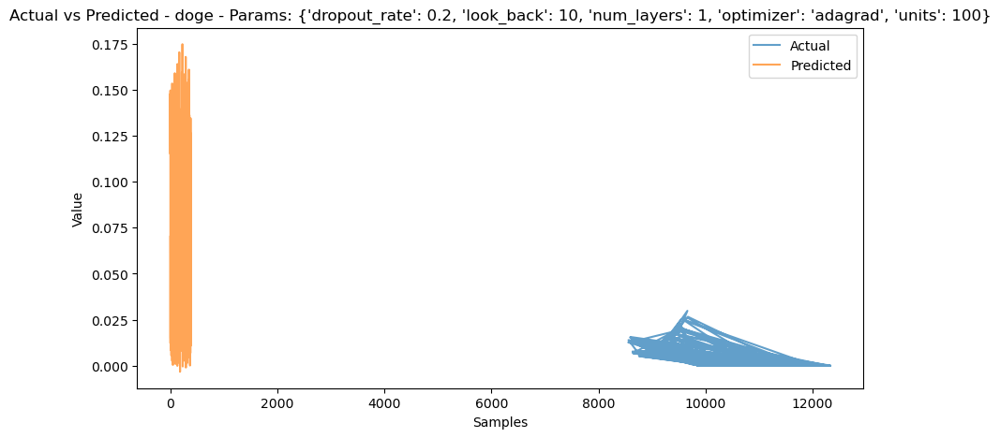

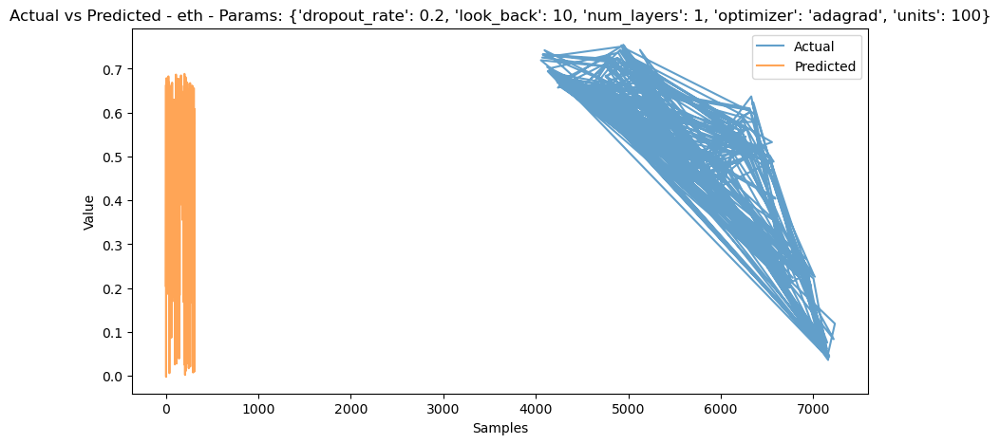

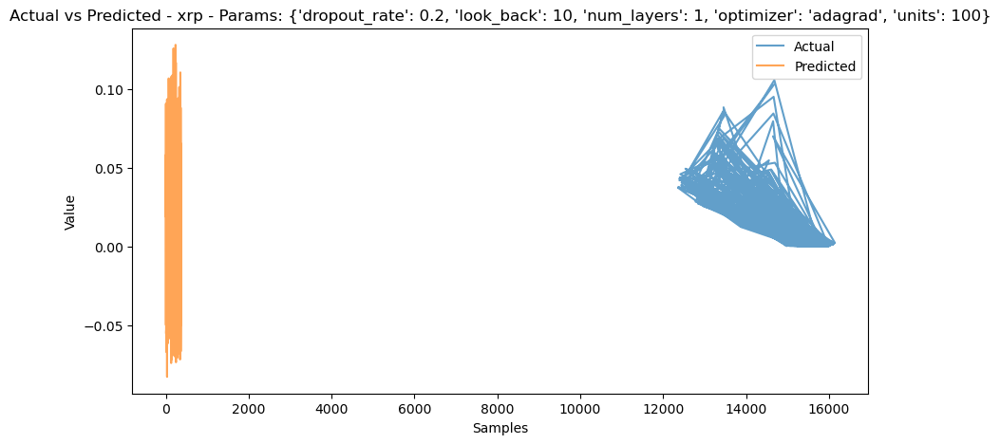

Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 2, 'optimizer': 'adam', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


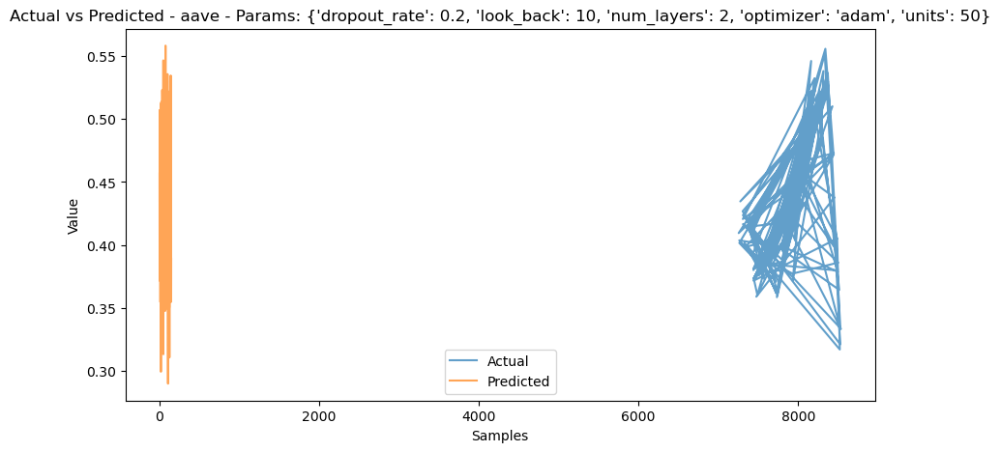

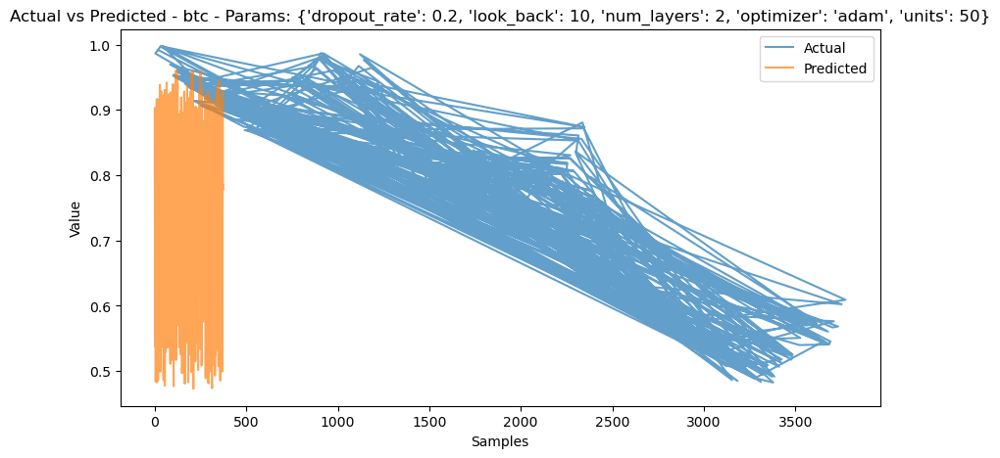

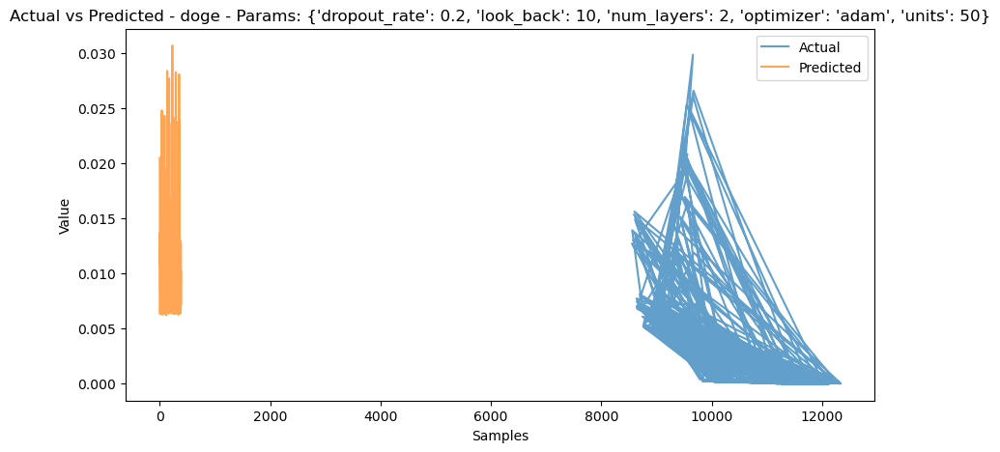

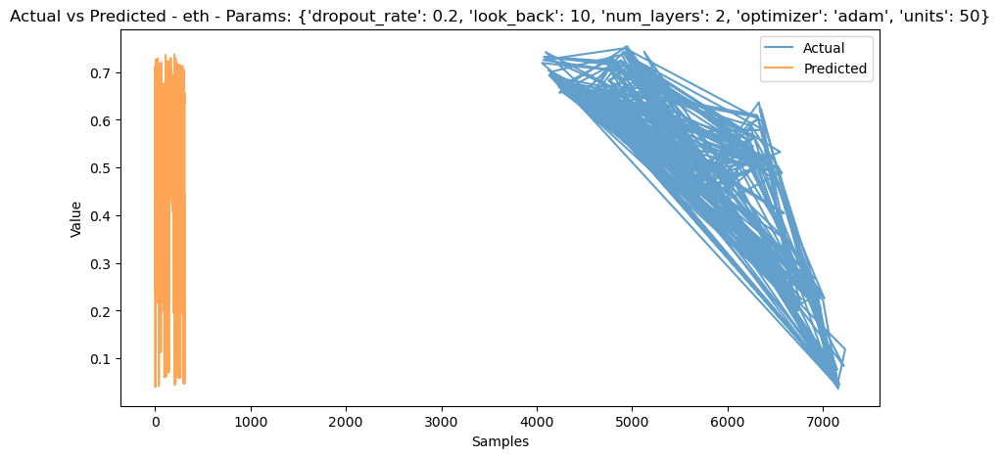

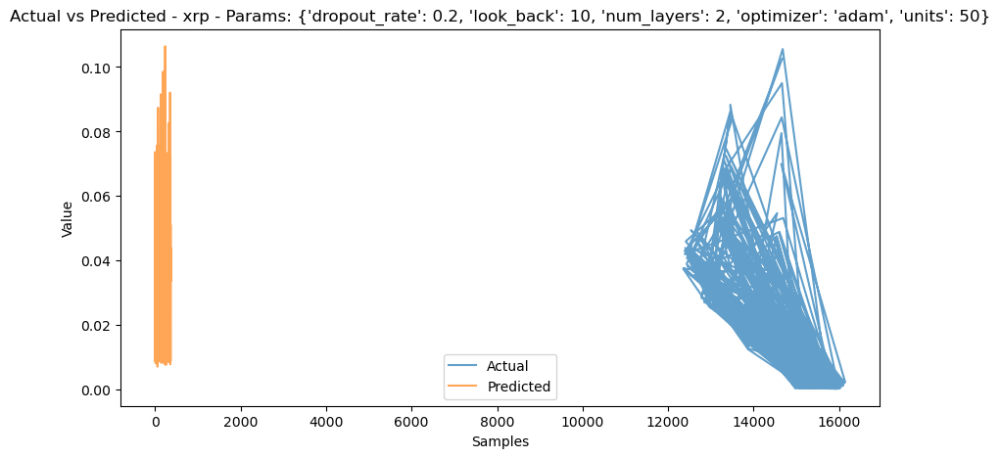

Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 2, 'optimizer': 'adam', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


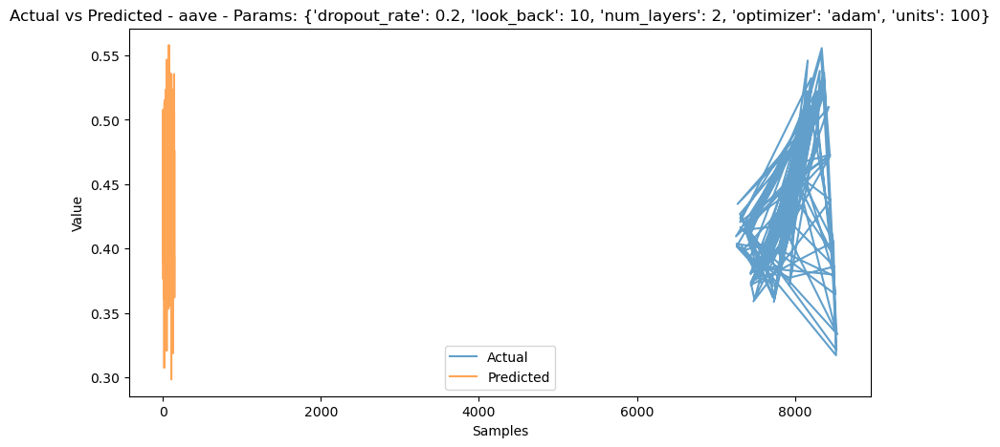

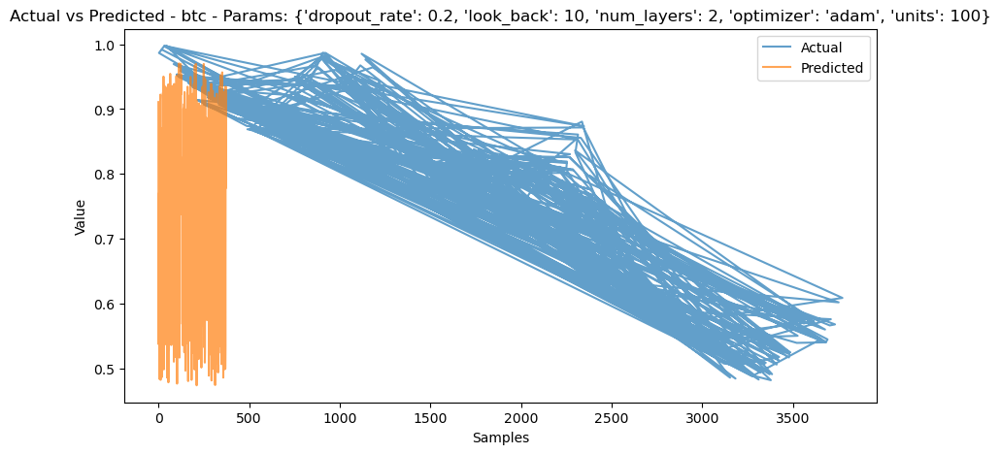

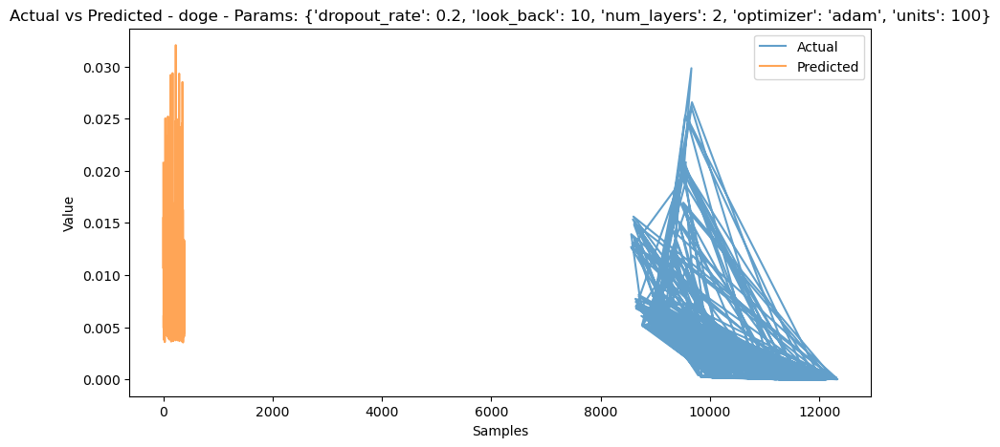

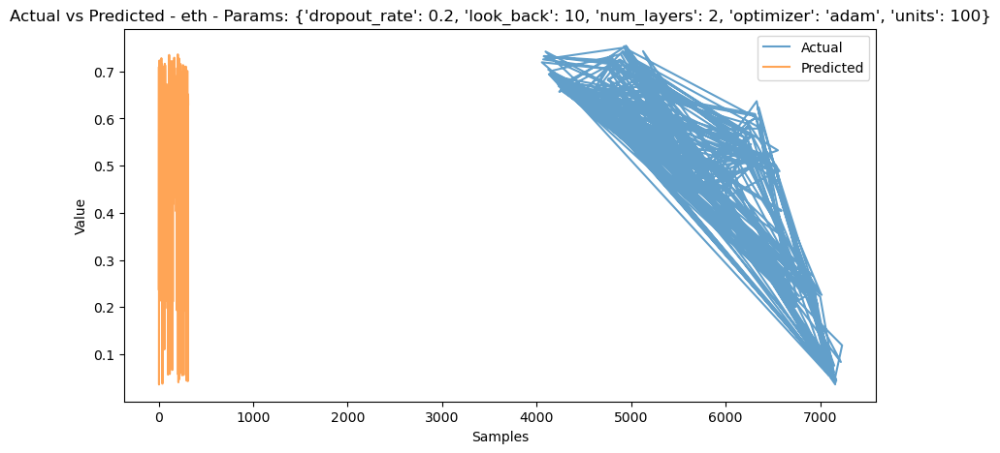

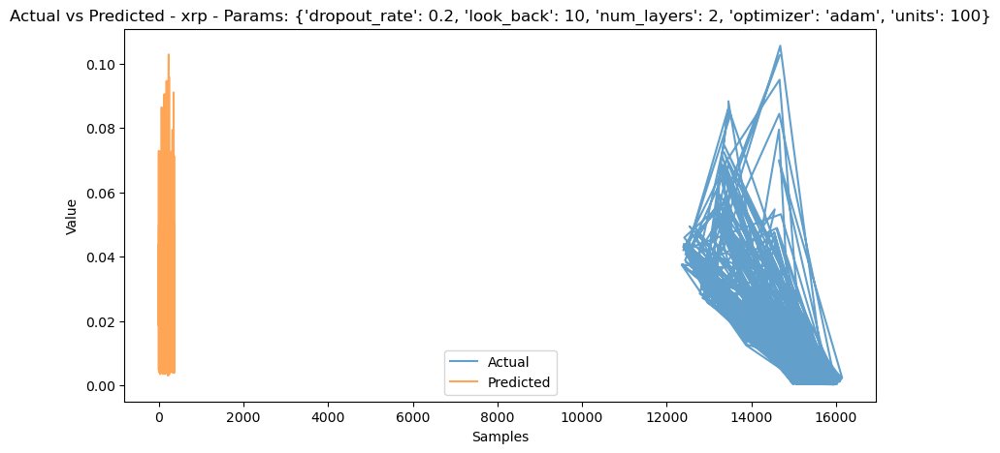

Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 2, 'optimizer': 'rmsprop', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


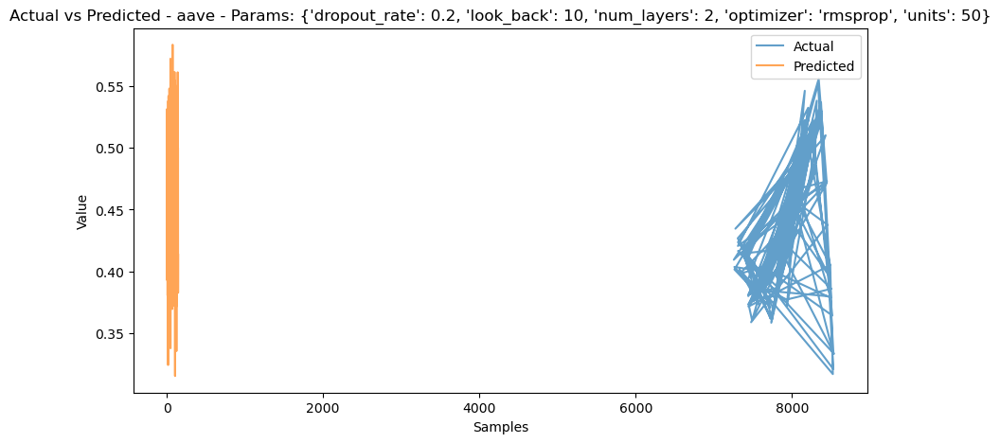

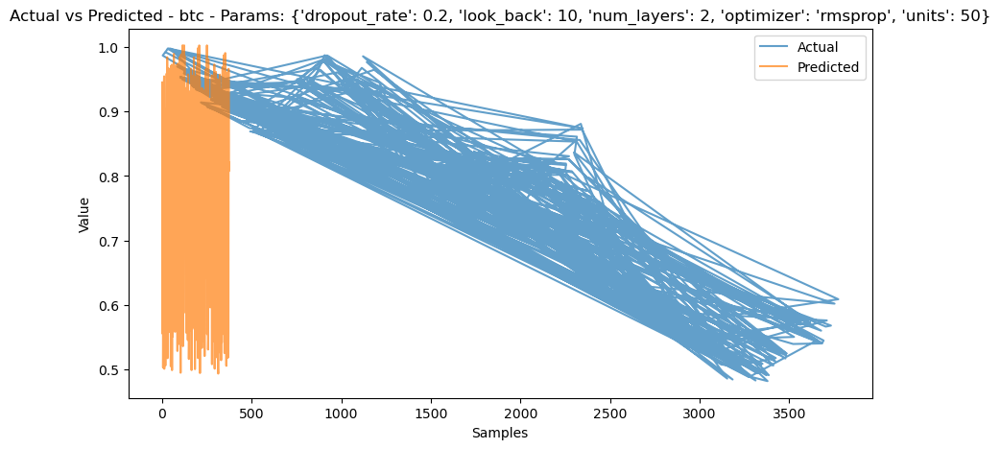

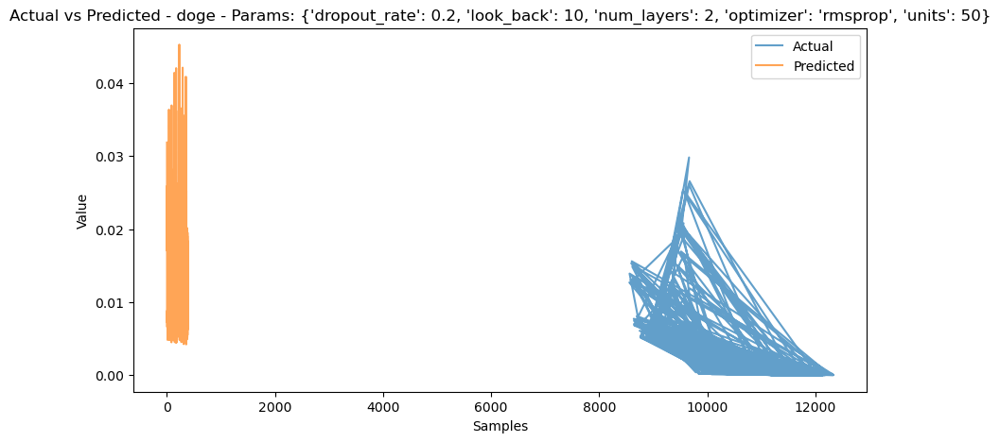

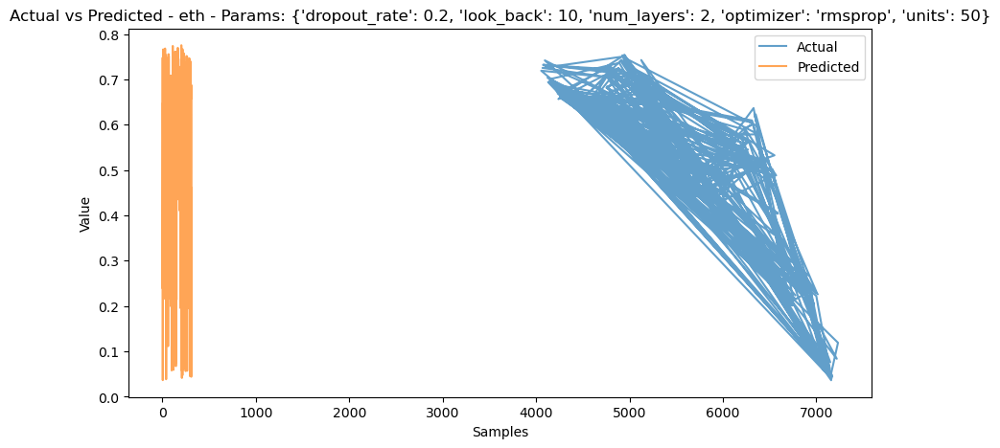

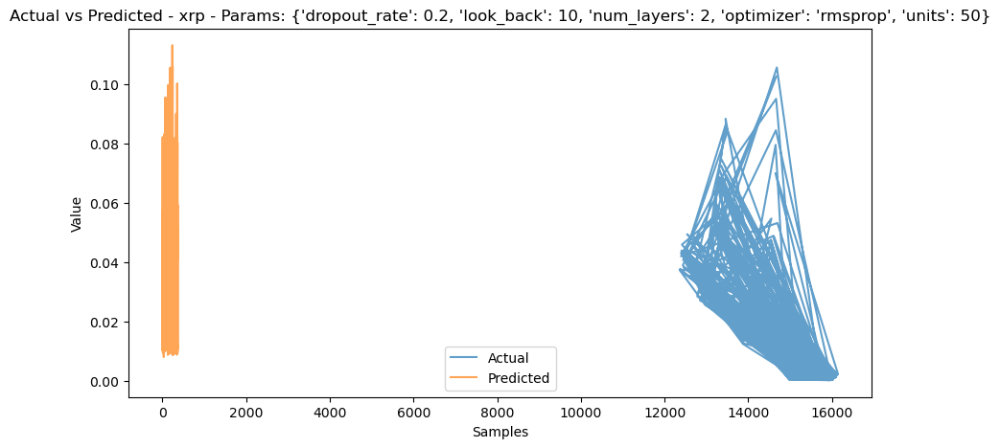

Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 2, 'optimizer': 'rmsprop', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


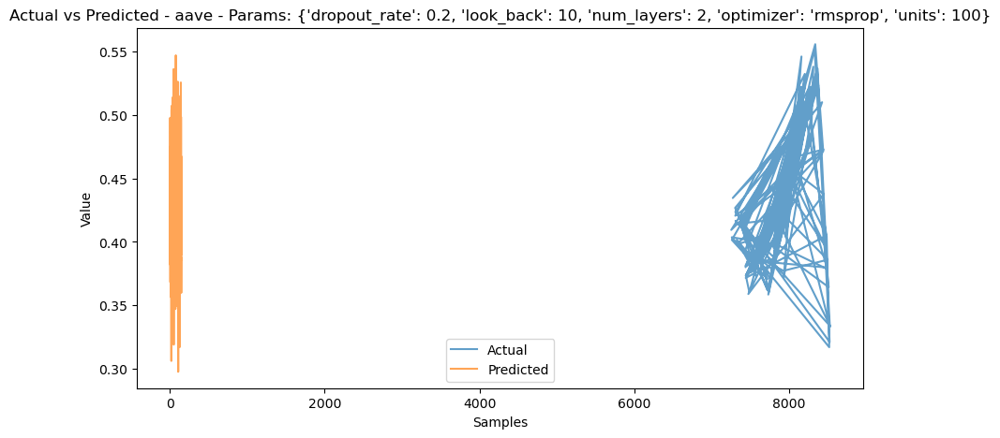

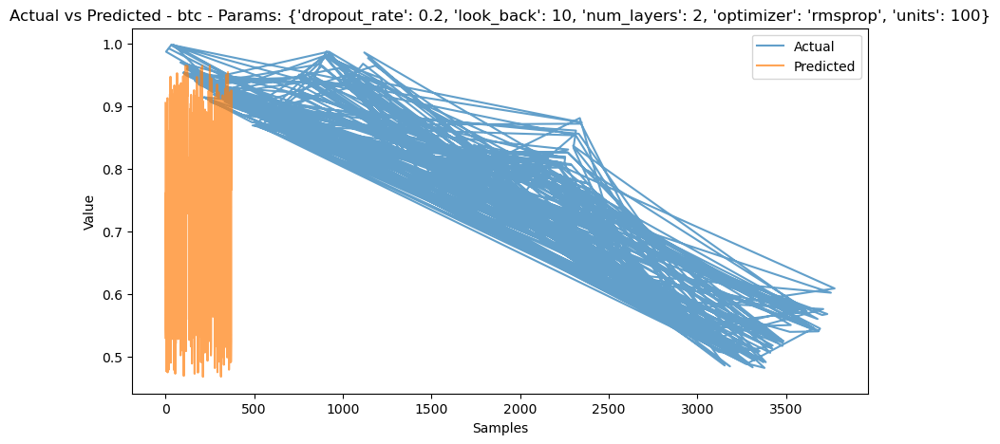

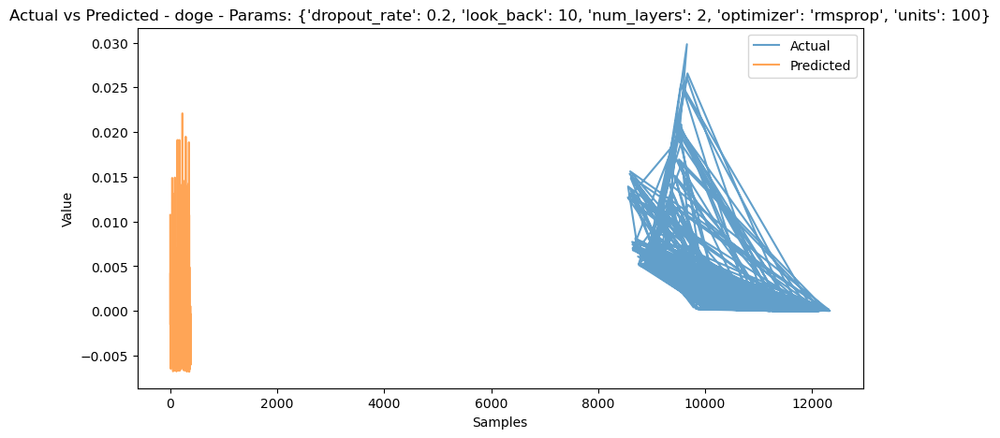

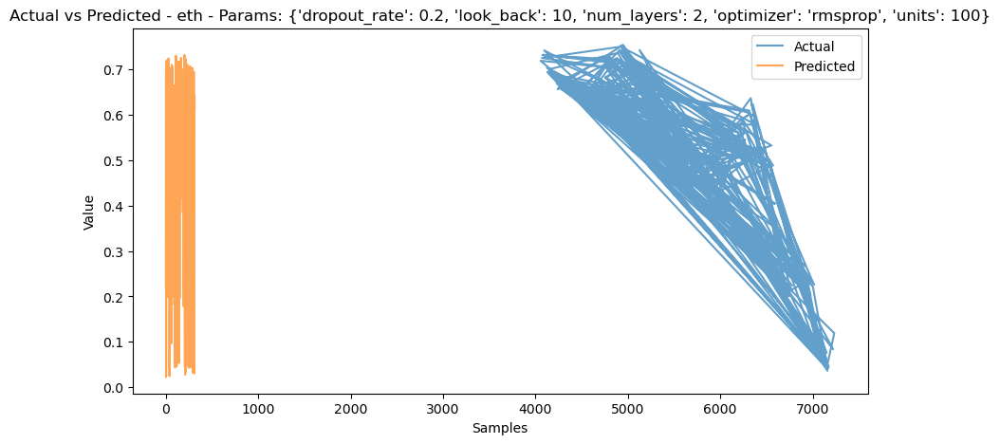

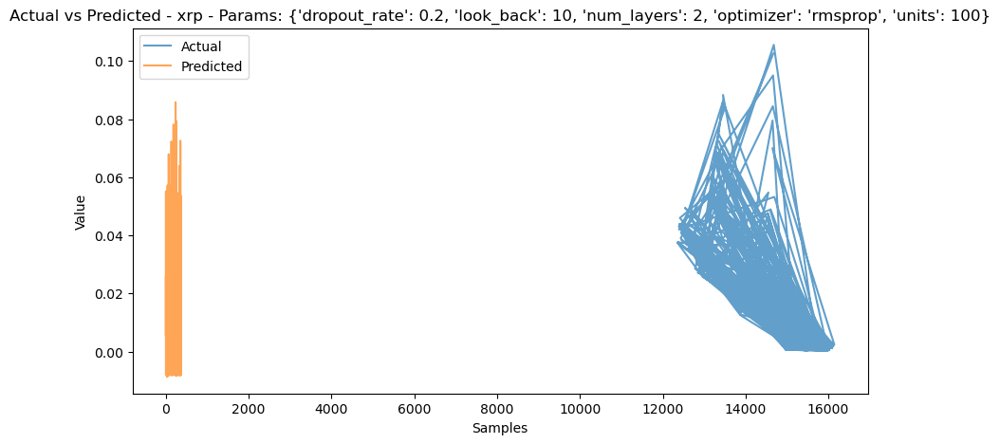

Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 2, 'optimizer': 'sgd', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


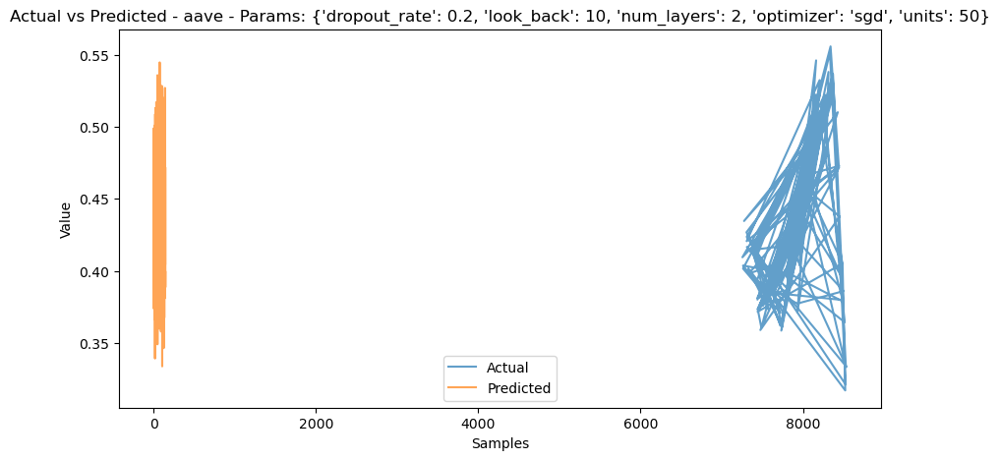

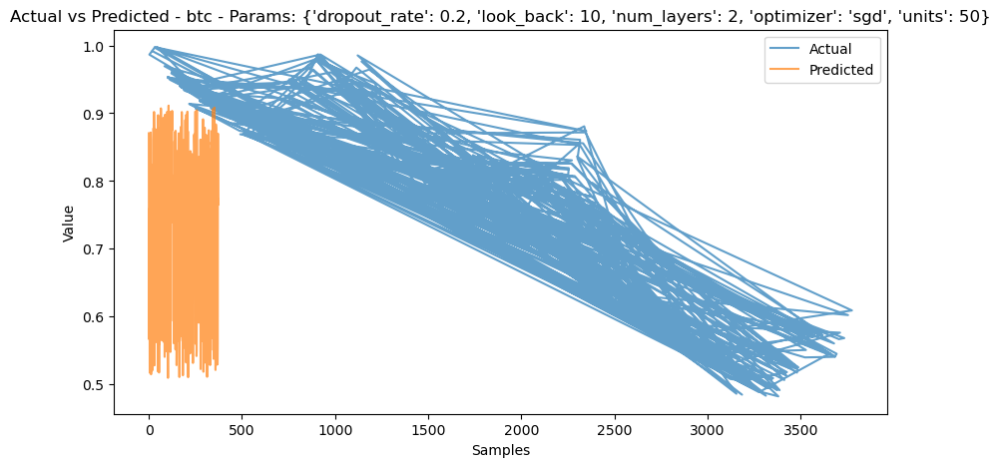

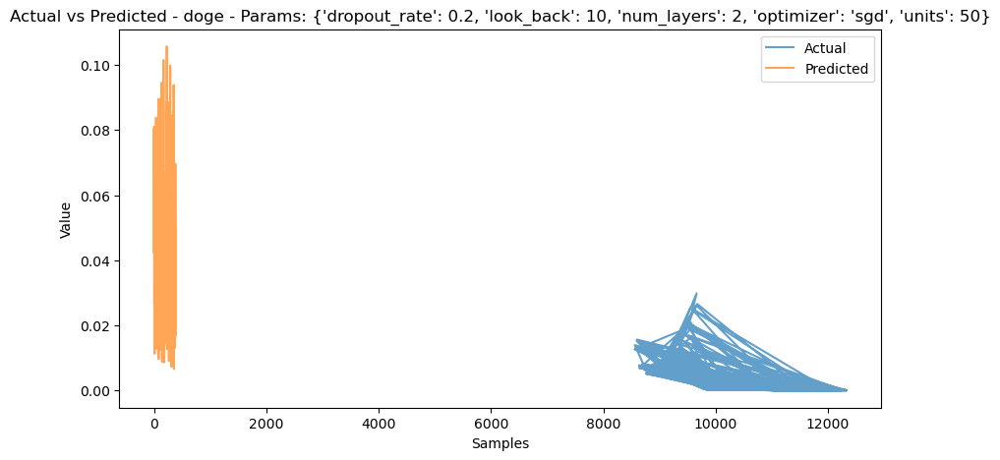

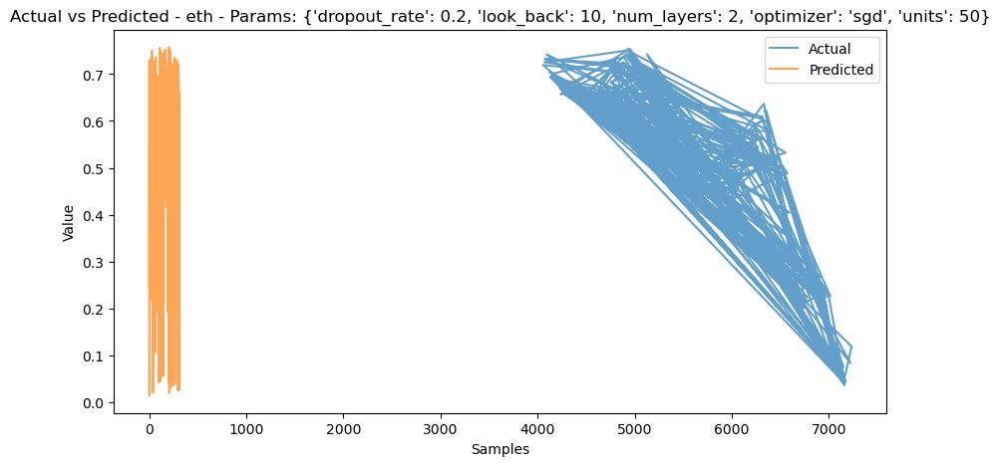

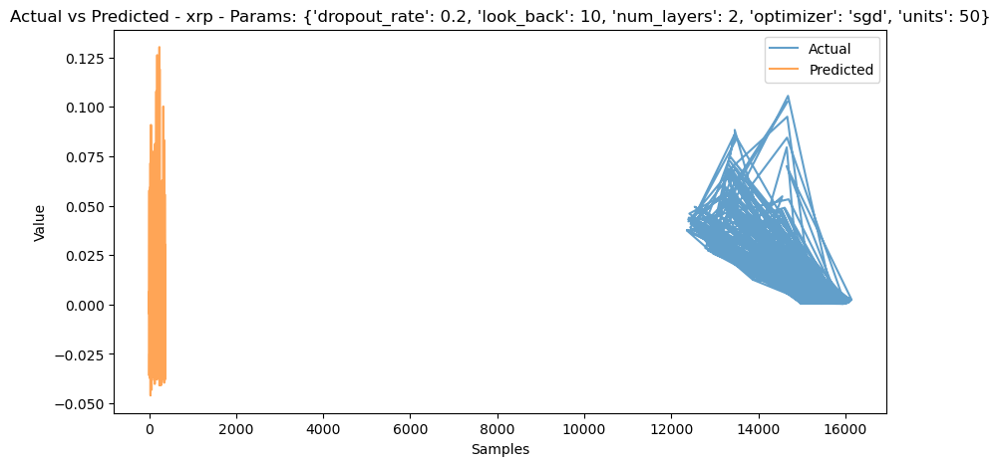

Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 2, 'optimizer': 'sgd', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


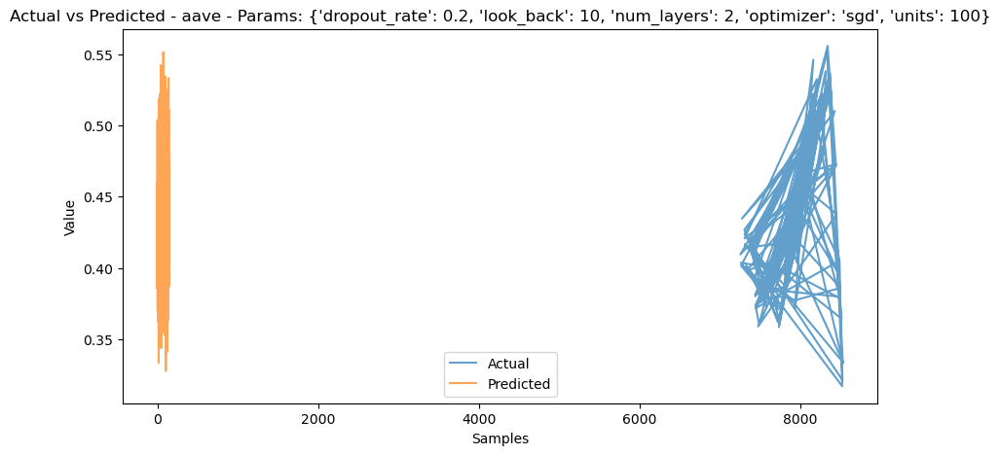

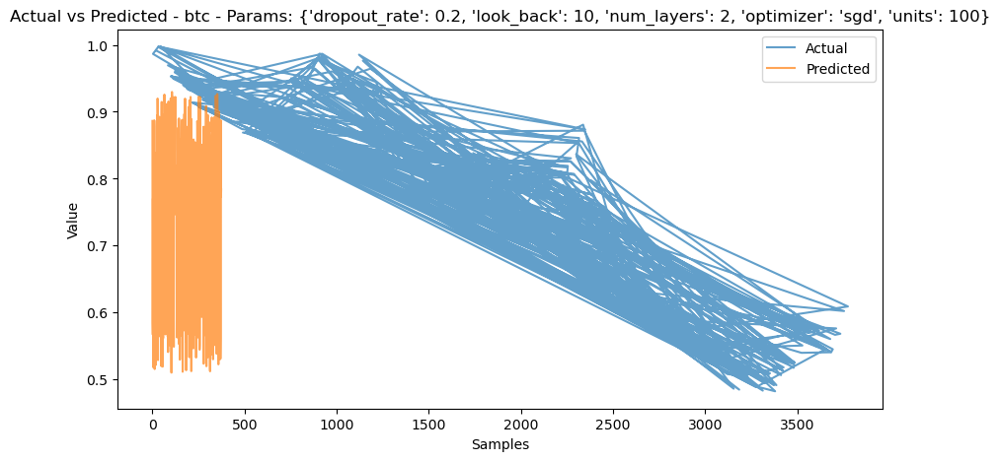

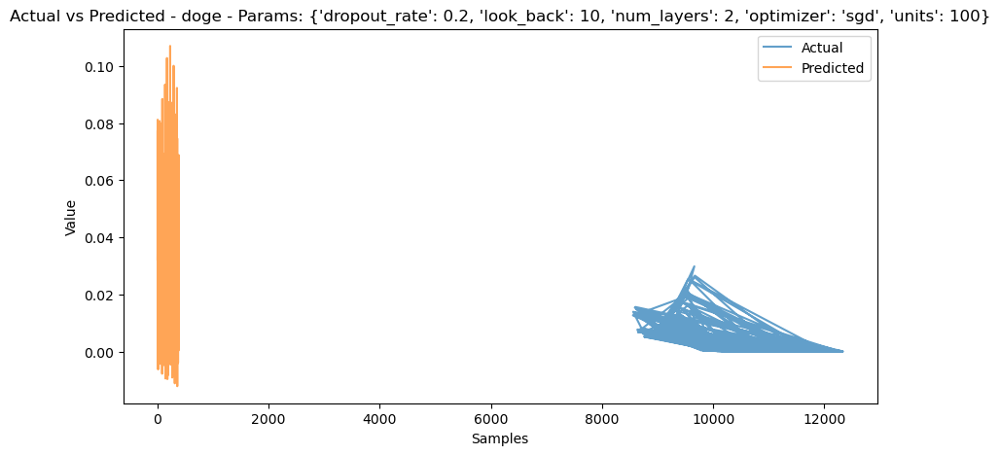

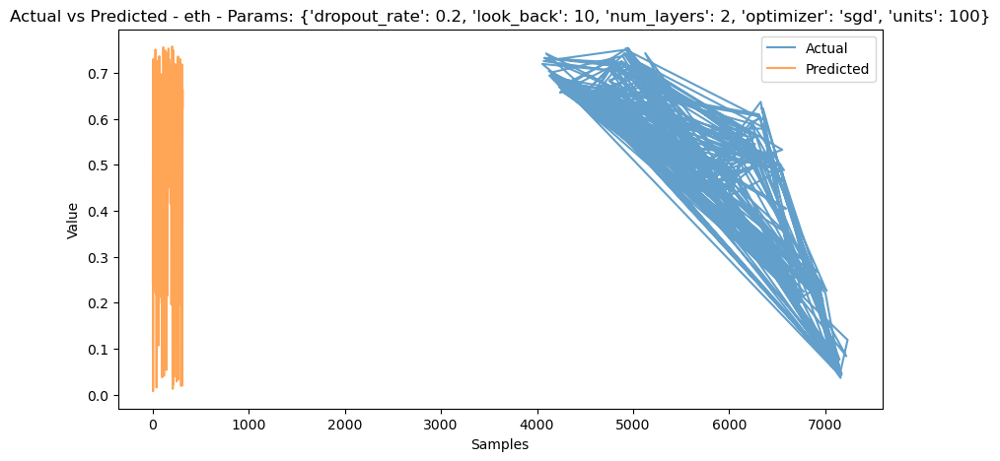

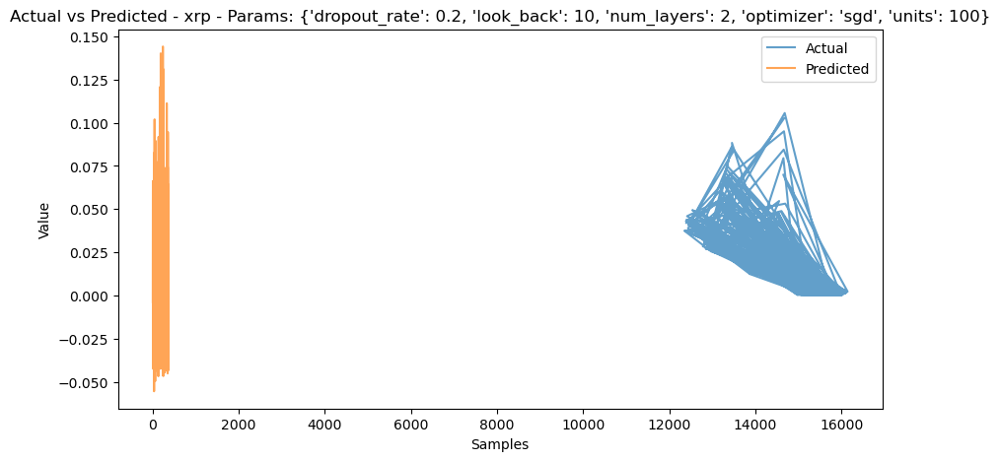

Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 2, 'optimizer': 'adagrad', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


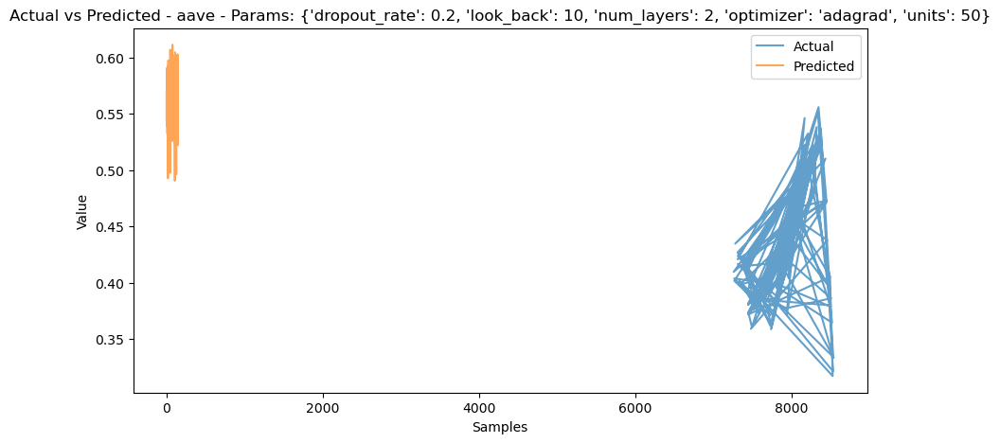

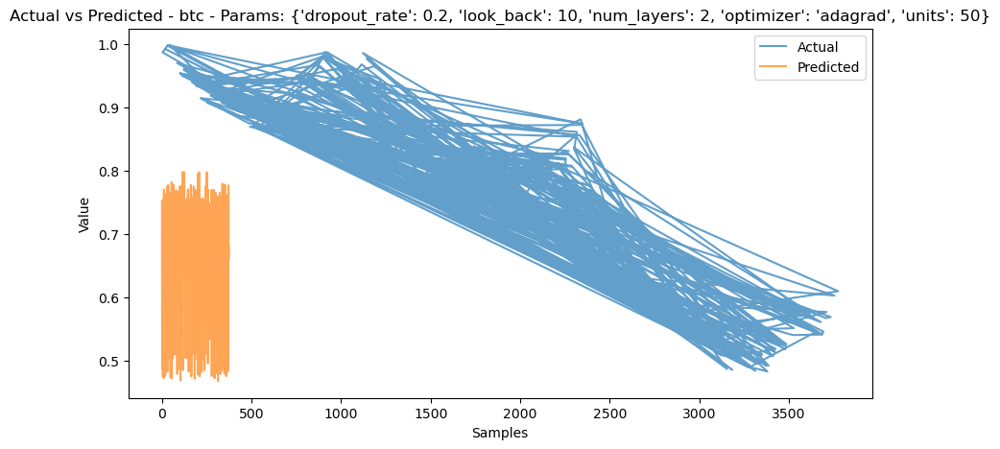

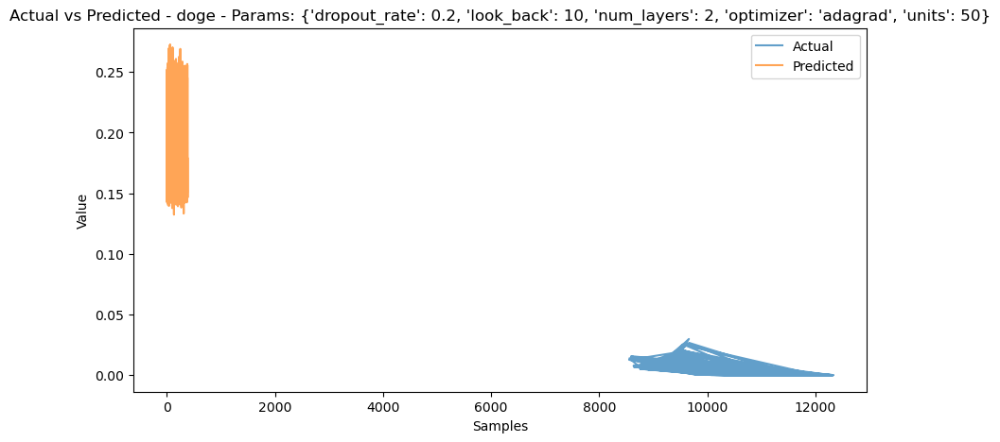

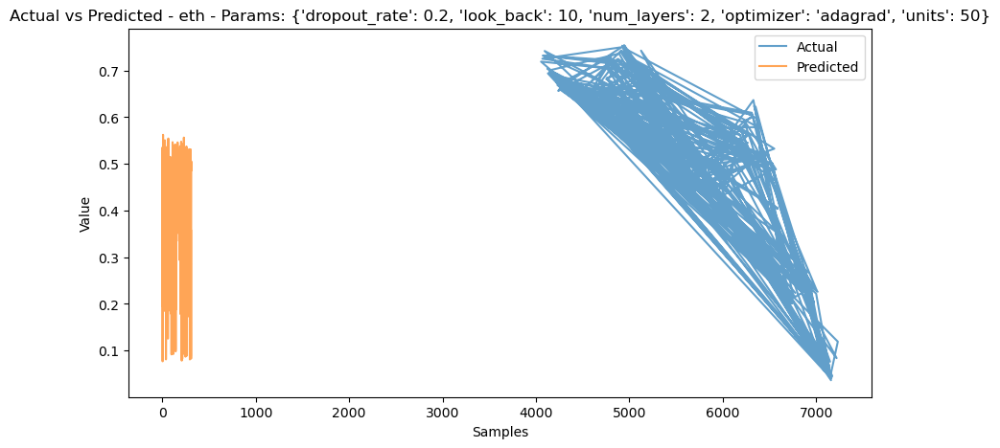

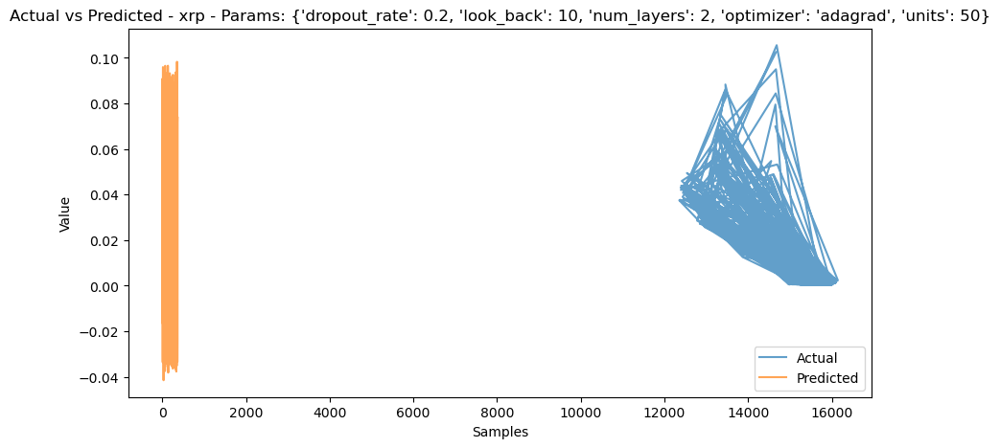

Testing parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 2, 'optimizer': 'adagrad', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


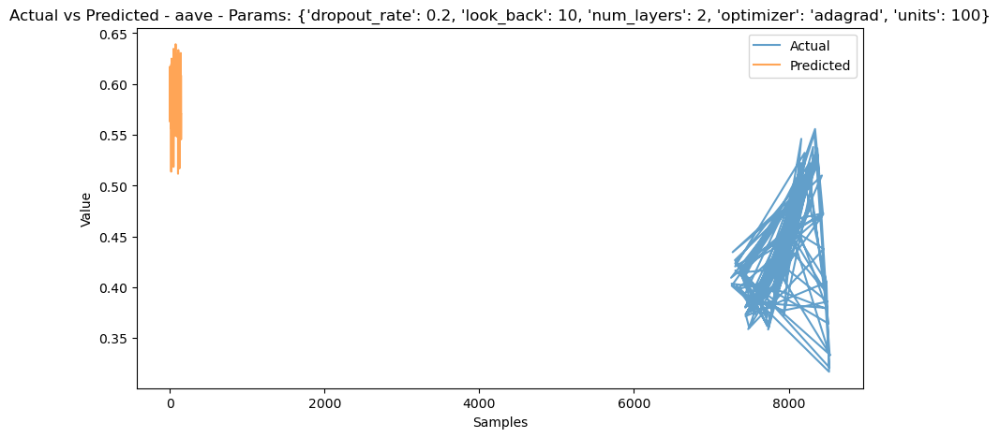

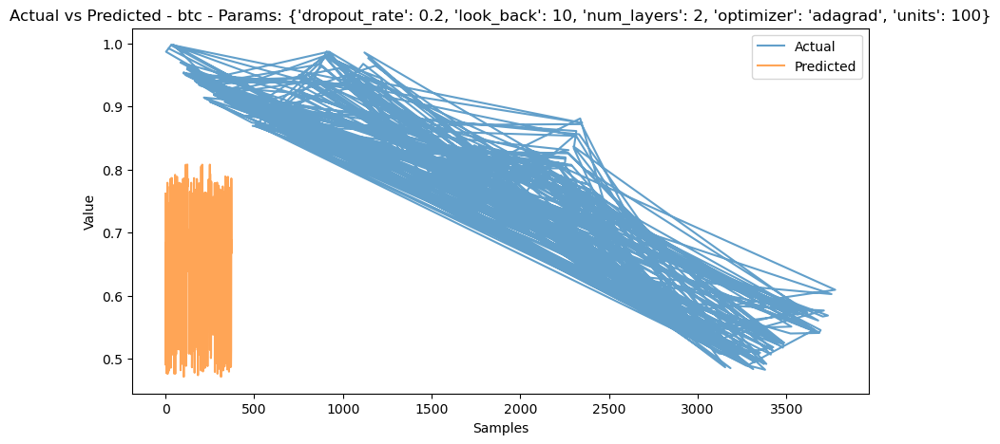

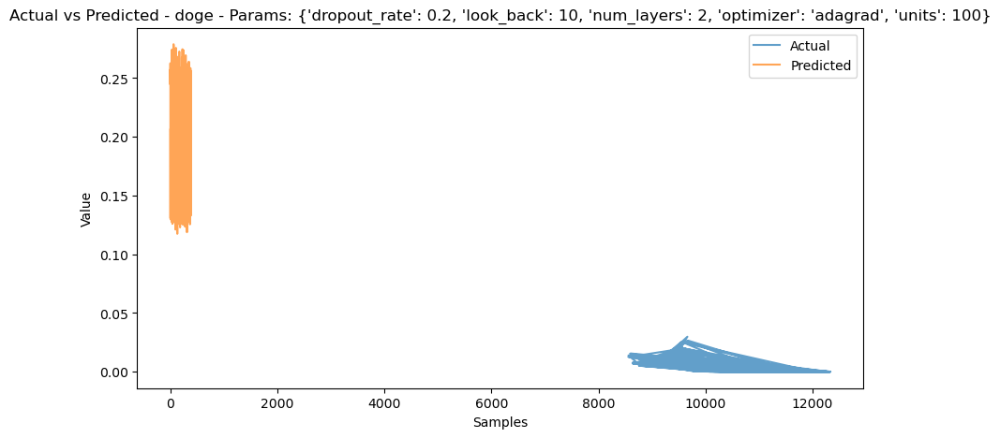

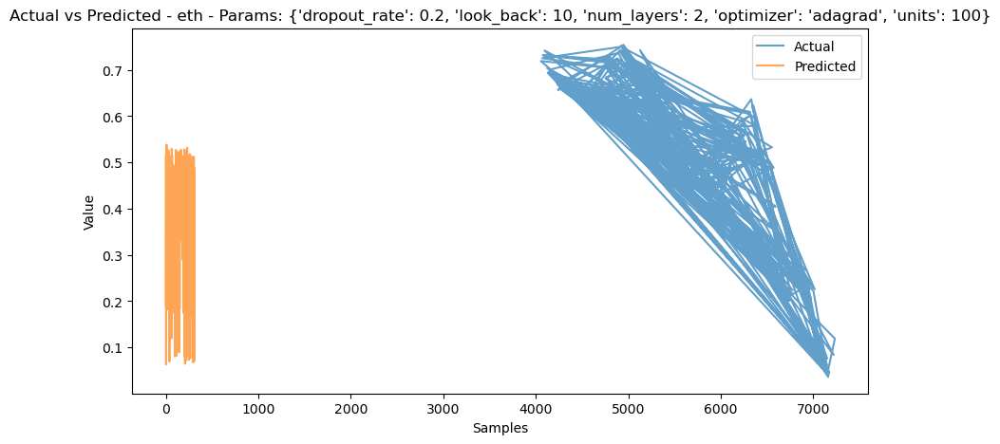

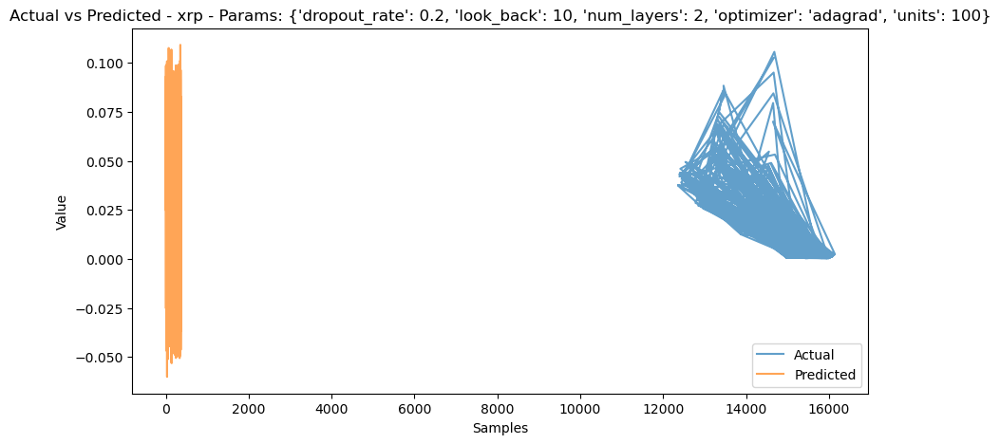

Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


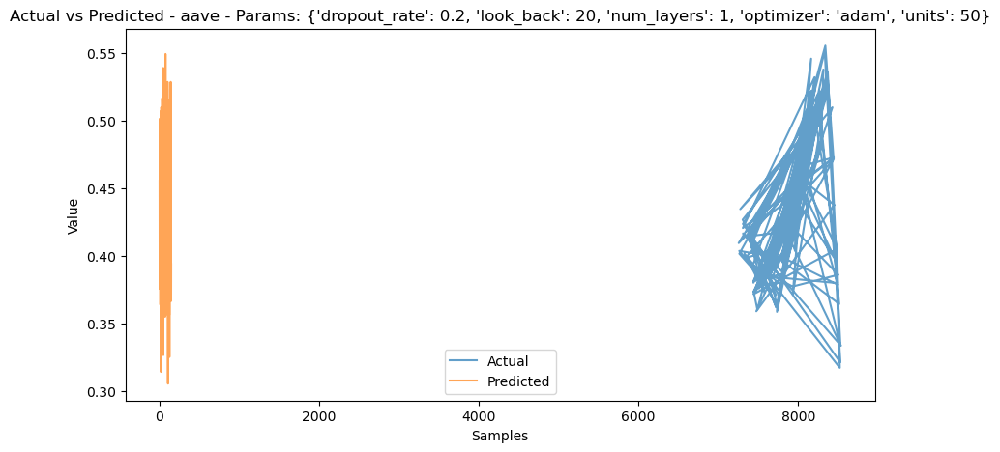

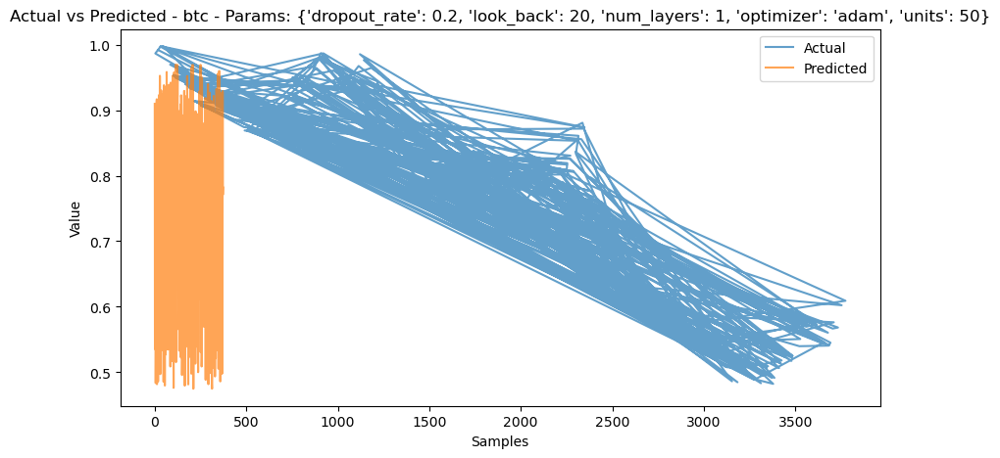

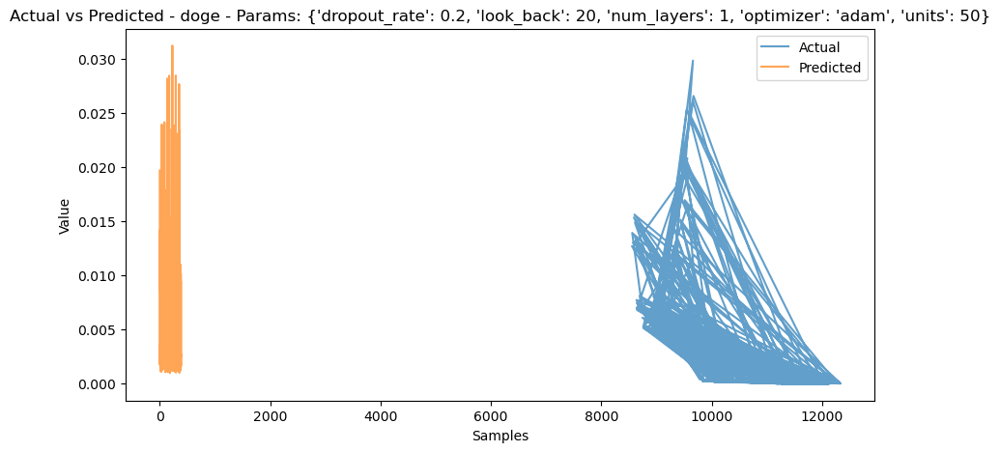

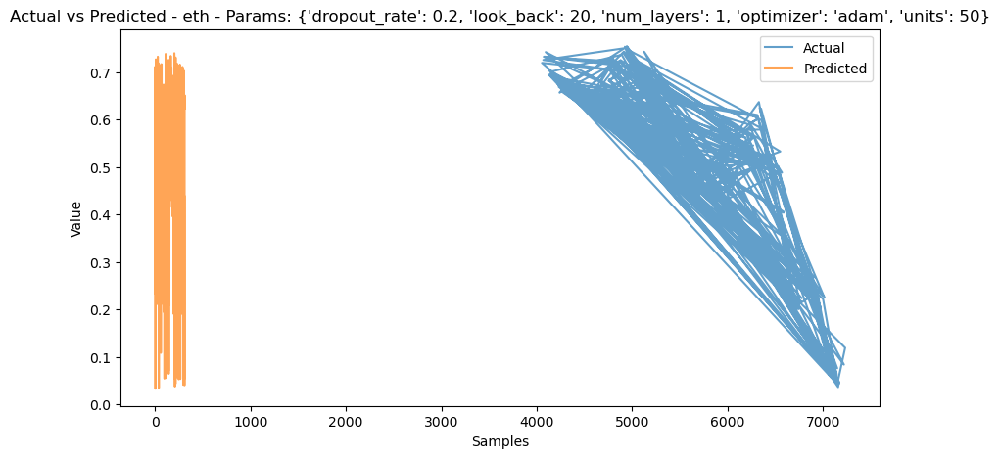

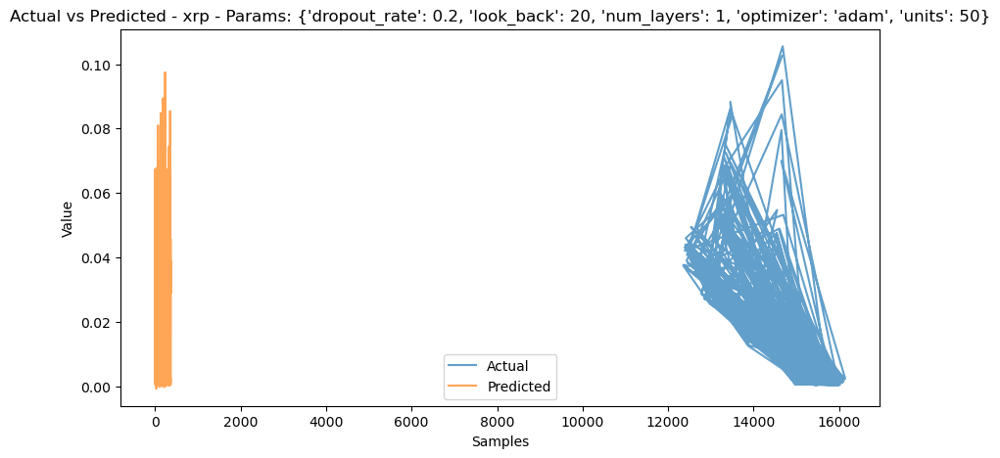

Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


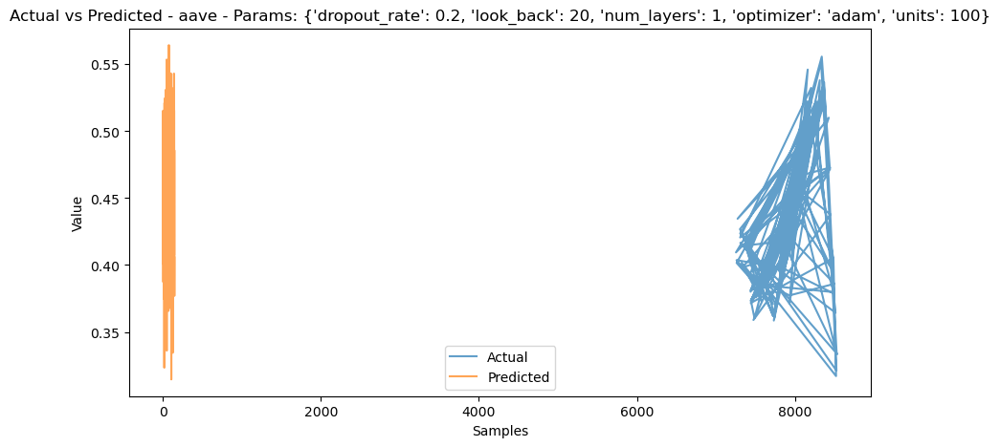

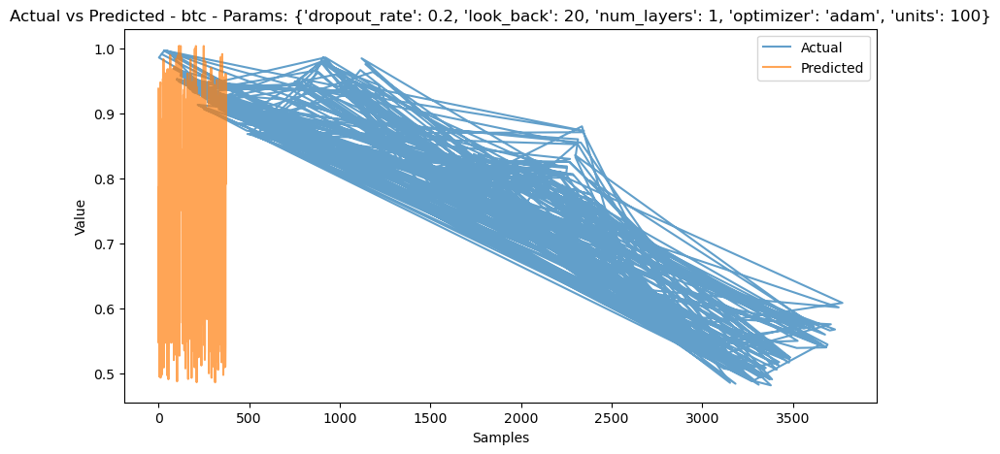

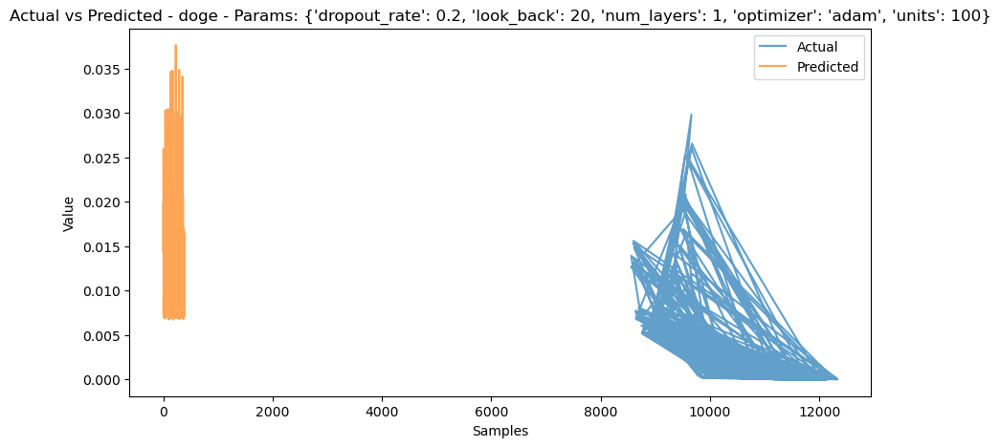

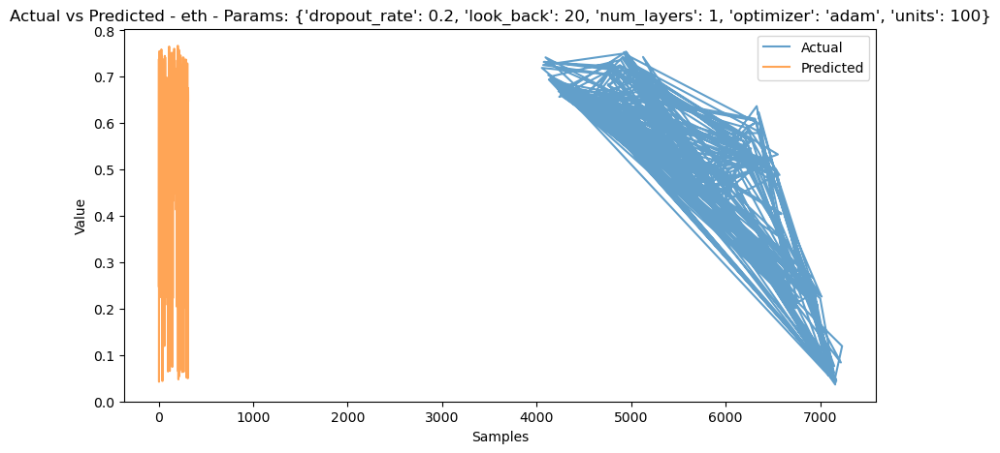

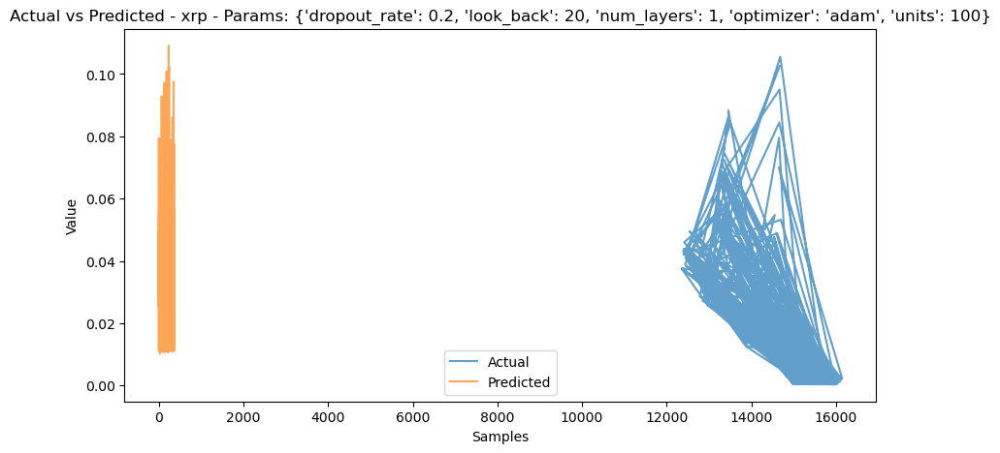

Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


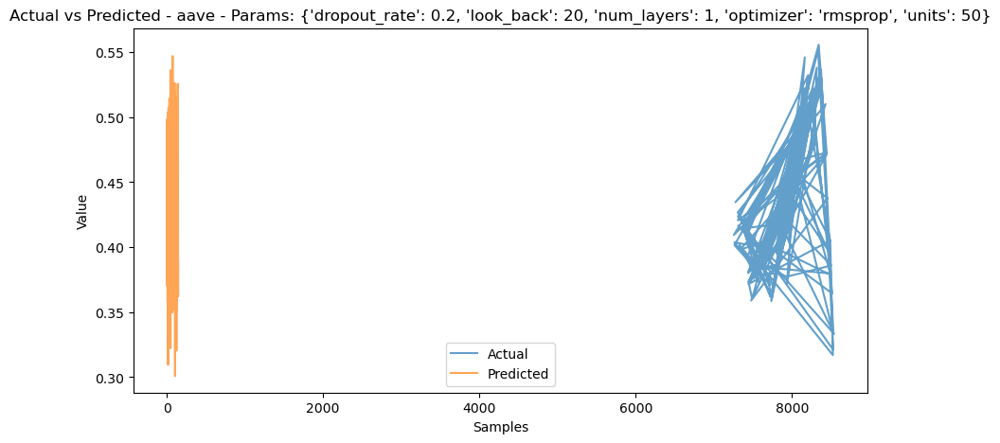

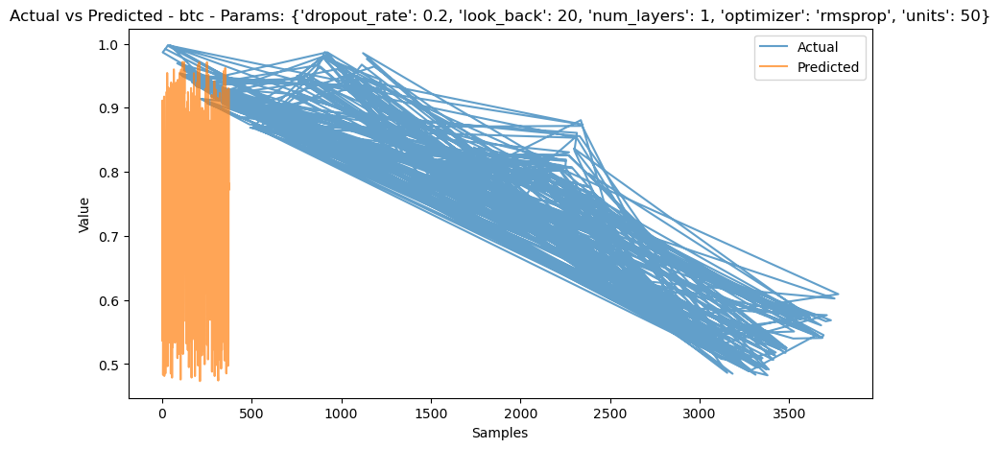

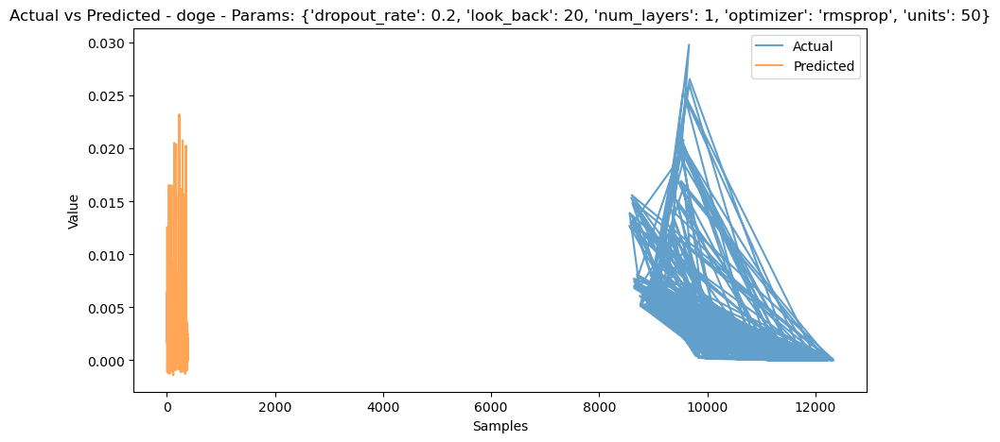

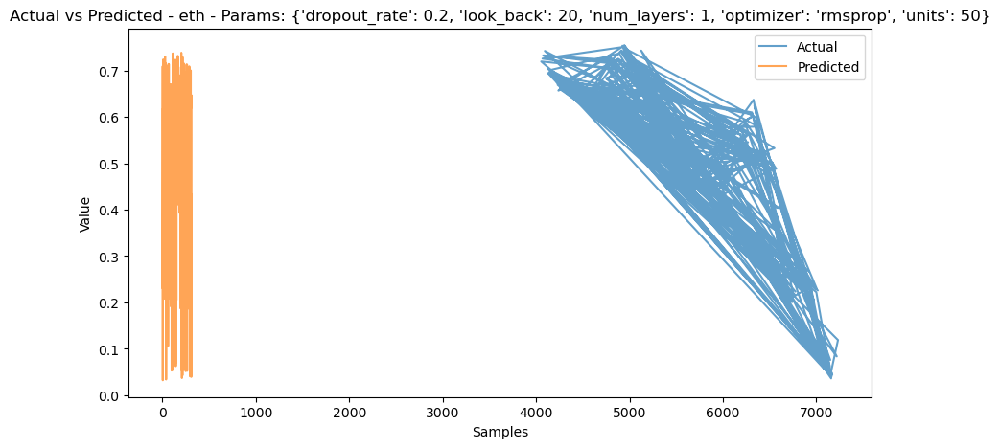

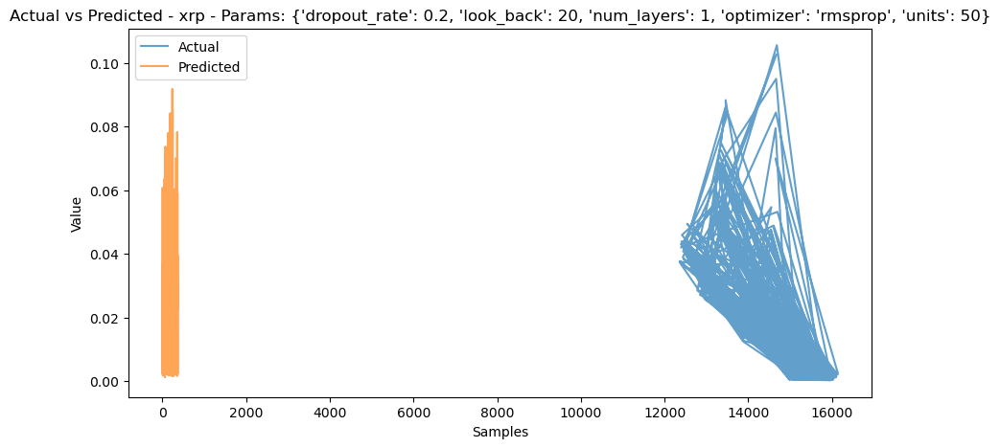

Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


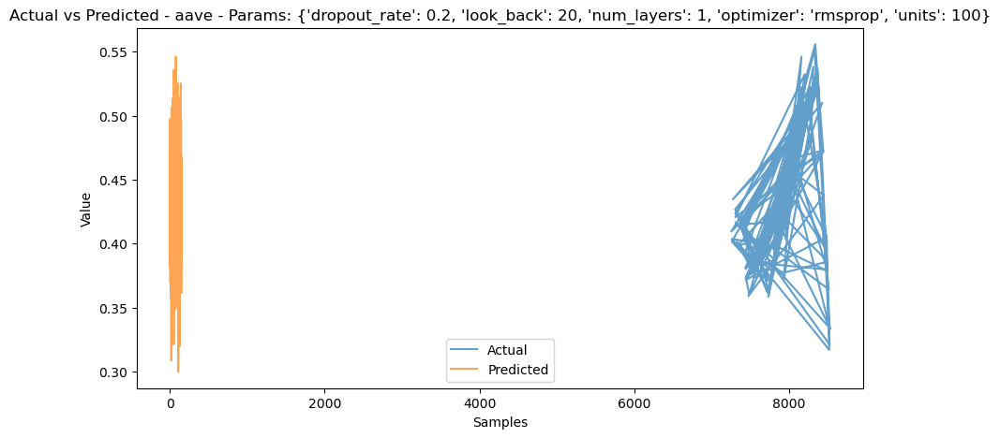

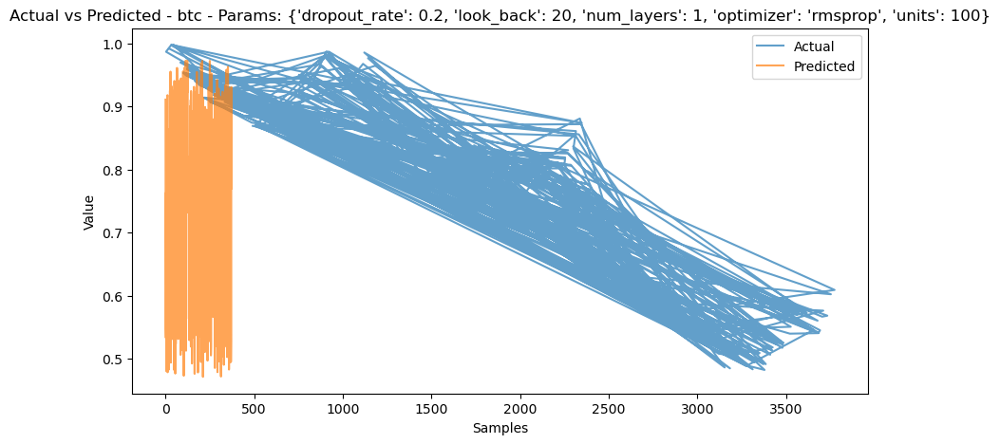

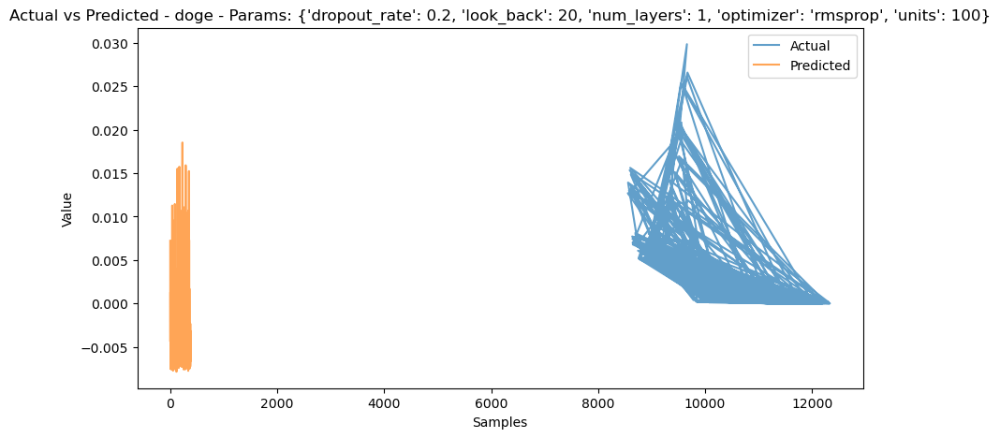

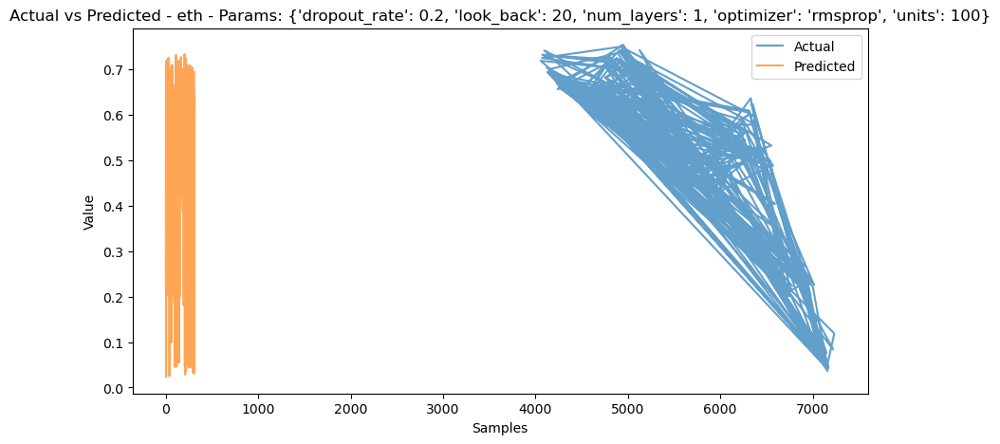

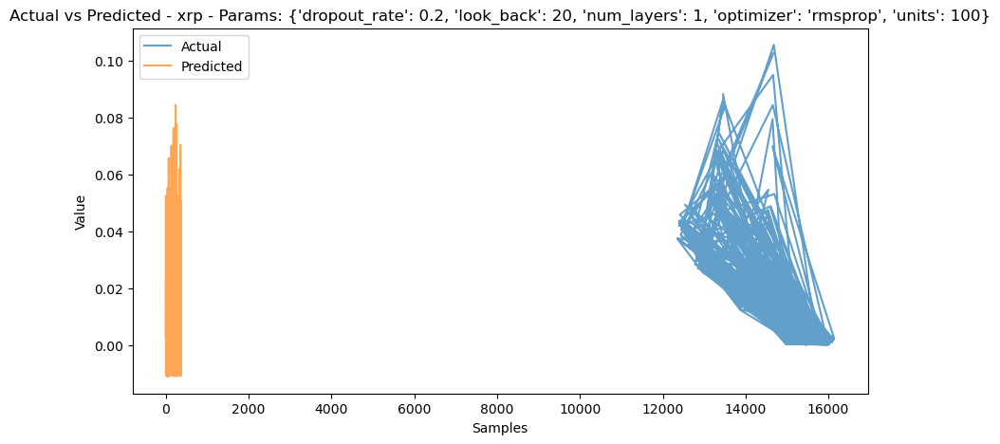

Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 1, 'optimizer': 'sgd', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


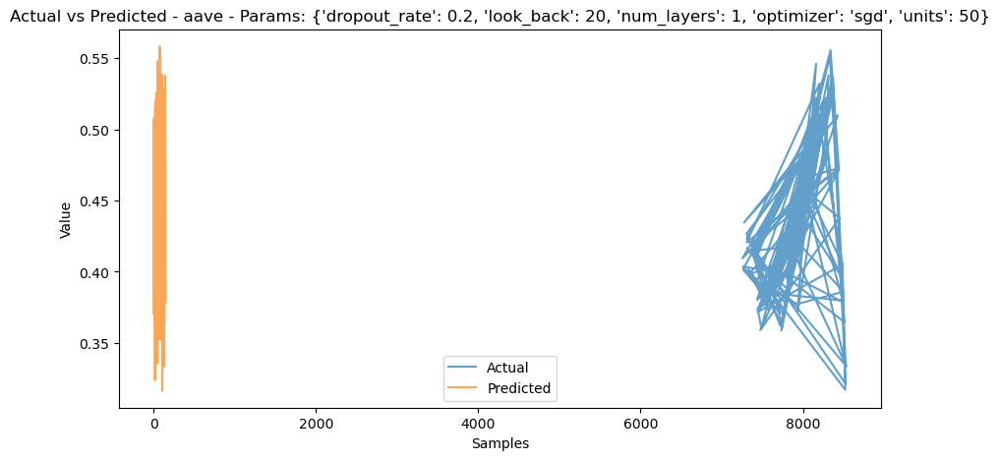

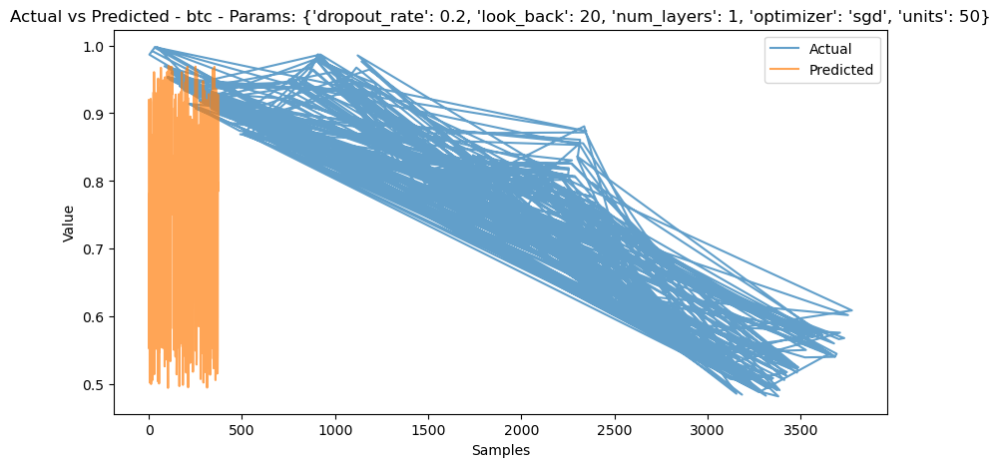

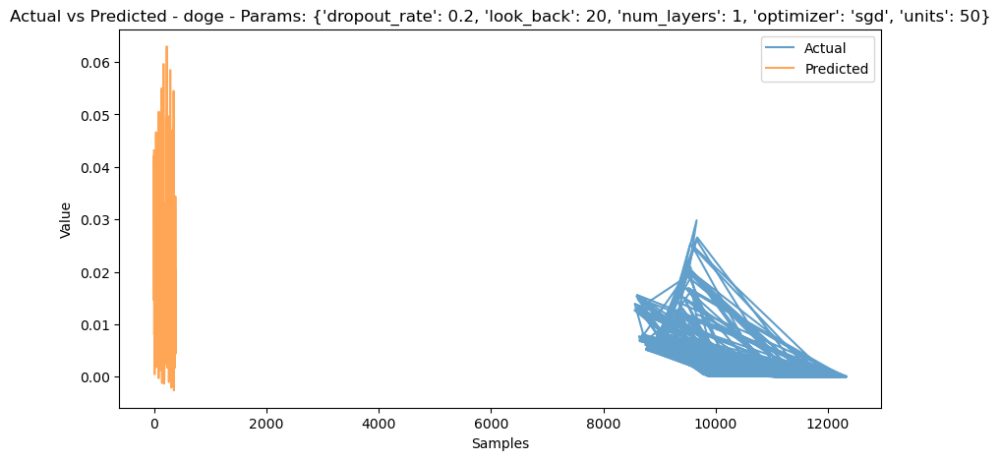

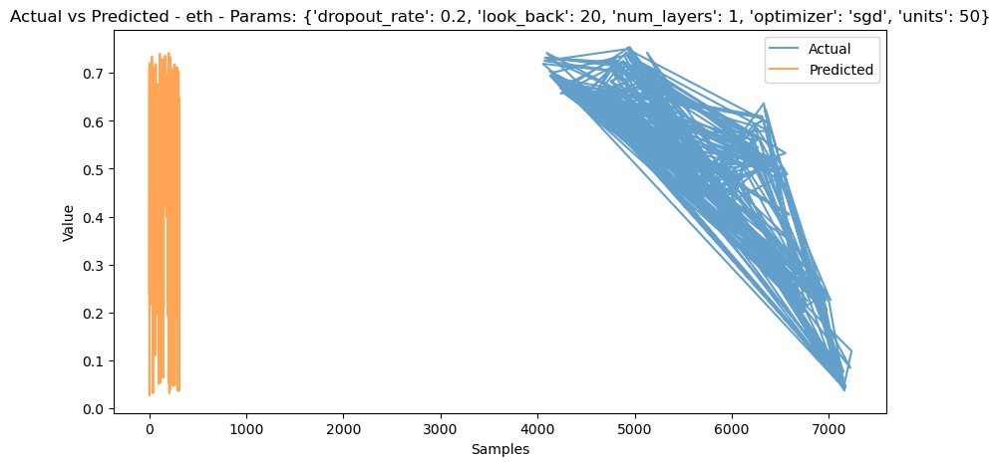

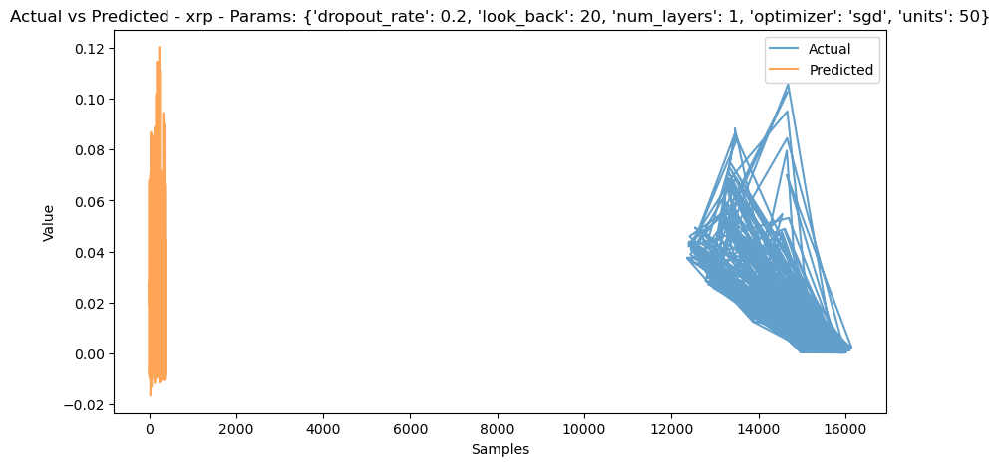

Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 1, 'optimizer': 'sgd', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


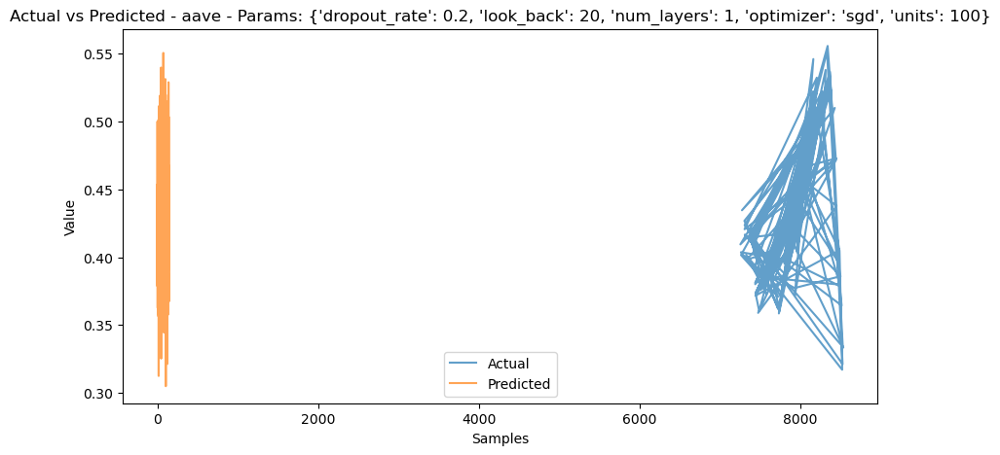

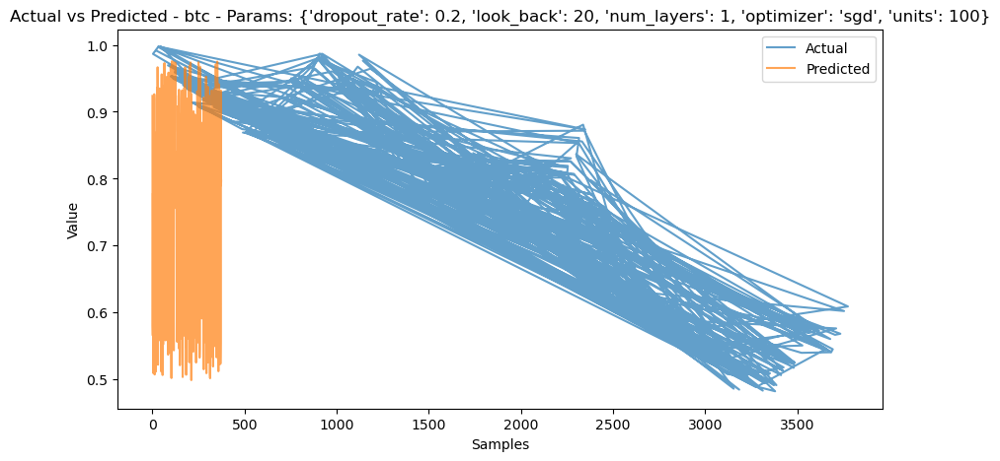

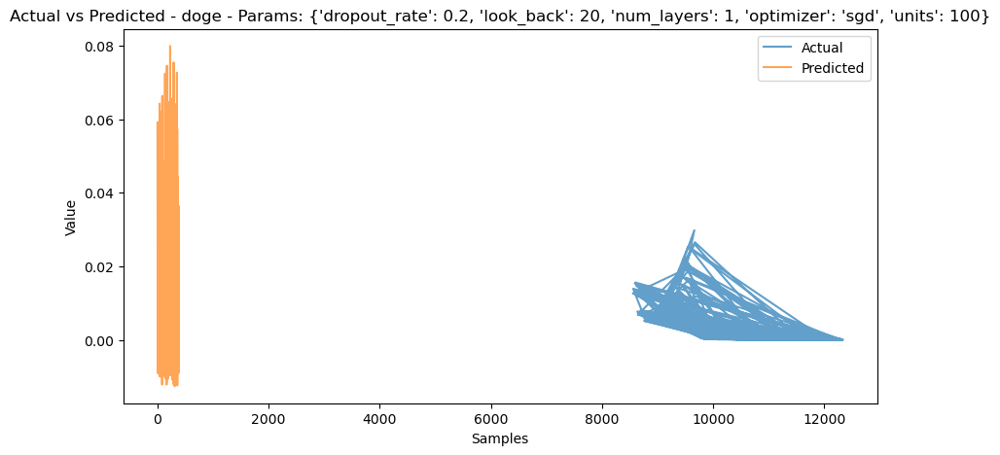

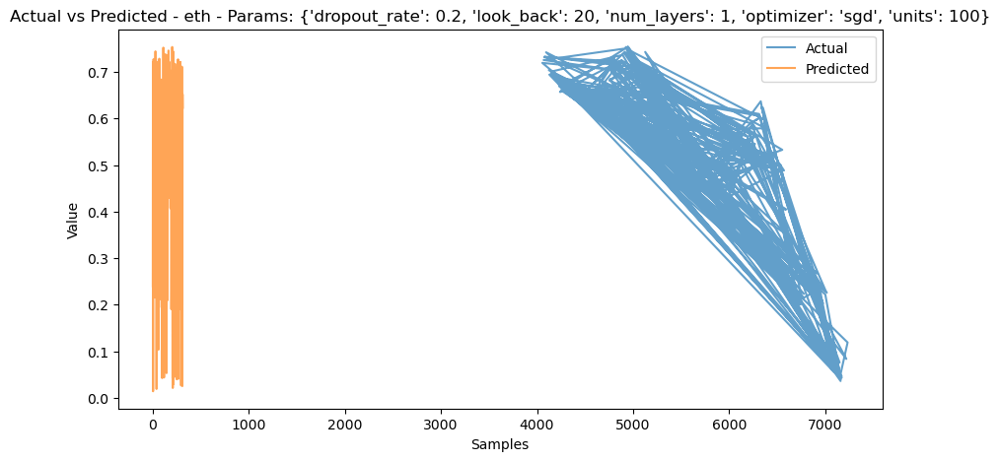

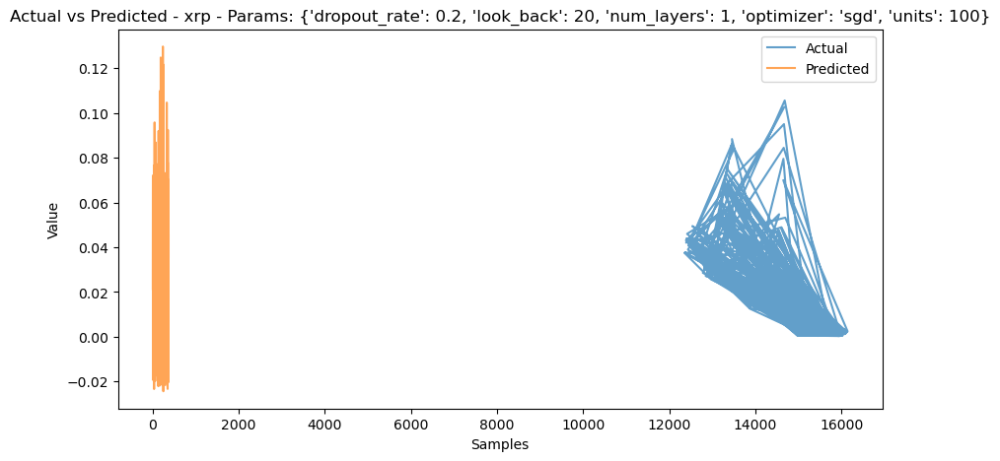

Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 1, 'optimizer': 'adagrad', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


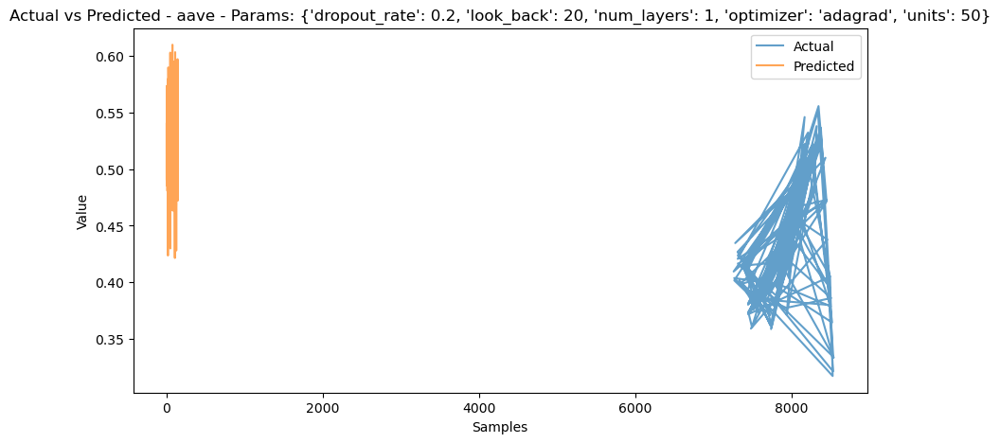

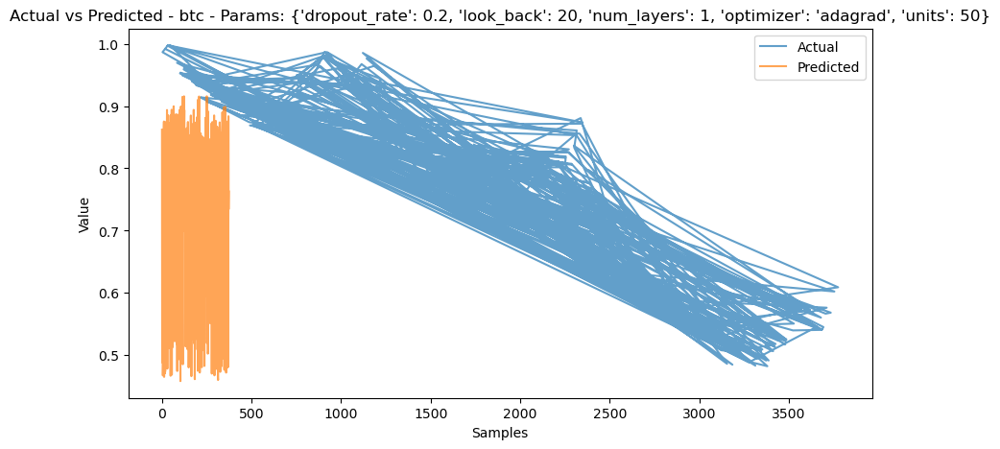

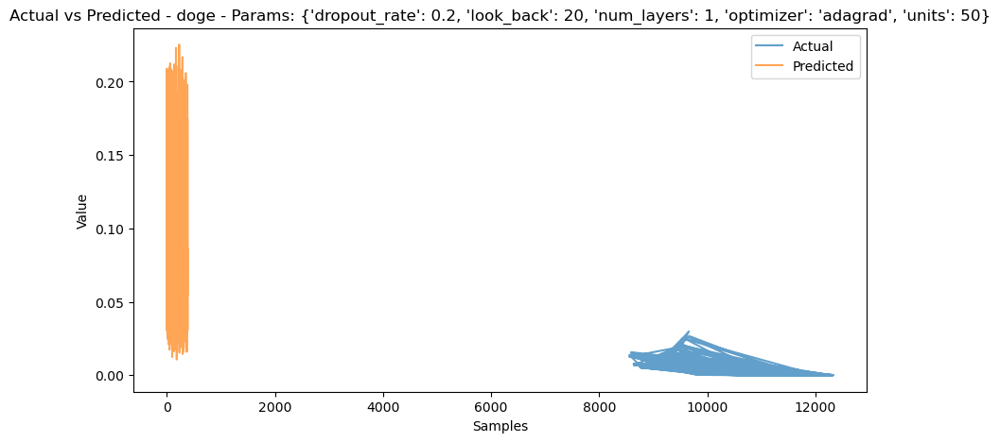

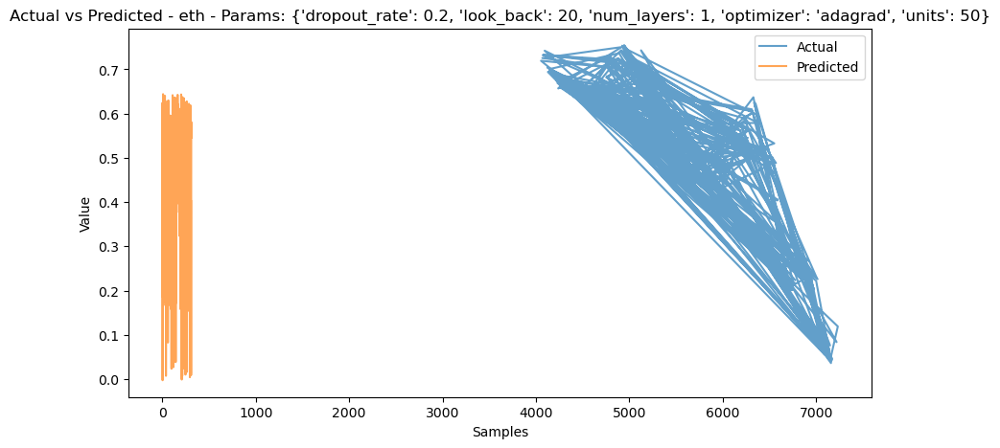

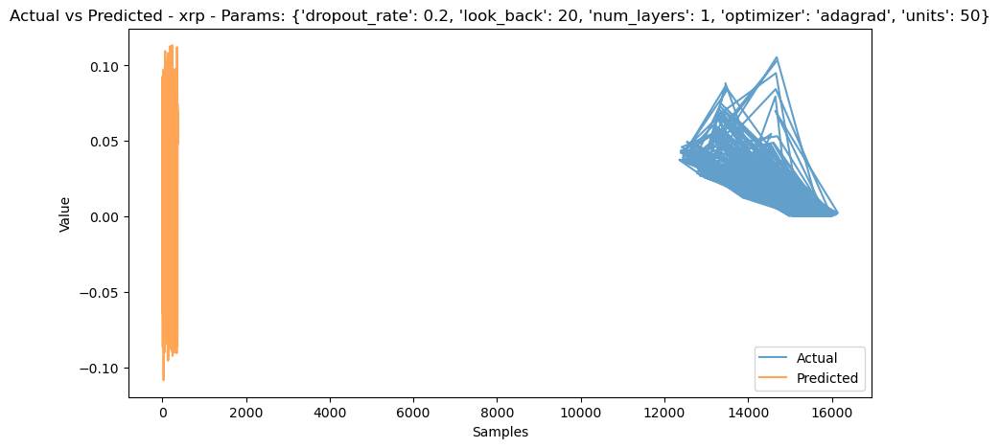

Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 1, 'optimizer': 'adagrad', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


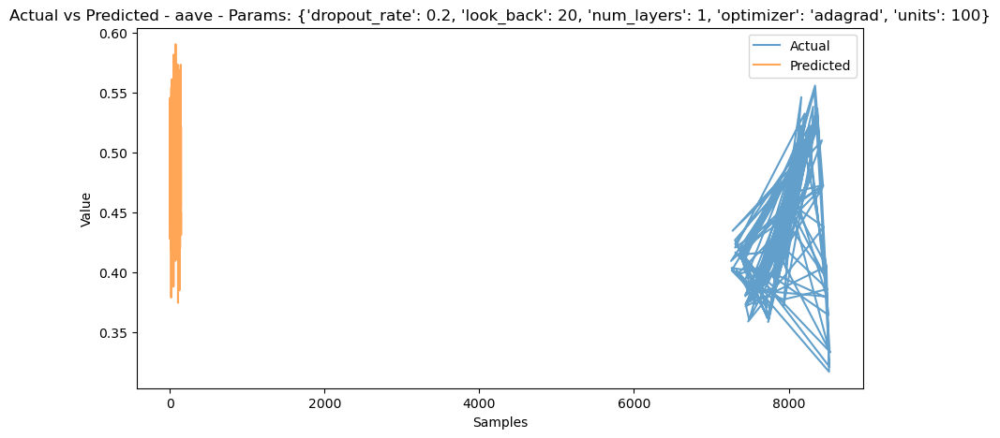

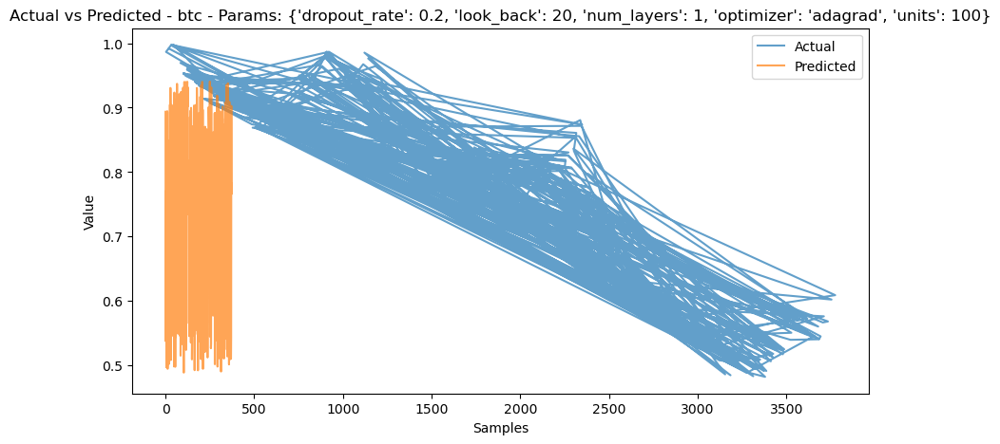

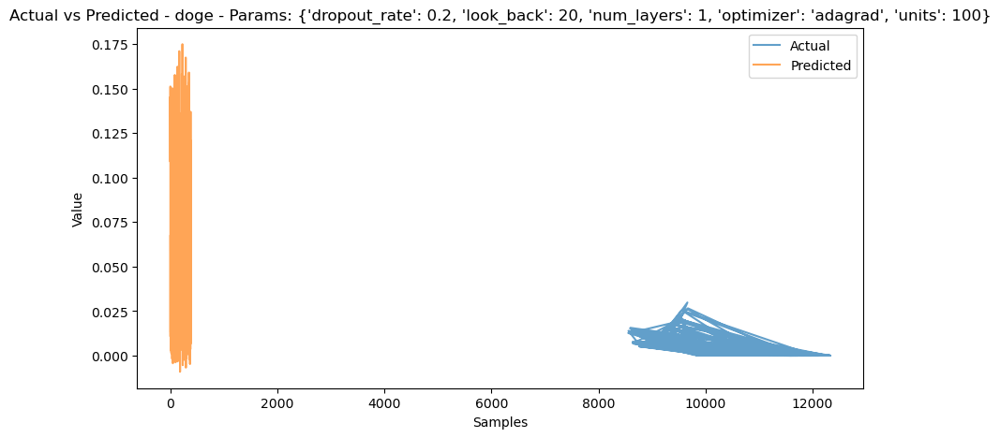

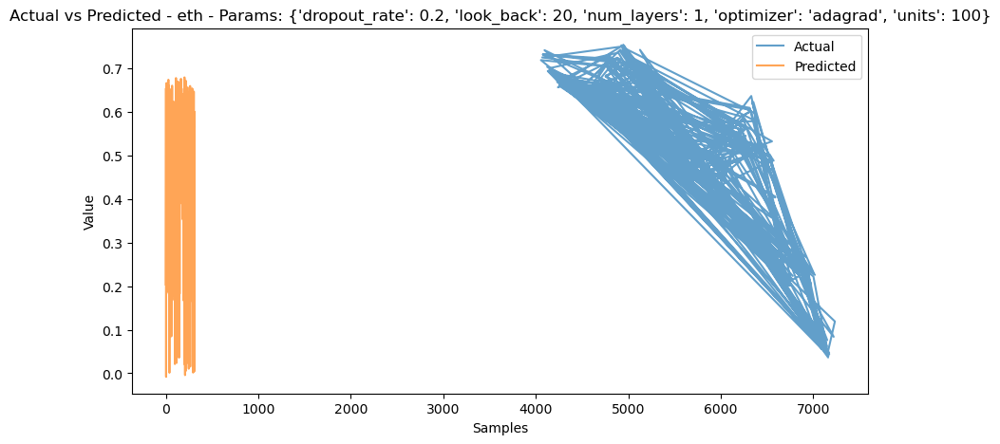

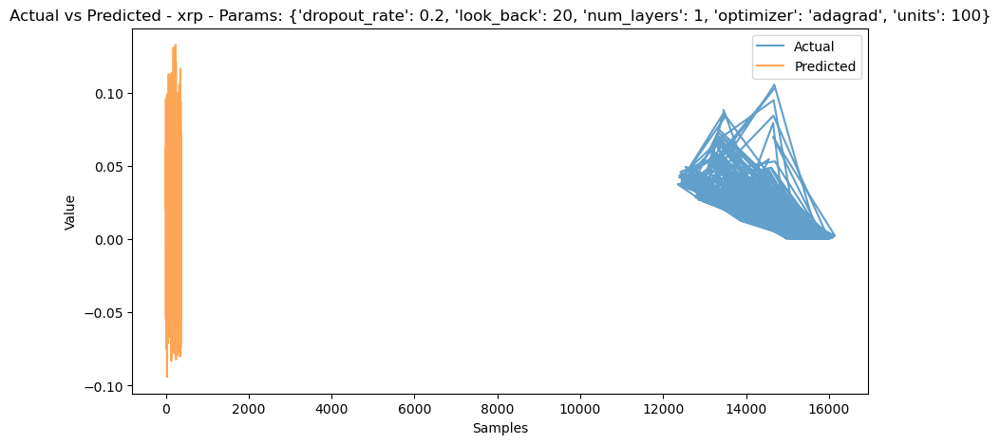

Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 2, 'optimizer': 'adam', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


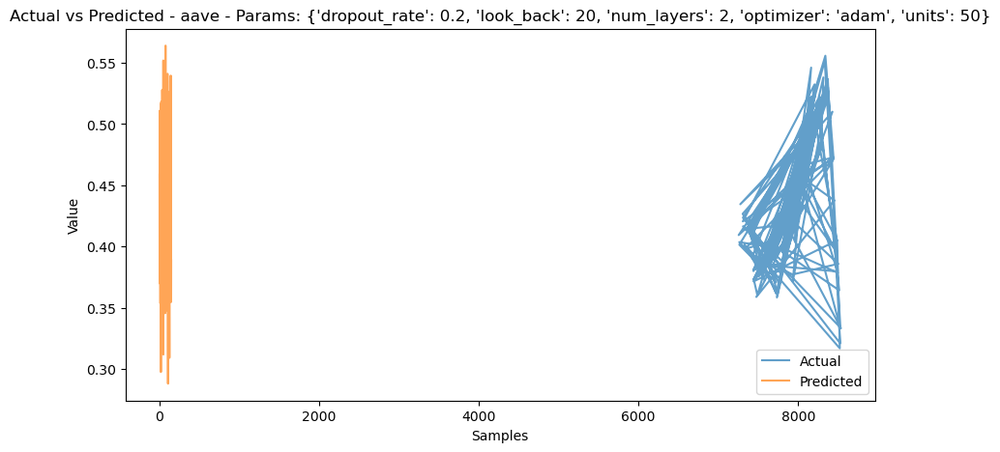

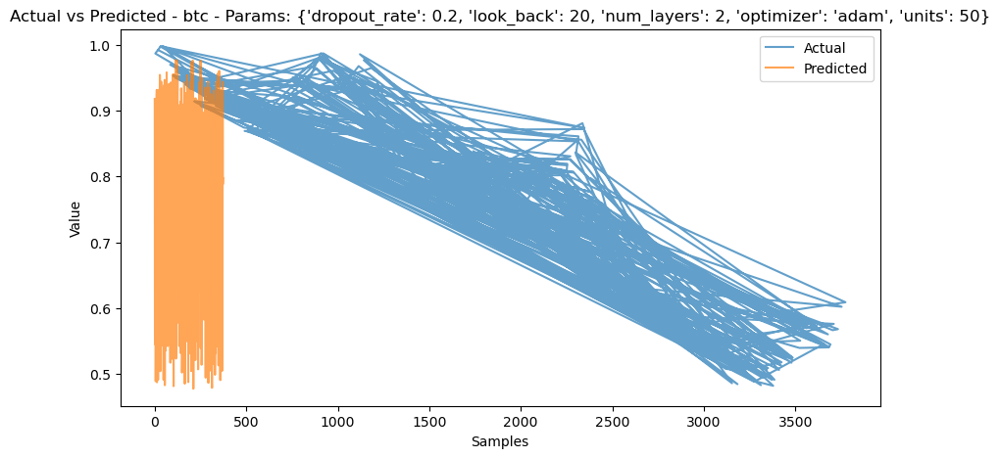

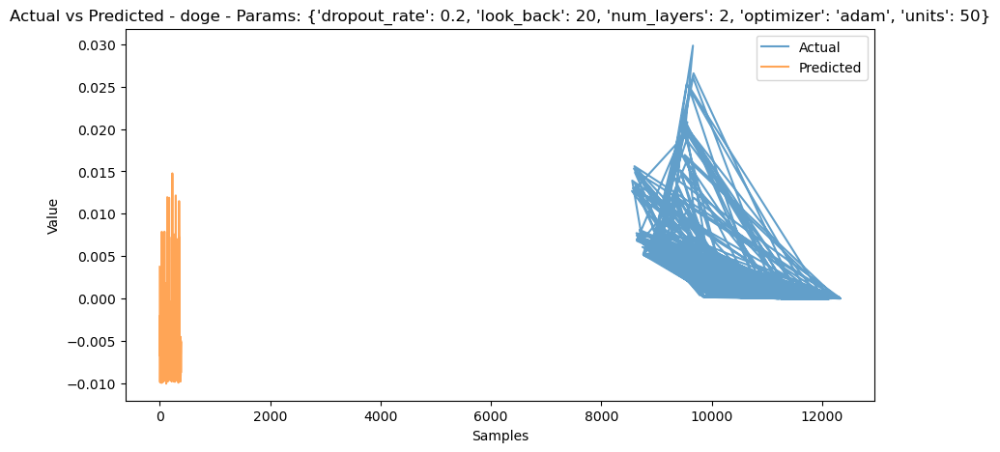

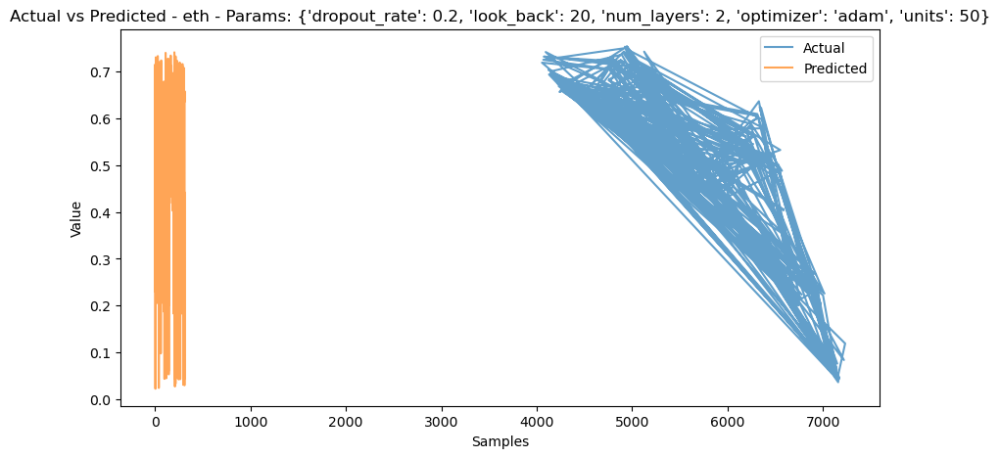

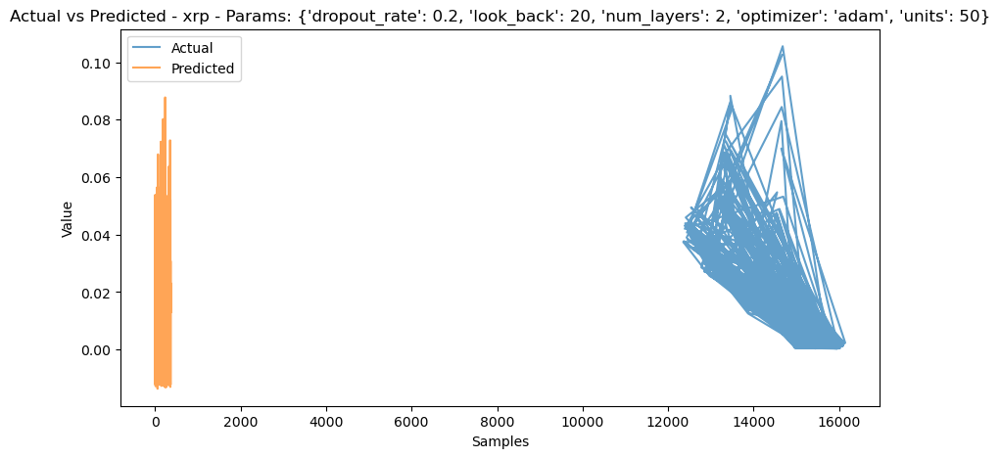

Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 2, 'optimizer': 'adam', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


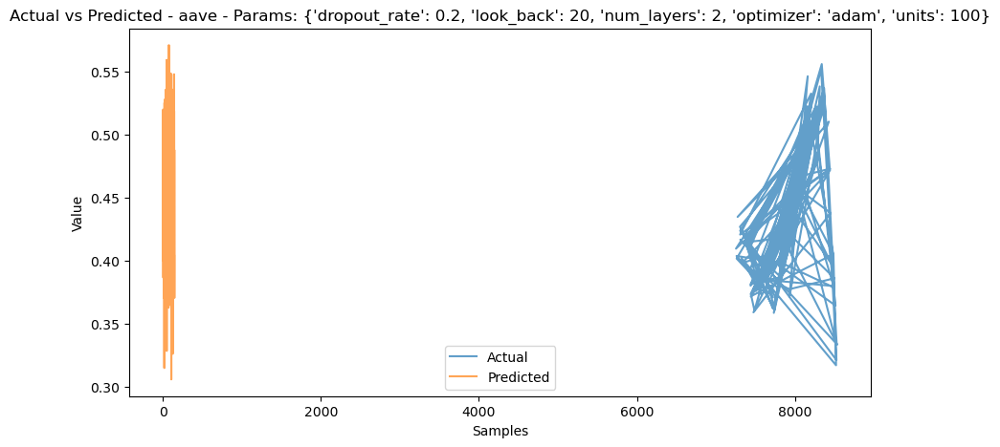

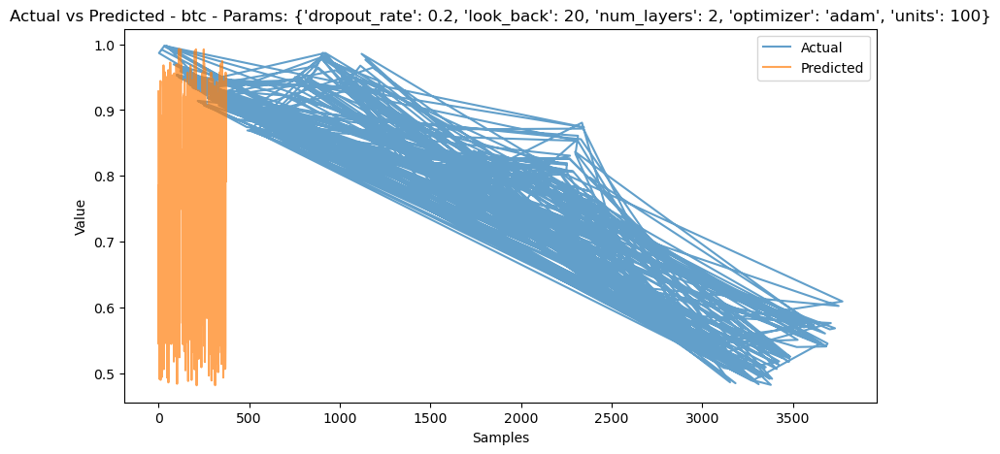

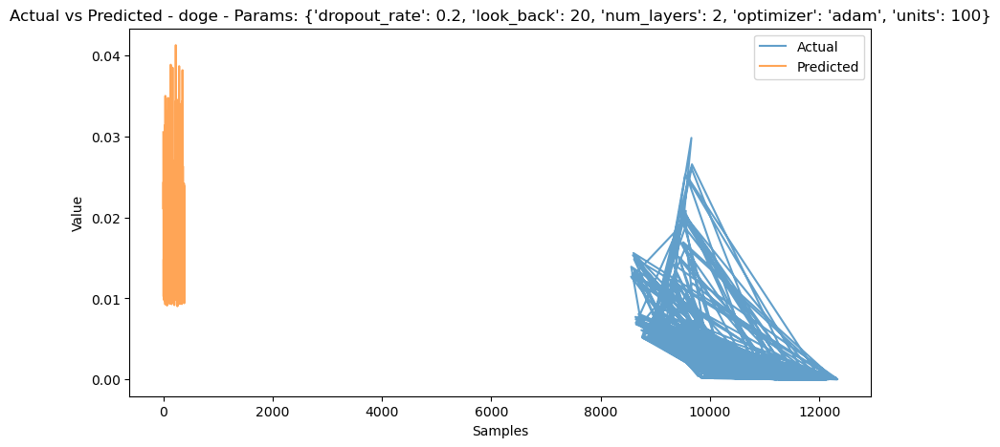

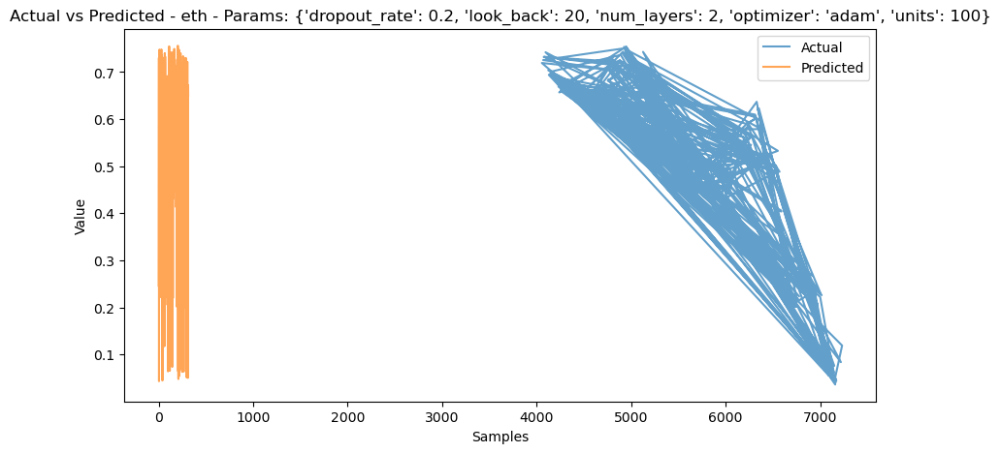

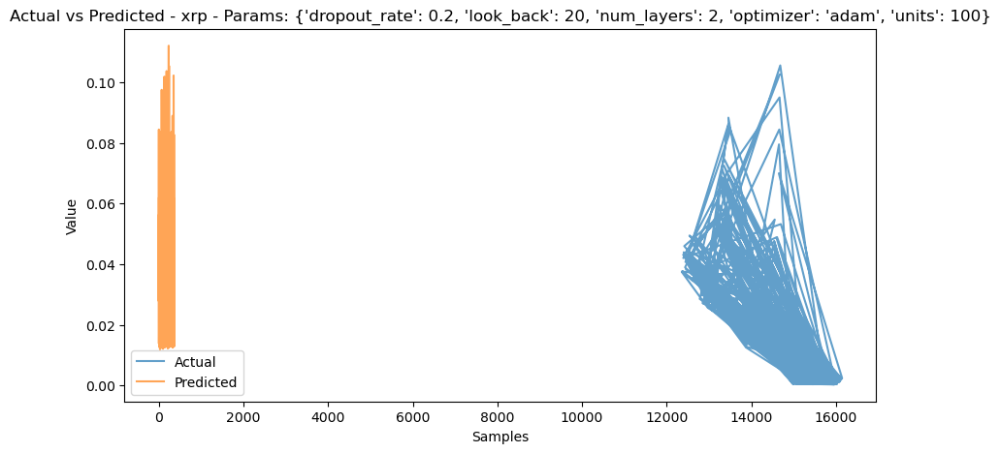

Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 2, 'optimizer': 'rmsprop', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


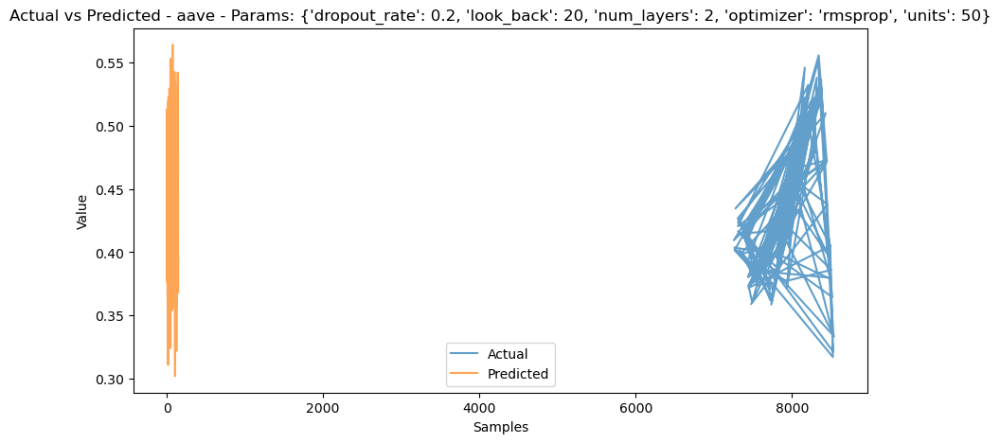

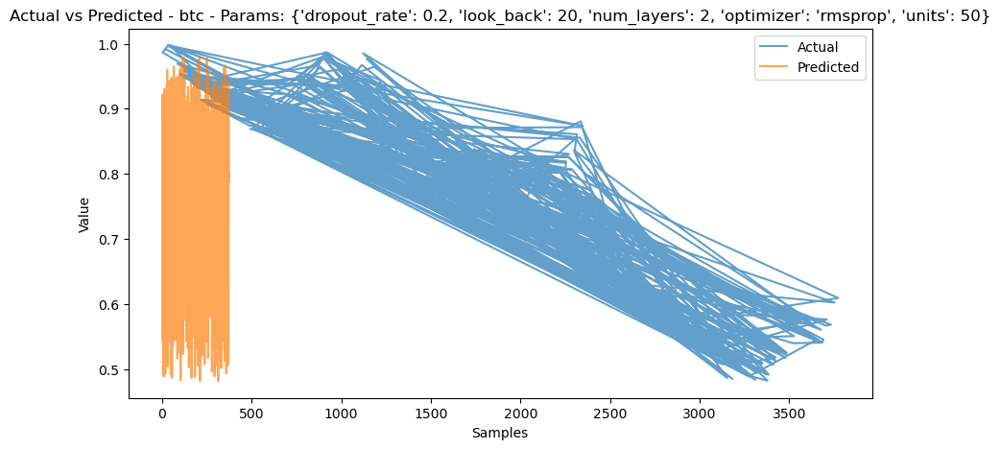

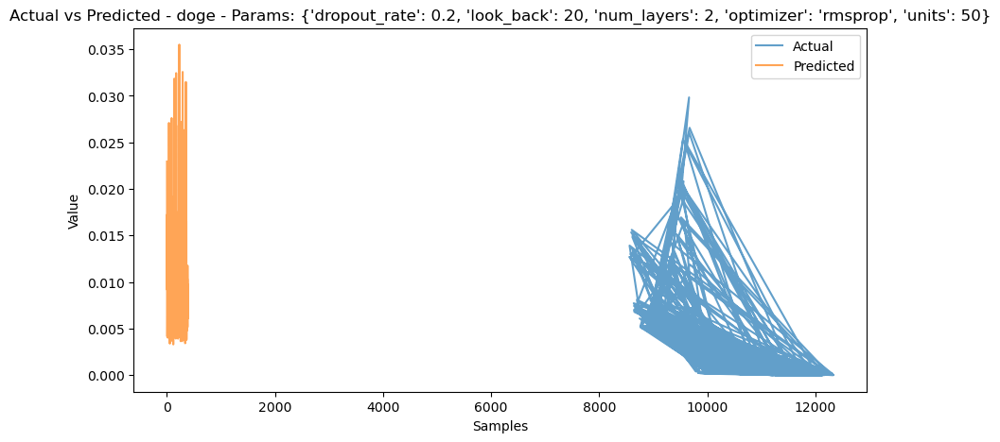

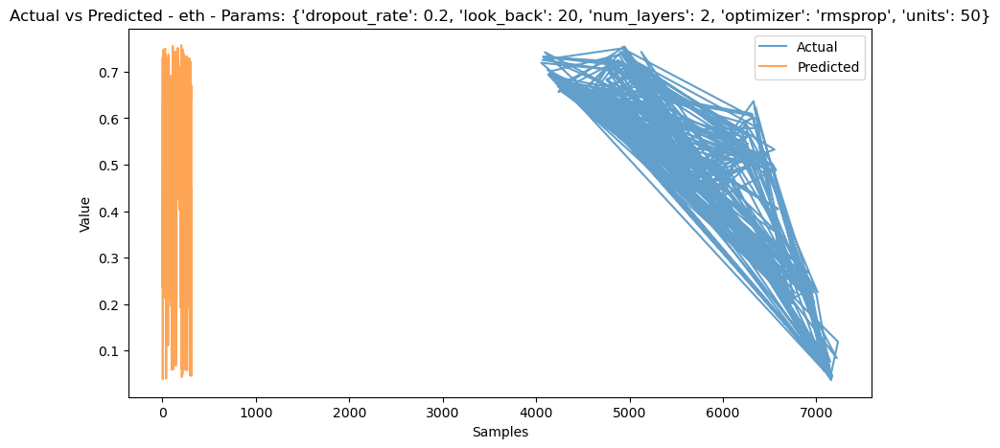

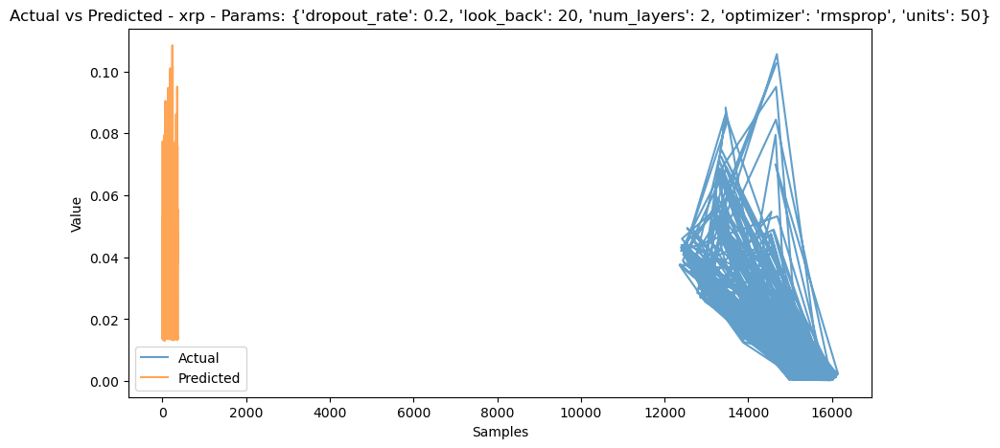

Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 2, 'optimizer': 'rmsprop', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


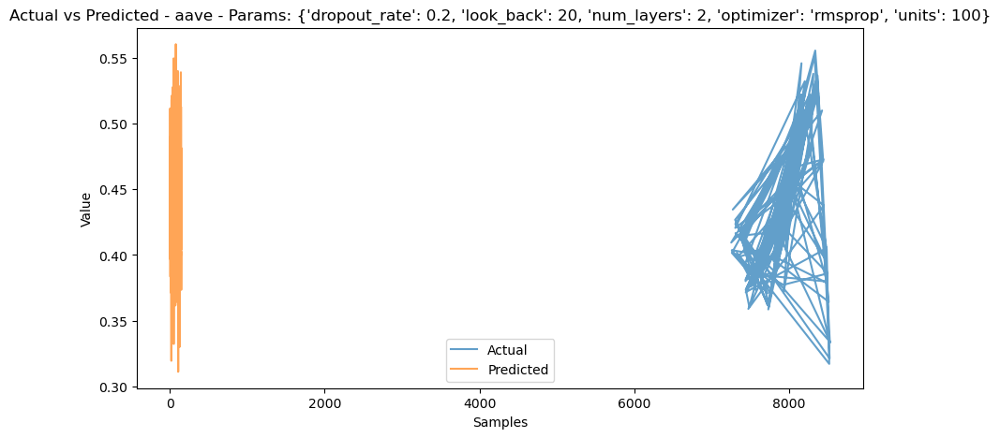

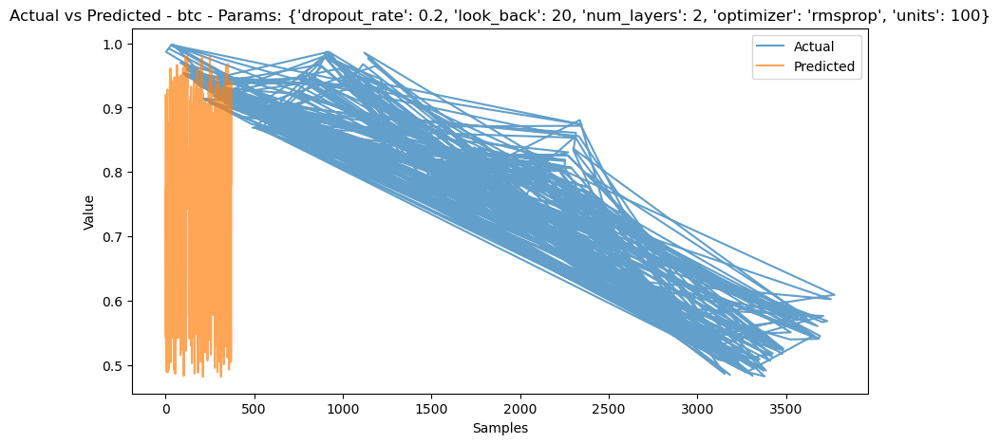

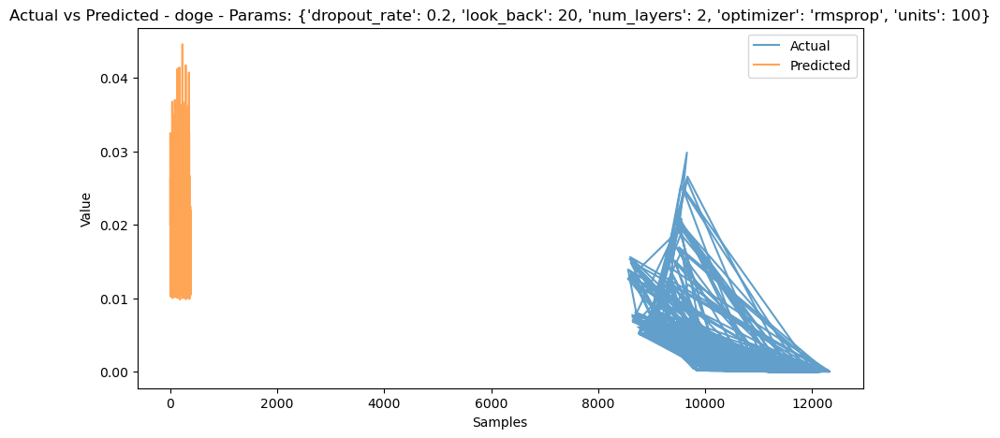

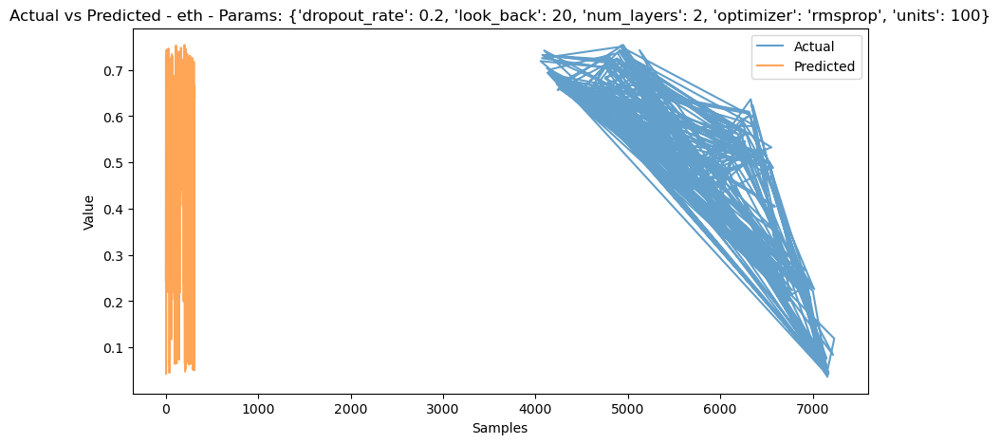

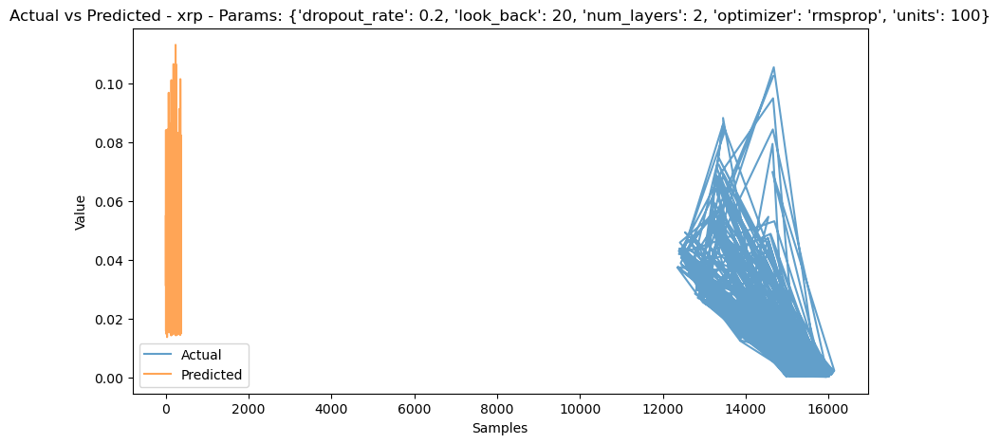

Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 2, 'optimizer': 'sgd', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


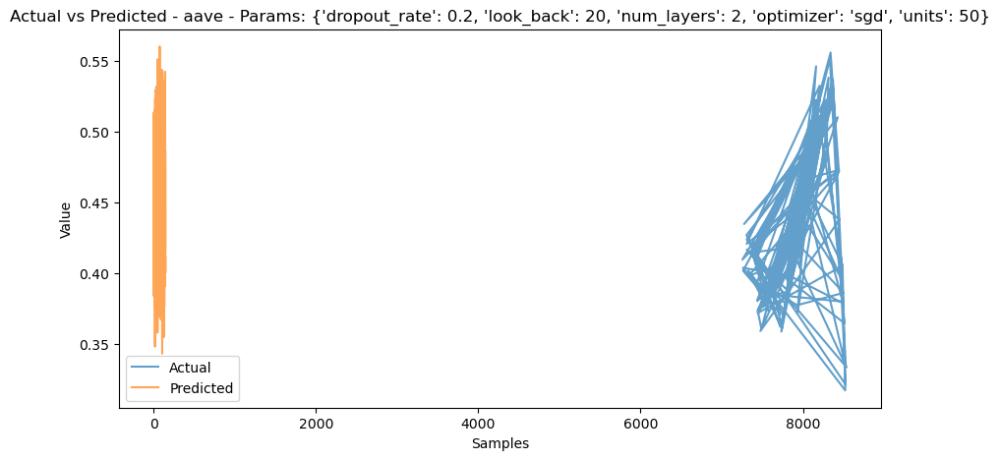

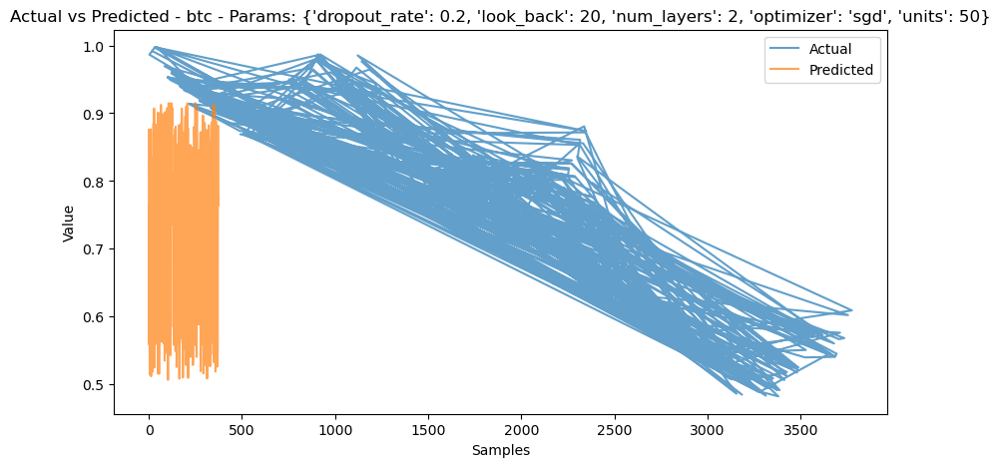

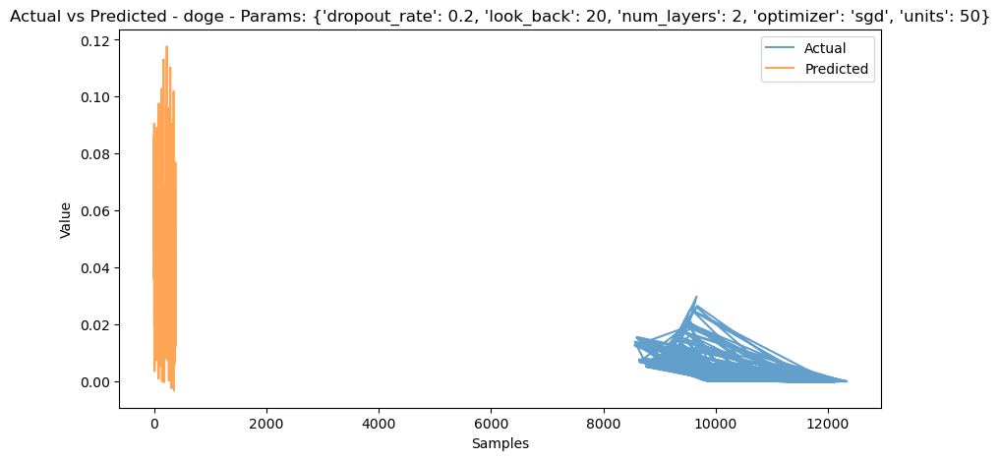

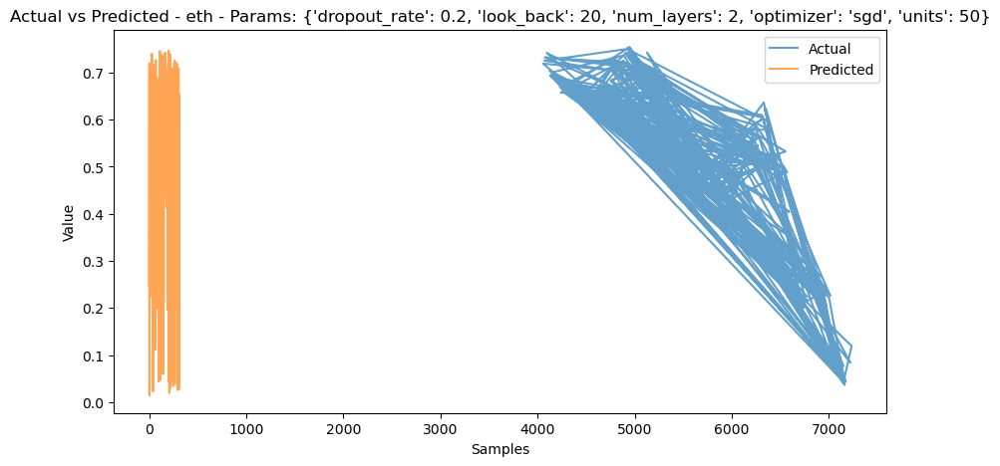

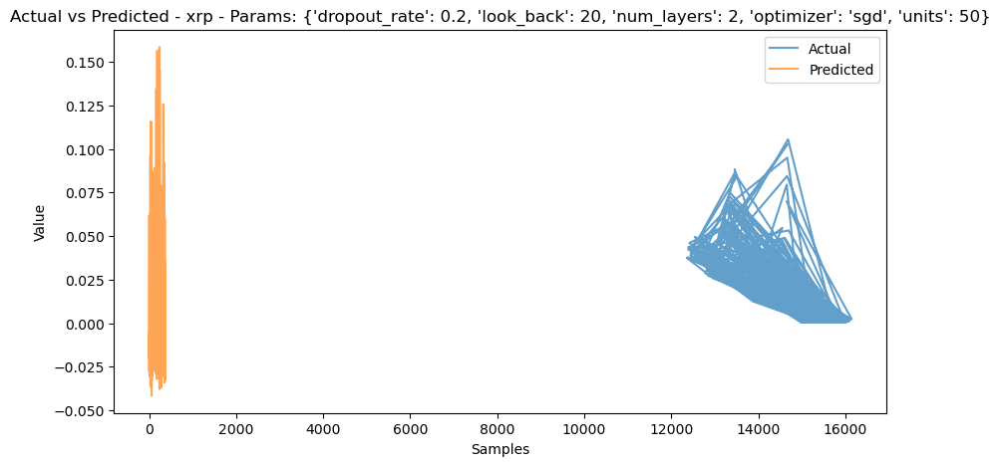

Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 2, 'optimizer': 'sgd', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


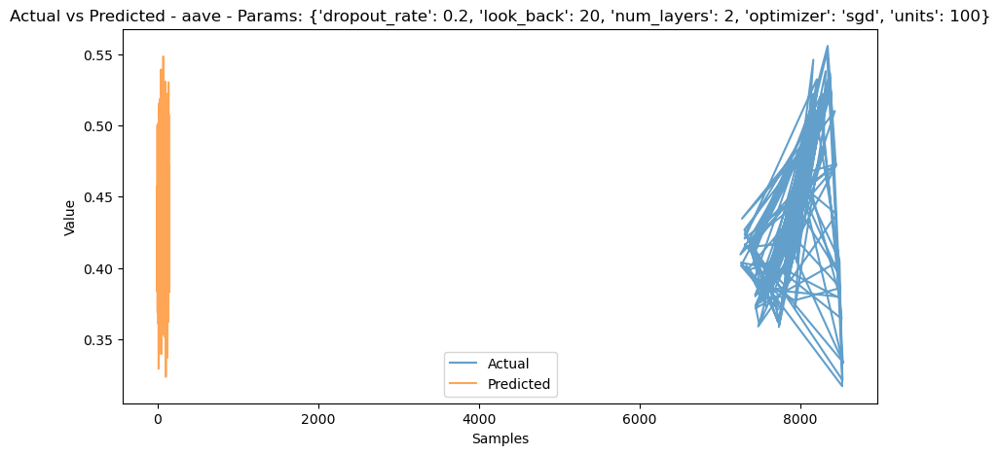

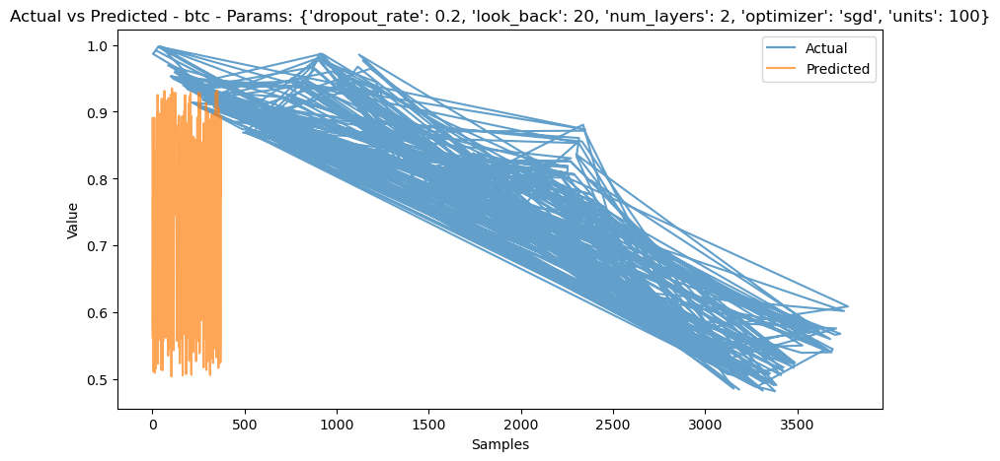

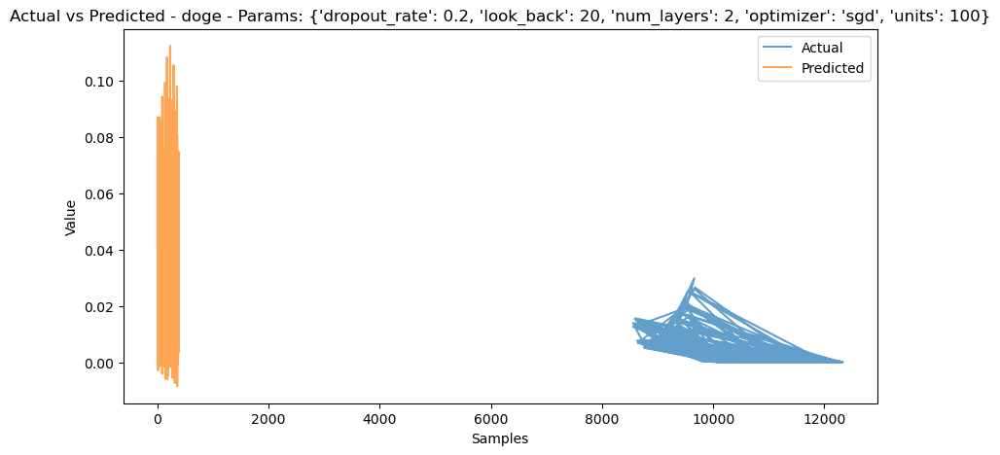

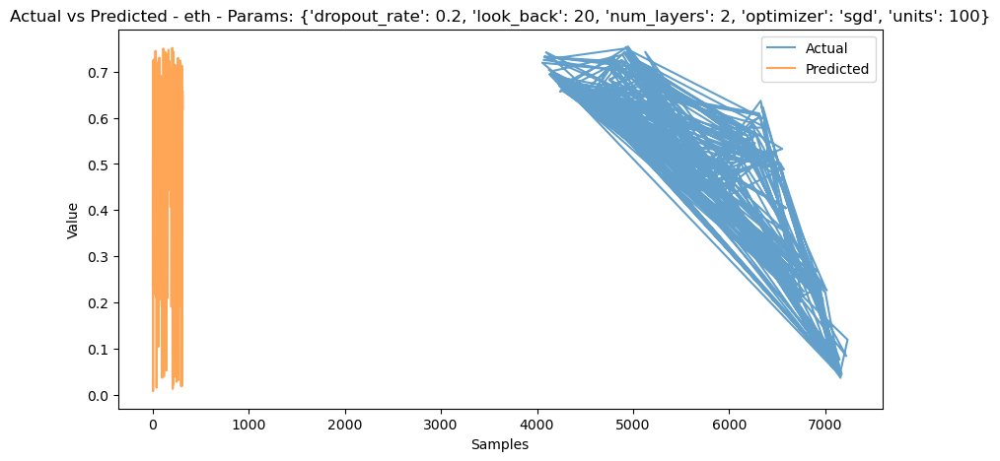

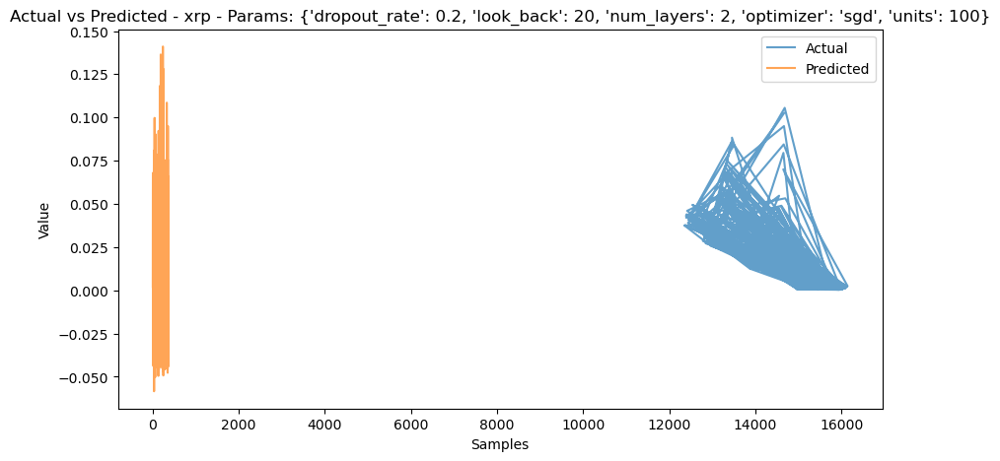

Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 2, 'optimizer': 'adagrad', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


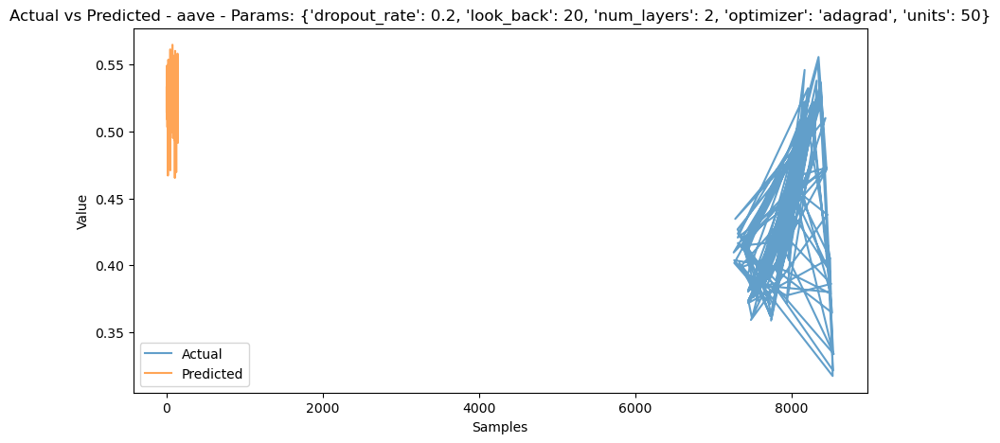

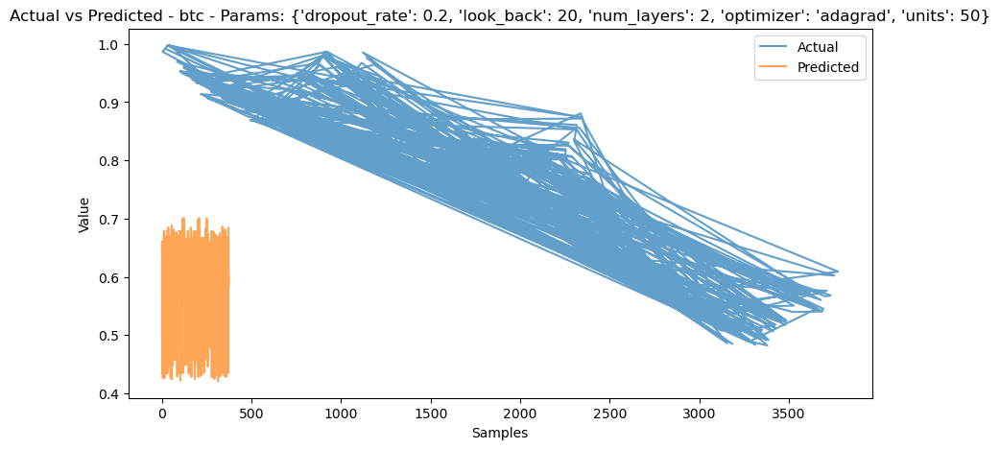

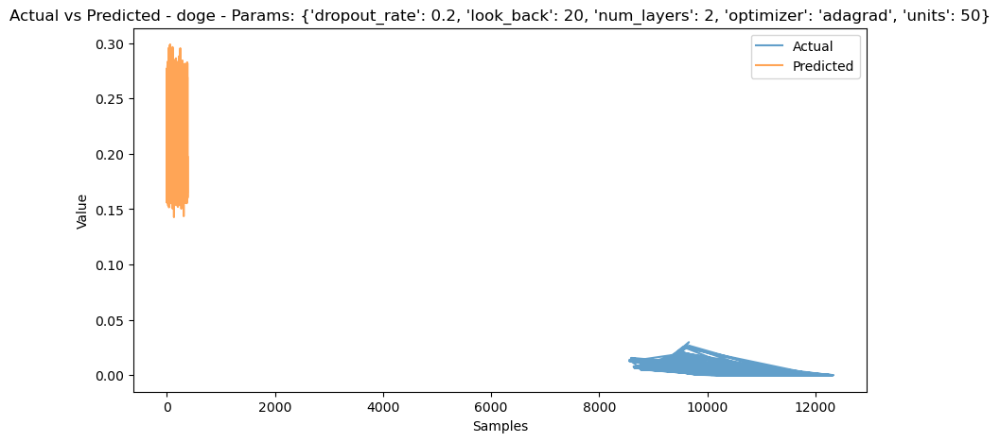

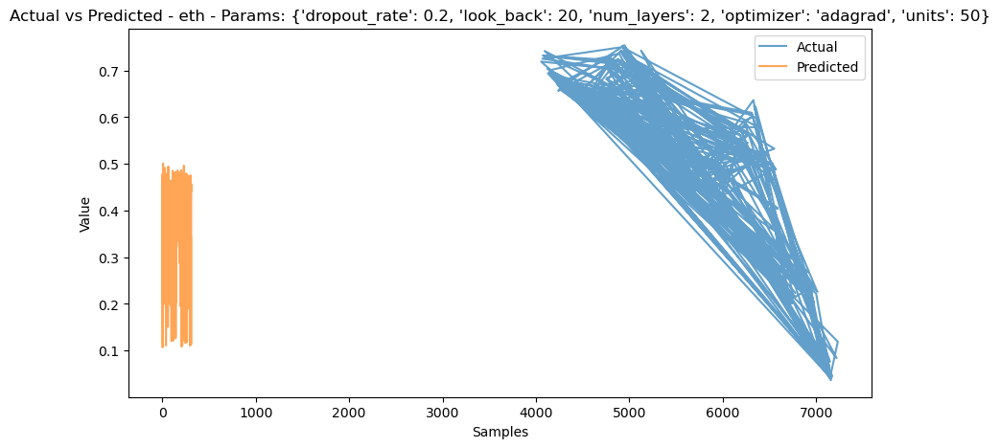

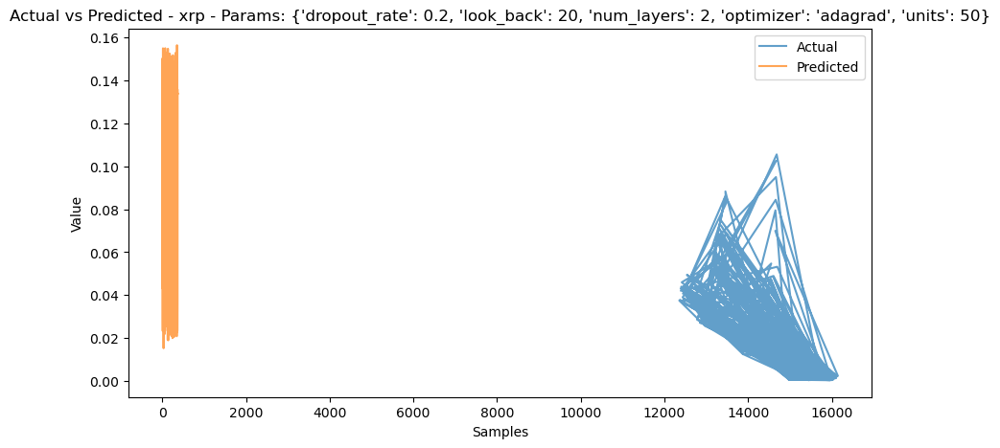

Testing parameters: {'dropout_rate': 0.2, 'look_back': 20, 'num_layers': 2, 'optimizer': 'adagrad', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


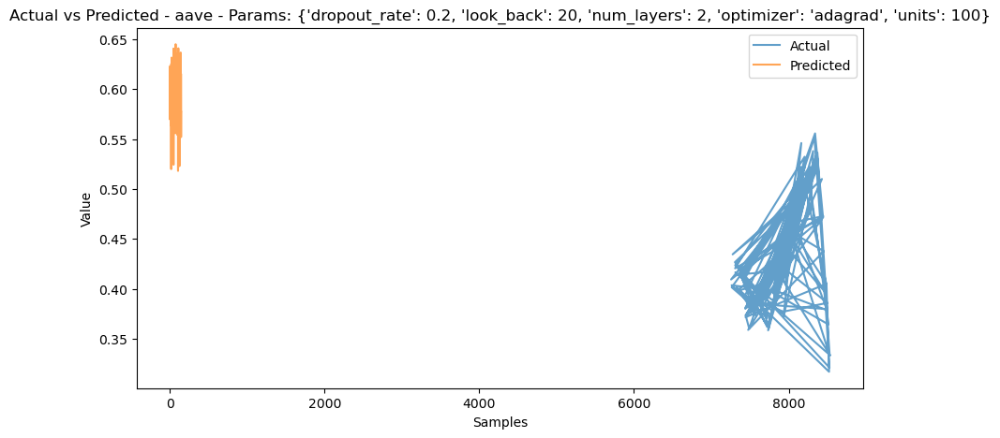

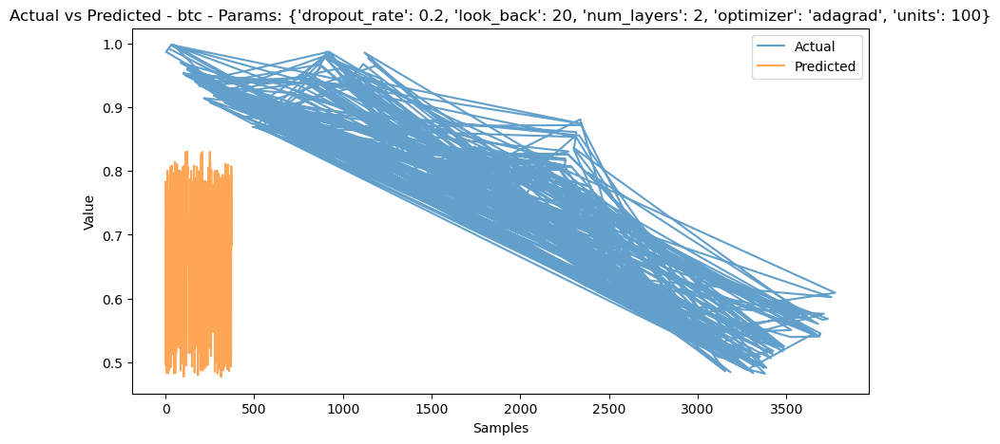

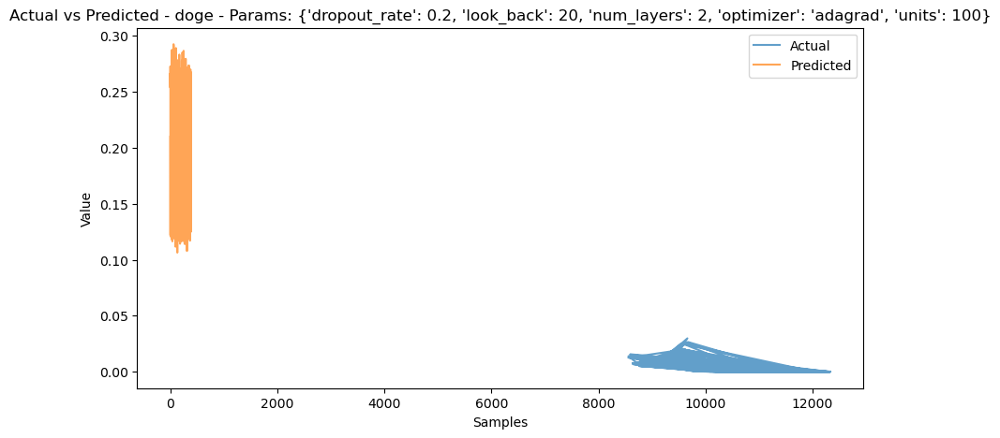

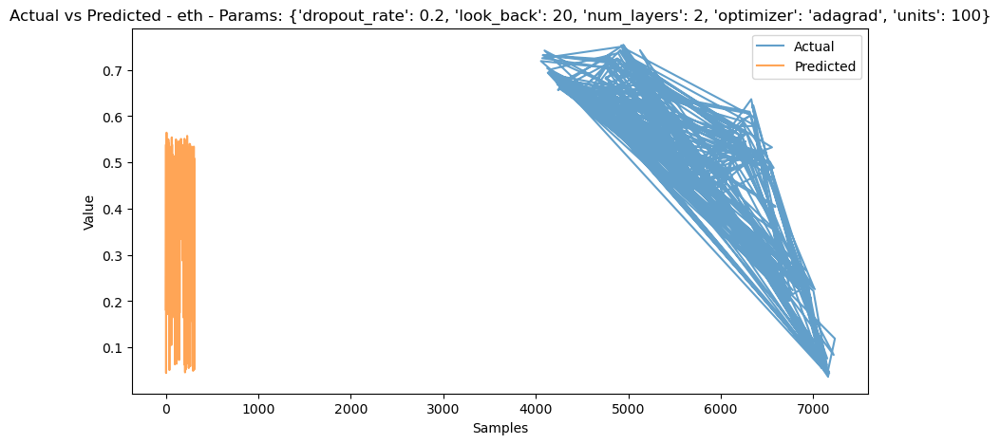

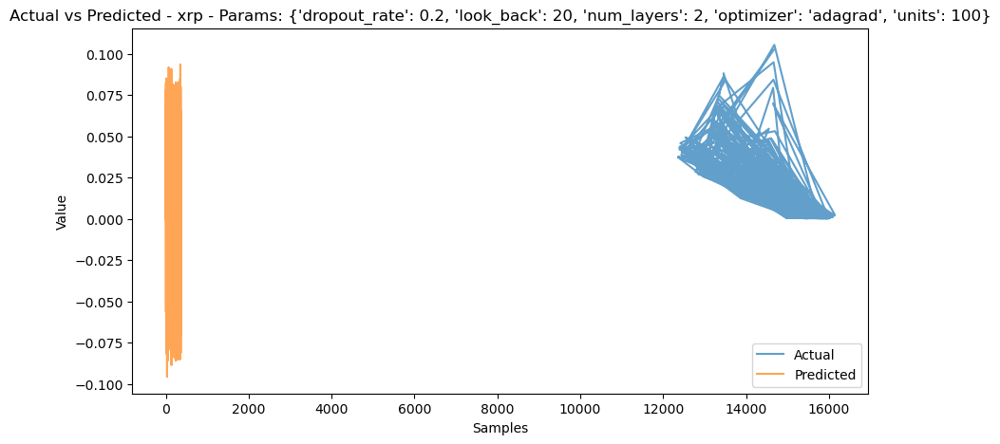

Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


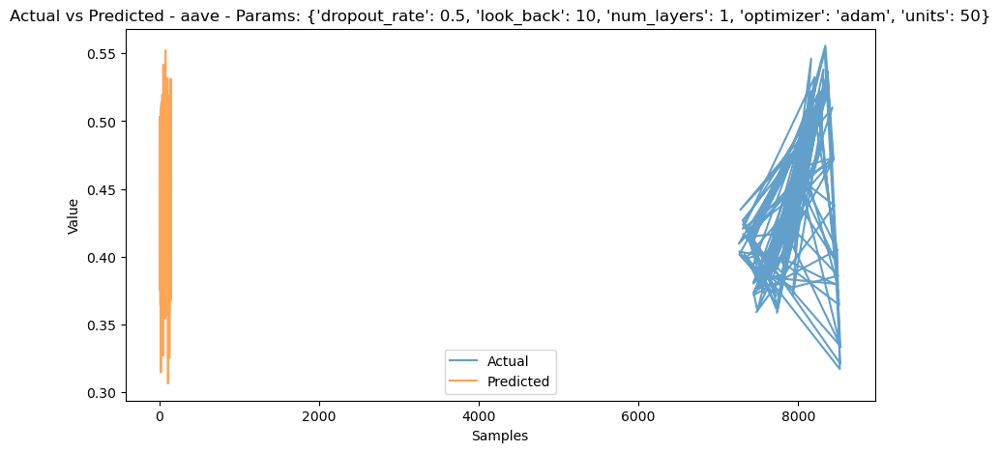

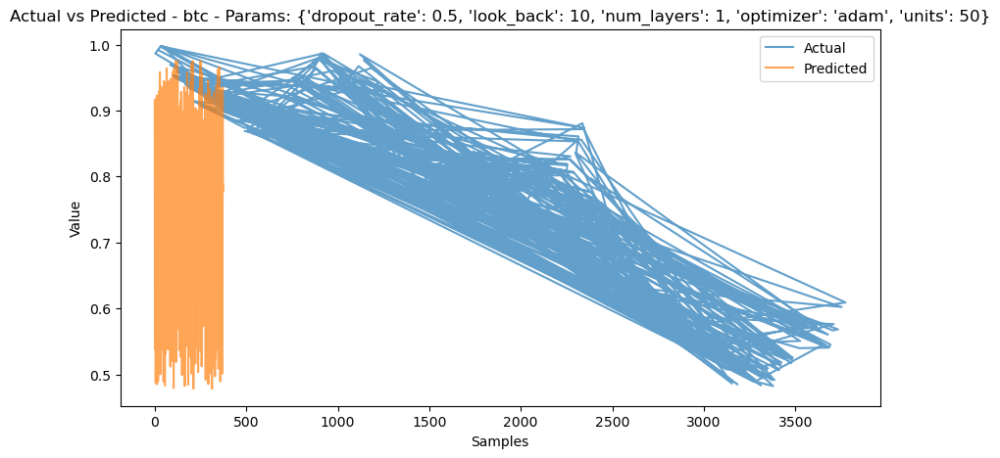

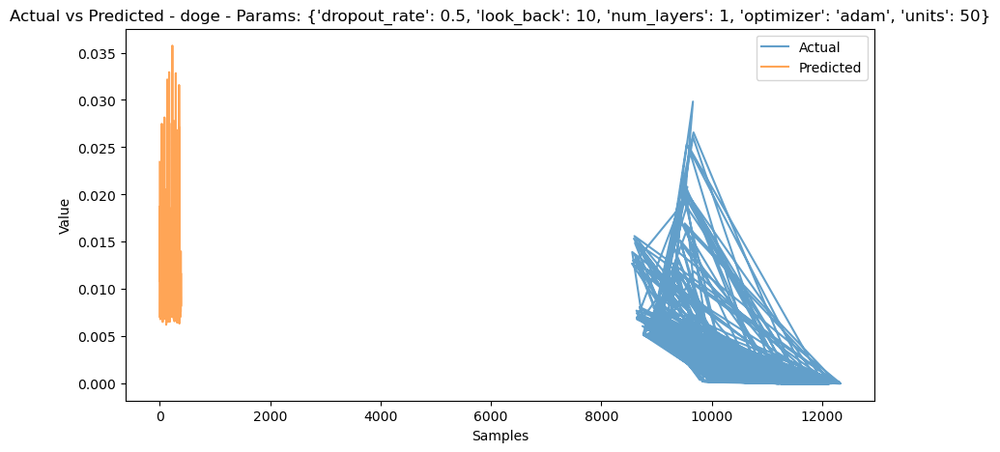

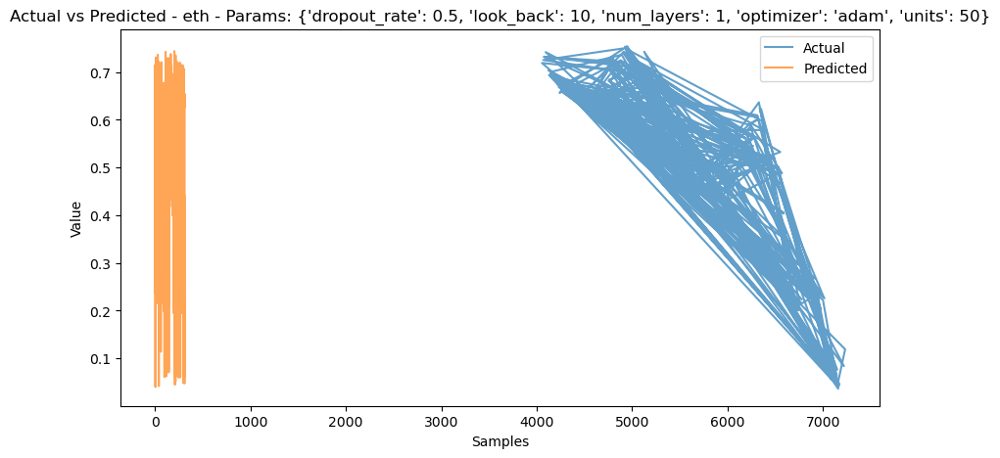

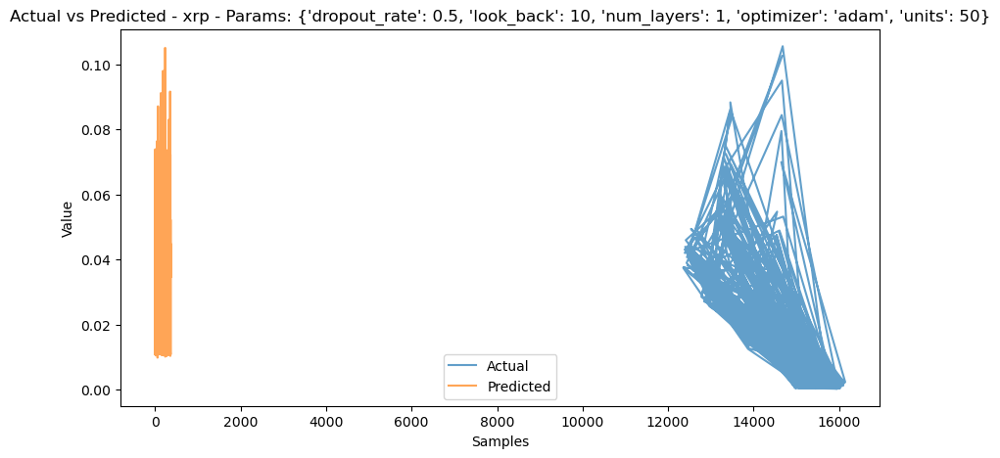

Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


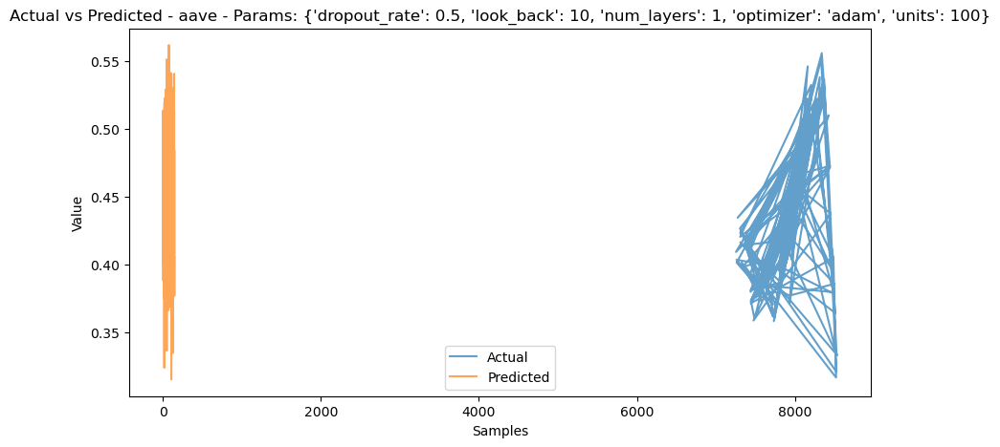

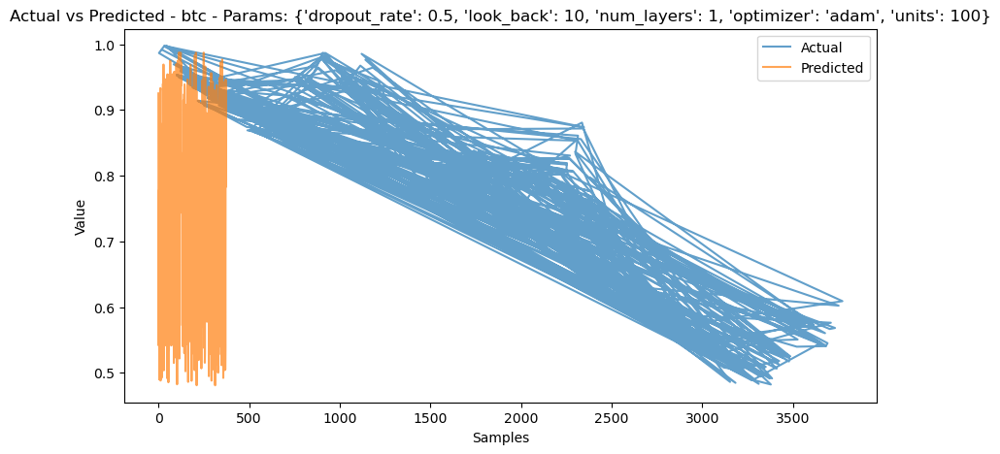

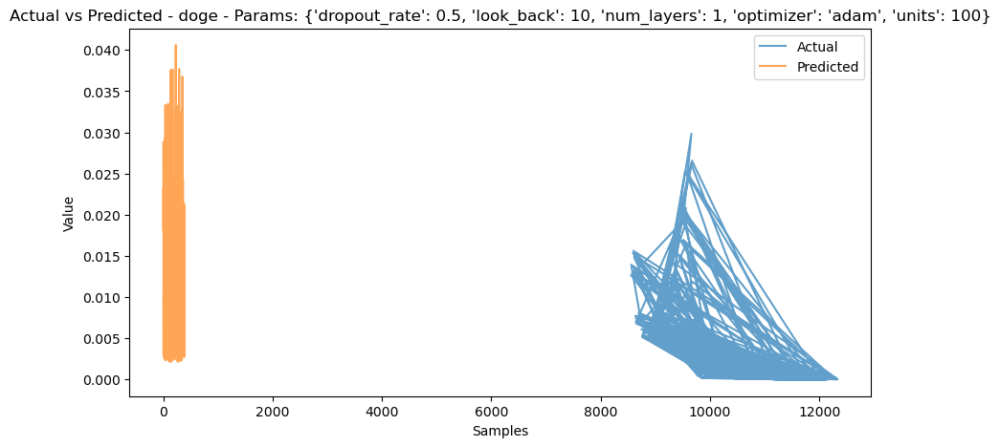

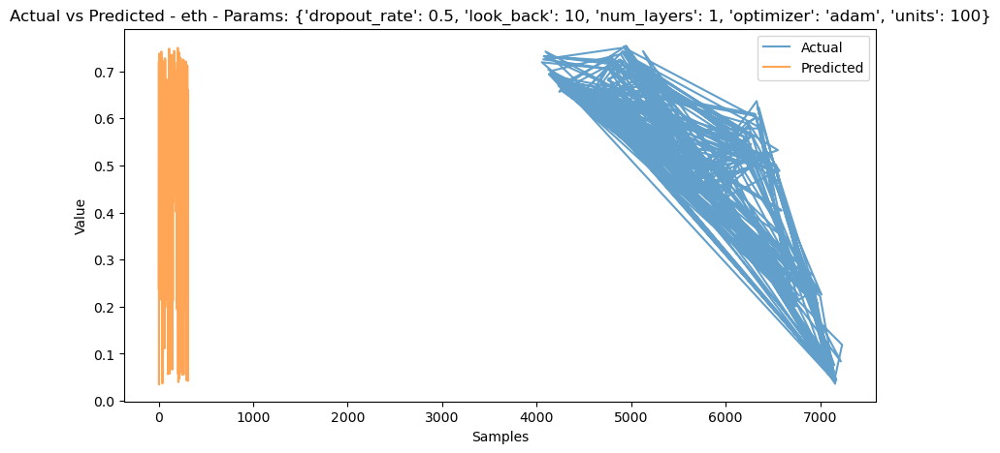

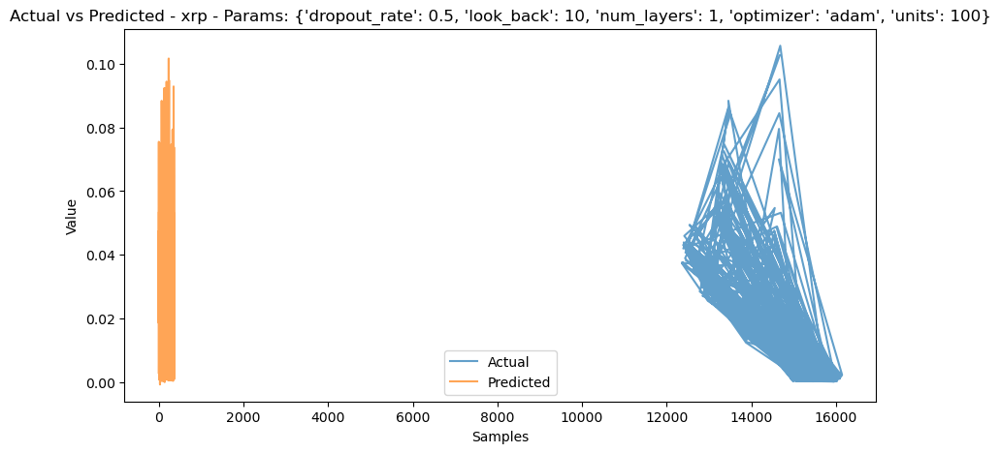

Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


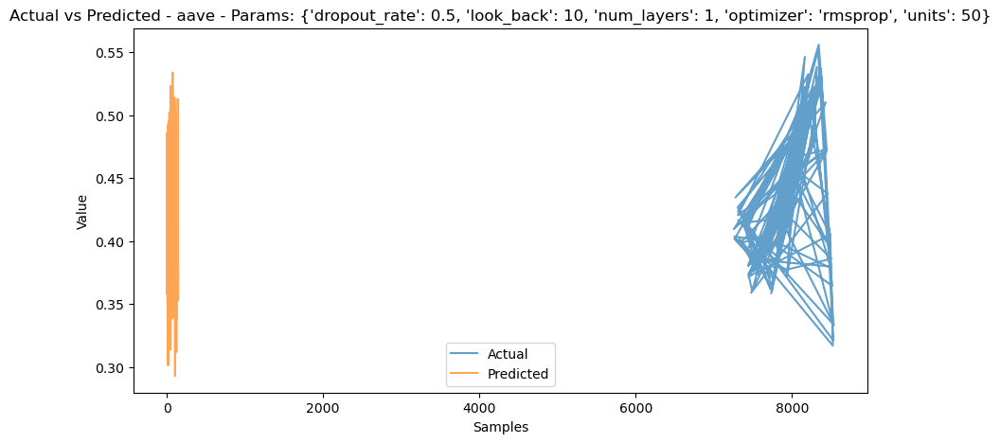

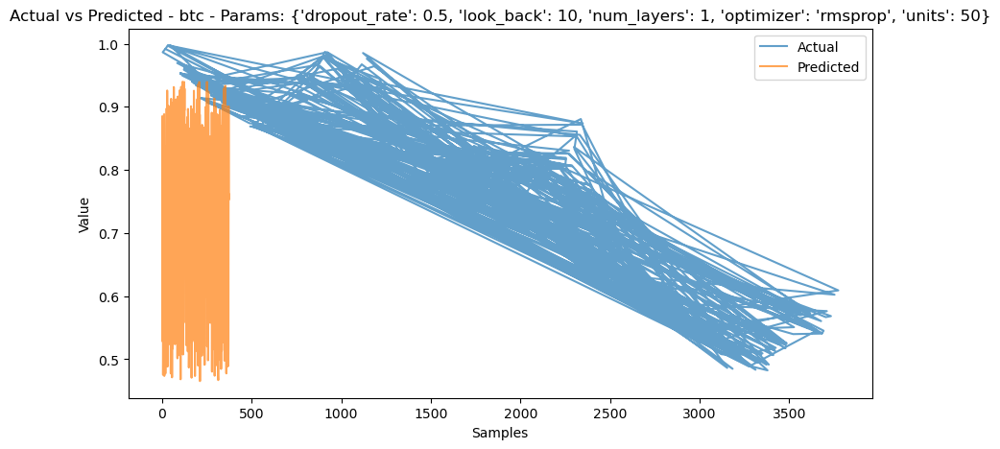

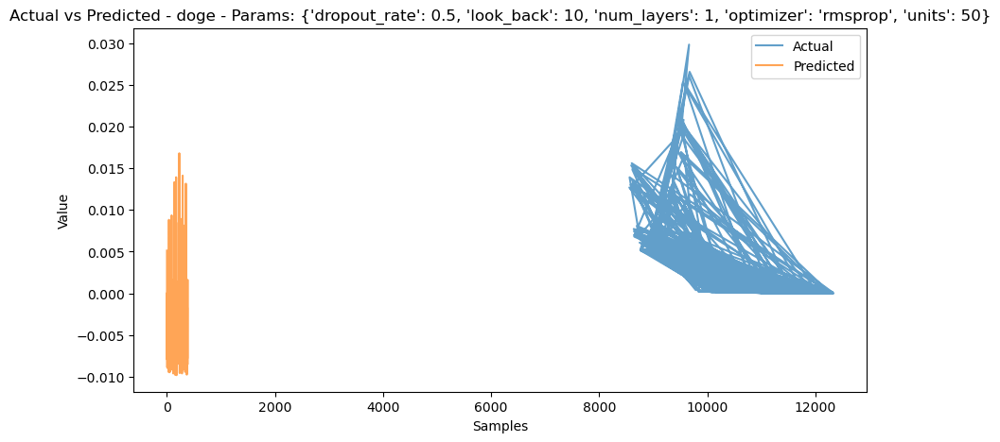

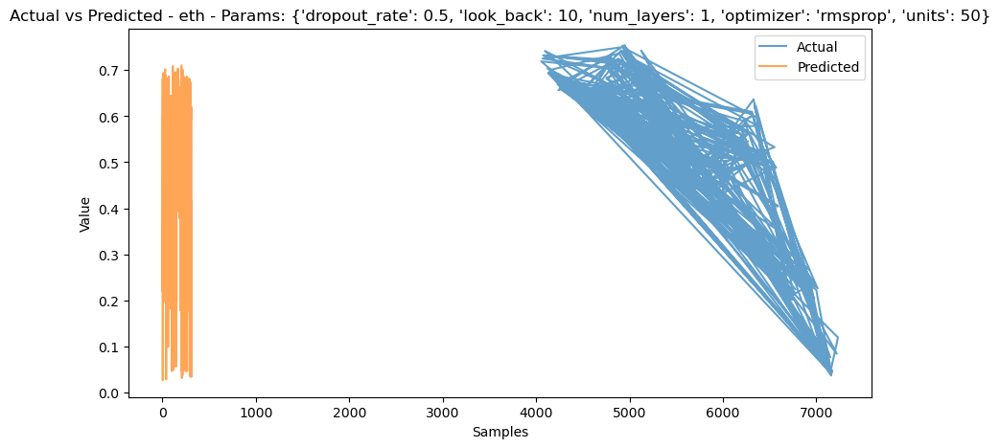

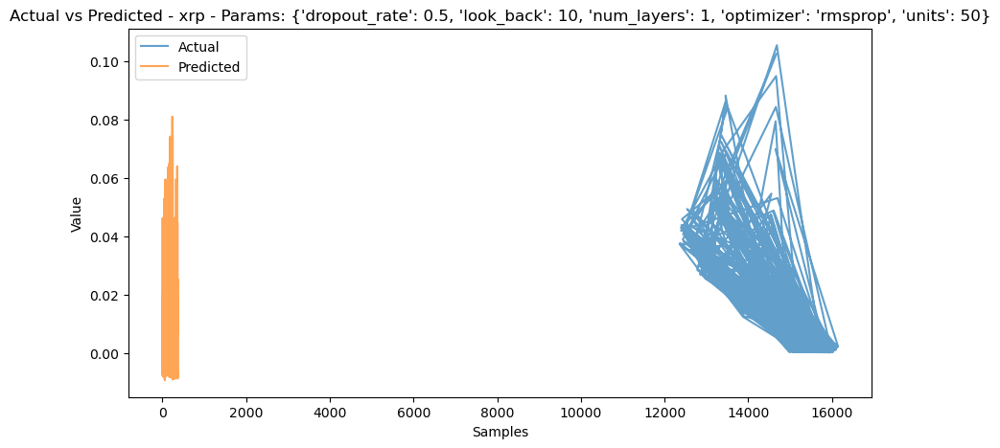

Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


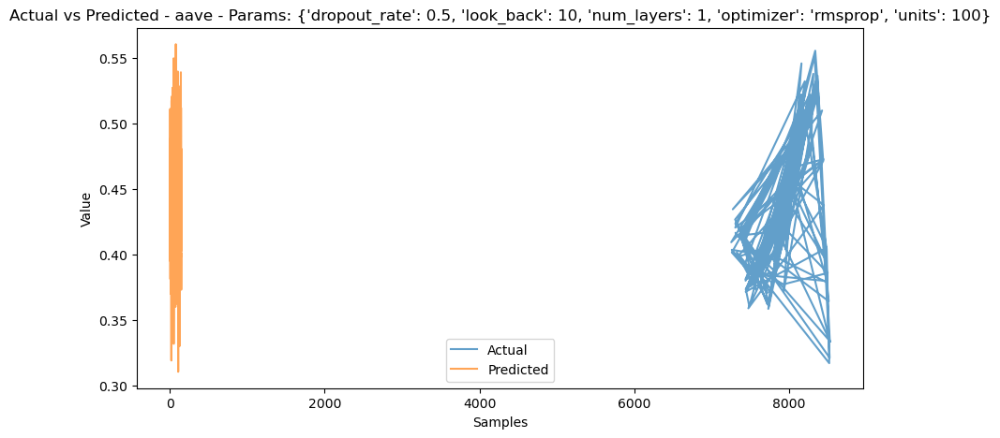

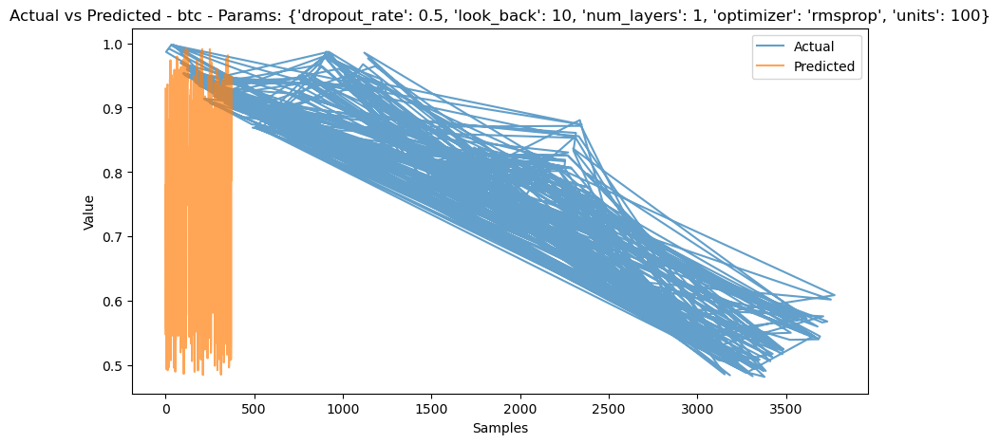

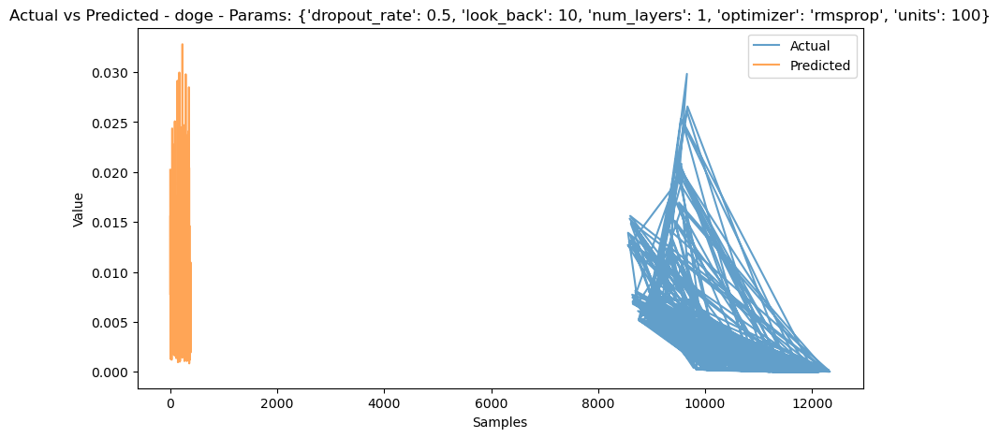

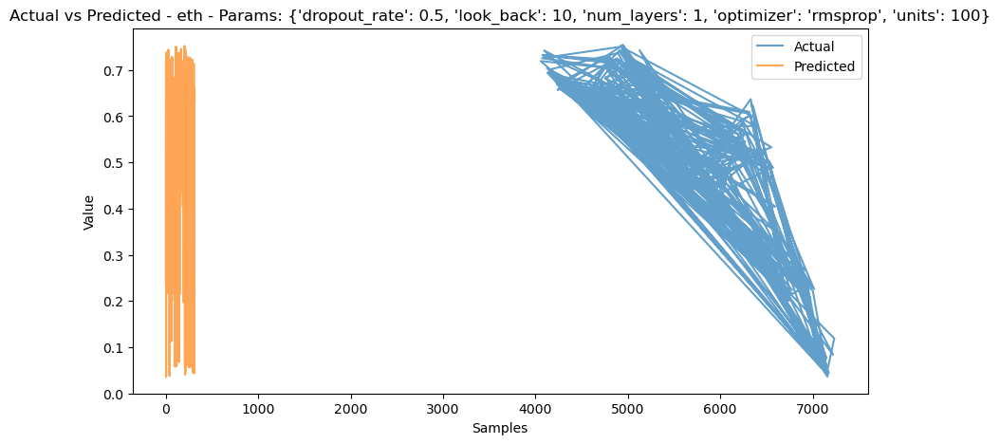

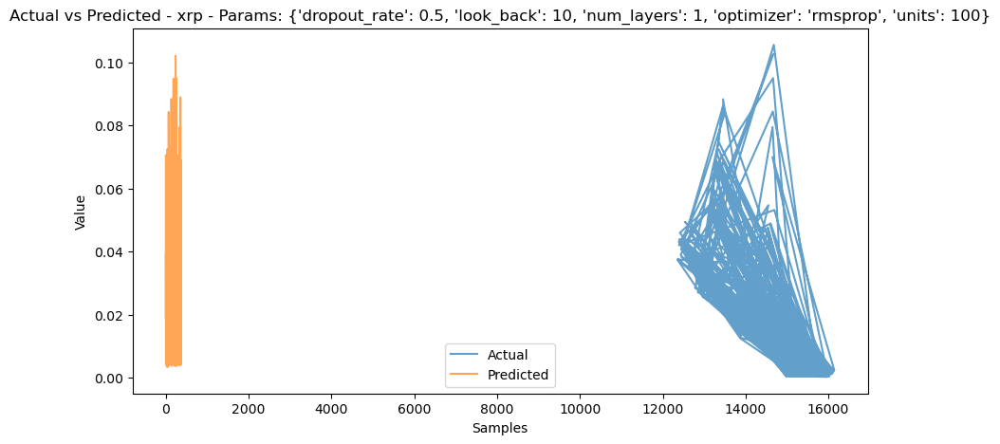

Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 1, 'optimizer': 'sgd', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


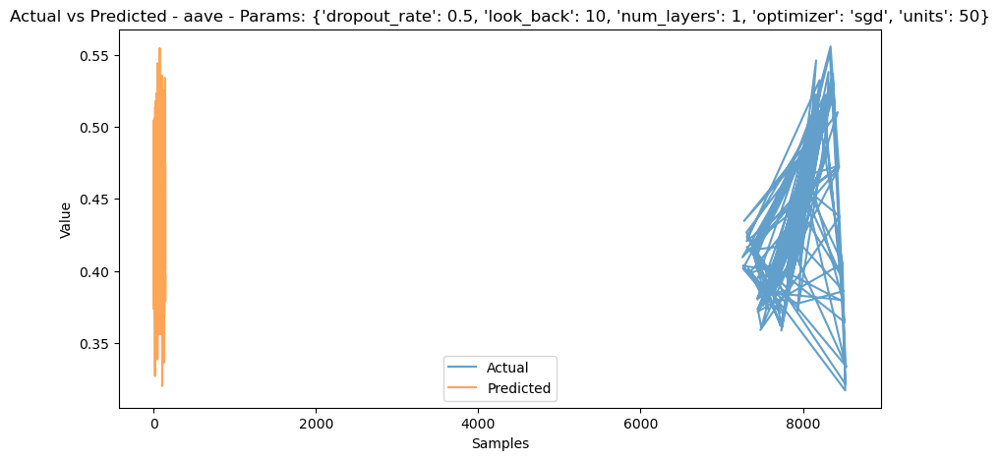

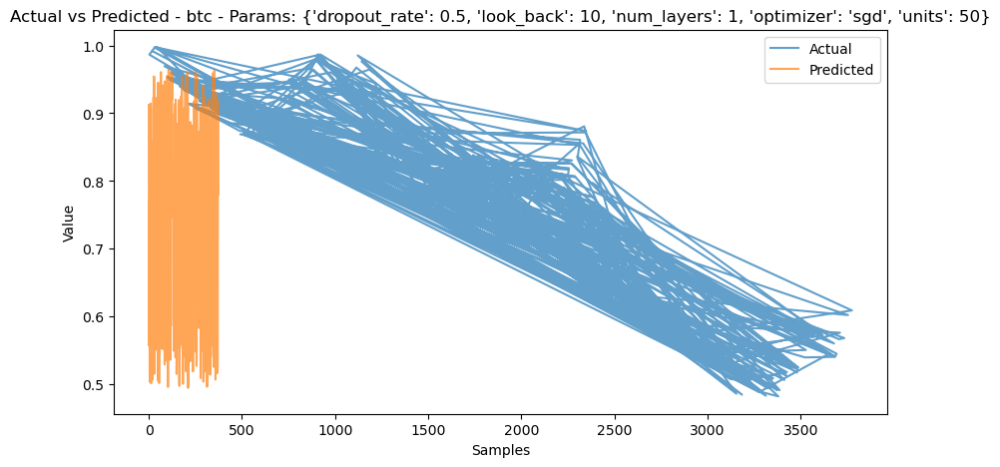

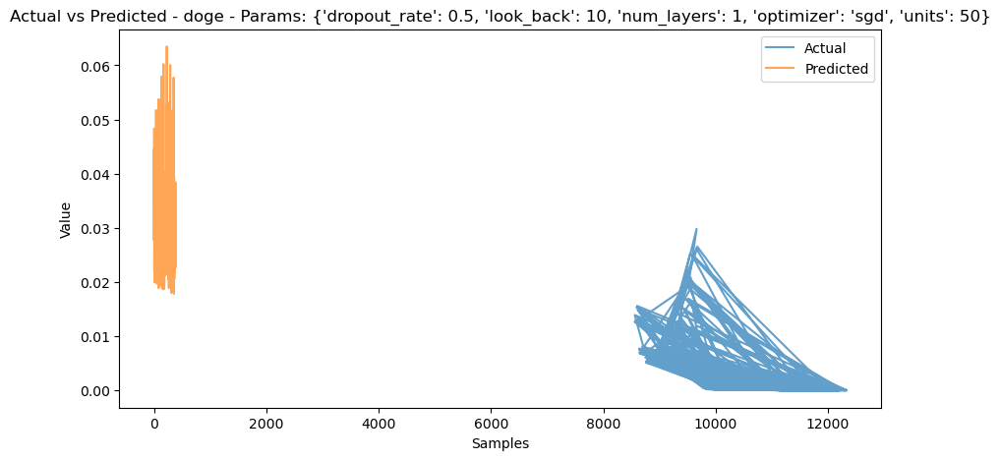

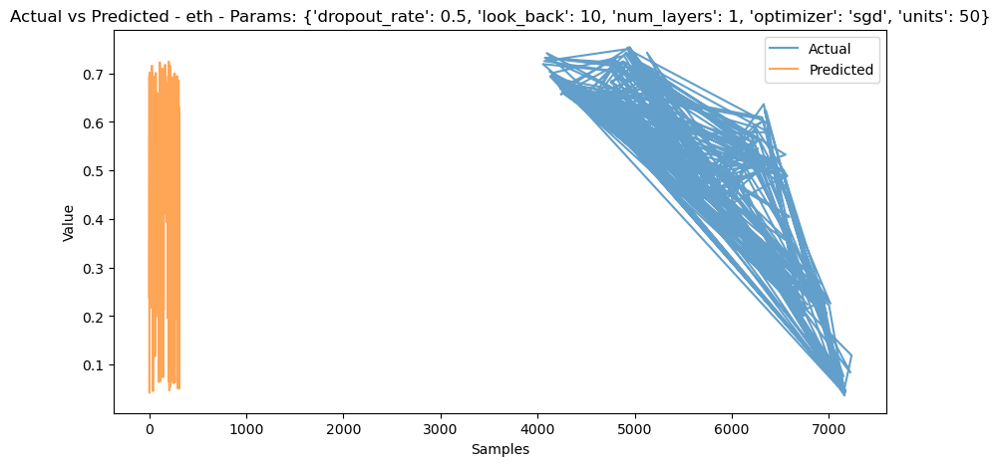

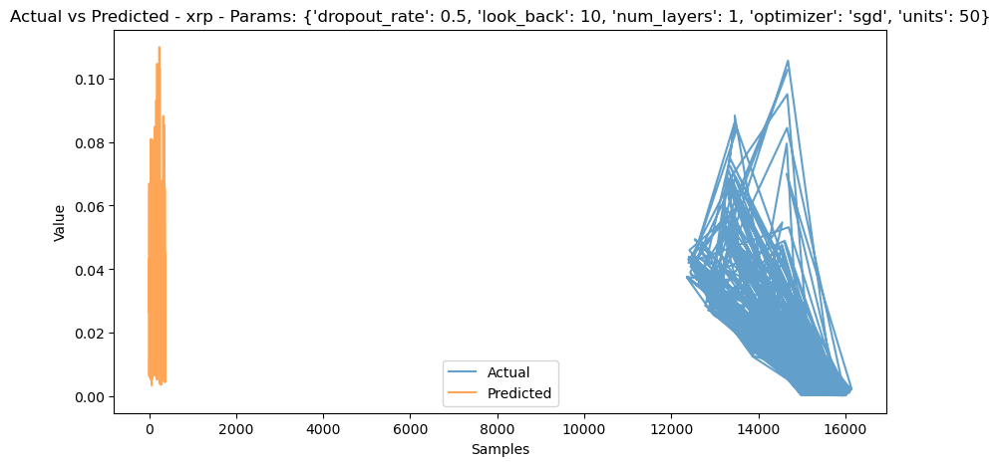

Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 1, 'optimizer': 'sgd', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


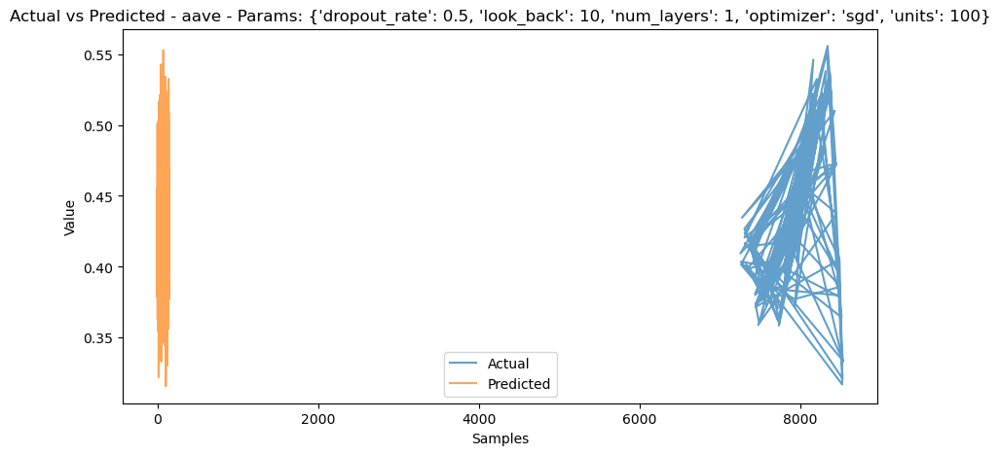

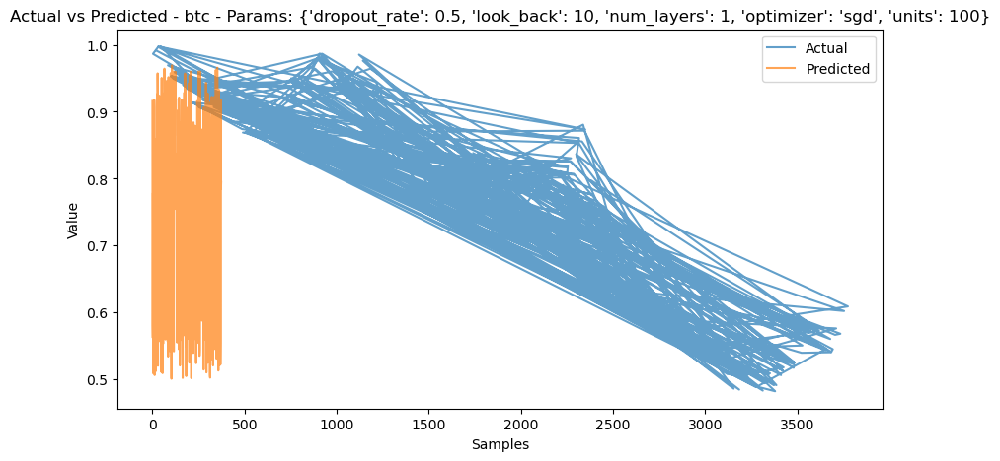

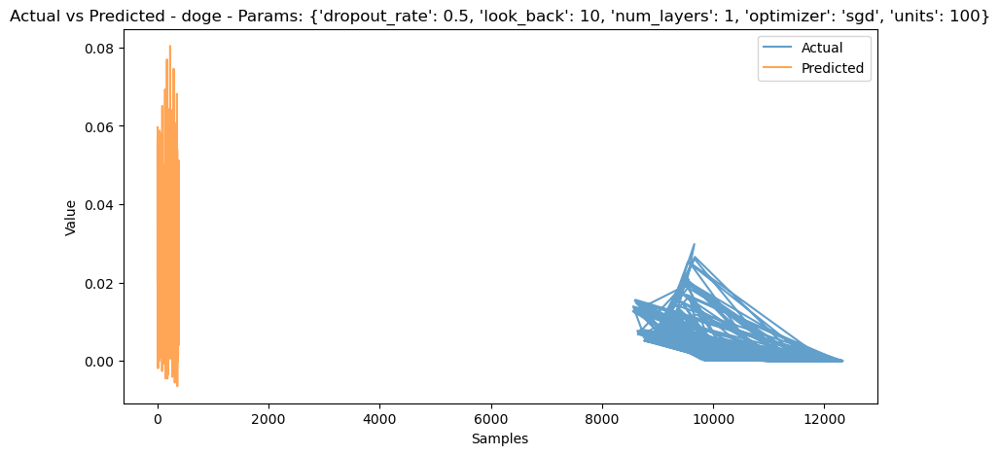

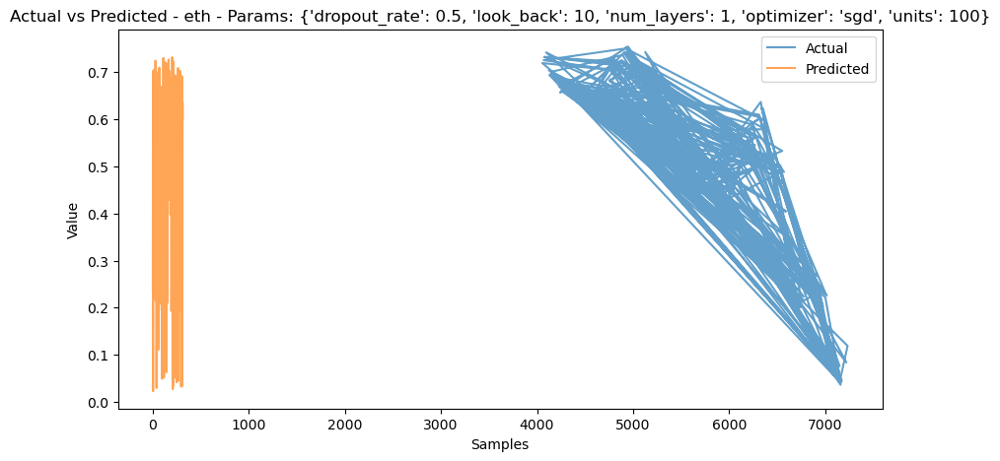

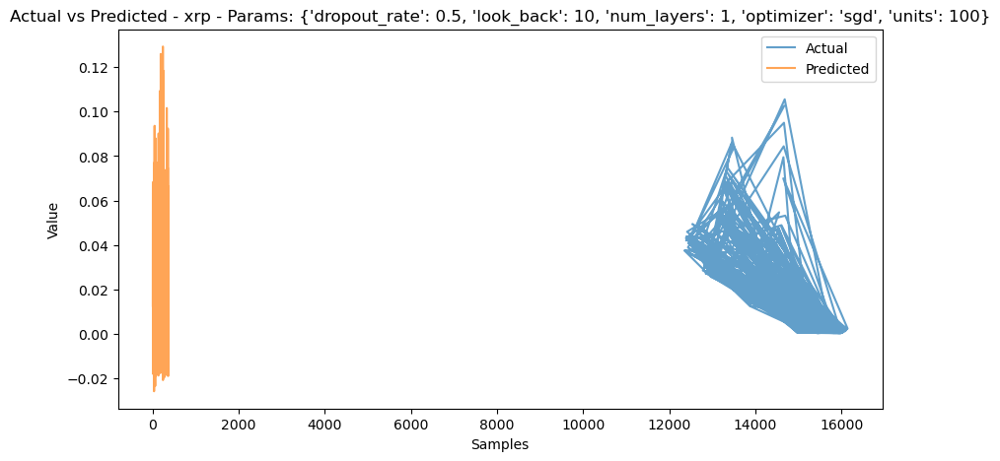

Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adagrad', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


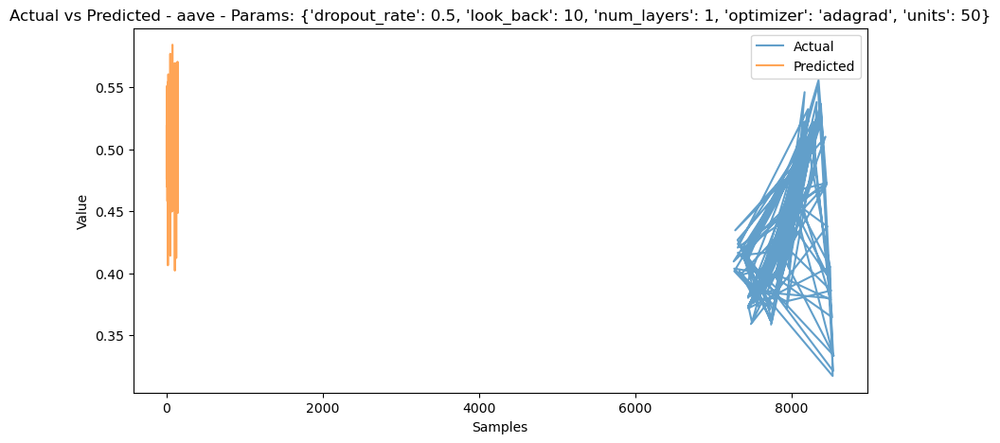

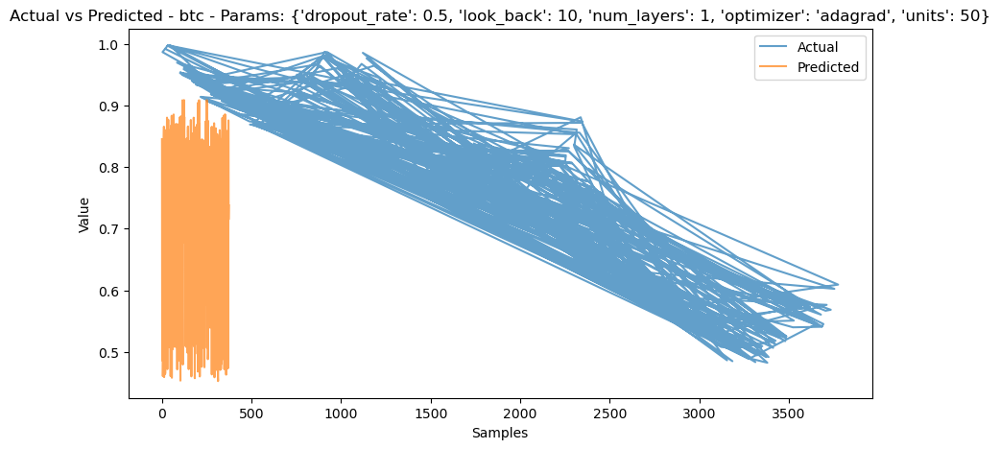

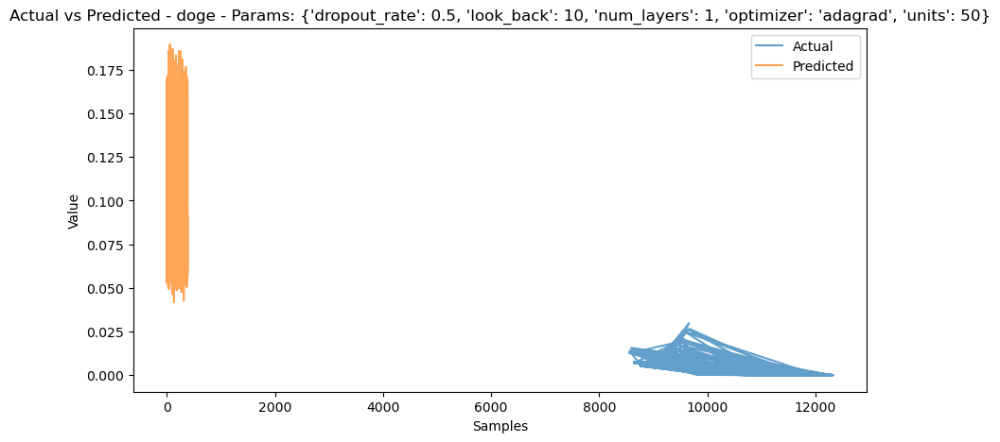

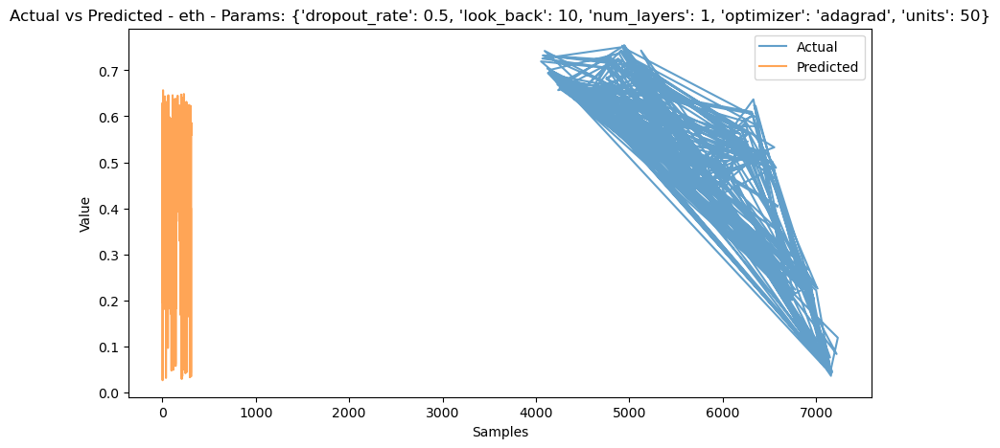

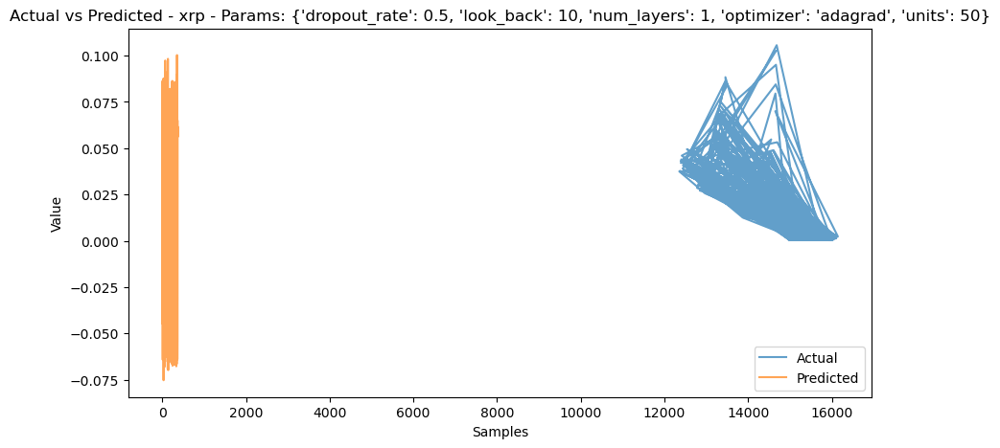

Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adagrad', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


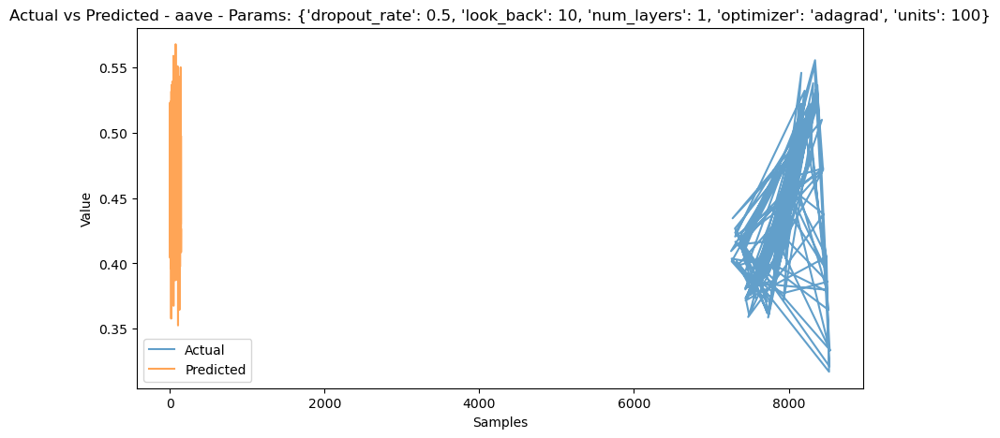

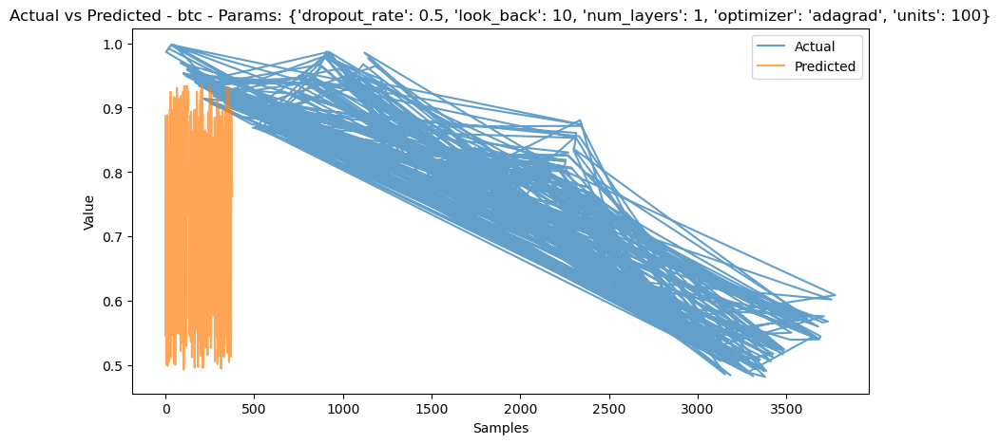

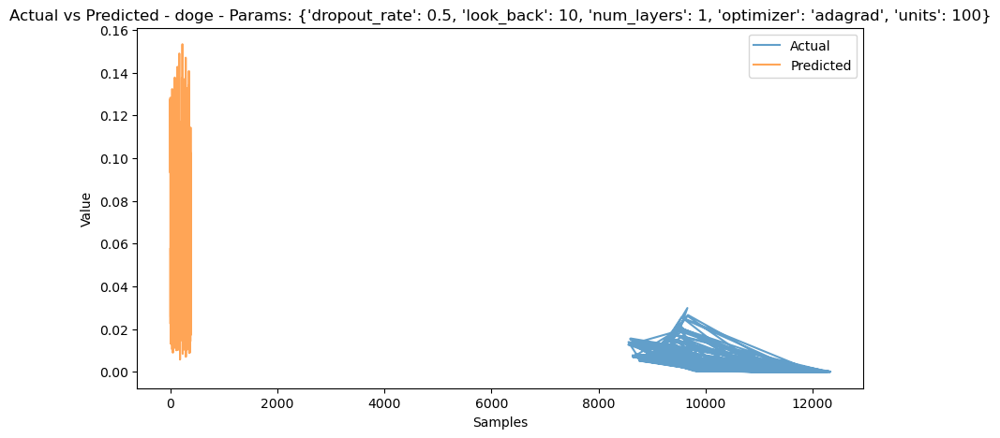

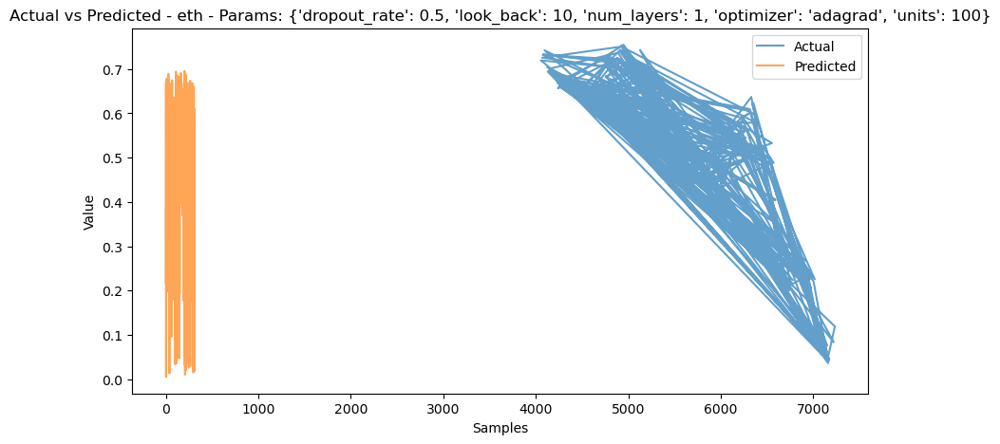

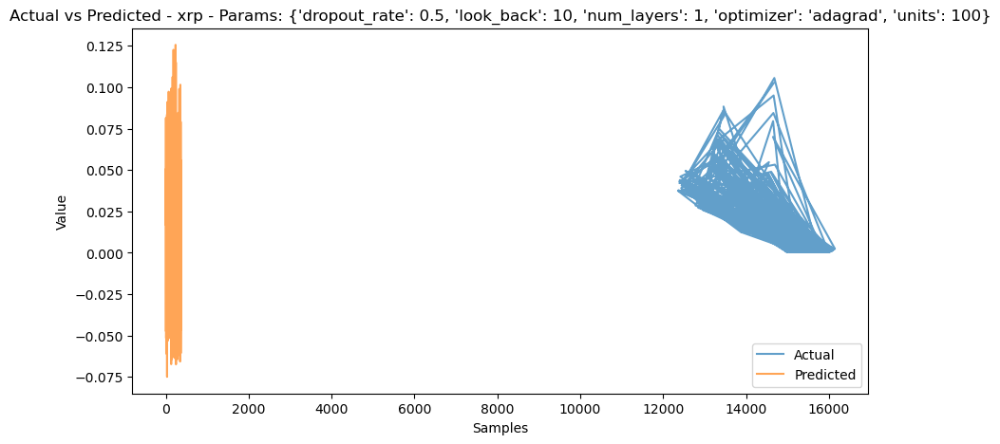

Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 2, 'optimizer': 'adam', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


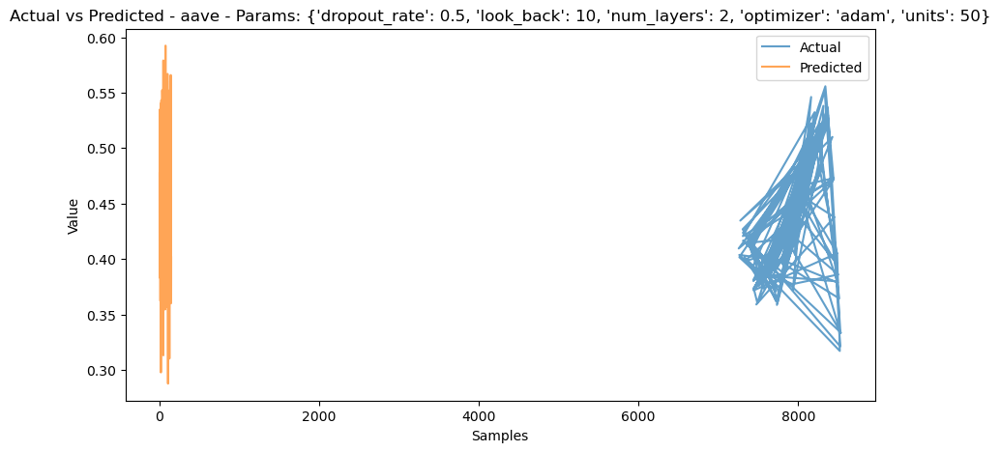

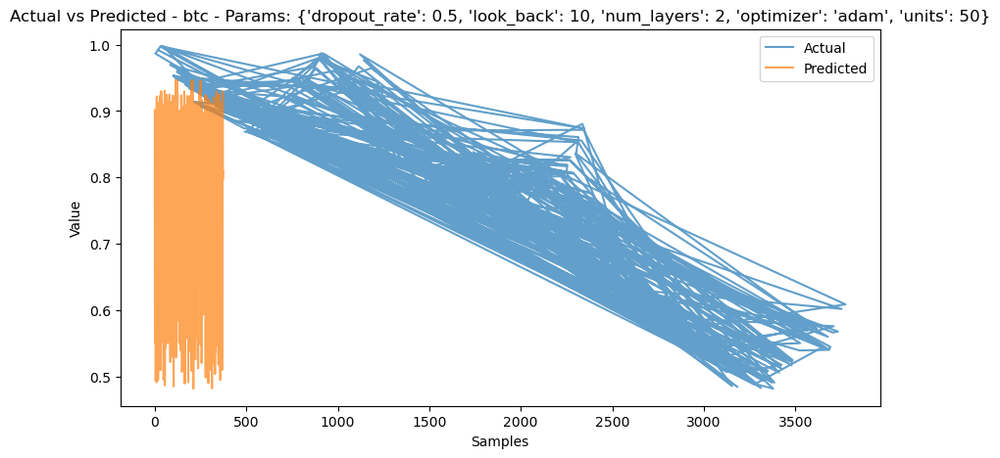

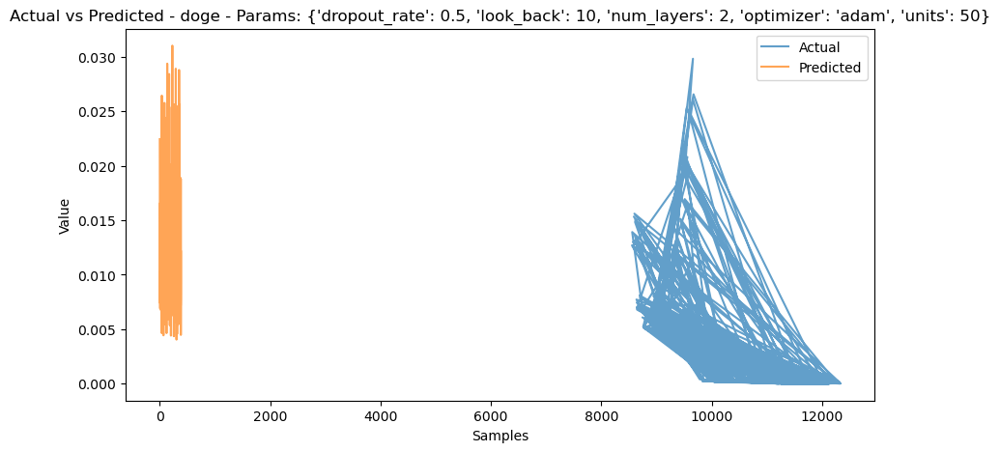

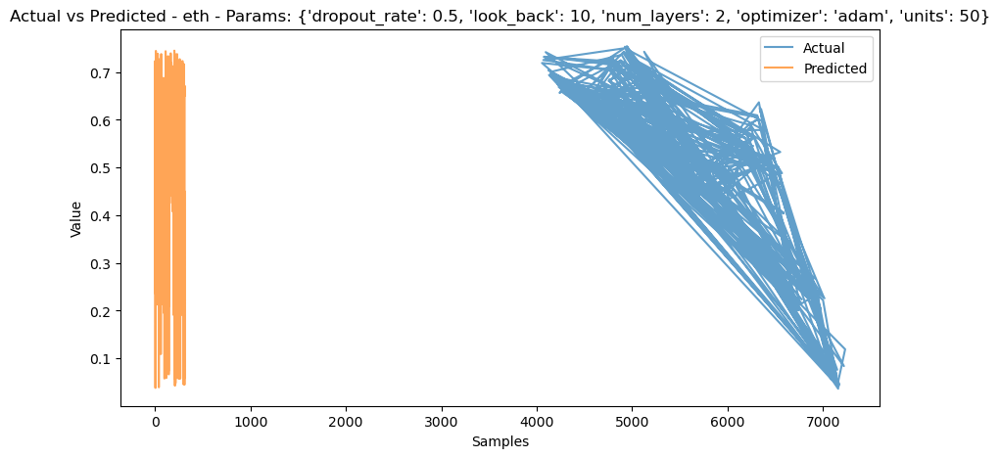

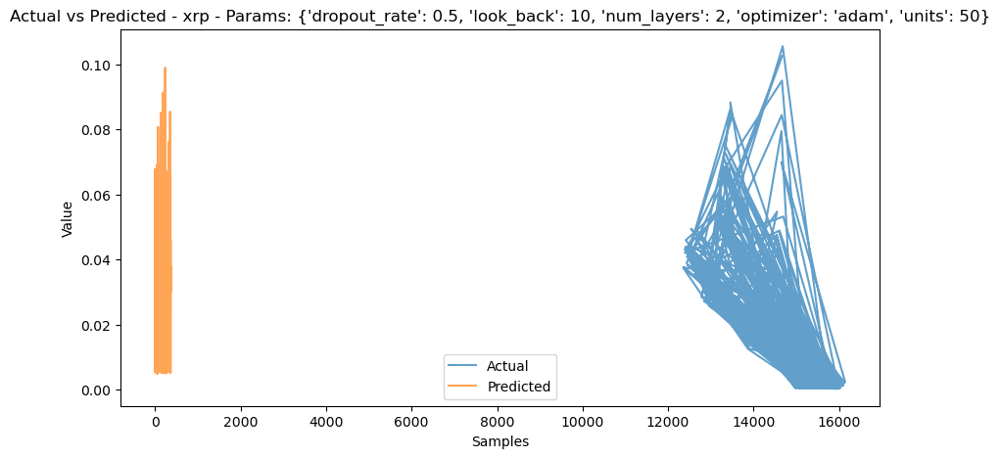

Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 2, 'optimizer': 'adam', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


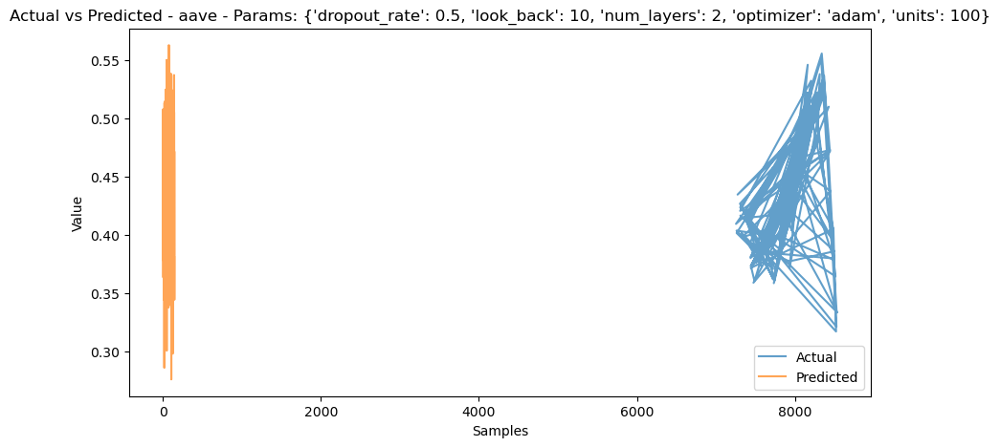

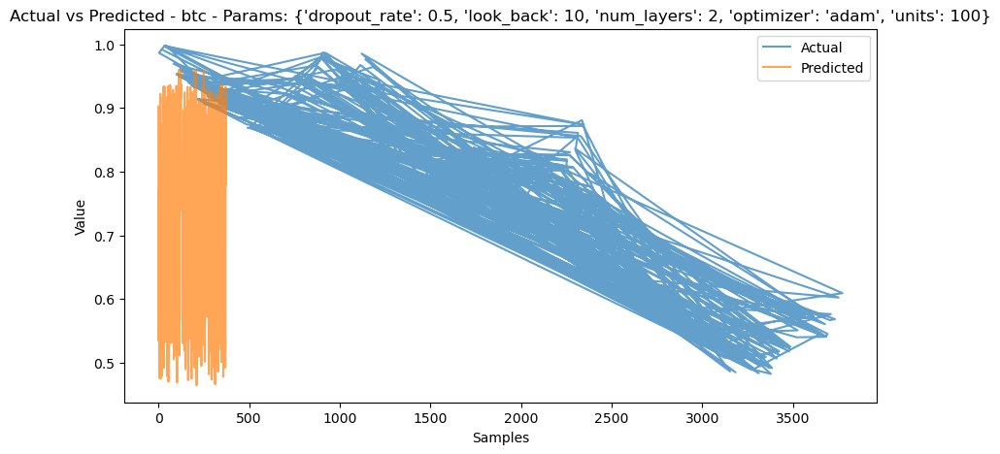

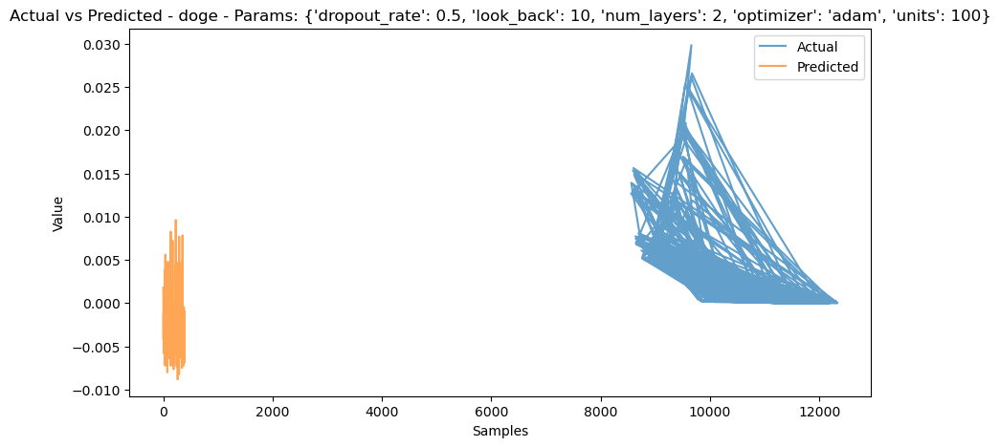

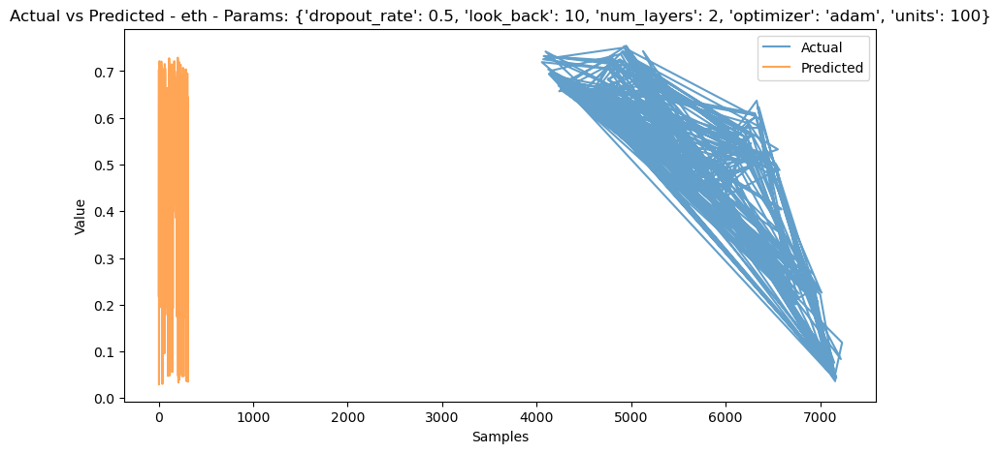

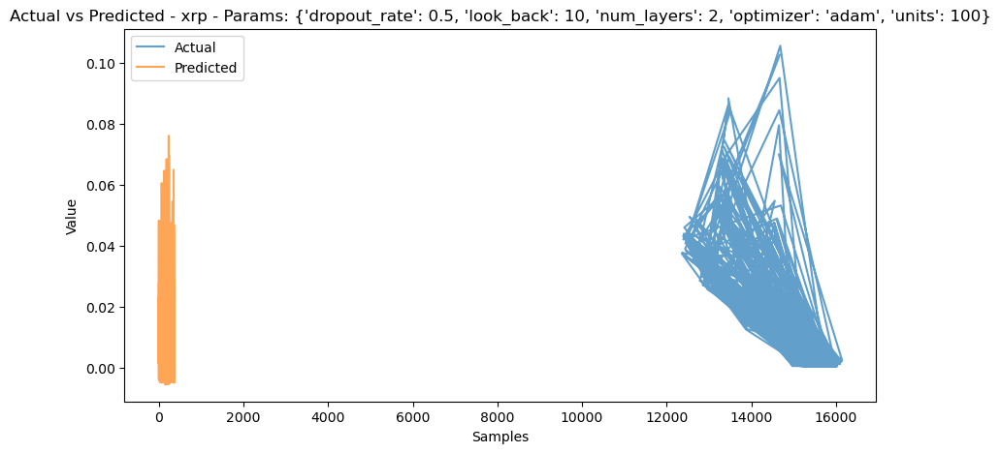

Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 2, 'optimizer': 'rmsprop', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


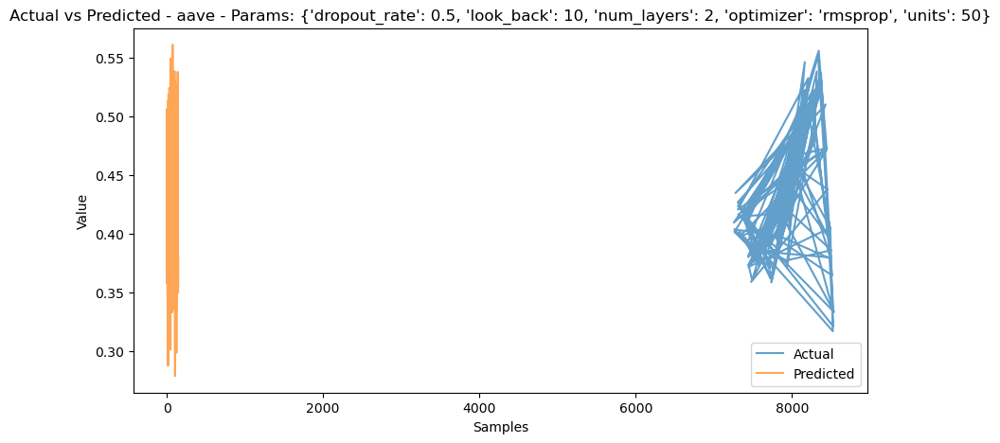

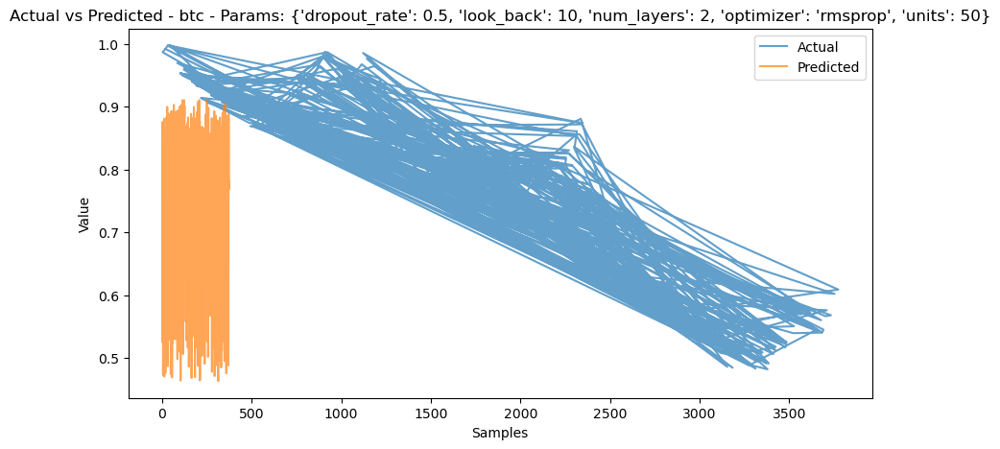

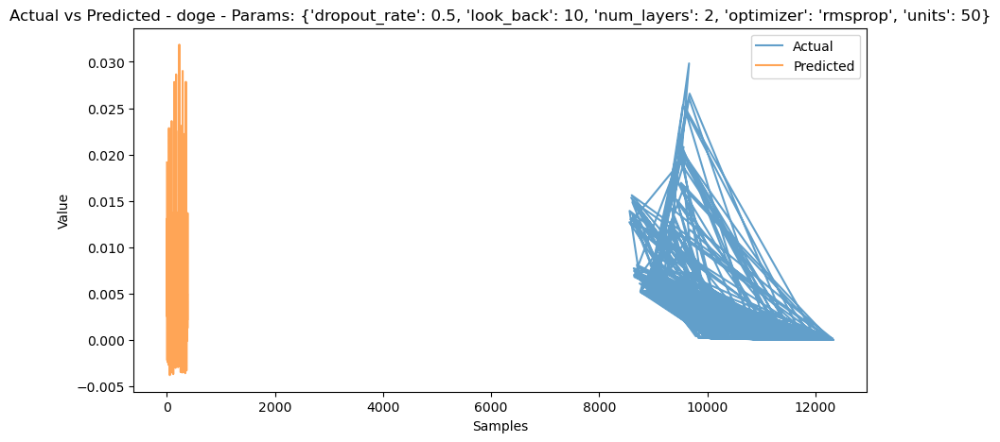

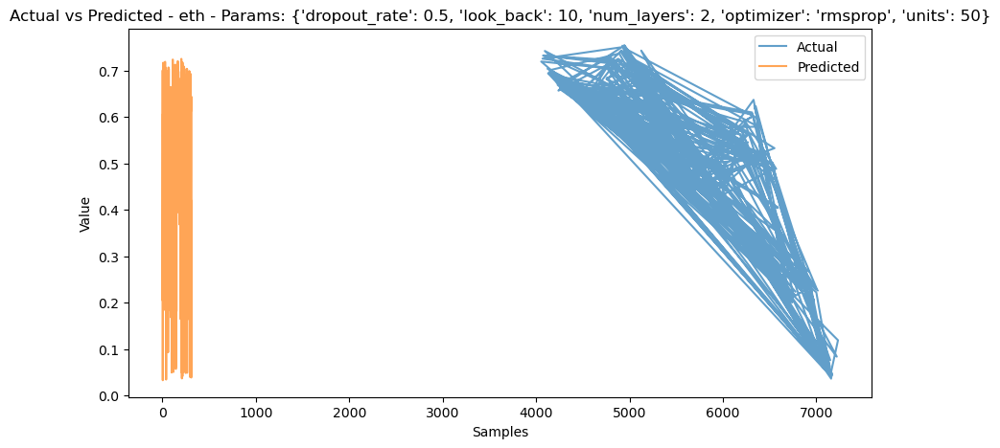

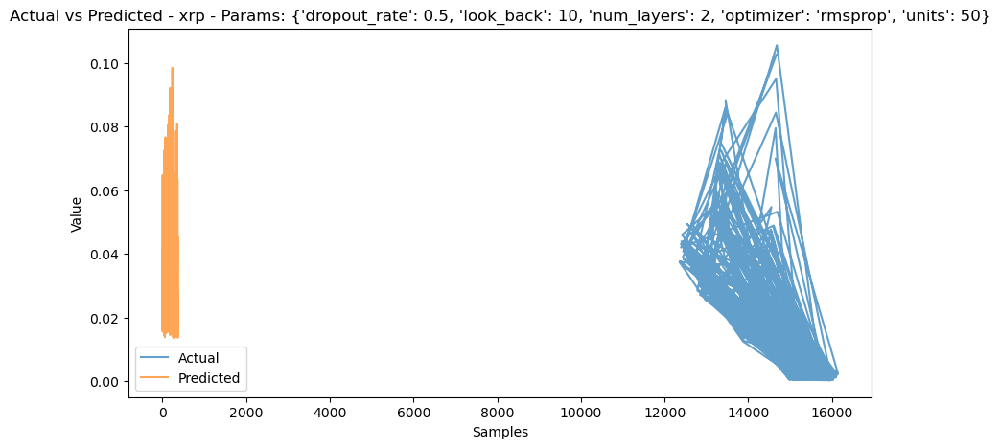

Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 2, 'optimizer': 'rmsprop', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


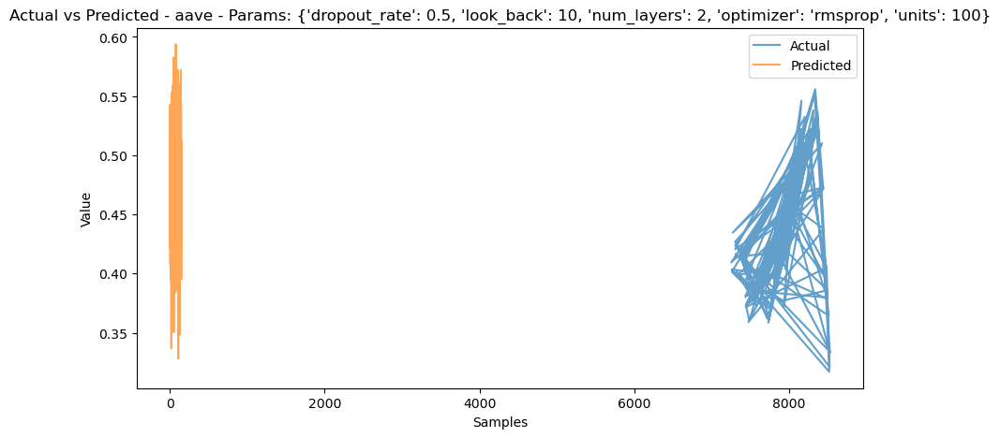

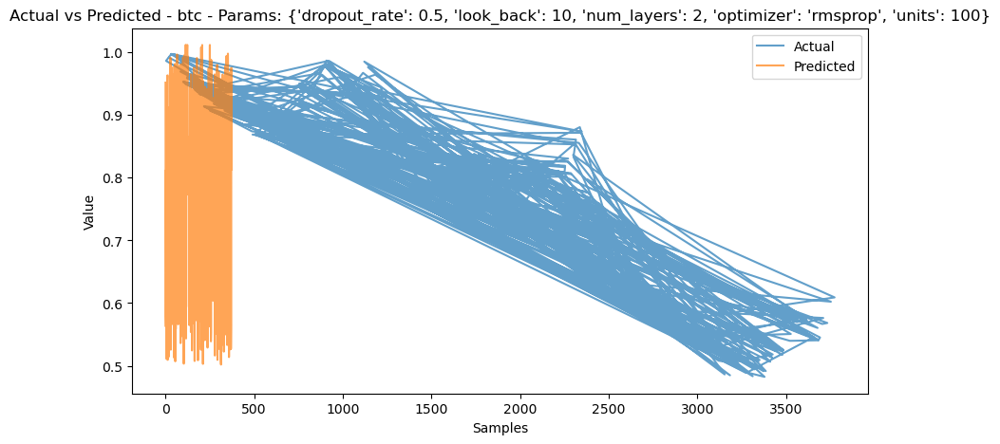

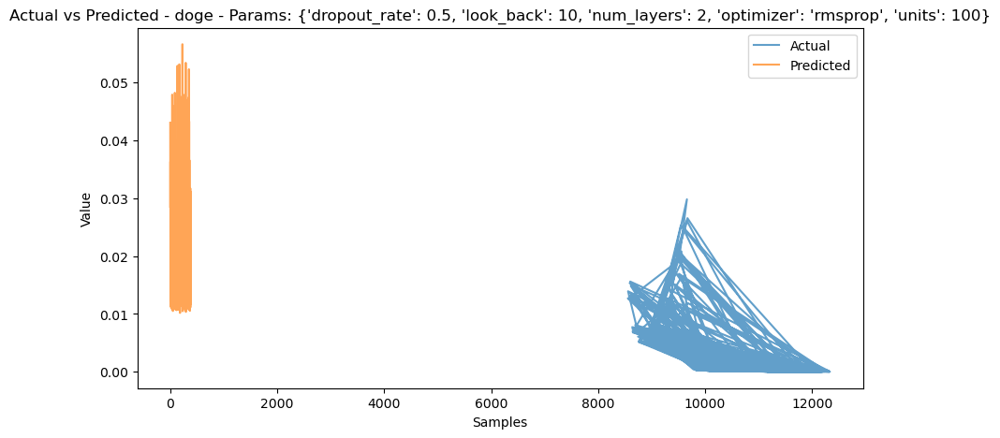

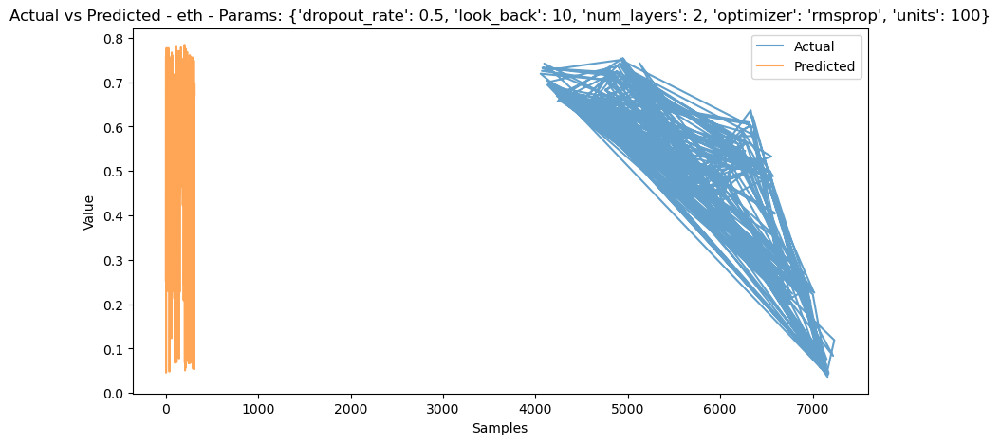

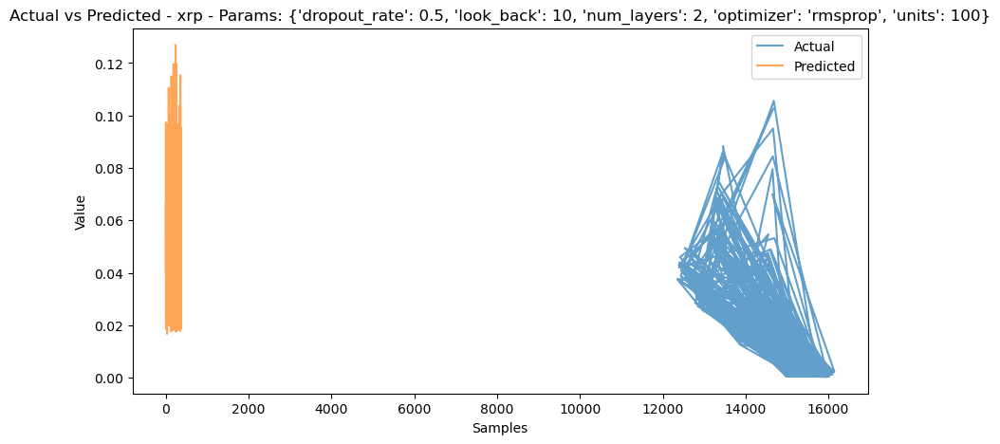

Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 2, 'optimizer': 'sgd', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


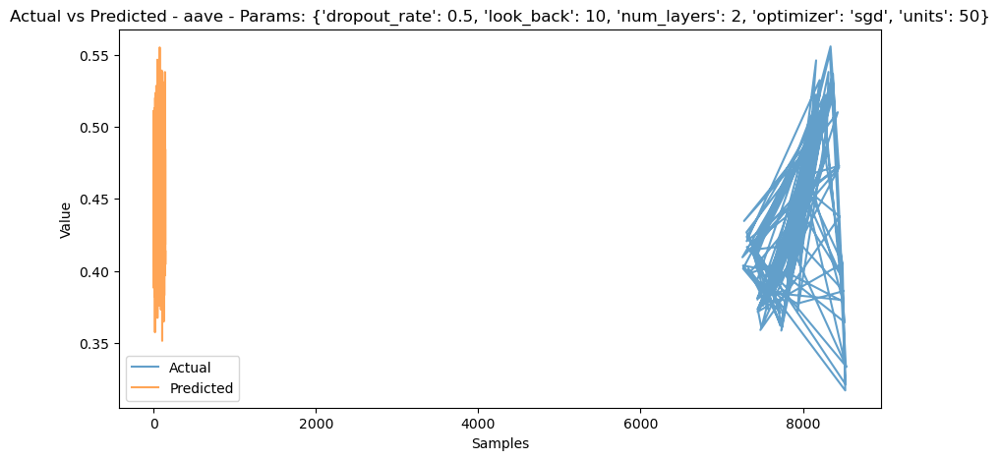

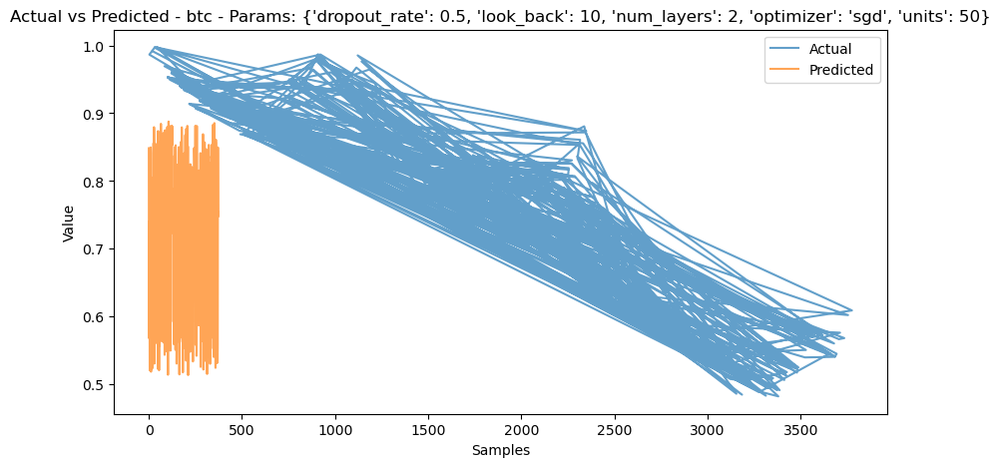

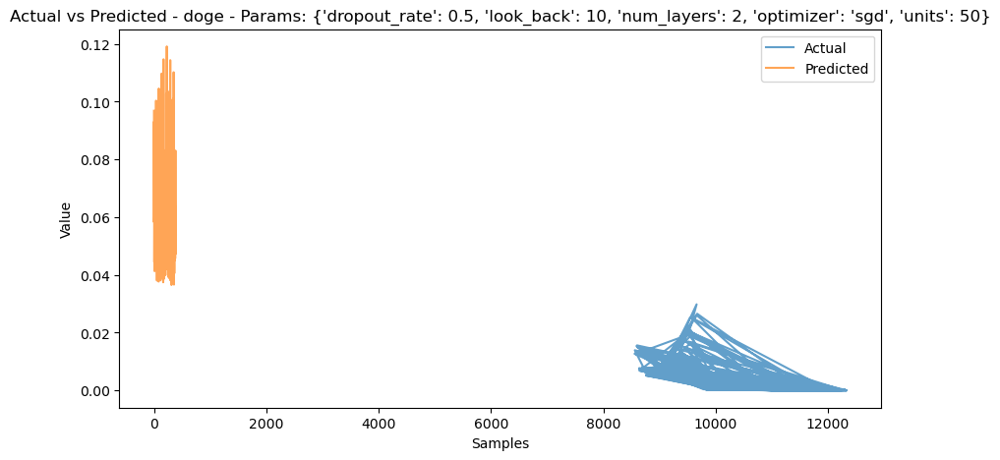

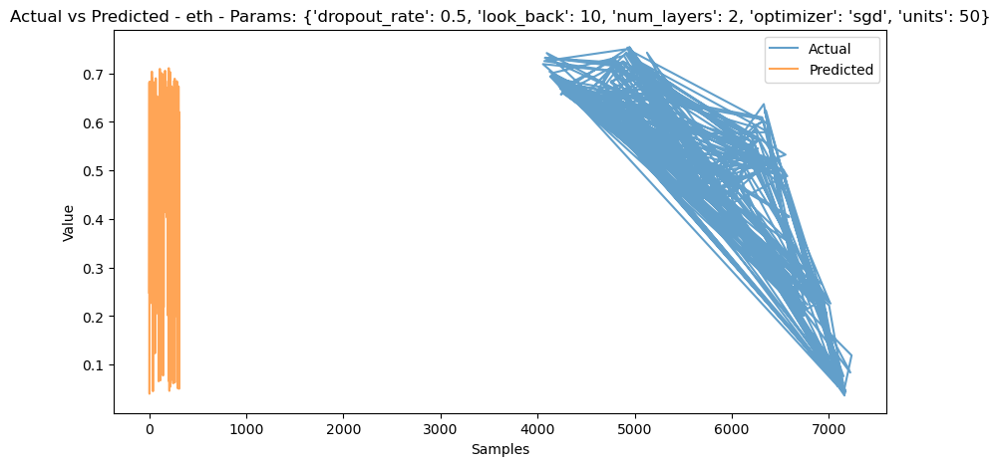

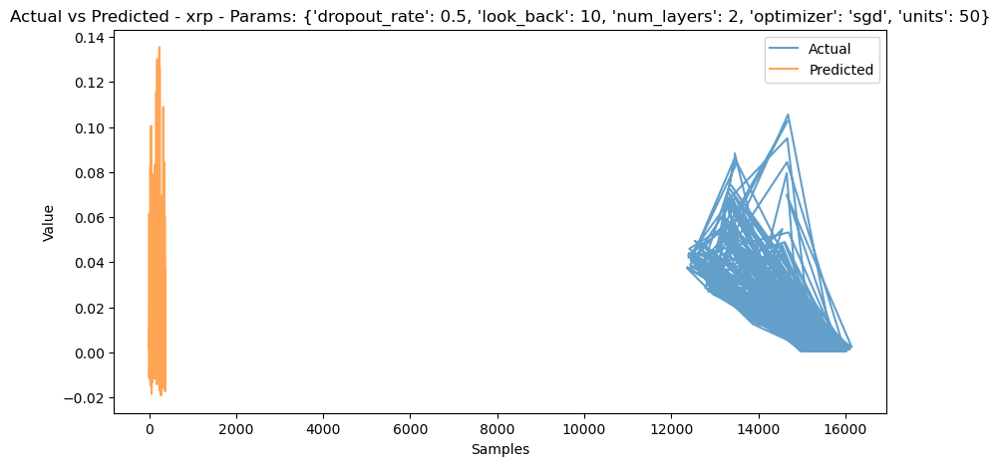

Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 2, 'optimizer': 'sgd', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


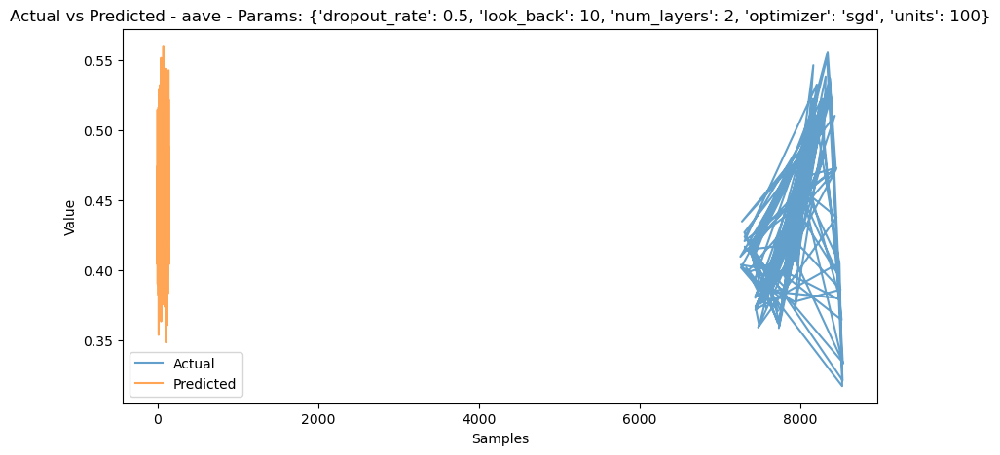

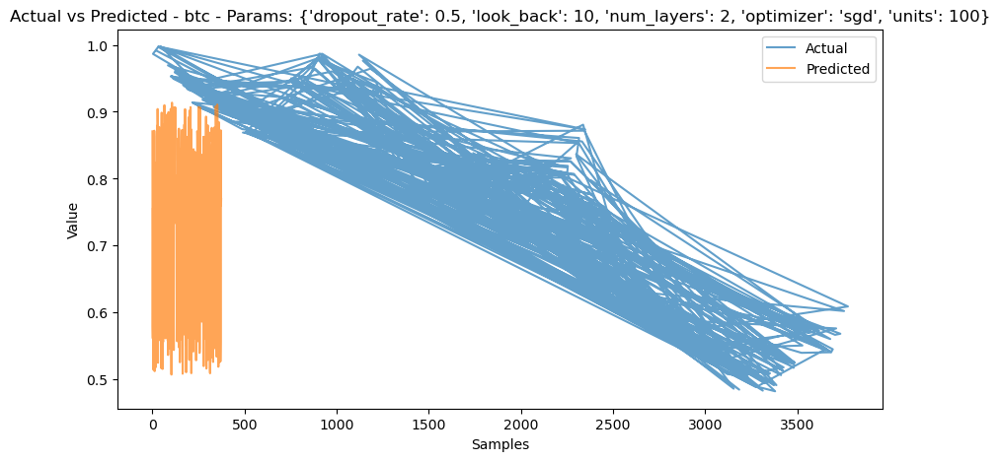

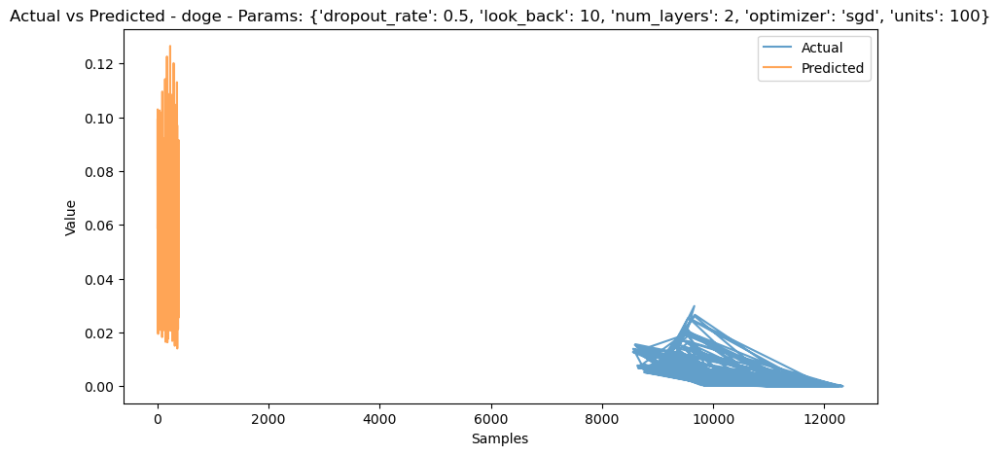

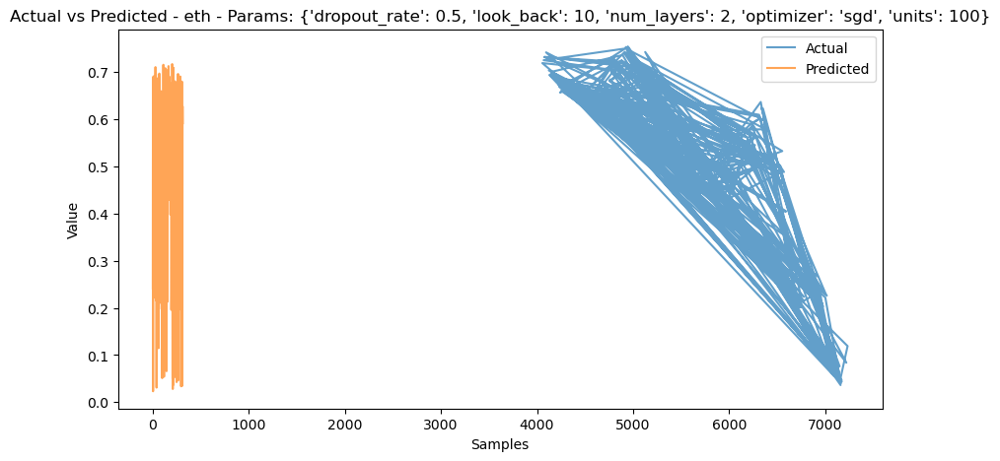

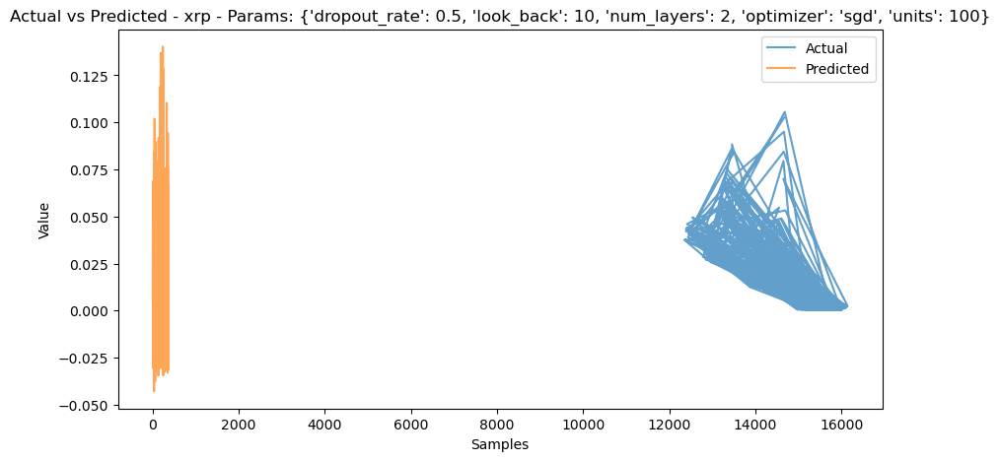

Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 2, 'optimizer': 'adagrad', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


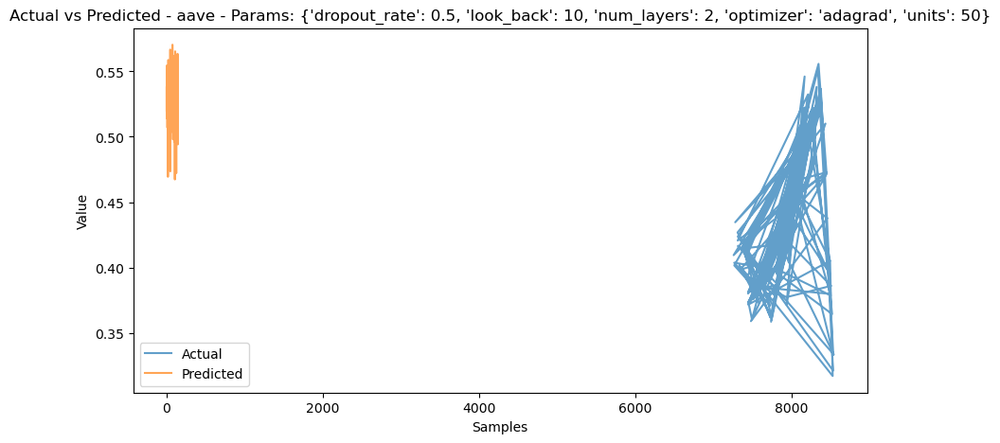

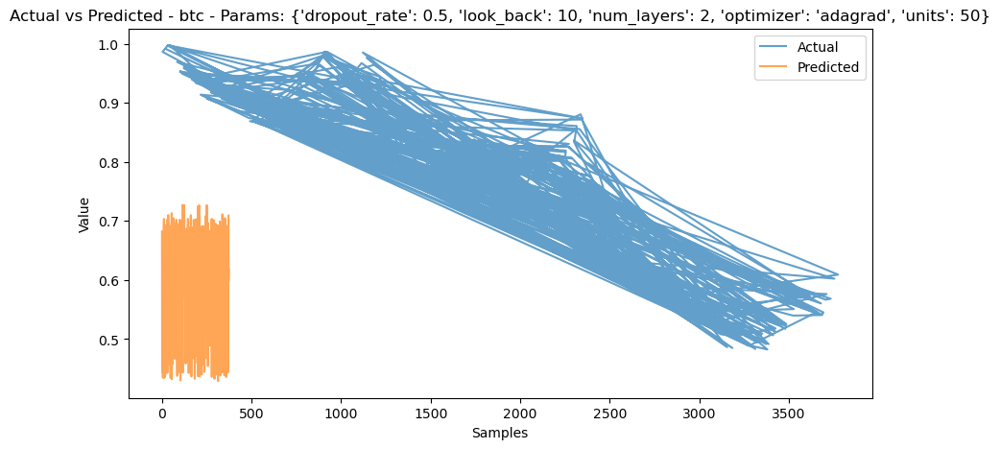

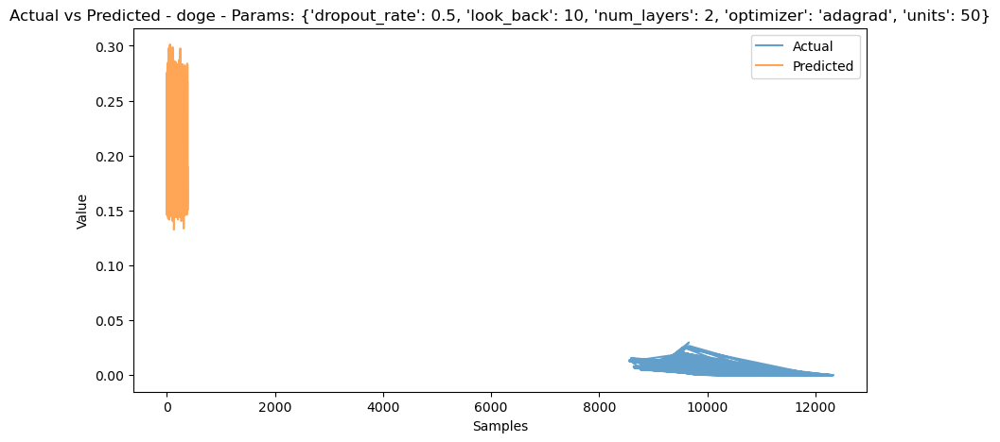

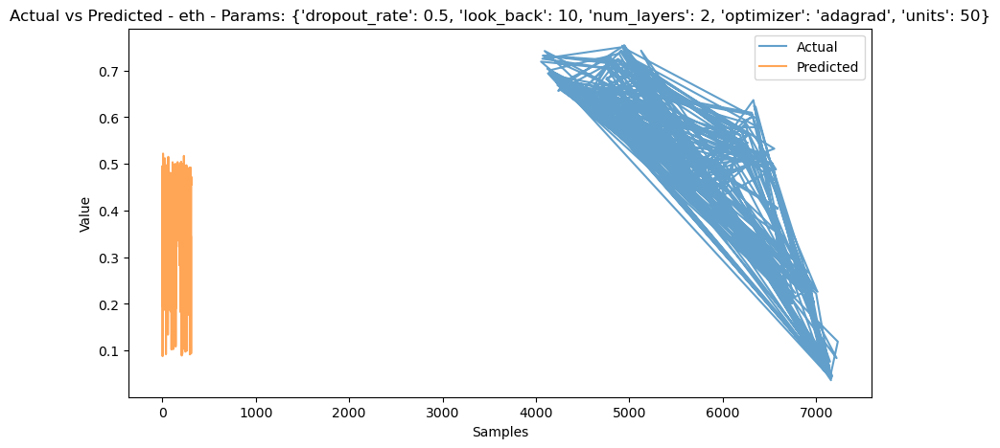

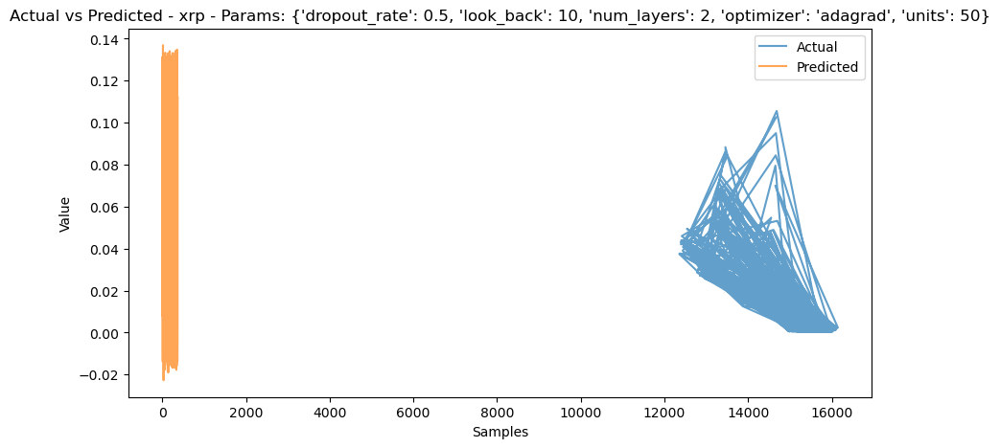

Testing parameters: {'dropout_rate': 0.5, 'look_back': 10, 'num_layers': 2, 'optimizer': 'adagrad', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


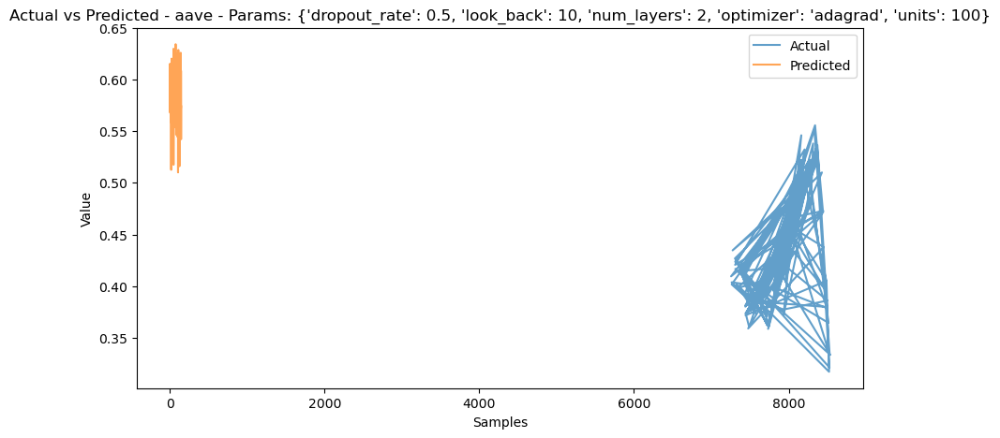

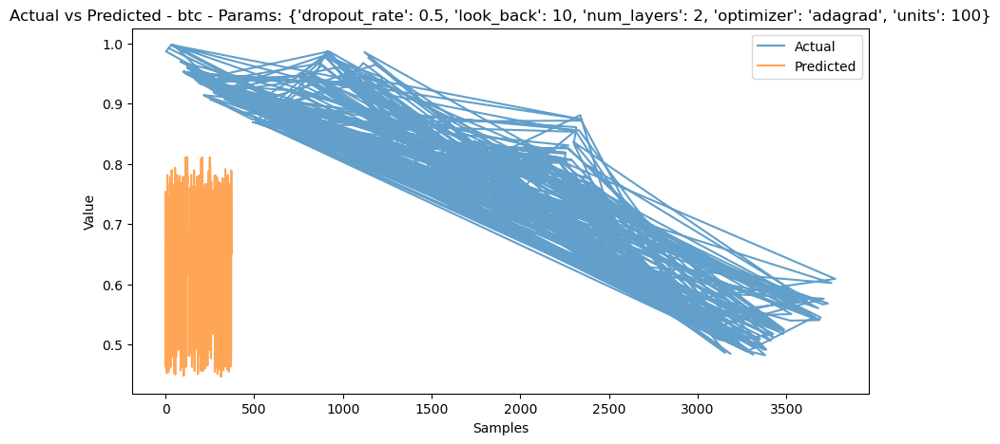

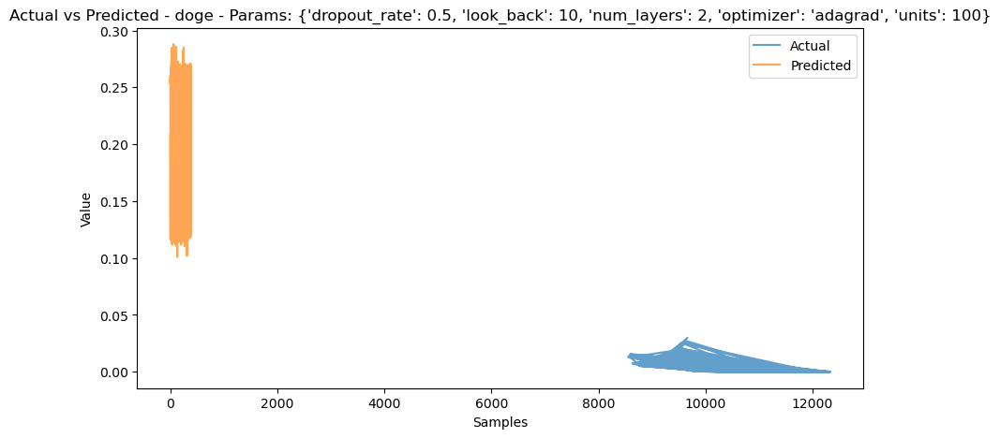

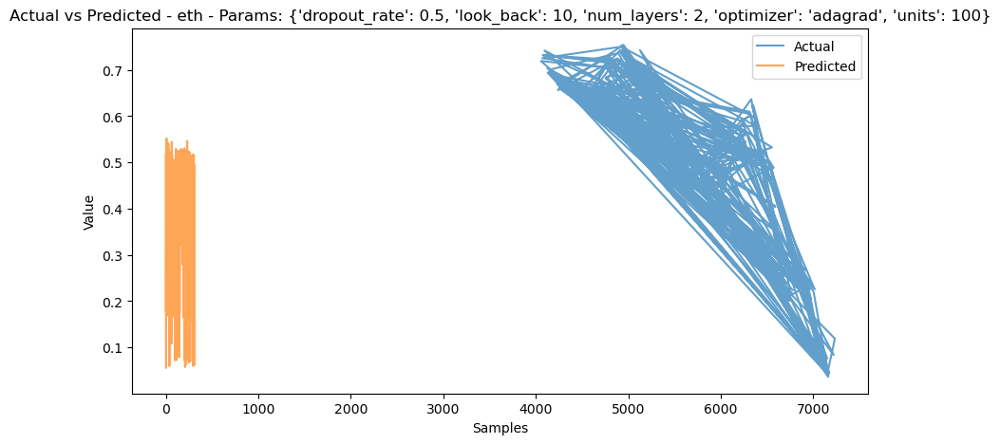

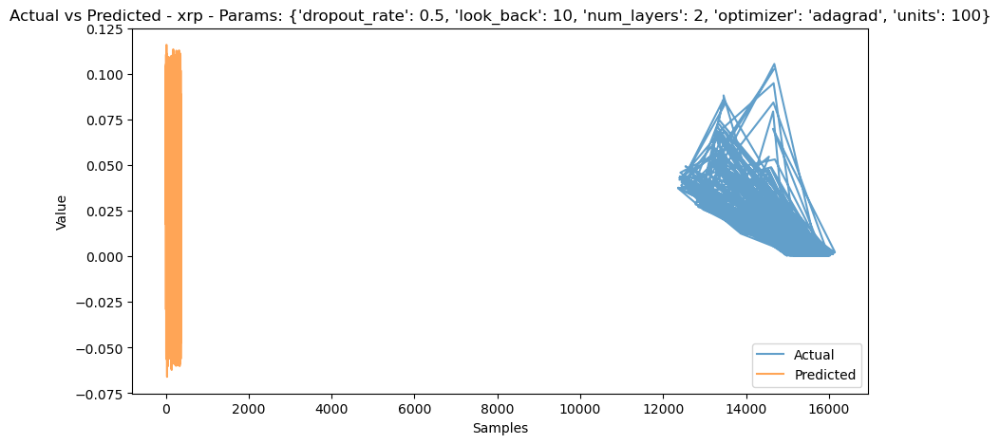

Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


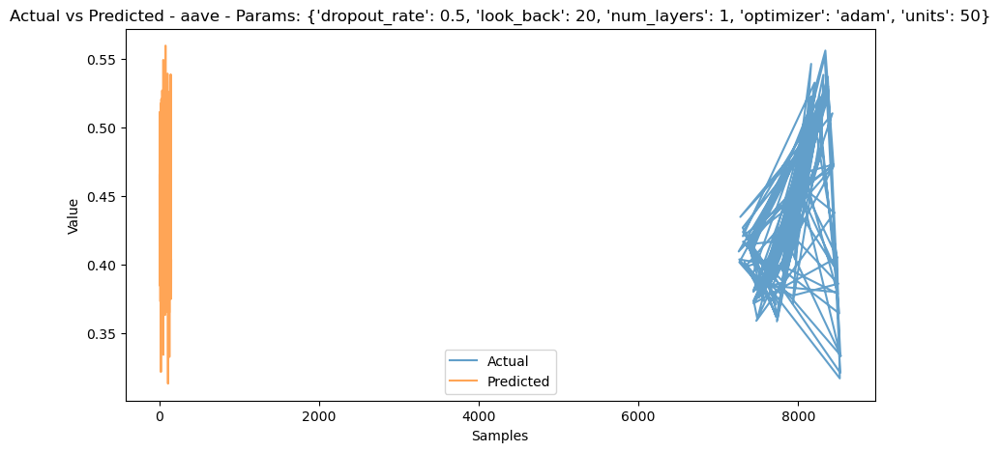

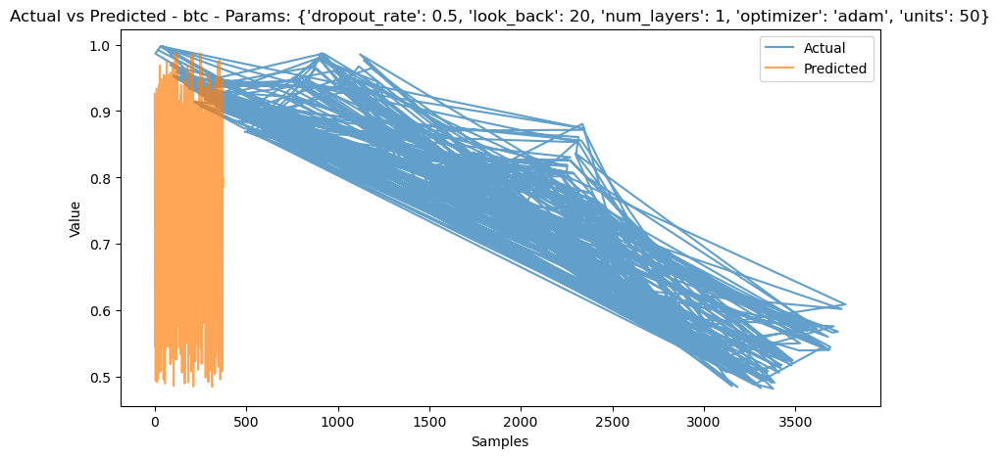

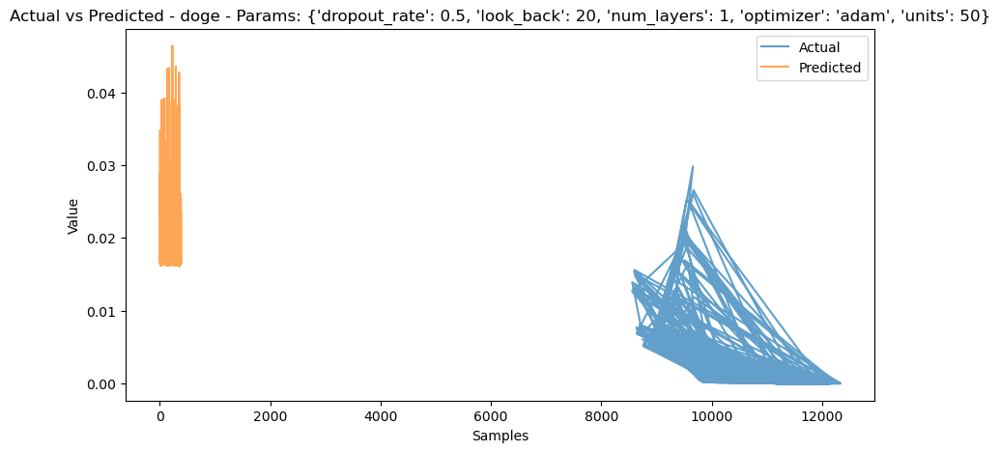

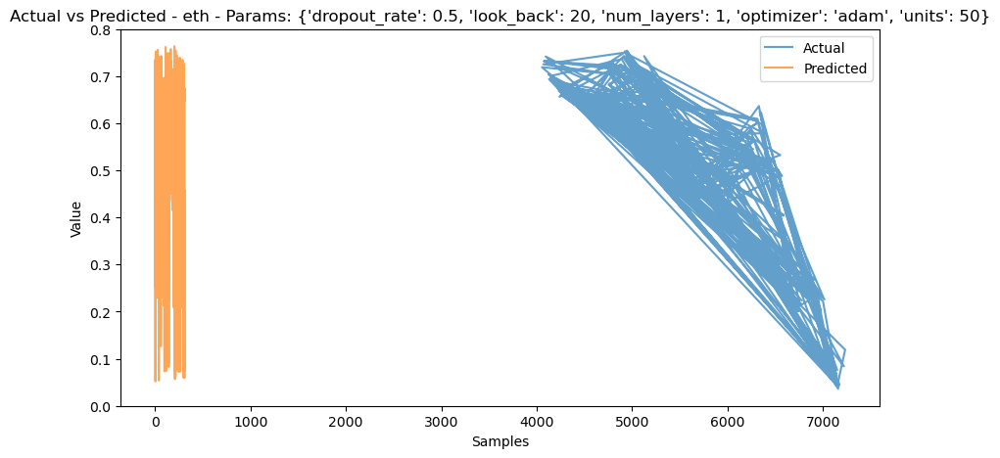

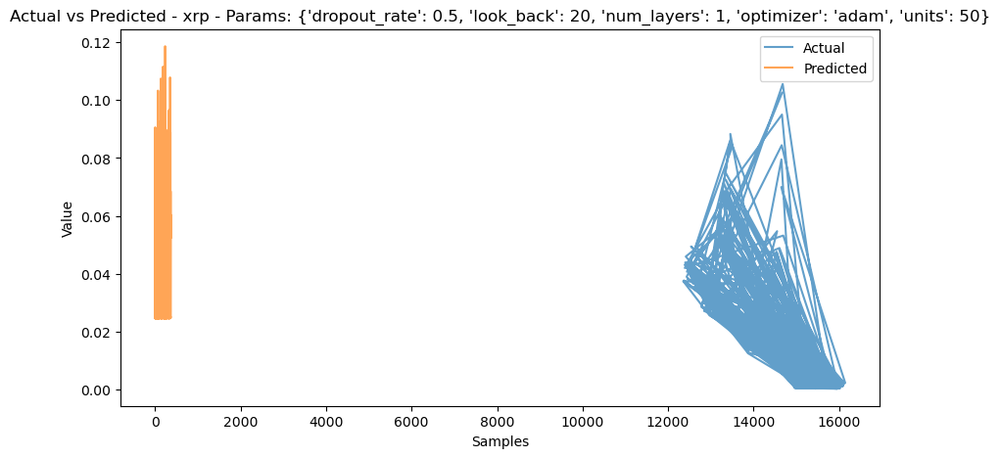

Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


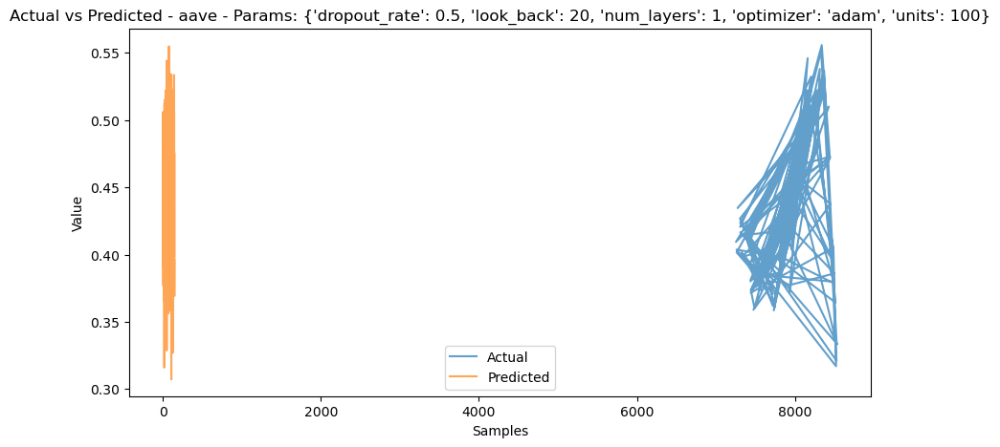

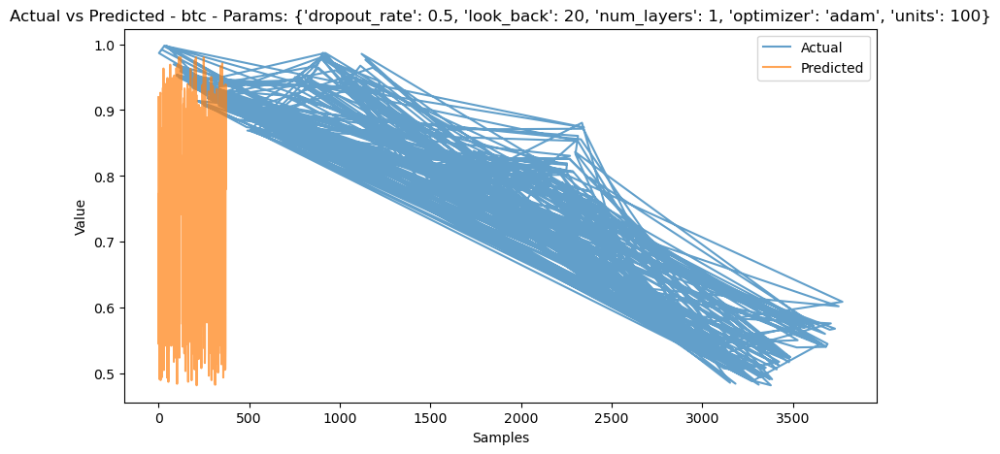

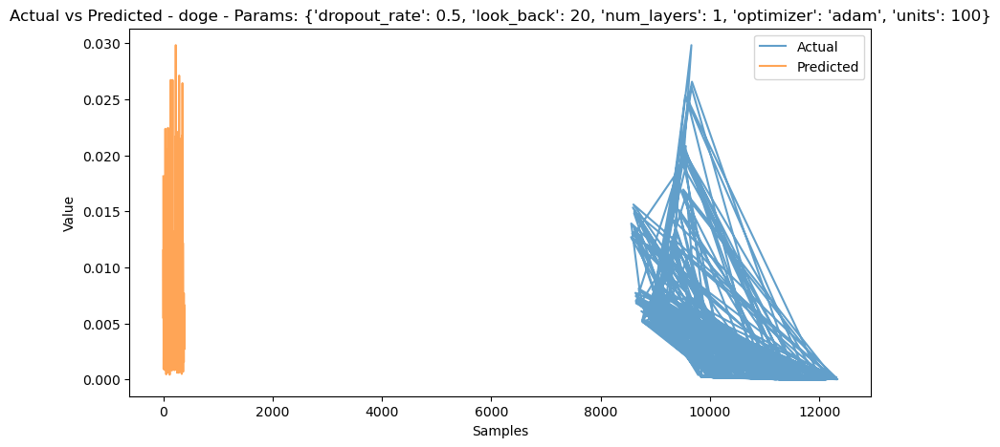

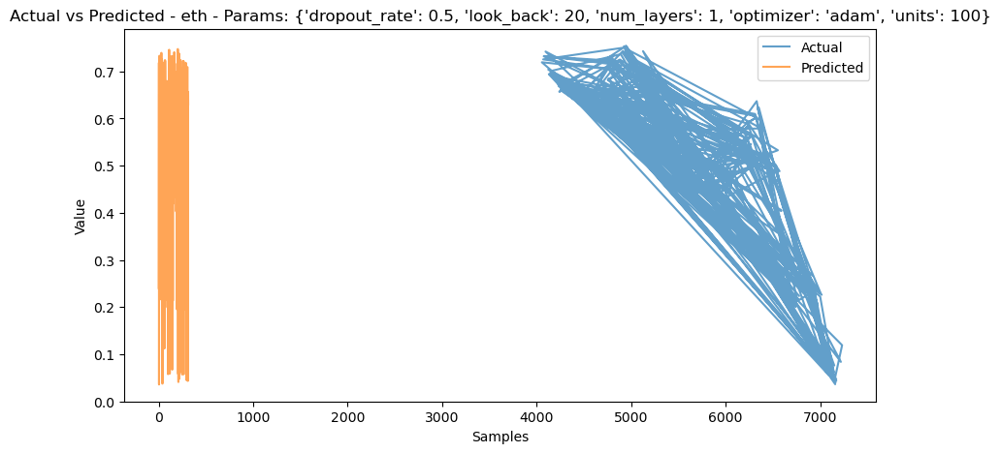

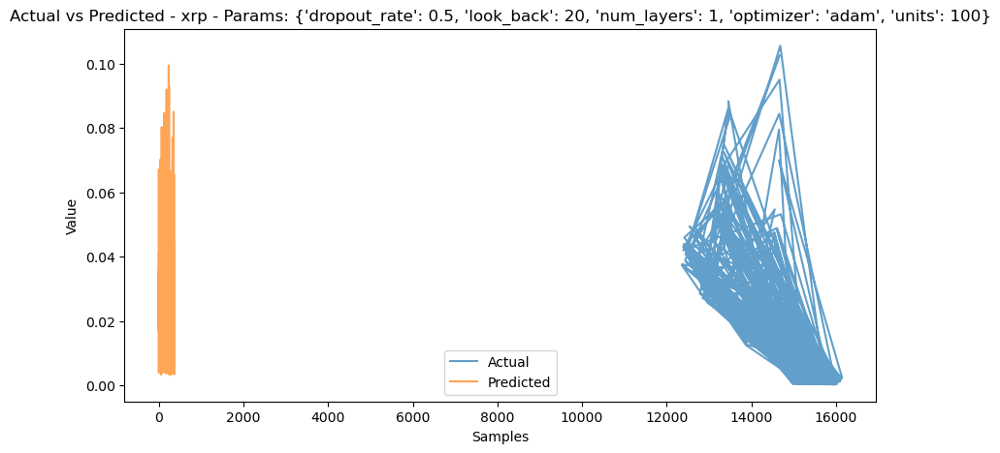

Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


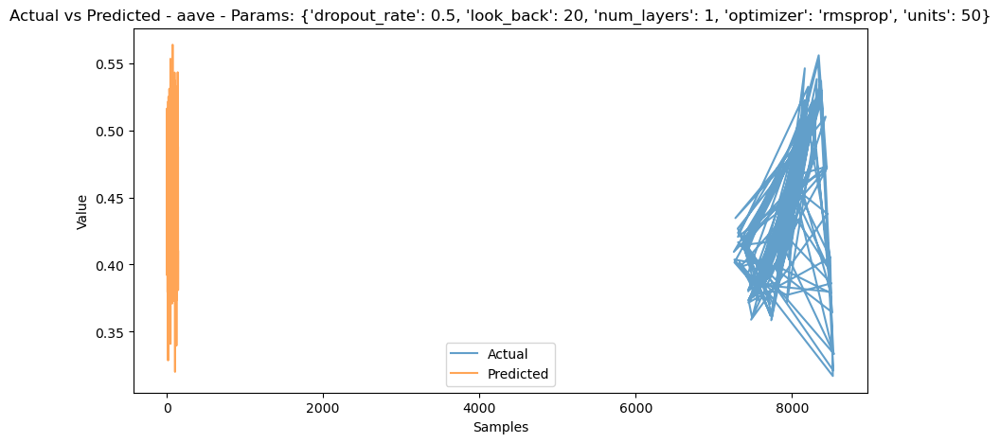

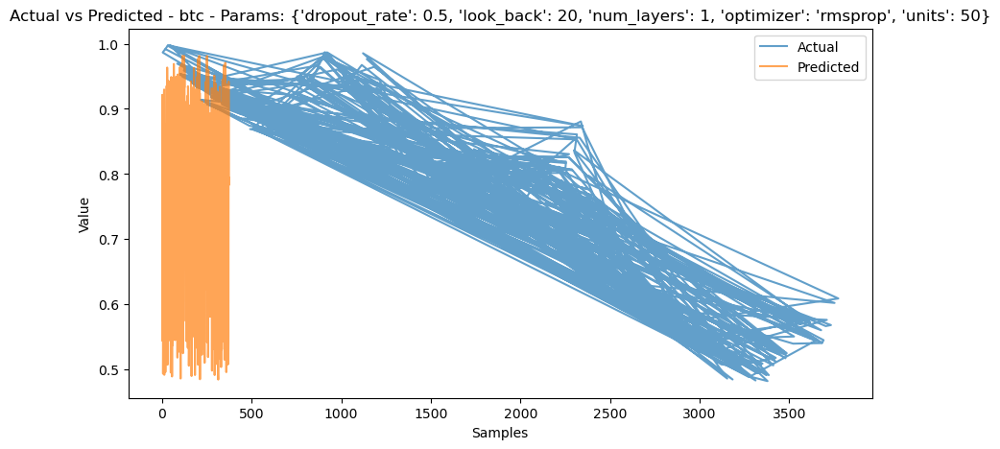

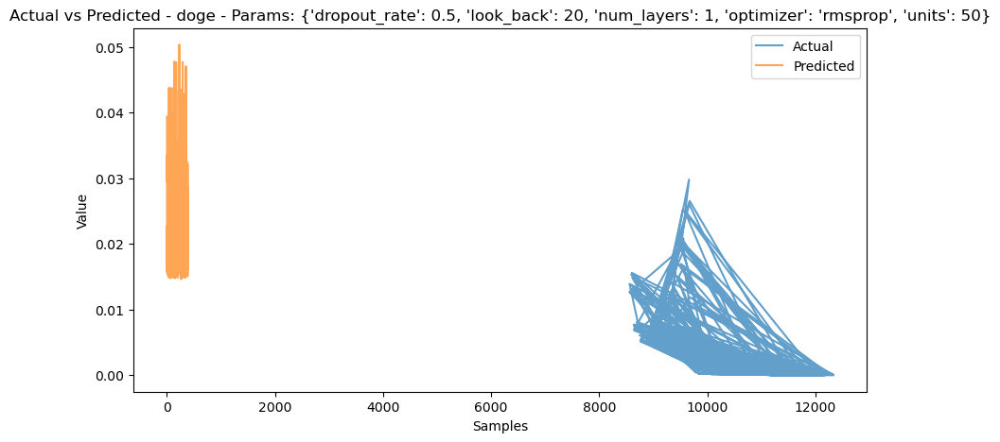

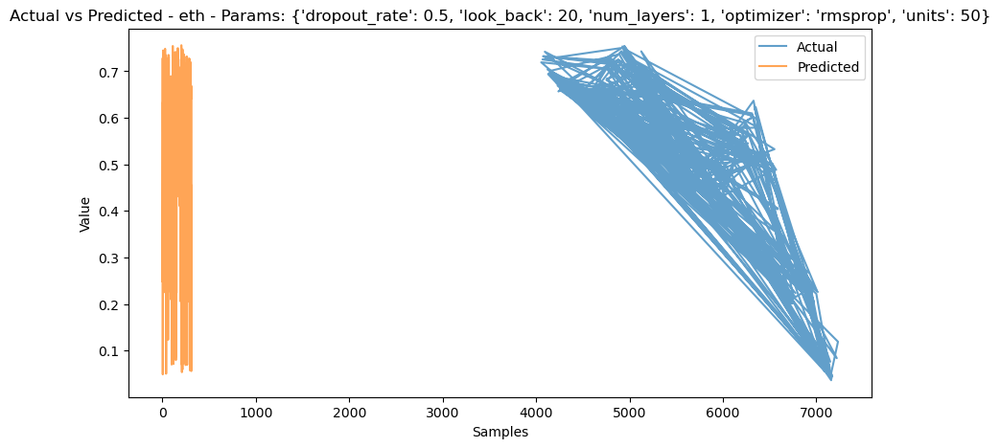

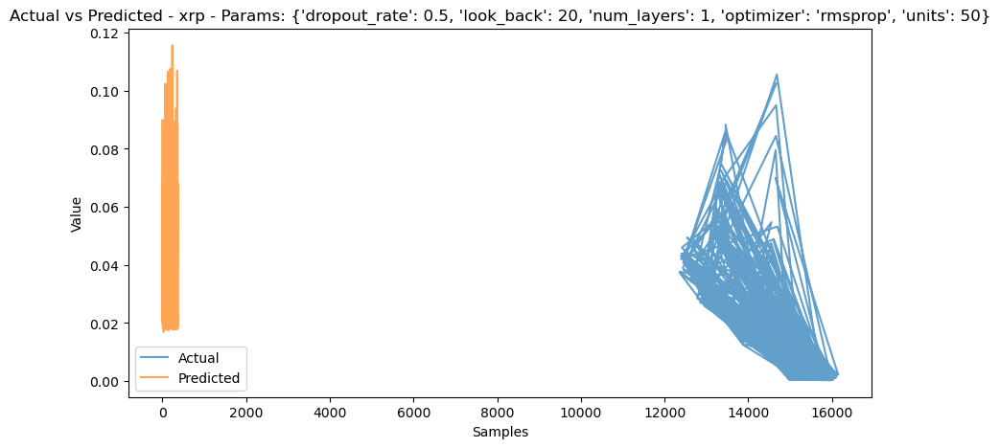

Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 1, 'optimizer': 'rmsprop', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


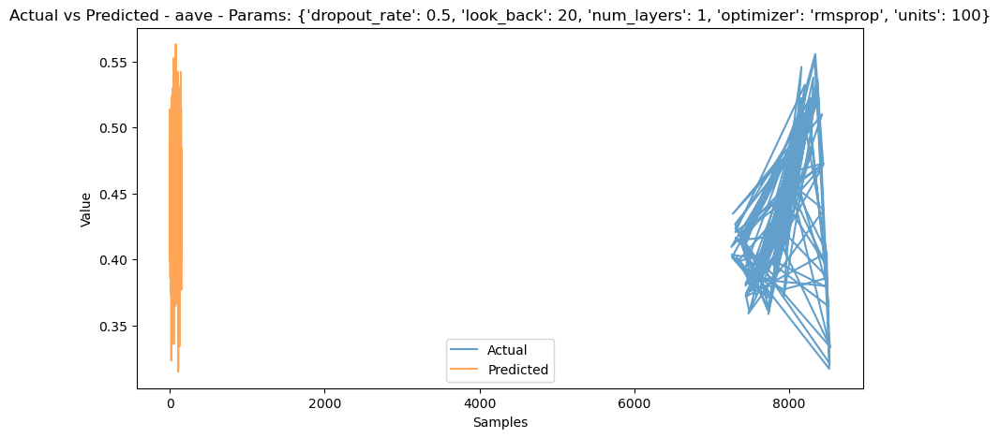

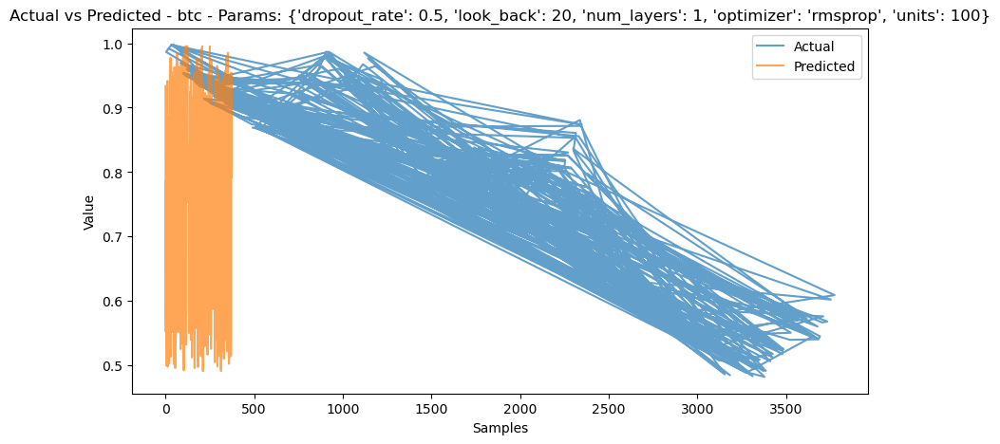

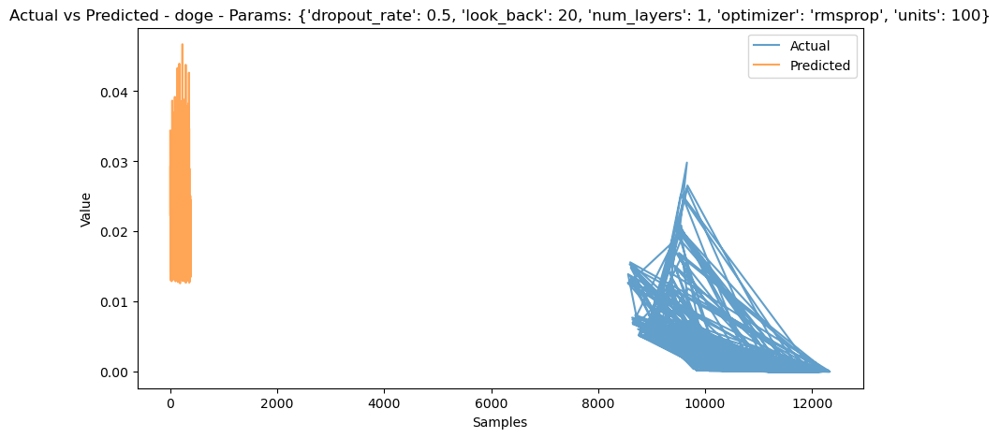

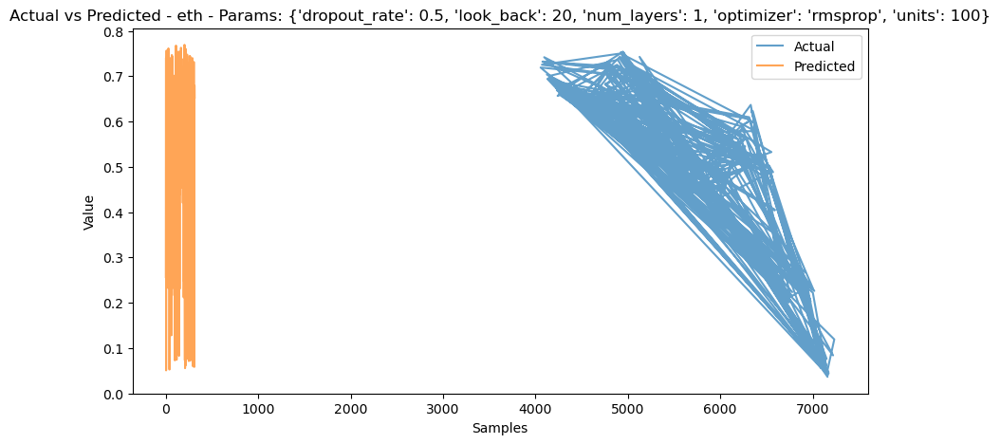

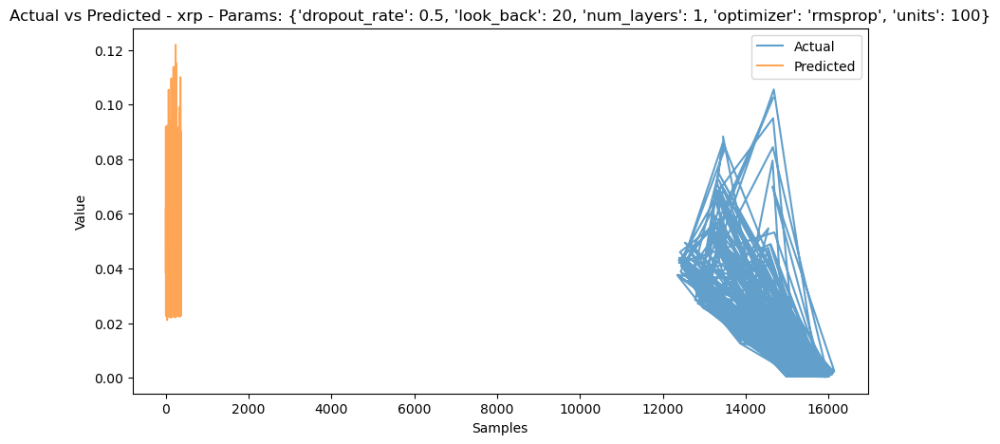

Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 1, 'optimizer': 'sgd', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


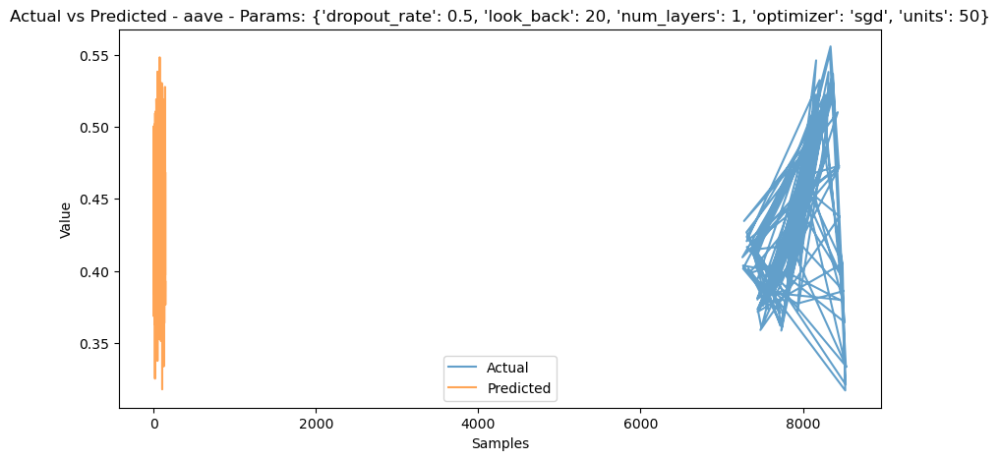

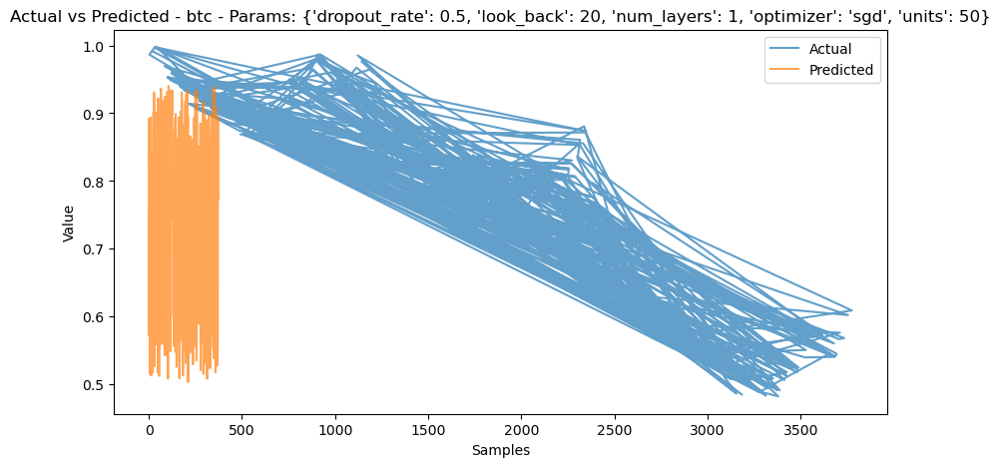

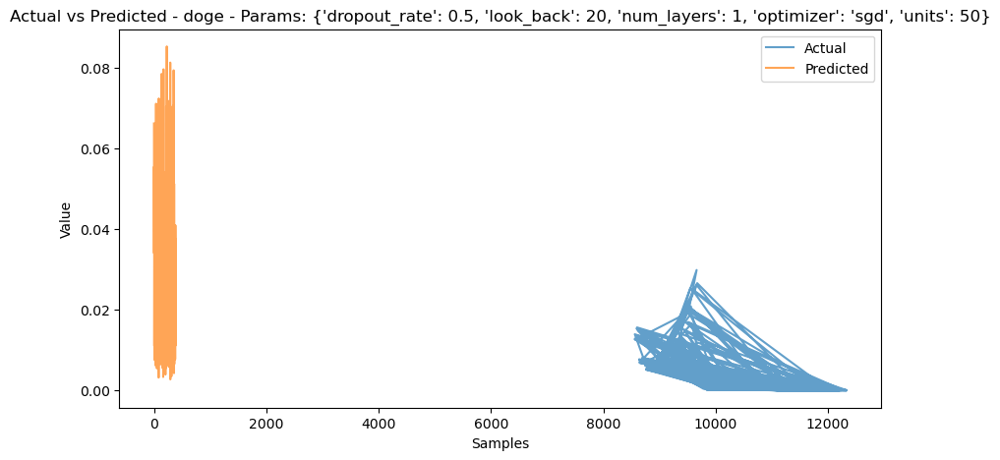

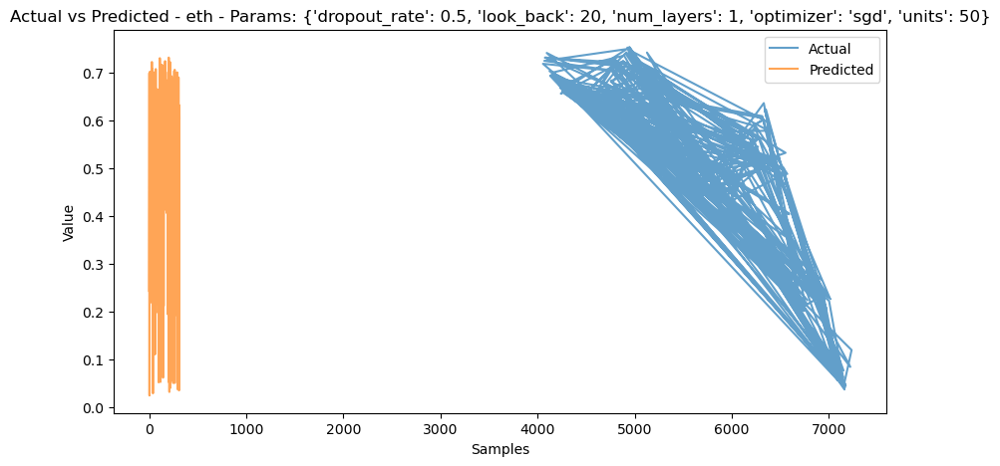

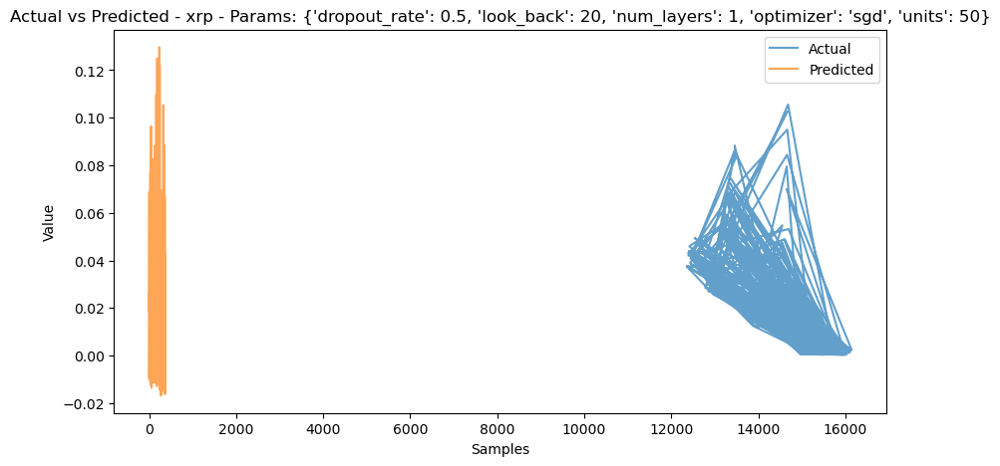

Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 1, 'optimizer': 'sgd', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


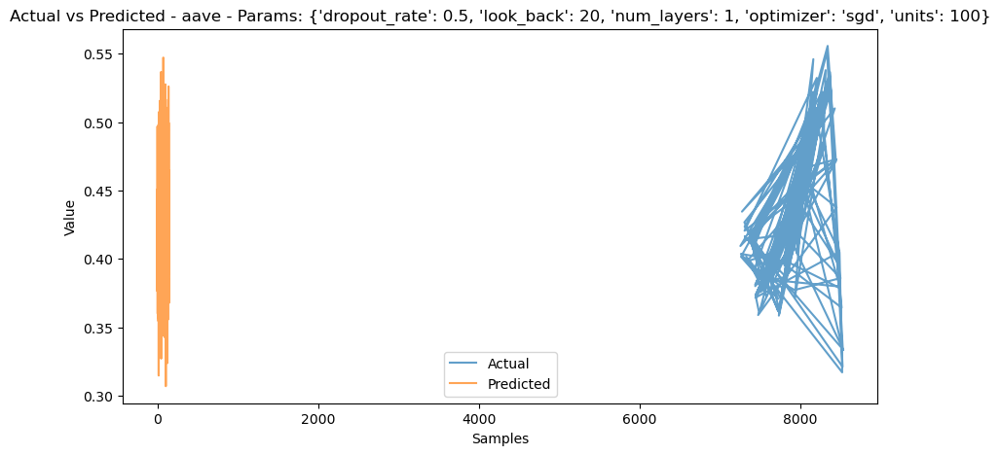

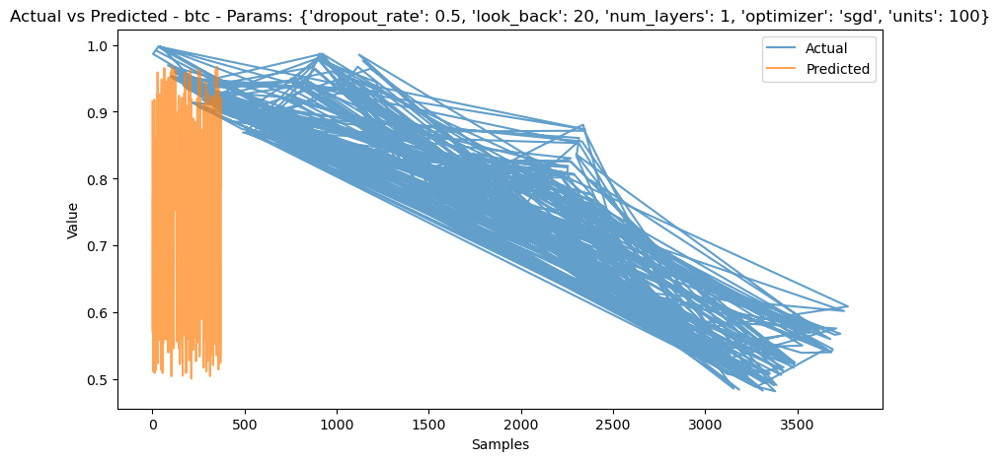

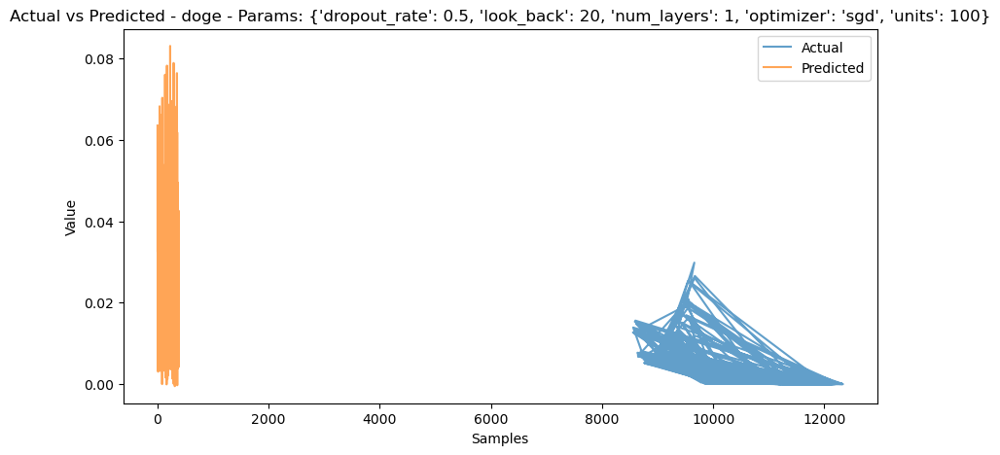

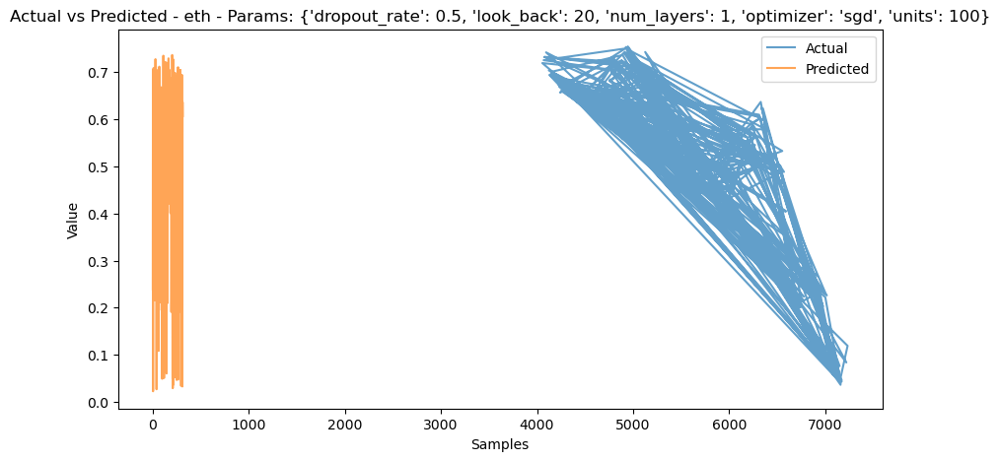

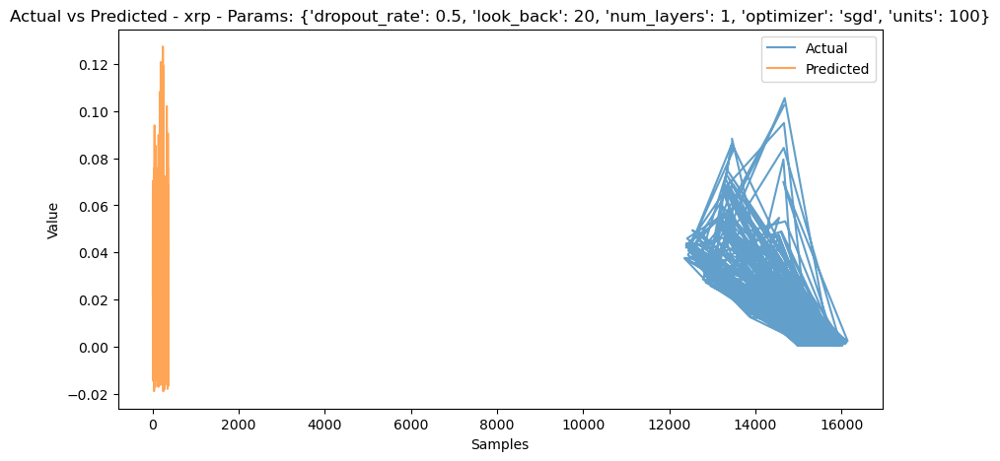

Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 1, 'optimizer': 'adagrad', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


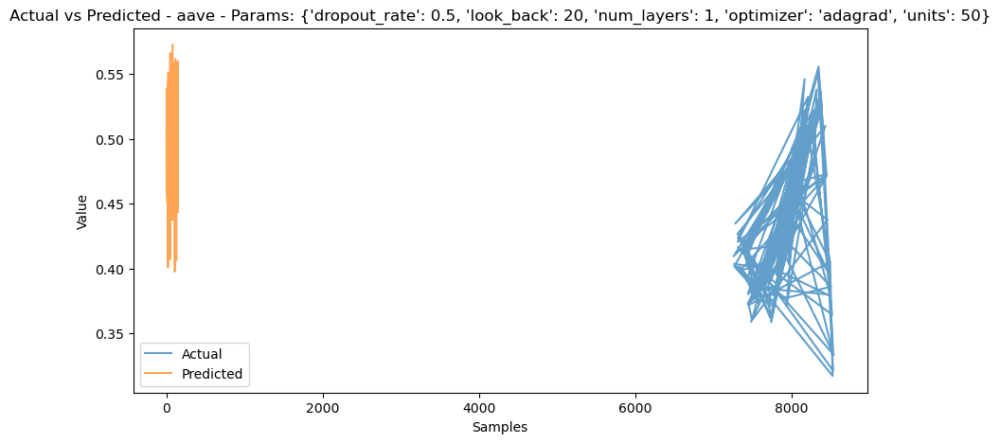

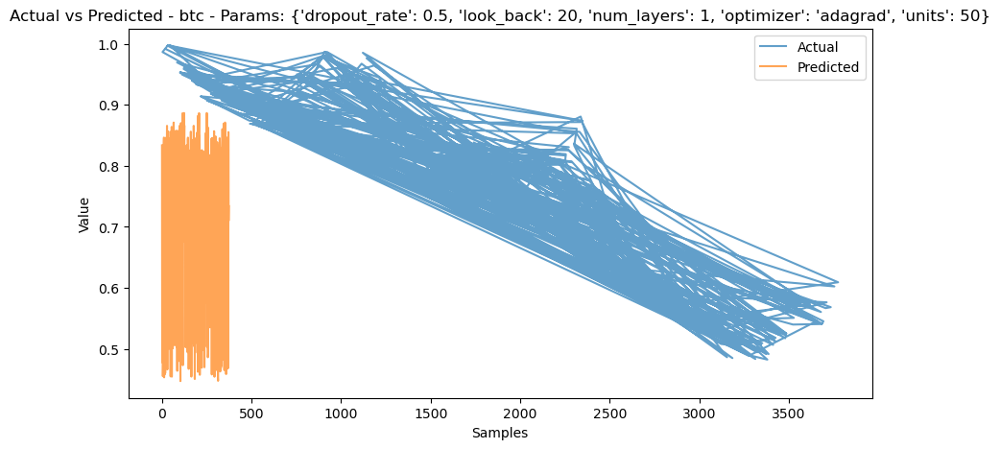

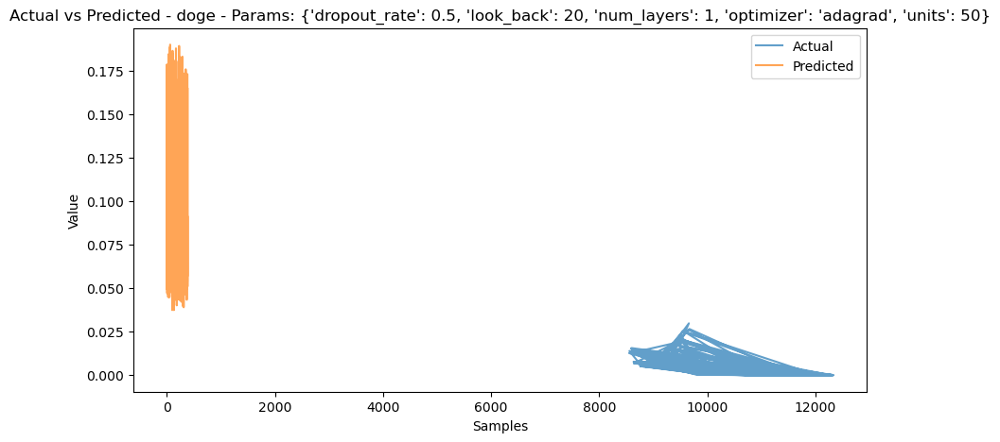

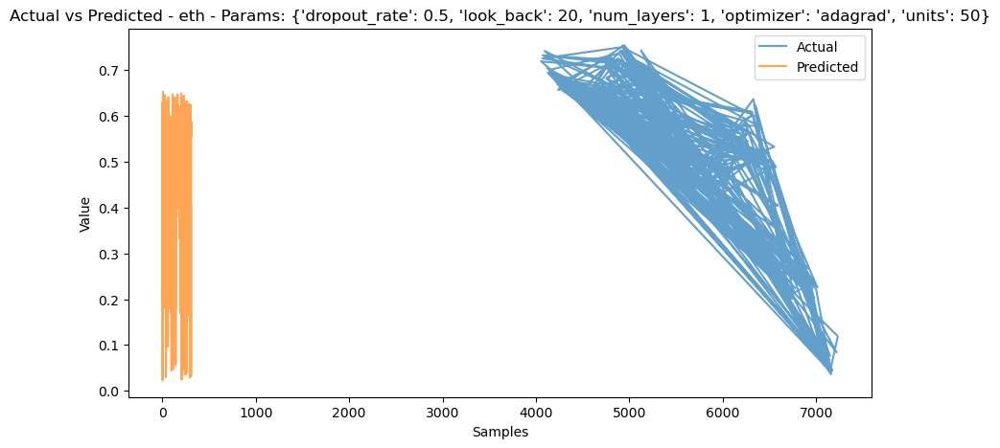

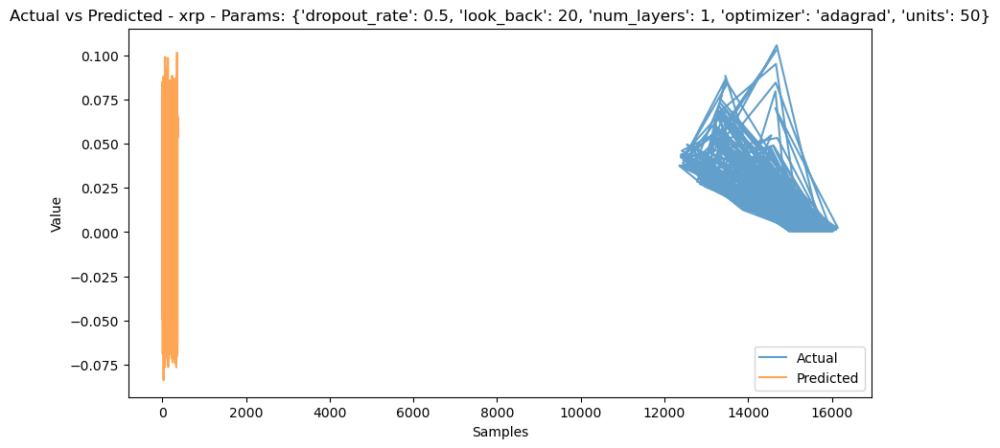

Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 1, 'optimizer': 'adagrad', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


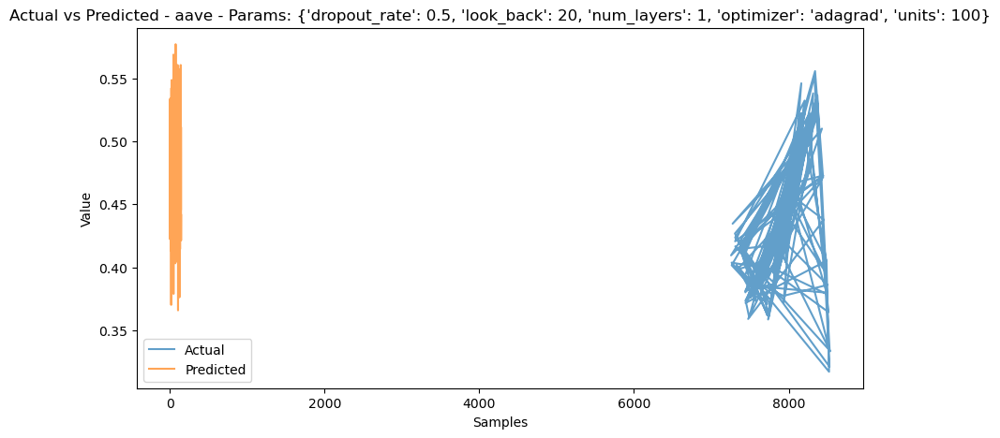

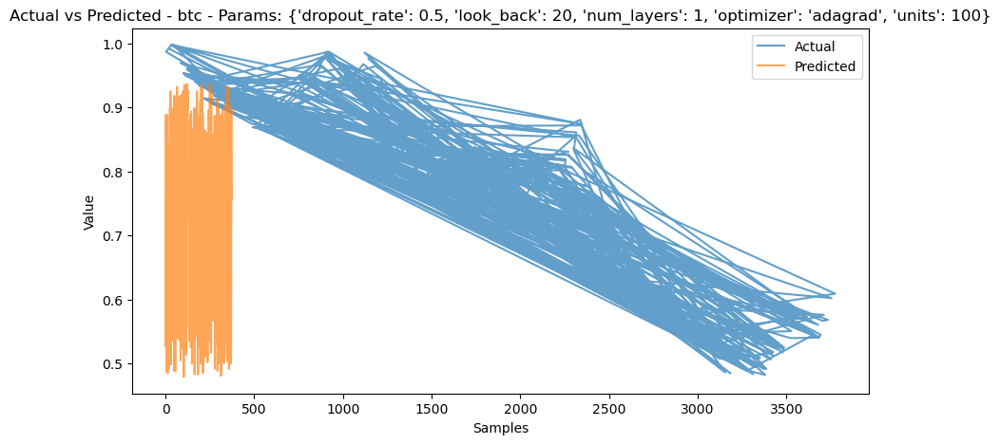

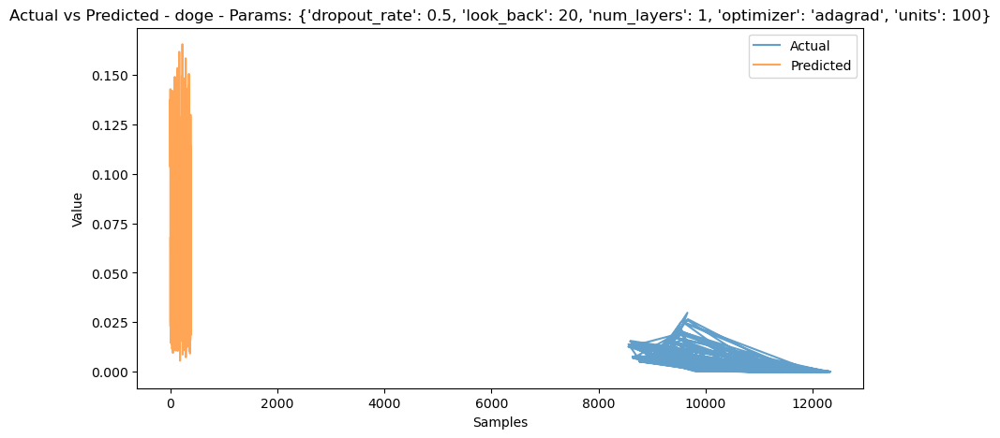

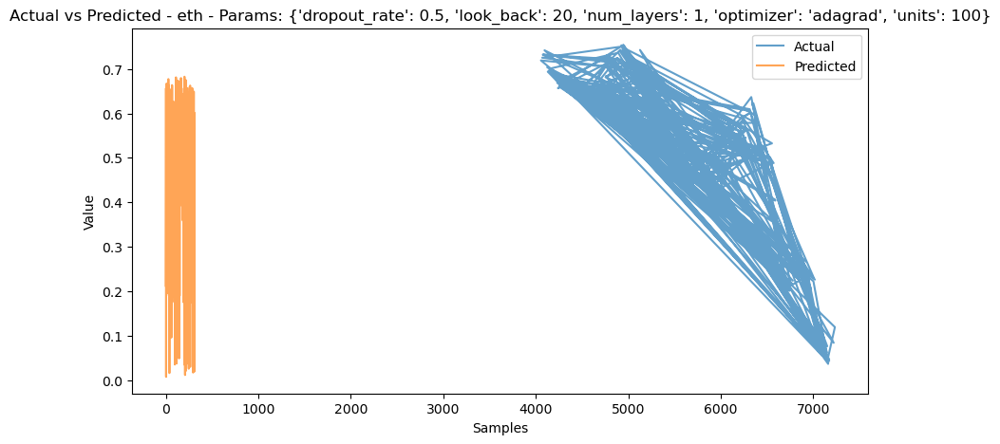

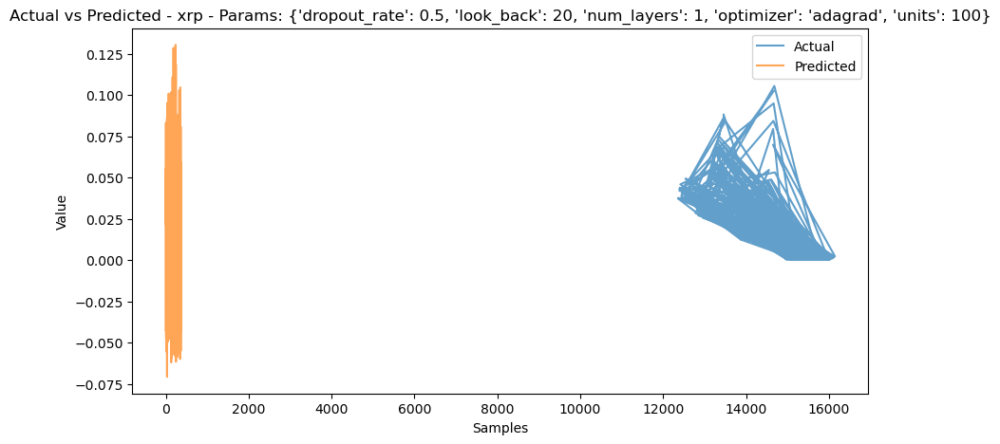

Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 2, 'optimizer': 'adam', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


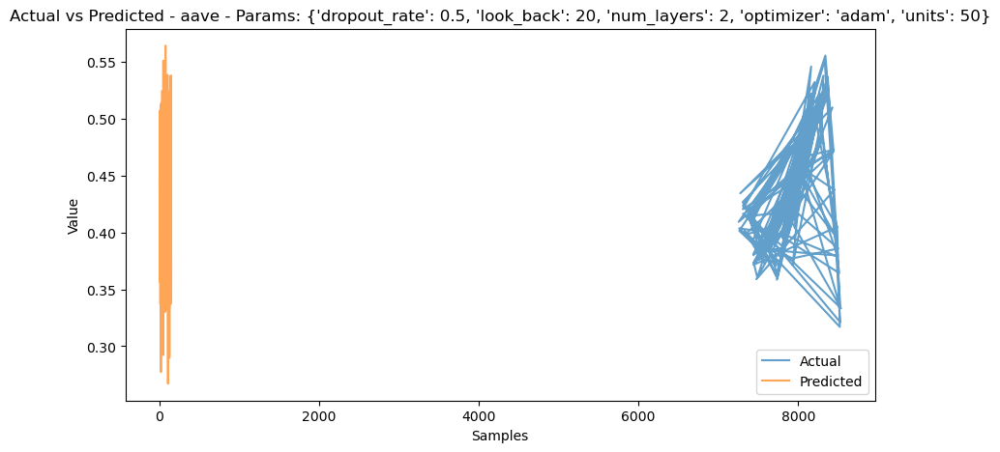

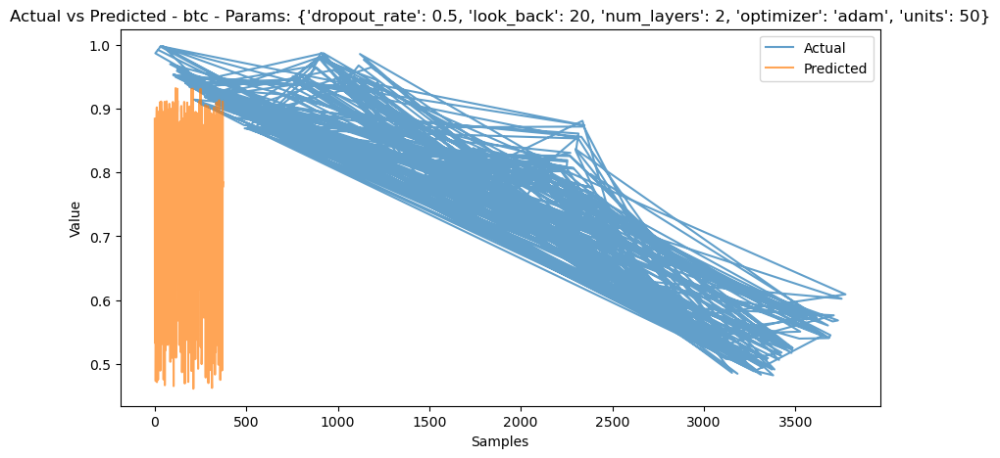

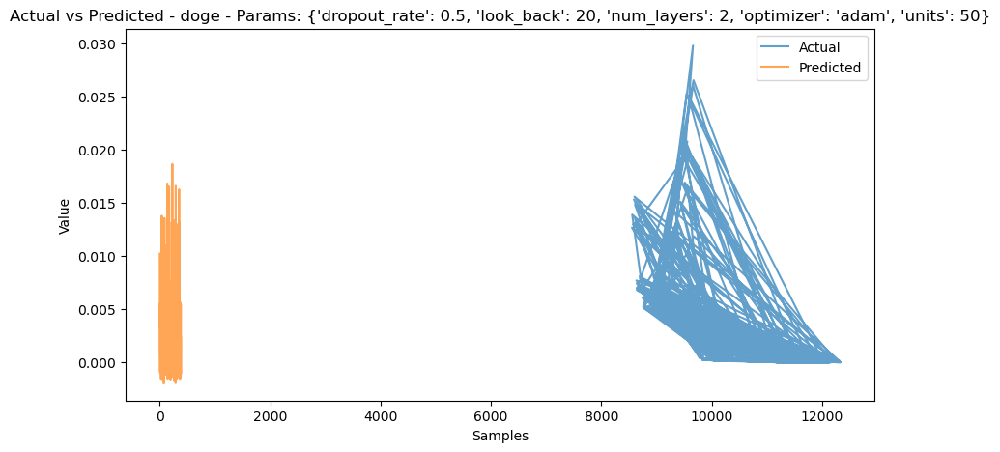

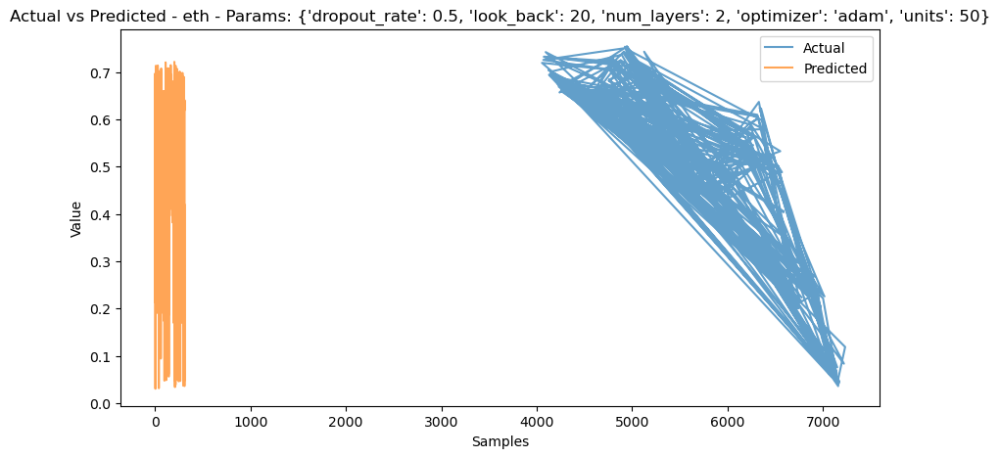

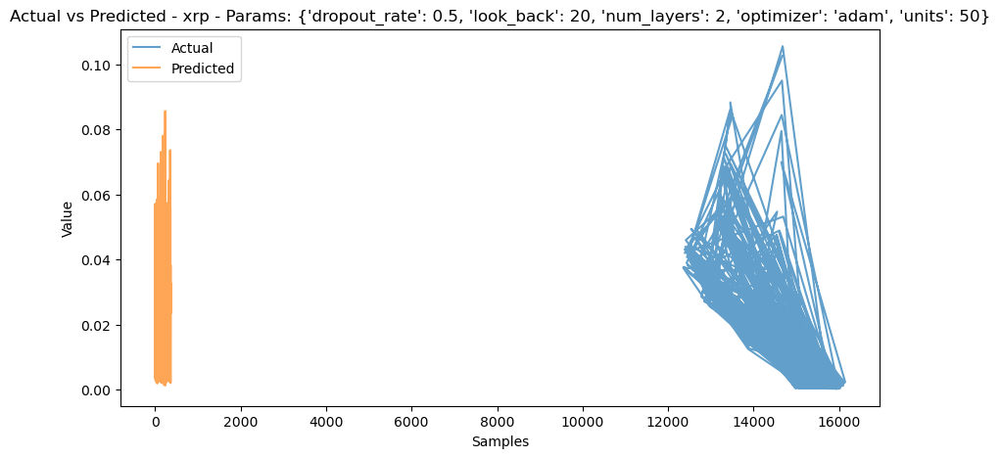

Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 2, 'optimizer': 'adam', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


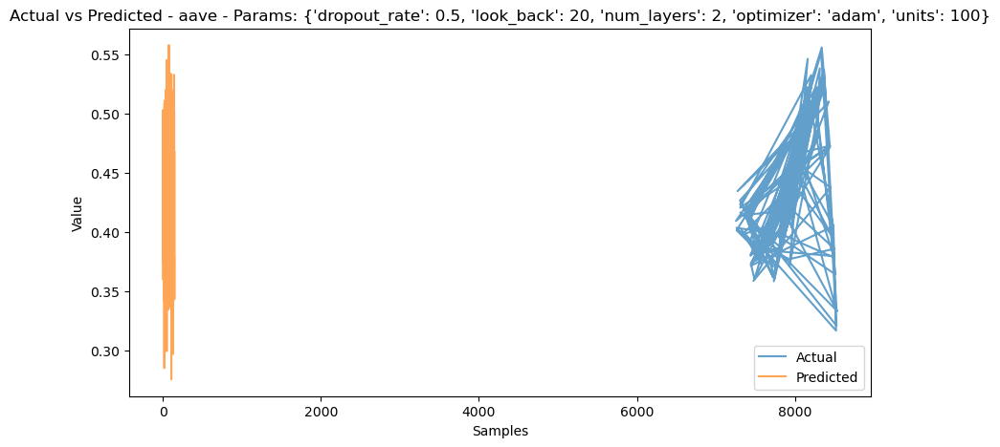

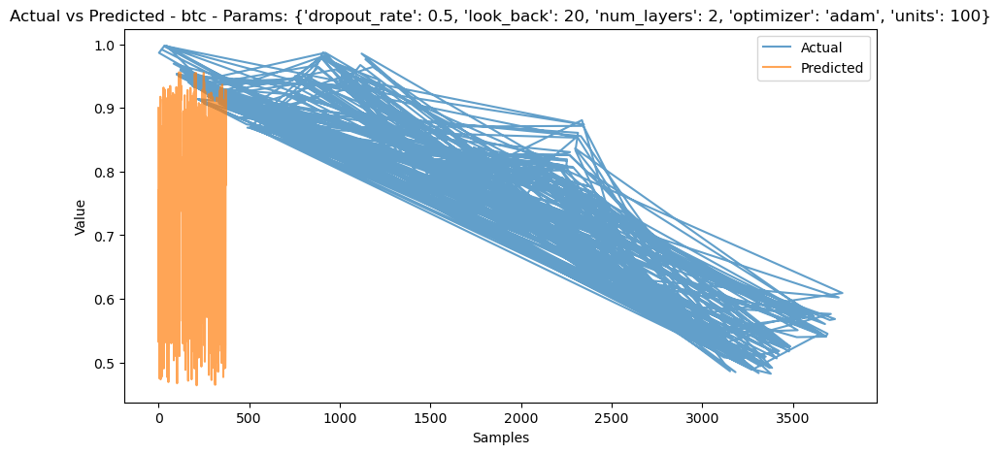

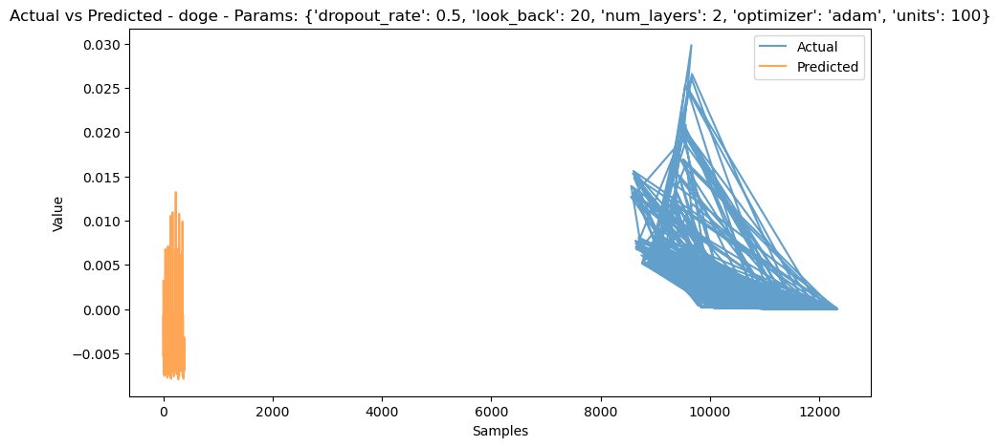

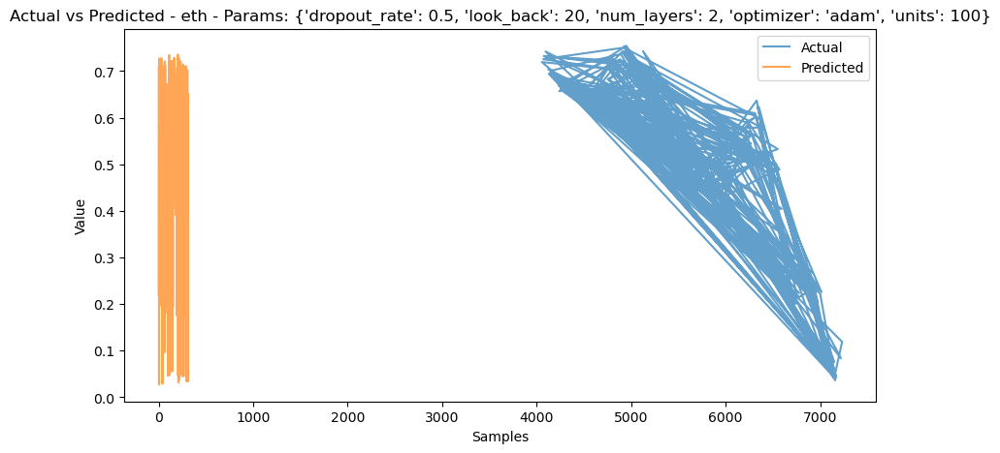

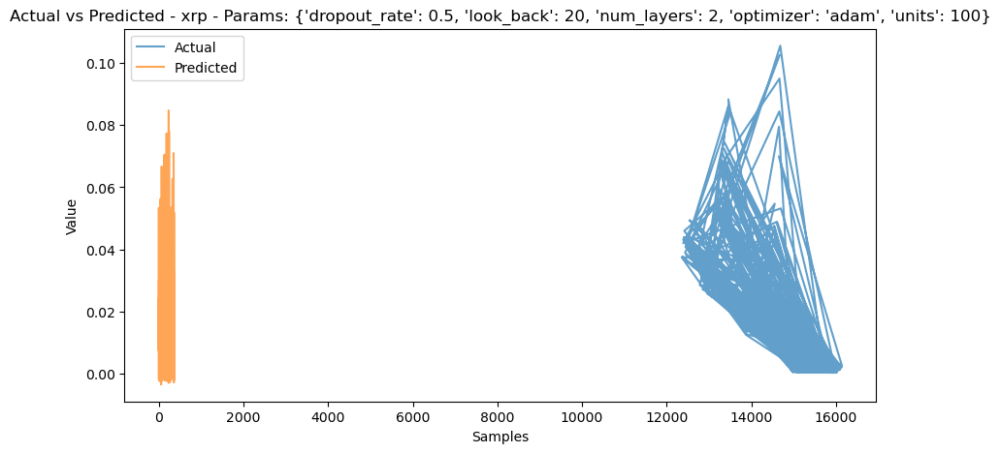

Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 2, 'optimizer': 'rmsprop', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


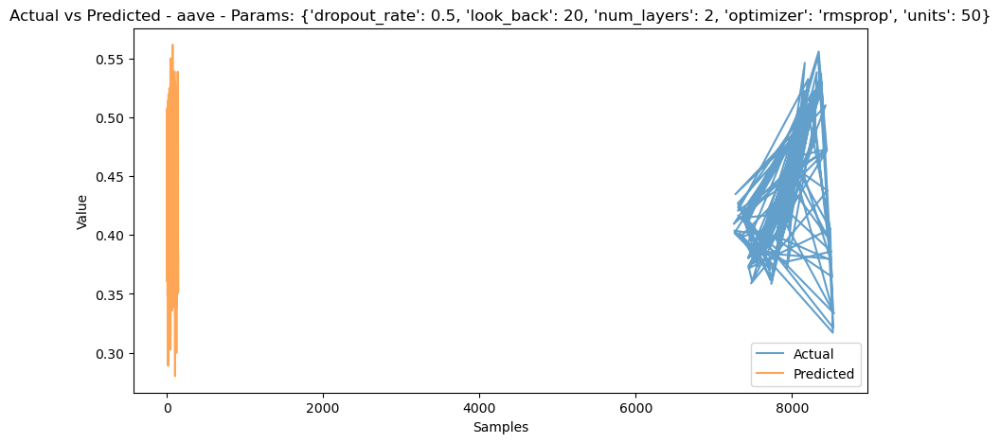

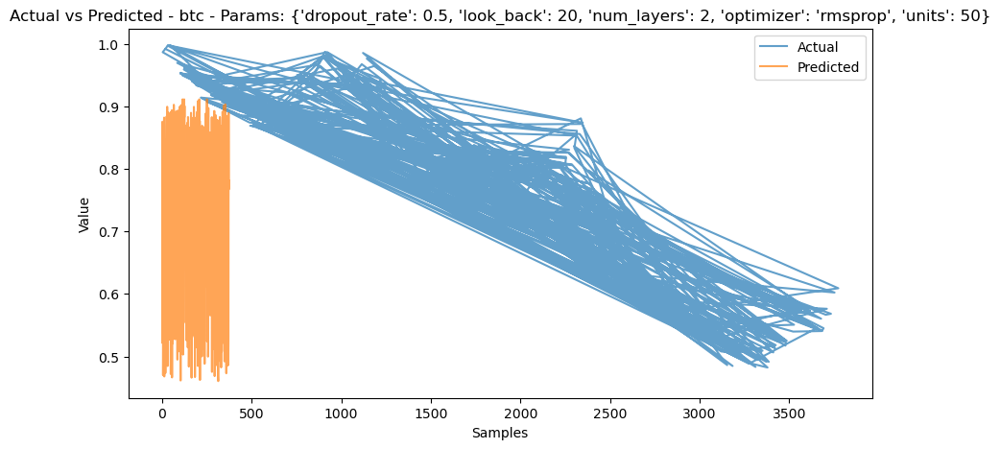

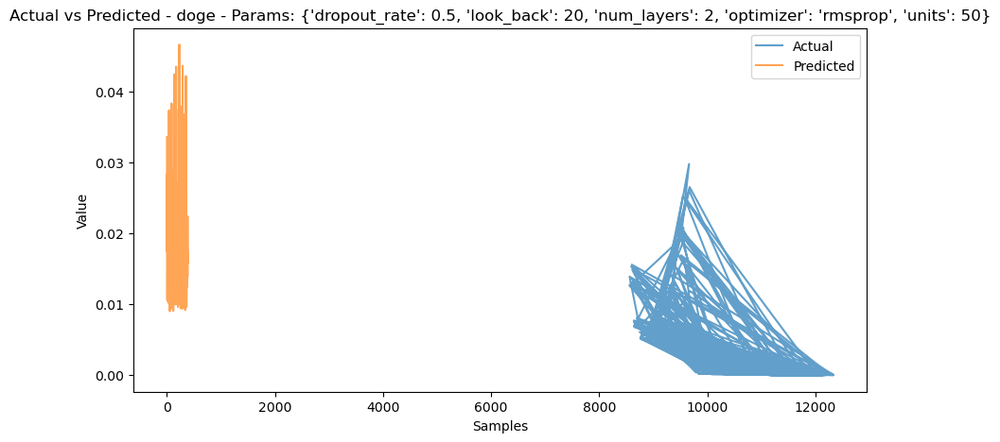

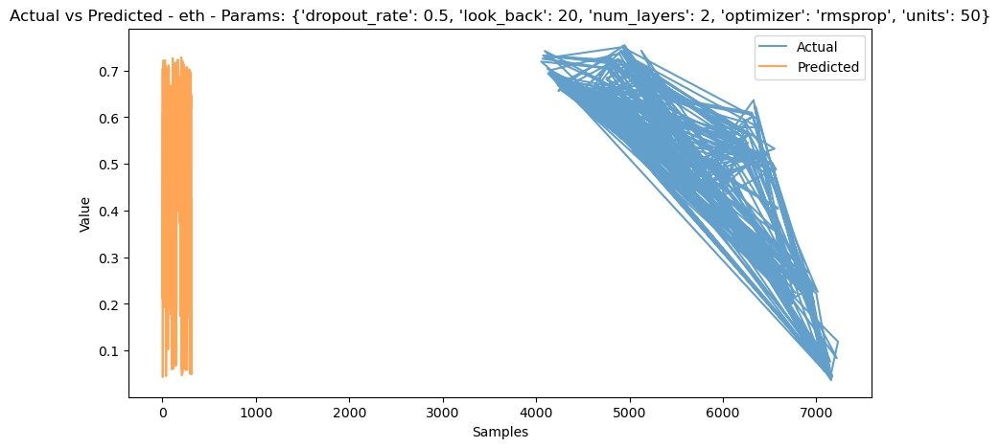

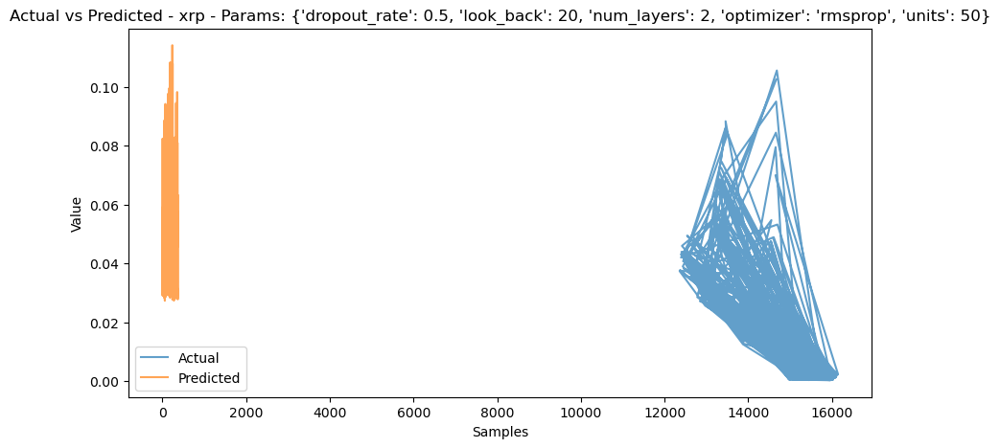

Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 2, 'optimizer': 'rmsprop', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


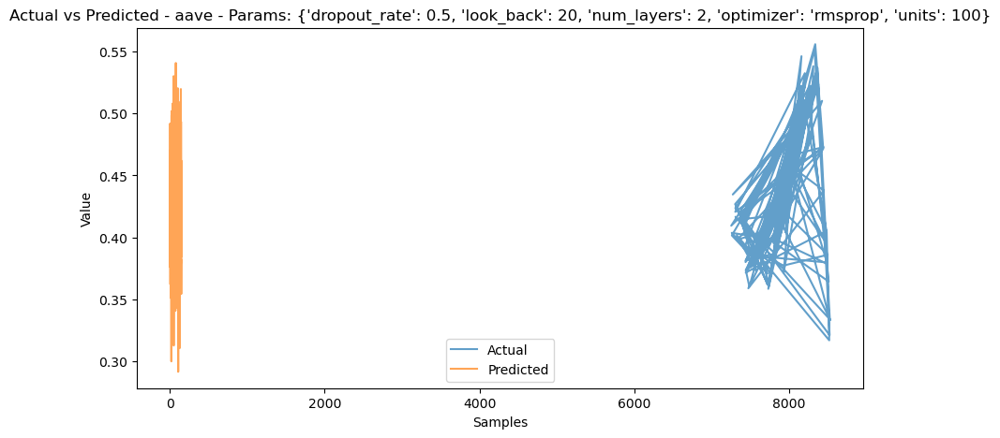

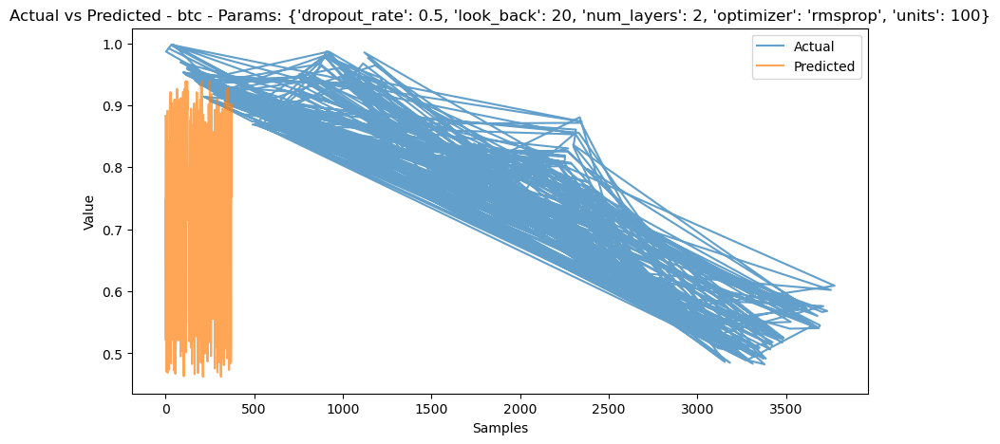

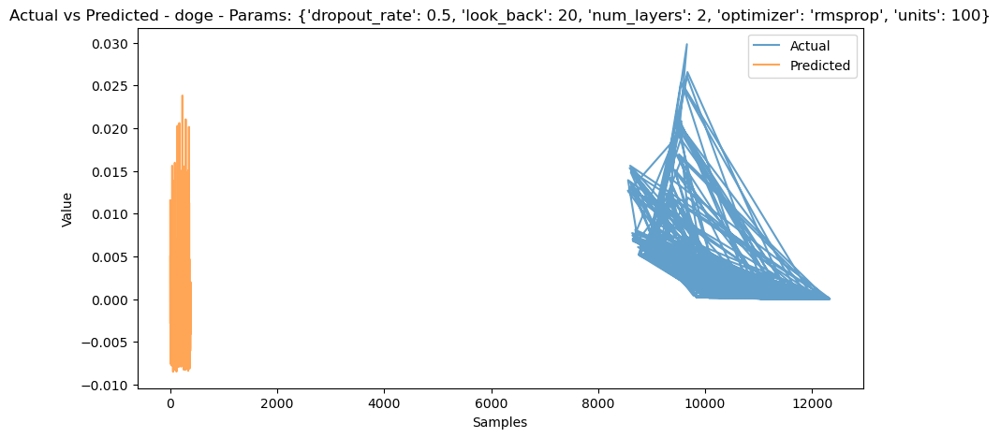

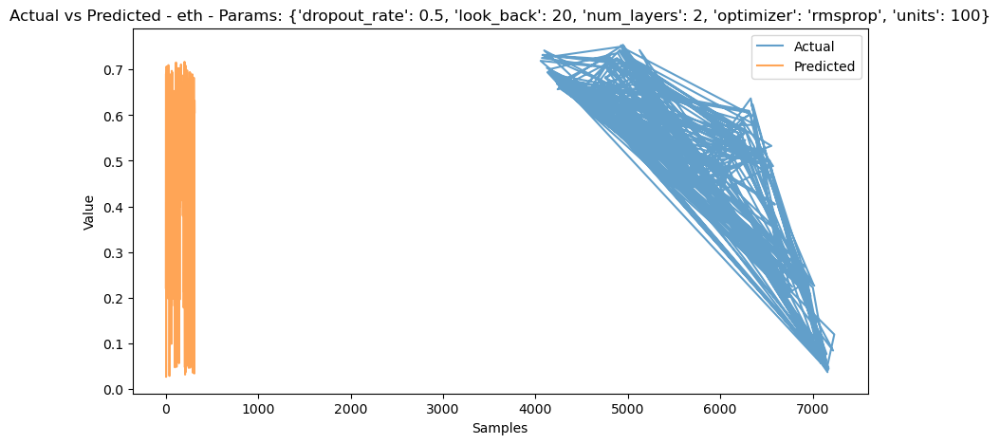

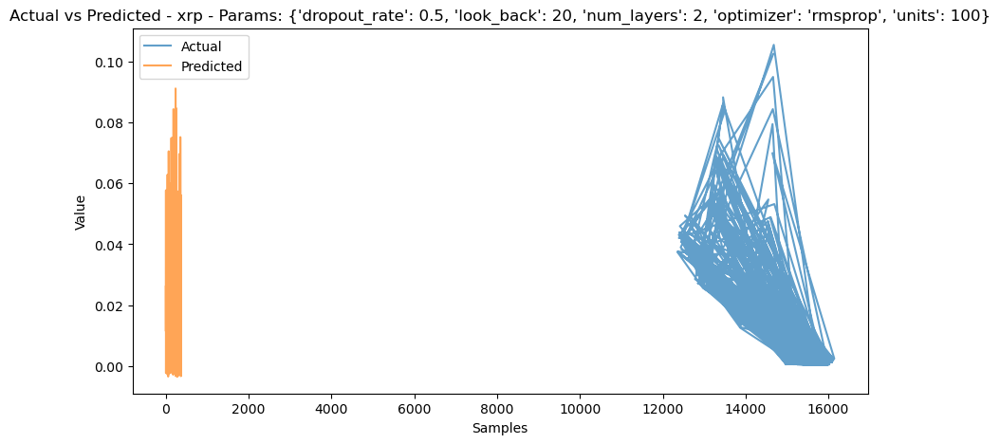

Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 2, 'optimizer': 'sgd', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


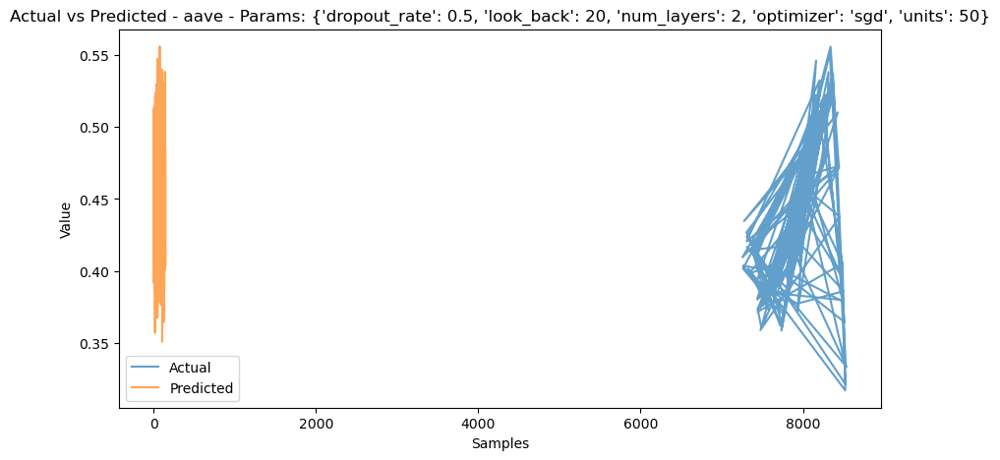

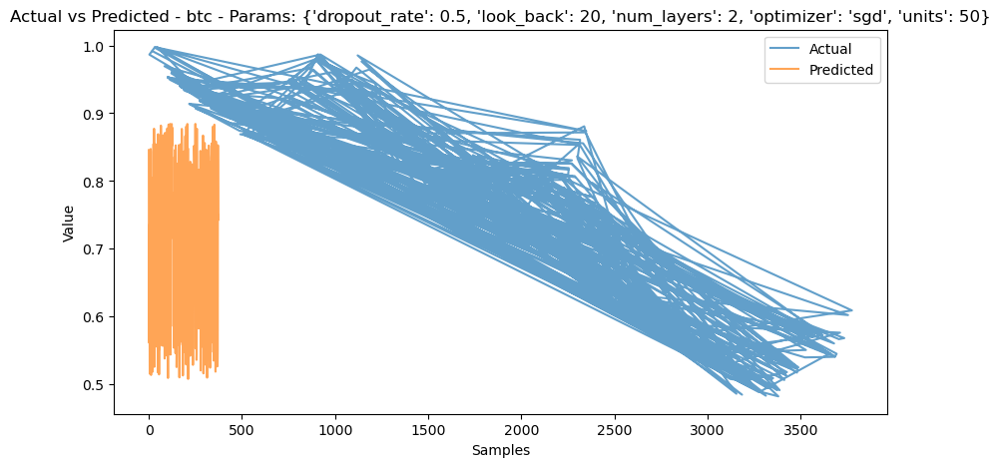

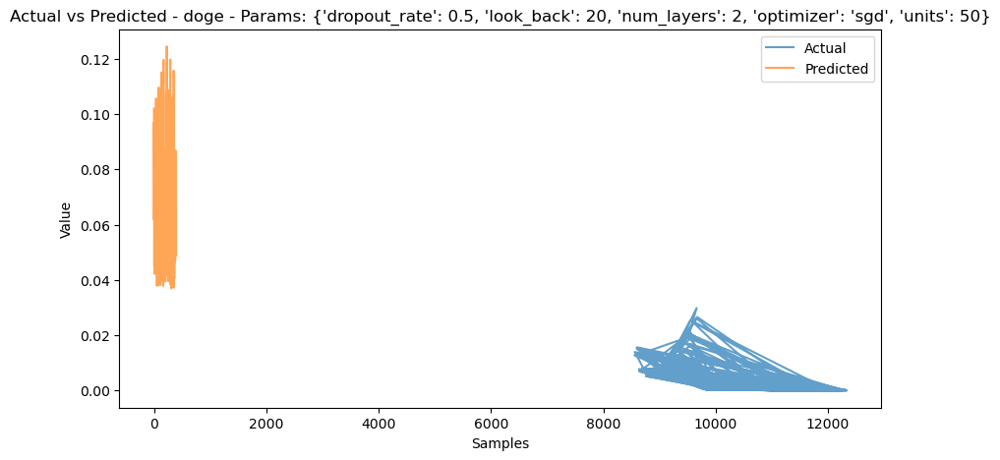

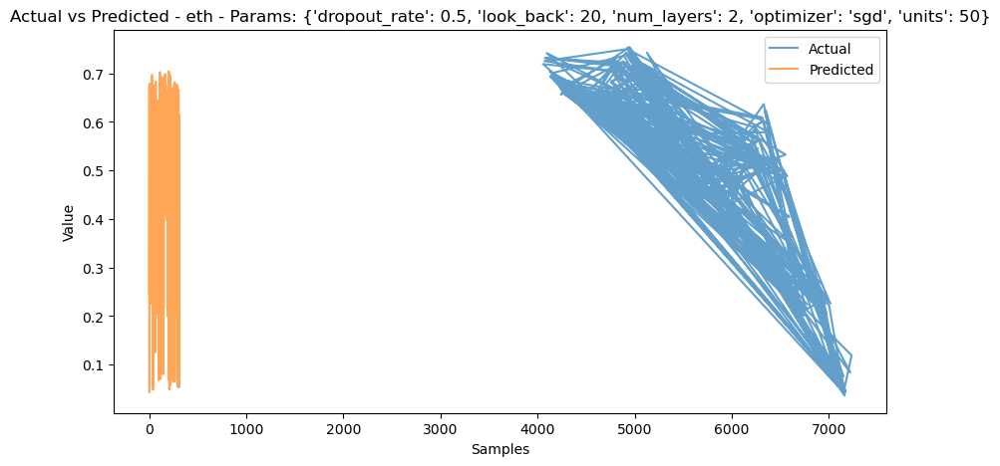

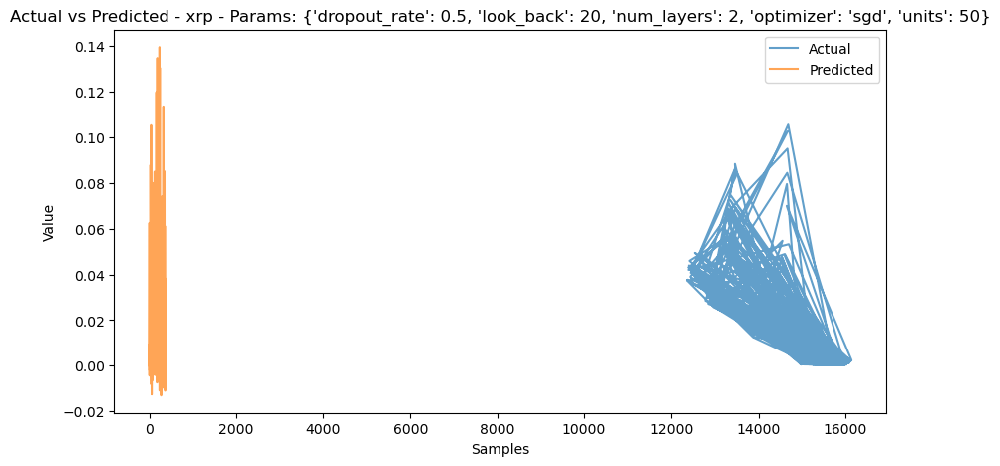

Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 2, 'optimizer': 'sgd', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


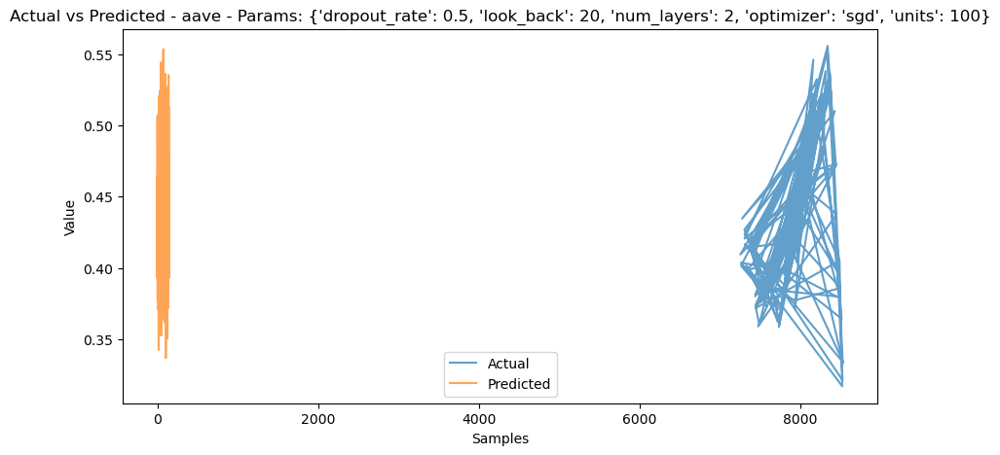

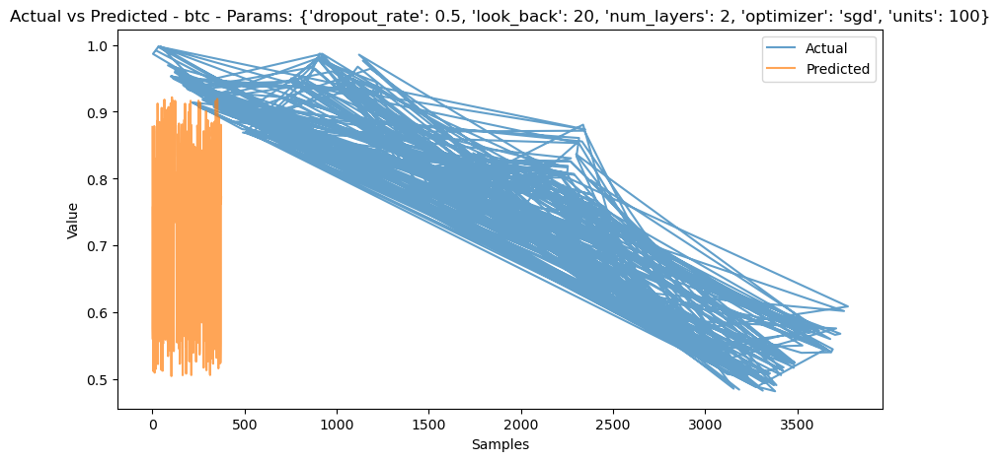

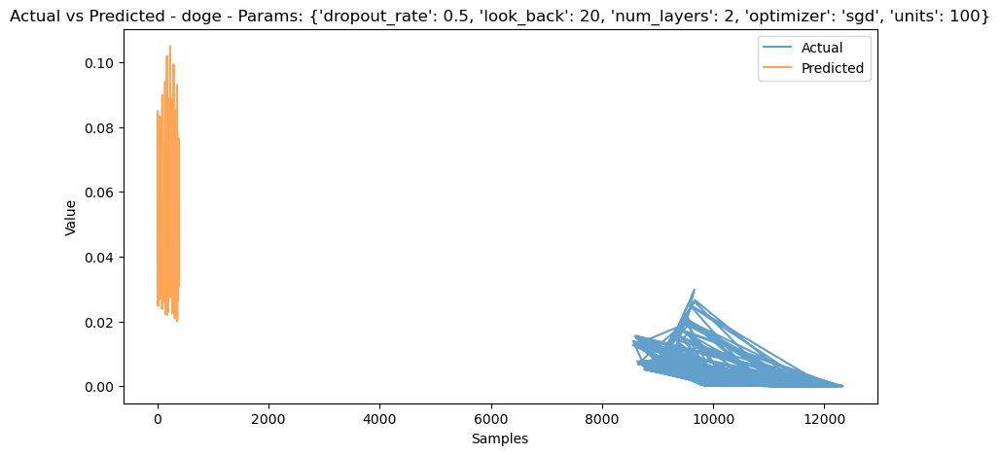

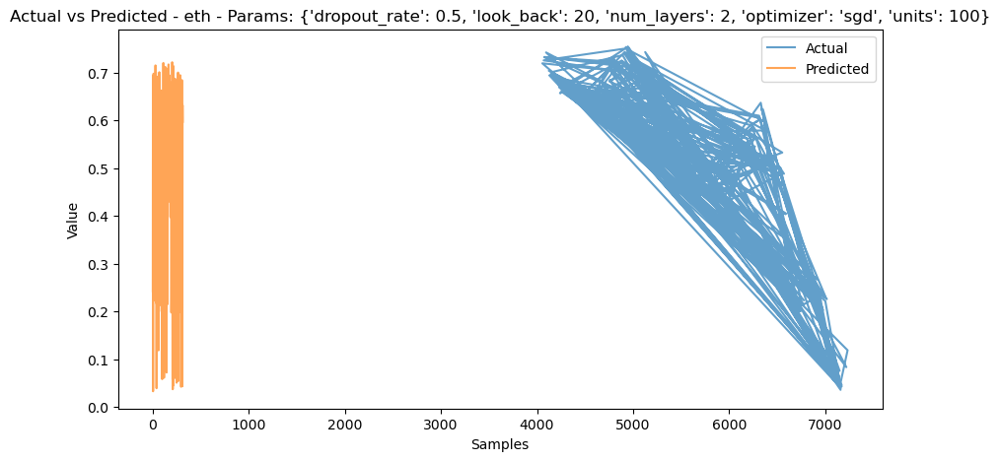

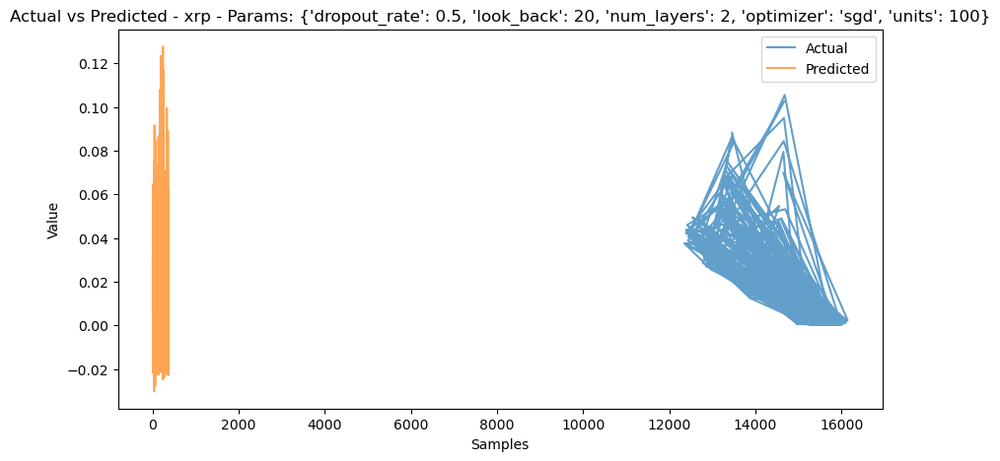

Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 2, 'optimizer': 'adagrad', 'units': 50}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


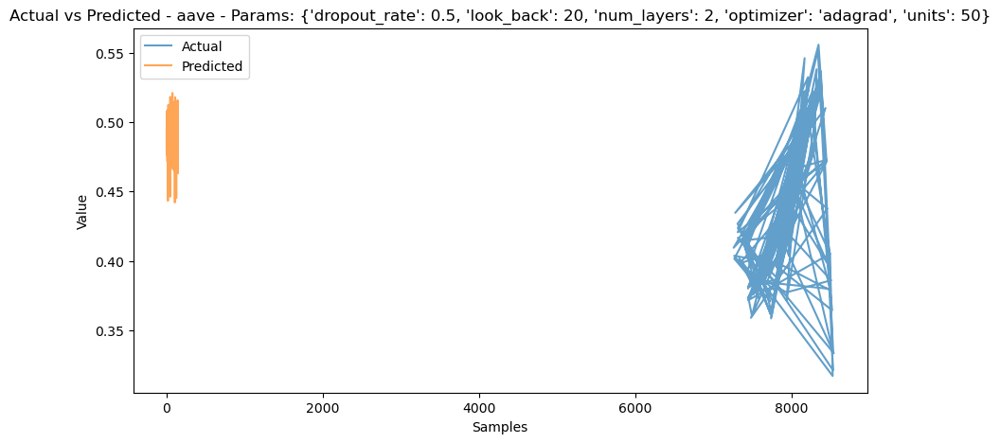

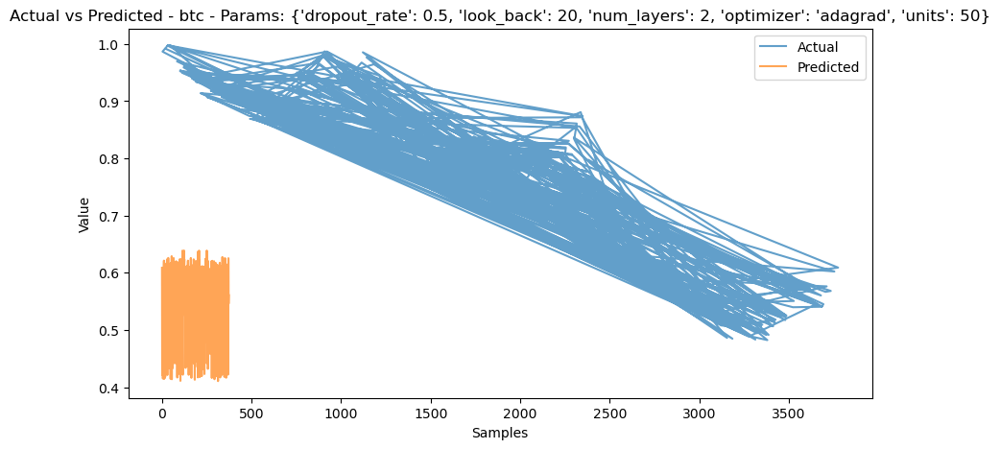

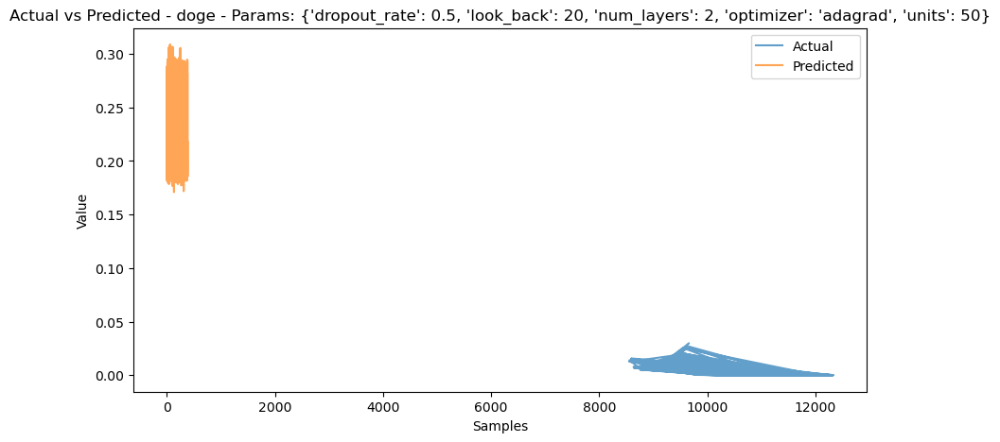

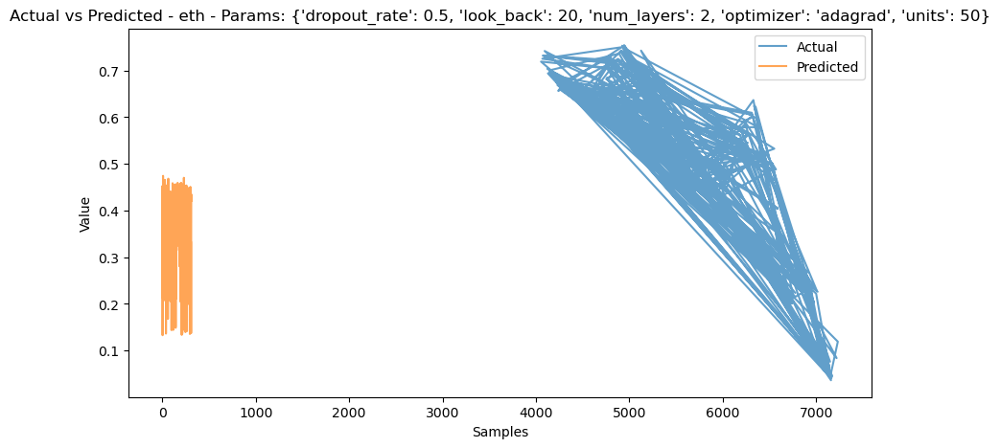

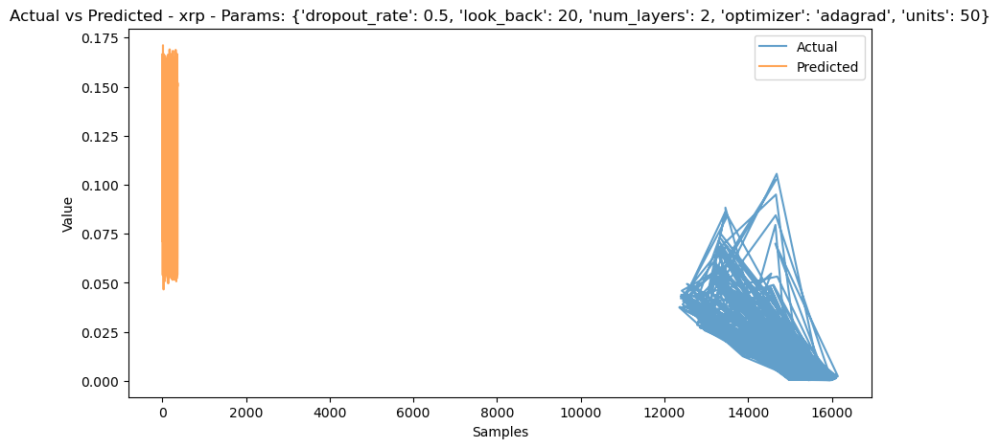

Testing parameters: {'dropout_rate': 0.5, 'look_back': 20, 'num_layers': 2, 'optimizer': 'adagrad', 'units': 100}


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


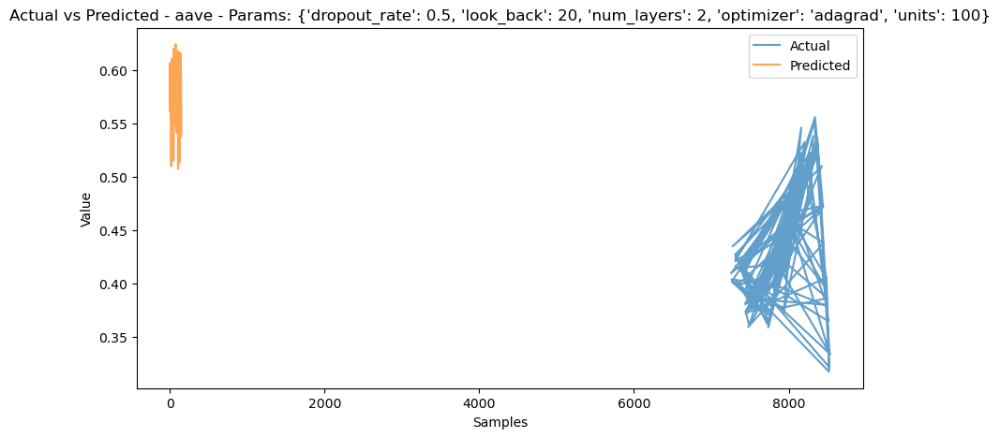

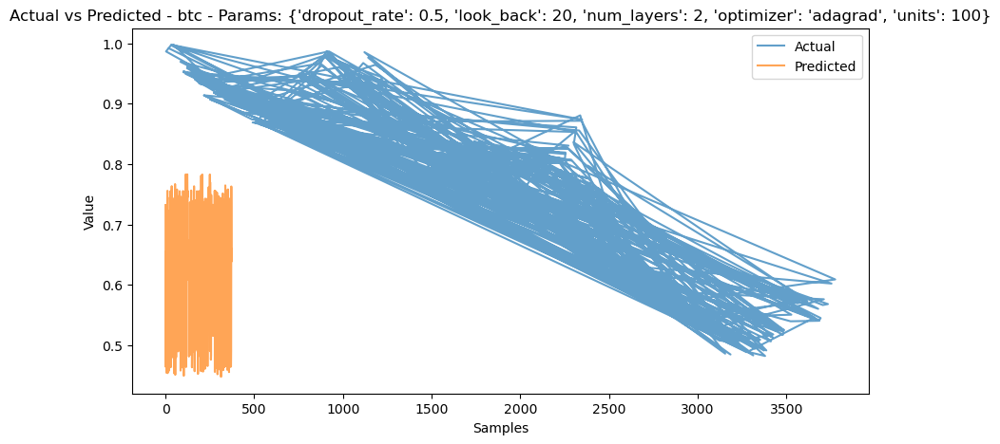

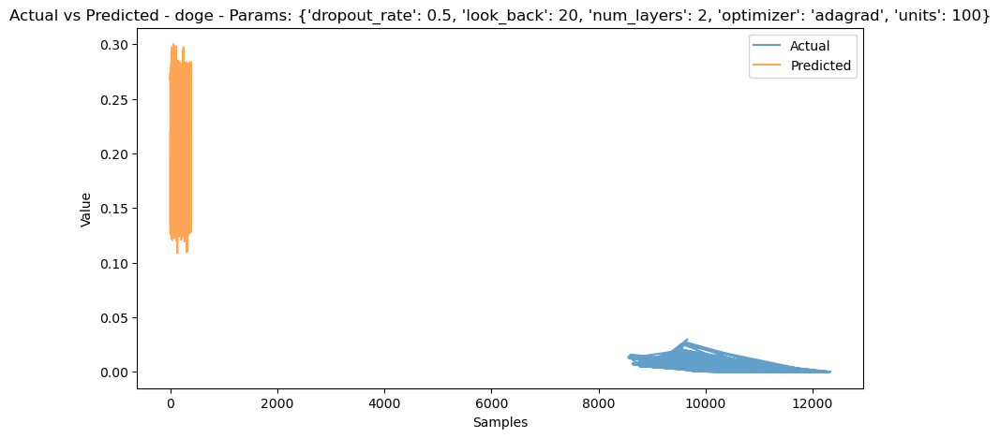

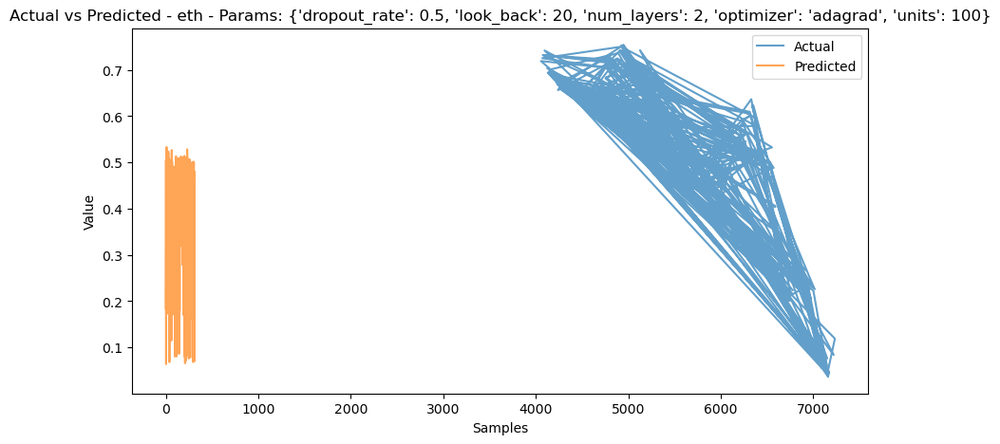

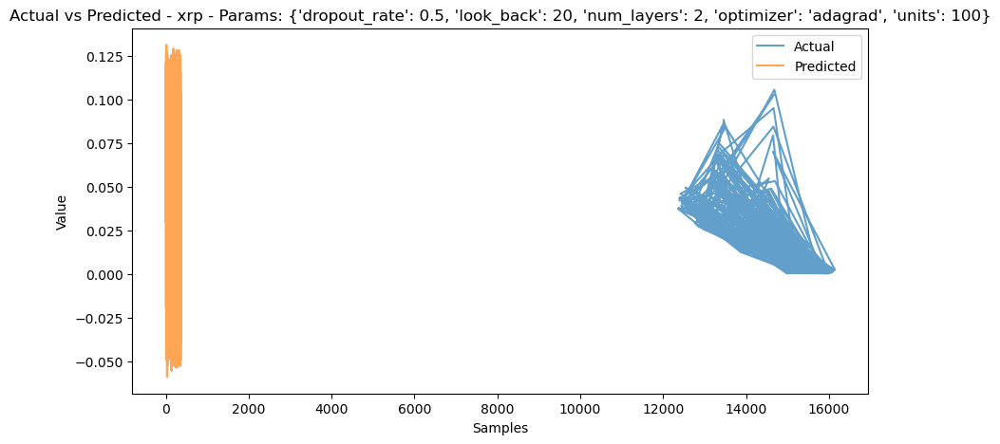

Evaluation metrics with corresponding name labels:
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 50}
  aave - MSE: 0.00010116987393695474, R-squared: 0.9691514351483846
  btc - MSE: 0.0002367995719141464, R-squared: 0.9909124269877401
  doge - MSE: 3.1015493406133083e-06, R-squared: 0.908634483192435
  eth - MSE: 0.0002156508733787375, R-squared: 0.9939960977894161
  xrp - MSE: 1.486354227705396e-05, R-squared: 0.9699922481942991
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer': 'adam', 'units': 100}
  aave - MSE: 2.4629295131662088e-05, R-squared: 0.9924900726021254
  btc - MSE: 4.649210620340153e-05, R-squared: 0.998215788963629
  doge - MSE: 1.661359285757672e-05, R-squared: 0.5105963727267959
  eth - MSE: 2.9955405778987272e-05, R-squared: 0.9991660162365328
  xrp - MSE: 3.485679028354361e-05, R-squared: 0.9296282210475024
Parameters: {'dropout_rate': 0.2, 'look_back': 10, 'num_layers': 1, 'optimizer

In [70]:
import matplotlib.pyplot as plt
from keras.models import Sequential
from keras.layers import LSTM, Dropout, Dense
from sklearn.model_selection import ParameterGrid
from sklearn.metrics import mean_squared_error, r2_score
from keras.utils import to_categorical
import numpy as np
import pandas as pd

evaluation_metrics = {}

def create_lstm_model(units, dropout_rate, optimizer, num_layers, look_back):
    model = Sequential()
    model.add(LSTM(units=units, return_sequences=(num_layers > 1), input_shape=(look_back, X_train.shape[2])))
    model.add(Dropout(dropout_rate))
    if num_layers > 1:
        for _ in range(1, num_layers):
            model.add(LSTM(units=units, return_sequences=(_ < num_layers-1)))
            model.add(Dropout(dropout_rate))
    model.add(Dense(units=1))
    model.compile(optimizer=optimizer, loss='mean_squared_error')
    return model

param_grid = {
    'units': [50, 100],
    'dropout_rate': [0.2, 0.5],
    'num_layers': [1, 2],
    'look_back': [10, 20],
    'optimizer': ['adam', 'rmsprop', 'sgd', 'adagrad']
}

param_grid_list = list(ParameterGrid(param_grid))

best_score_mse = float('inf')
best_score_r2 = float('-inf')
best_params = None

for params in param_grid_list:
    print("Testing parameters:", params)
    model = create_lstm_model(**params)
    model.fit(X_train, Y_train_reshaped, epochs=25, batch_size=32, verbose=0, validation_data=(X_val, Y_val_reshaped))
    Y_pred = model.predict(X_test)

    original_names = label_encoder.inverse_transform(X_test[:, 0, -1].astype(int))
    unique_names = np.unique(original_names)

    metrics = {}
    for name in unique_names:
        mask = original_names == name
        mse = mean_squared_error(Y_test[mask], Y_pred[mask])
        r2 = r2_score(Y_test[mask], Y_pred[mask])
        metrics[name] = {'MSE': mse, 'R-squared': r2}

        # Plot actual vs predicted for each coin
        plt.figure(figsize=(10, 5))
        plt.plot(Y_test[mask], label='Actual', alpha=0.7)
        plt.plot(Y_pred[mask], label='Predicted', alpha=0.7)
        plt.title(f"Actual vs Predicted - {name} - Params: {params}")
        plt.xlabel('Samples')
        plt.ylabel('Value')
        plt.legend()
        plt.show()

    evaluation_metrics[str(params)] = metrics

    if mse < best_score_mse:
        best_score_mse = mse
        best_score_r2 = r2
        best_params = params

# After all plots and evaluations
print("Evaluation metrics with corresponding name labels:")
for params_str, metrics_dict in evaluation_metrics.items():
    print("Parameters:", params_str)
    for name, metrics in metrics_dict.items():
        print(f"  {name} - MSE: {metrics['MSE']}, R-squared: {metrics['R-squared']}")

print("Best parameters:", best_params)
print("Best MSE:", best_score_mse)
print("Best R-squared:", best_score_r2)


Training LSTM model for aave


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 458us/step
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 445us/step


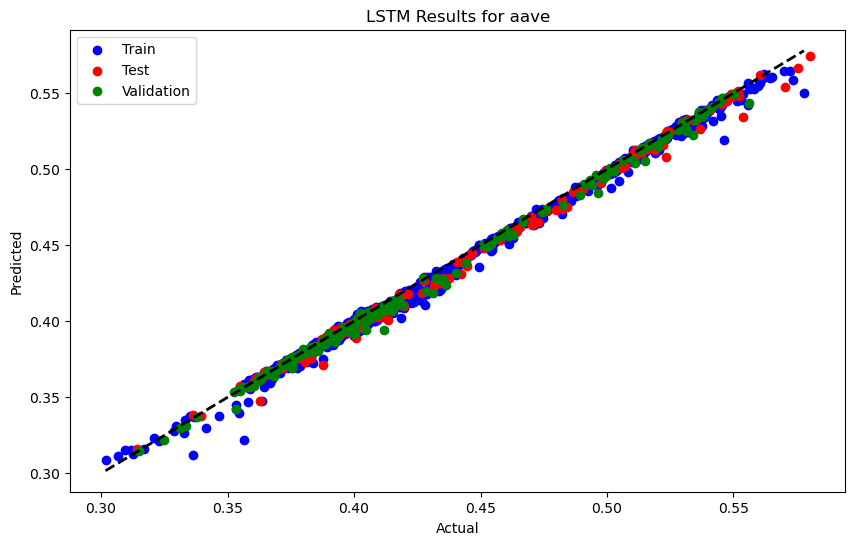

Training LSTM model for bitcoin


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


83/83 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 366us/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 346us/step


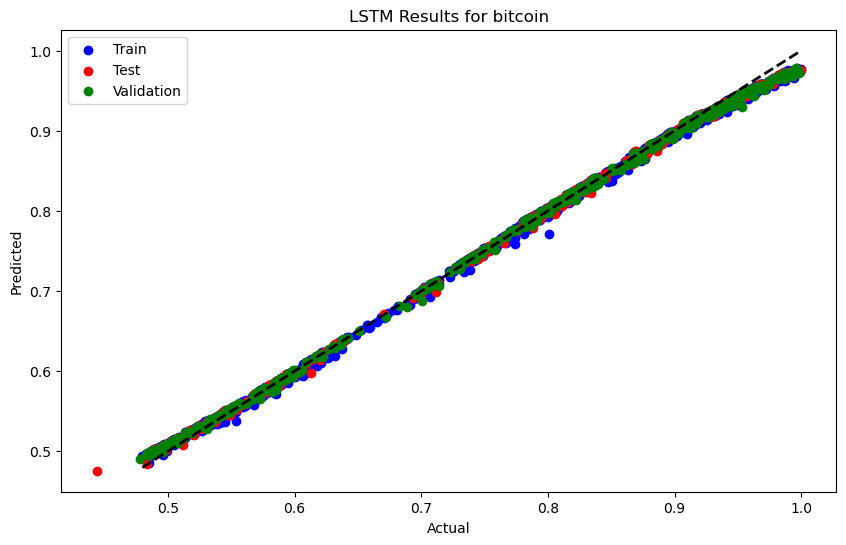

Training LSTM model for dogecoin


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


83/83 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 368us/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 355us/step


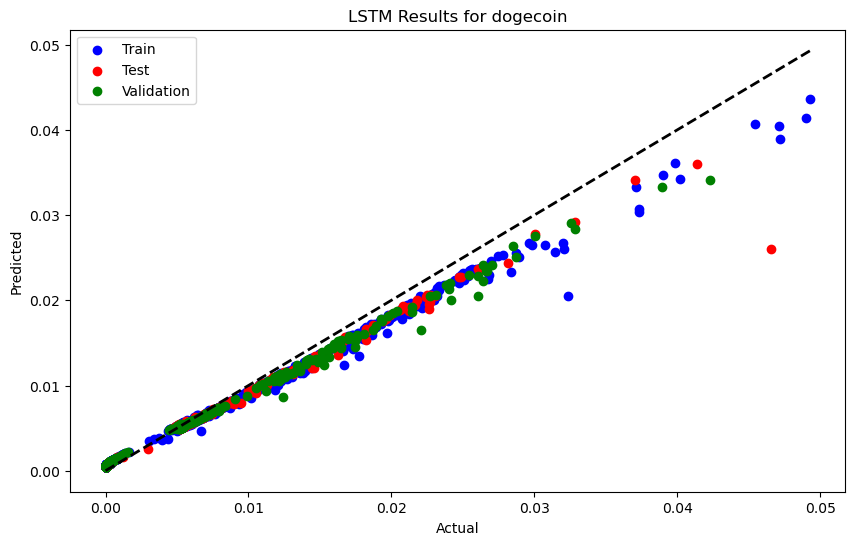

Training LSTM model for ethereum


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 344us/step
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 352us/step


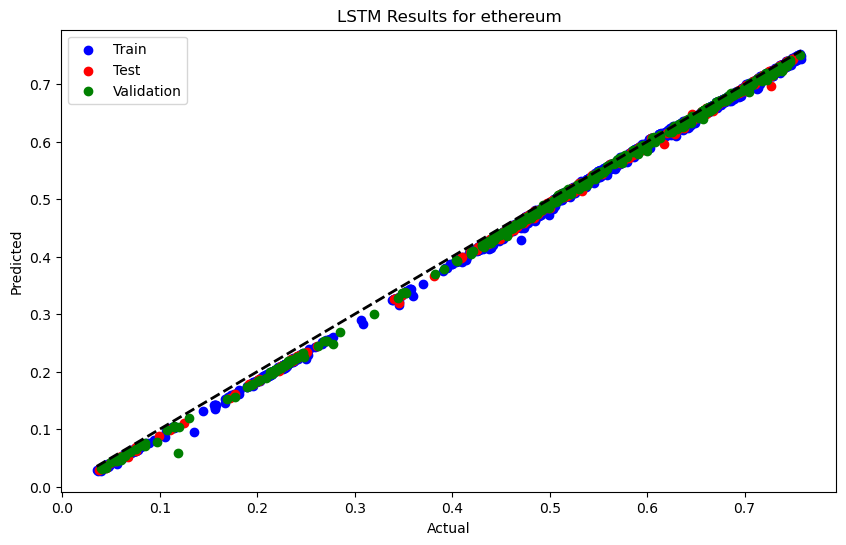

Training LSTM model for ripple


/Users/shreyac/anaconda3/lib/python3.11/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


83/83 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 403us/step
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 316us/step


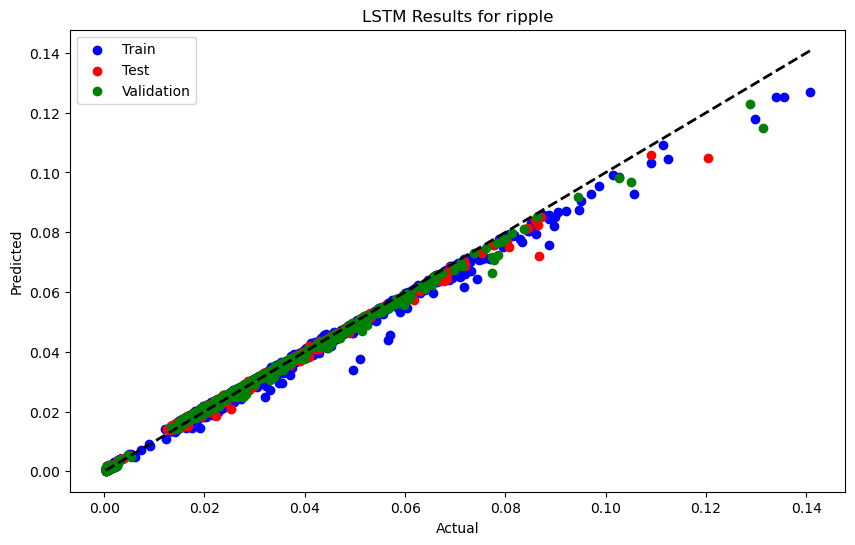

Evaluation metrics for aave using LSTM:
Best MSE (Validation): 1.7321139666478085e-05
Best R-squared (Validation): 0.9953940764453855
Best parameters: Not applicable as no hyperparameter tuning was done here
Train MSE: 2.232252976469912e-05
Train R-squared: 0.9939143307325125
Test MSE: 2.2663314422059325e-05
Test R-squared: 0.9941649987391284
Evaluation metrics for bitcoin using LSTM:
Best MSE (Validation): 5.149638500719514e-05
Best R-squared (Validation): 0.997984686172783
Best parameters: Not applicable as no hyperparameter tuning was done here
Train MSE: 4.6354377757951897e-05
Train R-squared: 0.9982327684523398
Test MSE: 4.724406992762998e-05
Test R-squared: 0.9982512025011171
Evaluation metrics for dogecoin using LSTM:
Best MSE (Validation): 1.1503476182049017e-06
Best R-squared (Validation): 0.9756741423463704
Best parameters: Not applicable as no hyperparameter tuning was done here
Train MSE: 9.04146233433831e-07
Train R-squared: 0.9775546200129561
Test MSE: 1.4967576038719044e

In [71]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from keras.models import Sequential
from keras.layers import LSTM, Dropout, Dense
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from keras.optimizers import Adam

# Label mapping
label_mapping = {
    0: 'aave',
    1: 'bitcoin',
    2: 'dogecoin',
    3: 'ethereum',
    4: 'ripple'
}
evaluation_metrics = {label: [] for label in label_mapping.values()}

# Load and preprocess data
# scaled_coins_df = pd.read_csv('path_to_your_data.csv')

for coin_name in label_mapping.values():
    print(f"Training LSTM model for {coin_name}")
    
    # Filtering data for the specific coin
    coin_data = scaled_coins_df[scaled_coins_df['name'] == list(label_mapping.keys())[list(label_mapping.values()).index(coin_name)]]
    
    # Preparing features and target variable
    X_coin = coin_data.drop(['High', 'name'], axis=1).values
    Y_coin = coin_data['High'].values
    
    # Reshaping for LSTM [samples, time steps, features]
    X_coin = X_coin.reshape((X_coin.shape[0], 1, X_coin.shape[1]))
    
    # Splitting data into training, validation, and testing sets
    X_train, X_temp, Y_train, Y_temp = train_test_split(X_coin, Y_coin, test_size=0.3, random_state=42)
    X_val, X_test, Y_val, Y_test = train_test_split(X_temp, Y_temp, test_size=0.5, random_state=42)
    
    # LSTM model
    model = Sequential()
    model.add(LSTM(50, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])))
    model.add(Dropout(0.2))
    model.add(LSTM(50, return_sequences=False))
    model.add(Dropout(0.2))
    model.add(Dense(1))
    model.compile(optimizer=Adam(learning_rate=0.01), loss='mean_squared_error')
    
    # Fit the model
    model.fit(X_train, Y_train, epochs=50, batch_size=32, verbose=0, validation_data=(X_val, Y_val))
    
    # Predictions for training, validation, and test sets
    Y_pred_train = model.predict(X_train)
    Y_pred_val = model.predict(X_val)
    Y_pred_test = model.predict(X_test)
    
    # Evaluation metrics
    mse_train = mean_squared_error(Y_train, Y_pred_train)
    mse_val = mean_squared_error(Y_val, Y_pred_val)
    mse_test = mean_squared_error(Y_test, Y_pred_test)
    r2_train = r2_score(Y_train, Y_pred_train)
    r2_val = r2_score(Y_val, Y_pred_val)
    r2_test = r2_score(Y_test, Y_pred_test)
    
    # Collecting evaluation metrics
    evaluation_metrics[coin_name].append({
        'MSE_train': mse_train,
        'MSE_val': mse_val,
        'MSE_test': mse_test,
        'R2_train': r2_train,
        'R2_val': r2_val,
        'R2_test': r2_test
    })
    
    # Plotting results
    plt.figure(figsize=(10, 6))
    plt.scatter(Y_train, Y_pred_train, color='blue', label='Train')
    plt.scatter(Y_test, Y_pred_test, color='red', label='Test')
    plt.scatter(Y_val, Y_pred_val, color='green', label='Validation')
    plt.plot([Y_train.min(), Y_train.max()], [Y_train.min(), Y_train.max()], 'k--', lw=2)
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.title(f'LSTM Results for {coin_name}')
    plt.legend()
    plt.show()

# Displaying overall evaluation metrics
for coin_name, metrics_list in evaluation_metrics.items():
    print(f"Evaluation metrics for {coin_name} using LSTM:")
    if metrics_list:
        best_metrics = min(metrics_list, key=lambda x: x['MSE_val'])
        print("Best MSE (Validation):", best_metrics['MSE_val'])
        print("Best R-squared (Validation):", best_metrics['R2_val'])
        print("Best parameters: Not applicable as no hyperparameter tuning was done here")
        print("Train MSE:", best_metrics['MSE_train'])
        print("Train R-squared:", best_metrics['R2_train'])
        print("Test MSE:", best_metrics['MSE_test'])
        print("Test R-squared:", best_metrics['R2_test'])
    else:
        print("No evaluation metrics found for this coin.")
